## SBMOO  approach for Dealing with Deep Uncertainty in Environmental Problems:


- Solve scenario-based MOOP (i.e. simultaneously consider the selected scenarios and generate the solutions for an SBMOOP)
    [For the time being, we use the previous scenario selected methods in the literature (Particularly use one proposed in Eker & Kwakkel (2018).]
- Use ASF as a posteriori decision-making approach [a more smart way of generating reference point should be considered; e.g. surrogate ASF]  

- Finally, we need to analyze the performances and the robustness(regarding their definition(s)) of the final solution(s) in a wide range of scenarios (say 1000 random scenarios)
- The classical lake problem has been used to test the idea.

##### Objectives in Lake problem(4 objectives):
- Max expected economic benefits(Utility)
- Min worst-case average P concentration(Pollution)
- Max average Inertia of control policy(Inertia)
- Max reliability of policy in staying below the lake's critical P threshold(Reliability)

##### Constraints:
- P emissions range between 0.0001 and 0.1(decision variables bounds)

##### Observations:
- Utility and reliability are the most conflicting objectives
- There is no feasible solution with the reliability of higher than 85% (or even 10%) for all scenarios. 

In [1]:
import numpy as np
from scipy.optimize import brentq
import math
from scipy.optimize import minimize
import random

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

import csv
import plotly.express as px
import plotly.graph_objects as go

In [2]:
def lake_problem(decisions,
                 b, #= 0.42,          # decay rate for P in lake (0.42 = irreversible)
                 q, #= 2.0,           # recycling exponent
                 mean, #= 0.02,       # mean of natural inflows
                 stdev, #= 0.001,     # future utility discount rate
                 delta, #= 0.98,      # standard deviation of natural inflows
                 alpha, #= 0.4,       # utility from pollution
                 nsamples = 100    # Monte Carlo sampling of natural inflows
                 ): #**kwargs):   
    #decisions = [kwargs[str(i)] for i in range(100)]
    
    Pcrit = brentq(lambda x: x**q/(1+x**q) - b*x, 0.01, 1.5)
    nvars = len(decisions)
    X = np.zeros((nvars,))
    average_daily_P = np.zeros((nvars,))
    decisions = np.array(decisions)
    reliability = 0.0

    for _ in range(nsamples):
        X[0] = 0.0
        
        natural_inflows = np.random.lognormal(
                math.log(mean**2 / math.sqrt(stdev**2 + mean**2)),
                math.sqrt(math.log(1.0 + stdev**2 / mean**2)),
                size = nvars)
        
        for t in range(1,nvars):
            X[t] = (1-b)*X[t-1] + X[t-1]**q/(1+X[t-1]**q) + decisions[t-1] +\
                    natural_inflows[t-1]
            average_daily_P[t] += X[t]/float(nsamples)
    
        reliability += np.sum(X < Pcrit)/float(nsamples*nvars)
      
    max_P = np.max(average_daily_P)
    utility = np.sum(alpha*decisions*np.power(delta,np.arange(nvars)))#/100
    inertia = np.sum(np.absolute(np.diff(decisions)) < 0.02)/float(nvars-1)
    
    
    return -utility, max_P, -inertia, -reliability  # Negative signs describe the Maximization objectives

In [3]:
"""
Multi_scenario model initialization
"""
# Number of scenarios
s = 1
#Number of objectives 
k = 4
# Number of meta-criteria
mc = s*k

In [4]:
"""
 Utilizing 4 diverse scenarios + 1 ref scenario from 
 
 Eker, S. and Kwakkel, J.H., 2018. Including robustness considerations in the search phase of Many-Objective 
 Robust Decision Making. Environmental Modelling & Software, 105, pp.201-216.
 
 4 selected scenarios + 1 reference scenario:
              b           delta          mean           q             std
 A(#77)  0.19330981   0.953092397    0.017430754    3.049281843    0.002061759
 B(#96)  0.141181536  0.950441986    0.012044268    2.584491318    0.00243013
 C(#130) 0.111640212  0.956457199    0.010126115    2.968733539    0.003692125
 D(#181) 0.272280522  0.931232823    0.03300274     2.971857894    0.004599415
 Ref     0.42         0.98           0.02           2              0.0017
 
+ 4 scenarios from

Bartholomew, E. & Kwakkel, J. H. (2020), ‘On considering robustness in thesearch phase of robust decision making:  
A comparison of many-objective ro-bust decision making, multi-scenario many-objective robust decision making,
and many objective robust optimization’,Environmental Modelling & Soft-warep. 104699.

Used the same algorithm as Eker 2018, but ended up with the following scenarios:

4 selected scenarios + 1 reference scenario:

    b        q      mean      std     delta
1 0.2760   3.0490   0.0039   0.0039   0.9310
2 0.1350   2.0255   0.0407   0.0030   0.9613
3 0.2704   2.4783   0.0169   0.0039   0.9631
4 0.1009   3.6789   0.0187   0.0037   0.9317

Ref the same as the above
"""

b = [0.19330981,  0.141181536, 0.111640212, 0.272280522, 0.42, 0.2760, 0.1350, 0.2704, 0.1009] # b = [0.42, 0.1, 0.2, 0.3]
q = [3.049281843, 2.584491318, 2.968733539, 2.971857894, 2, 3.0490, 2.0255, 2.4783, 3.6789] # q = [2.0, 3, 4, 4.5]
mean = [0.017430754, 0.012044268, 0.010126115, 0.03300274, 0.02, 0.0039, 0.0407, 0.0169, 0.0187]   # mean = [0.02, 0.01, 0.03, 0.05]
stdev = [0.002061759, 0.00243013, 0.003692125, 0.004599415, 0.0017, 0.0039, 0.0030, 0.0039, 0.0037]   # stdev = [0.001, 0.0006, 0.001, 0.005]
delta = [0.953092397, 0.950441986, 0.956457199, 0.931232823, 0.98, 0.9310, 0.9613, 0.9631, 0.9317]    

## Finding the ideal points (the optimal values for objectives in each scenario) by solving a single-scenario single-objective problem for all objectives and 5 considered scenarios.

In [5]:
# 4 objectives and 9 scenarios
# So the indices must change between 0-8, each demonstrates a scenario

def single_objective_single_scenario(decisions):
    """
    single-objective (obj) single-scenario (scen) model
    """        
    f = []                     
    f = lake_problem(decisions, b = b[scen], q = q[scen], mean = mean[scen], stdev = stdev[scen], delta = delta[scen], alpha = 0.4, nsamples = 100)
                     
    return f[obj]

In [6]:
# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}  0.0001
bnds = []
   
for i in range(100):
    bnds.append(var_bnds)  

In [7]:
# Solving the single-scenario single objective problems to get the ideal points for each objective in each scenario

ideal_Utility = [] 
ideal_Pollution = [] 
ideal_Inertia = [] 
ideal_Reliability = [] 
scen = 2
ind_temp = 0
extreme_dec = []
extreme_refp = np.zeros((mc,k))

for obj in range(k):
    print('k=',obj)
    
    """
    Run the model n times with different goals to generate different Pareto optimal solutions
    """
    
    print('s=', scen)
    ind_temp += 1
        
    sol = minimize(single_objective_single_scenario,
            x0,
            method = "SLSQP",
            bounds = bnds,
            #constraints = cons
            )  
        
    # Decision variables (solutions)
    extreme_dec.append(sol.x)
    
    F = lake_problem(sol.x, b = b[scen], q = q[scen], mean = mean[scen], stdev = stdev[scen], delta = delta[scen], alpha = 0.4, nsamples = 100)
    #print(' Scenario ',scen+1,': b = ', b[scen], ', q = ', q[scen], ', mean = ', mean[scen], ', stdev = ', stdev[scen], ',delta = ', delta[scen])
    #print('f_{obj+1}',scen+1,' =', F[obj])

    # Store Objective values for scenario S_i
    extreme_refp[ind_temp-1] = np.array([-F[0],F[1],-F[2],-F[3]])
        
    if obj == 0:
        ideal_Utility.append(-F[obj])
    elif obj == 1:
        ideal_Pollution.append(F[obj])
    elif obj == 2:
        ideal_Inertia.append(-F[obj])
    else:
        ideal_Reliability.append(-F[obj])
        

#print('Ideal points for Utility in different scenarios =',ideal_Utility)
#print('Ideal points for Plution in different scenarios =',ideal_Pollution)
#print('Ideal points for Inertia in different scenarios =',ideal_Inertia)
#print('Ideal points for Reliability in different scenarios =',ideal_Reliability)

k= 0
s= 2
k= 1
s= 2
k= 2
s= 2
k= 3
s= 2


In [8]:
# Write ideal points

with open('obective_values_4obj_s3(EkerBarth)_ideal points.csv', 'w', newline='') as f:
    objectives = ['ideal_Utility', 'ideal_Pollution', 'ideal_Inertia', 'ideal_Reliability', 'Scenario'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()
    for i in range(s):
        thewriter.writerow({'ideal_Utility' : ideal_Utility[i], 'ideal_Pollution' : ideal_Pollution[i], 'ideal_Inertia' : ideal_Inertia[i], 'ideal_Reliability' : ideal_Reliability[i], 'Scenario' : i
                               })
        
with open('extreme_rf_points(EkerBarth)s3.csv', 'w', newline='') as f:
    objectives = ['extreme_rf_points', 'extreme_rf_points_dec'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()
    for i in range(mc):
        thewriter.writerow({'extreme_rf_points' : extreme_refp[i], 'extreme_rf_points_dec' : extreme_dec[i]
                               })    

In [5]:
Lake45_ideals = pd.read_csv('obective_values_4obj_s3(EkerBarth)_ideal points.csv')
Lake45_ideals

,ideal_Utility,ideal_Pollution,ideal_Inertia,ideal_Reliability,Scenario


In [6]:
# Extreme points (decision space)
import re
extreme_rf_points = pd.read_csv('extreme_rf_points(EkerBarth)s3.csv')
extreme_rfp_dec = np.zeros((mc,100))
for i in range(mc):
    rfpt = re.findall(r"[-+]?\d*\.\d+|\d+", extreme_rf_points['extreme_rf_points_dec'][i])
    for j in range(100):
        extreme_rfp_dec[i][j] = float(rfpt[j])

#extreme_rfp_dec

In [7]:
# Calculate the extreme points in objective space

extreme_rfp = [s * [None] for i in range(mc)]  #np.zeros((mc,mc))

for j in range(mc):
    f_temp = np.zeros((k,))
    F = lake_problem(extreme_rfp_dec[j], b = b[2], q = q[2], mean = mean[2], stdev = stdev[2], delta = delta[2], alpha = 0.4, nsamples = 100)
    for i in range(k):
        if i==1:
            f_temp[i] = F[i]
        else:
            f_temp[i] = -F[i]
                
    extreme_rfp[j][0] = f_temp
                
extreme_rfp

[[array([0.90792862, 9.93397839, 1.        , 0.04      ])],
 [array([0.00291761, 0.10705091, 1.        , 1.        ])],
 [array([9.07928619e-04, 1.02724950e-01, 1.00000000e+00, 1.00000000e+00])],
 [array([9.07928619e-04, 1.03763720e-01, 1.00000000e+00, 1.00000000e+00])]]

In [8]:
Lake45_ideals = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\obective_values_4obj_9scen(EkerBarth)_ideal points.csv')
Lake45_ideals

,ideal_Utility,ideal_Pollution,ideal_Inertia,ideal_Reliability,Scenario
0,0.845753,0.096717,1.0,1.0000,0
1,0.802129,0.110756,1.0,1.0000,1
2,0.907929,0.102940,1.0,1.0000,2
3,0.581198,0.131598,1.0,1.0000,3
4,1.734761,0.057112,1.0,1.0000,4
5,0.579248,0.017281,1.0,1.0000,5
6,1.013628,7.592178,1.0,0.0416,6
7,1.058766,0.069357,1.0,1.0000,7
8,0.585153,0.231929,1.0,1.0000,8


In [9]:
"""
Achievement Scalarizing Function (ASF) approach: transfer the multi-objective problem into a single objective one.
Then the following problem will be solved:

  min_x  max_{i=1,..,k} [w_i(f_i - g_i)] + \epsilon sum_{i=1}^n  w_i(f_i - g_i)
  
   s.t. x \in S(feasible region)
  
  where w_i are the weights and can be set bu the decision maker(DM) (e.g. w_i = 1/(z_i^{ideal} - z_i^{nadir} which is also normalize the objective functions)
  k : number of objective functions
  g_i: aspiration levels to be set by the DM (one for each objective function is needed)

When we have multiple scenarios the above formulation have an additional dimension:

   min_x  max_{i=1,..,k; p=1,...,s} [w_{ip}(f_{ip} - g_{ip})] + \epsilon sum_{i=1}^n [sum_{p=1}^s  w_{ip}(f_{ip} - g_{ip}) ]
  
     s.t. x \in S(feasible region in all scenarios)

"""


def objective(decisions):
    """
    ASF
    """     
    phi = np.zeros((s,k))
    w = np.ones((s,k)) # weight vectors
    eps = 0.0001
    f = [[None] for i in range(s)] 
    
    # Setting weights, the same weight for each objective in all scenarios
    for p in range(s):
        for i in range(k): 
            if i==0:
                w[p,i] = 1/(Lake45_ideals.loc[2,'ideal_Utility'])  #2
            elif i==1:
                w[p,i] = 1/(15-(Lake45_ideals.loc[2,'ideal_Pollution']))
            elif i==2:
                w[p,i] = 1/Lake45_ideals.loc[2,'ideal_Inertia']                
            else:
                w[p,i] = 1/Lake45_ideals.loc[2,'ideal_Reliability']
                       
    for p in range(s):
        f[p] = lake_problem(decisions, b = b[2], q = q[2], mean = mean[2], stdev = stdev[2], delta = delta[2], alpha = 0.4, nsamples = 100)
        phi[p] = w[p]*(f[p] - g[p])
        aug = eps * (phi[p]).sum()  
    
    return phi.max() + aug


In [10]:
# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}  0.0001
bnds = []
   
for i in range(100):
    bnds.append(var_bnds)  

In [11]:
"""
  Setting the goals/ reference points - selected
"""
# number of solution to be generated 
n = 50

ig=[9 * [None] for i in range(n)] 

"""
Selected weights for more diverse solutions
"""      
#extremes
for i in range(mc):
    for p in range(s):
        ig[i][p] = np.array([extreme_rfp[i][0][0]*-1, extreme_rfp[i][0][1], extreme_rfp[i][0][2]*-1, extreme_rfp[i][0][3]*-1])

# generating some evenly distributed weights
cc = 0
W = []
for i1 in range(5):#s*k+1):
    for i2 in range(i1+1):
        for i3 in range(i2+1):
            w1 = (4-i1)/4
            w2 = (i1-i2)/4
            w3 = (i2-i3)/4
            w4 = 1 - (w1 + w2 + w3)
            W.append(np.array([w1,w2,w3,w4]))
            #print(w1, w2, w3, w4)
            cc += 1

# generate evenly distributed reference points
ig[4][0] = np.array([ig[0][0][0], ig[3][0][1], ig[0][0][2], ig[1][0][3]])

for i in range(np.shape(W)[0]):
    ig[5+i][0] = ig[4][0]*W[i]

# Using Latin Hypercube Sampling (LHS)
from pyDOE import *
from smt.sampling_methods import LHS
                     
xlimits4 = np.array([[-Lake45_ideals.loc[0,'ideal_Utility']*10,-0.0005], # Utility 
                    [-5,15], # Pollution 
                    [-1, -0.4], #Inertia
                    [-1*5, -0.04]  # Reliability 
                   ])

sampling4 = LHS(xlimits=xlimits4)

num = n#-40

x4 = sampling4(num)
                     
for i in range(num):
    ig[i][0] = x4[i]#+40
                           
                     
def selected_goals(ig, n, s, k):
    g = np.zeros((s,k))
    for i in range(s):
        g[i] = ig[n][0] 
    return g

In [18]:
selected_goals(ig, 10, s, k)

array([[-0.45396431,  0.02601684, -0.25      , -0.        ]])

# Use ASF as a posteriori decision-making approach

In [12]:
"""
Solving the problem
 
""" 
n = 50 # number of solutions to be generated

import time
start_time = time.time()

ait = [[None] for i in range(n)] 
goals = [[None] for i in range(n) ] 
nfe = [] 

Utility = [[None] for i in range (n)] 
Pollution = [[None] for i in range (n)] 
Inertia = [[None] for i in range (n)] 
Reliability = [[None] for i in range (n)] 

# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}  0.0001
bnds = []
   
for i in range(100):
    bnds.append(var_bnds) 

for j in range(n):
    """
    Run the model n times with different goals to generate different Pareto optimal solutions
    
    """
    #tait = [[None] for i in range (5)] 
    
    print(j)
    g = selected_goals(ig, j, s, k)
    
    #print('1.ASF')
    sol = minimize(objective,
               x0,
               method = "SLSQP",
               bounds = bnds,
               #constraints = cons
               options={'disp': True}
               )

    print(sol.message)
    print('iterations', sol.nit)
    print('NFE', sol.nfev)

    # Decision variables (solutions)
    ait[j] = sol.x
    goals[j] = g
    nfe.append(sol.nfev)
                    
    
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    p=2
    F = lake_problem(sol.x, b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
    print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
    print('f_1',p+1,' (Utility) =', -F[0])
    print('f_2',p+1,' (max_P) =', F[1])
    print('f_3',p+1,' (inertia) =', -F[2])
    print('f_4',p+1,' (reliability) =', -F[3])
       
    # Store Objective values for scenario S_i
    temp_Utility.append(-F[0])
    temp_Pollution.append(F[1])
    temp_Inertia.append(-F[2])
    temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    Utility[j] = temp_Utility
    Pollution[j] = temp_Pollution
    Inertia[j] = temp_Inertia
    Reliability[j] = temp_Reliability
         
                    
print("--- %s seconds ---" % (time.time() - start_time)) 
print('nfe =', np.sum(nfe))

0
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 7.651044210825926
            Iterations: 95
            Function evaluations: 10469
            Gradient evaluations: 94
Optimization terminated successfully.
iterations 95
NFE 10469
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.7509199189510174
f_2 3  (max_P) = 9.604001235526963
f_3 3  (inertia) = 0.48484848484848486
f_4 3  (reliability) = 0.03999999999999998
1
Iteration limit exceeded    (Exit mode 9)
            Current function value: 7.664360044887214
            Iterations: 101
            Function evaluations: 10946
            Gradient evaluations: 98
Iteration limit exceeded
iterations 101
NFE 10946
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.5697206802451333
f_2 3  (max_P) = 9.533235411335024
f_3 3 

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 5.646351878686106
            Iterations: 22
            Function evaluations: 2445
            Gradient evaluations: 22
Optimization terminated successfully.
iterations 22
NFE 2445
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.8790874355854321
f_2 3  (max_P) = 9.889974574609191
f_3 3  (inertia) = 0.7878787878787878
f_4 3  (reliability) = 0.03999999999999998
17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 7.023978774891
            Iterations: 56
            Function evaluations: 6121
            Gradient evaluations: 55
Optimization terminated successfully.
iterations 56
NFE 6121
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.6433942223016068
f_2 3  (max_P) = 9.3658308

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 2.760327769593858
            Iterations: 1
            Function evaluations: 113
            Gradient evaluations: 1
Optimization terminated successfully.
iterations 1
NFE 113
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.000937569191037537
f_2 3  (max_P) = 0.10408003331406829
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 1.0000000000000007
33
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 6.739937450071943
            Iterations: 28
            Function evaluations: 3107
            Gradient evaluations: 28
Optimization terminated successfully.
iterations 28
NFE 3107
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.7320269938159605
f_2 3  (max_P) = 9.616803257928996
f_3 3

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 2.6134294084335727
            Iterations: 77
            Function evaluations: 8140
            Gradient evaluations: 73
Optimization terminated successfully.
iterations 77
NFE 8140
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.08073022979376211
f_2 3  (max_P) = 9.03839327824205
f_3 3  (inertia) = 0.8282828282828283
f_4 3  (reliability) = 0.39449999999999974
49
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 3.059771596909403
            Iterations: 19
            Function evaluations: 2119
            Gradient evaluations: 19
Optimization terminated successfully.
iterations 19
NFE 2119
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.8594214551390604
f_2 3  (max_P) = 9.913

In [13]:
"""
Writing the results into a csv file
"""


# Write meta-objectives (objective-scenario combinations)

with open('meta_obective_values_4obj_1scen_50sol_random_rfps(20.11.2020)s3.csv', 'w', newline='') as f:
    meta_objectives = ['U in s3', 
                  'Po  in s3', 
                  'In  in s3', 
                  'Re  in s3' 
                       , 'group', 'decisions', 'goals'
                  ]
    thewriter = csv.DictWriter(f, fieldnames=meta_objectives)
    
    thewriter.writeheader()
    
    for j in range(n):
        thewriter.writerow({'U in s3' : Utility[j][0], 
                  'Po  in s3' : Pollution[j][0], 
                  'In  in s3' : Inertia[j][0], 
                  'Re  in s3' : Reliability[j][0], 
                   'group' : j, 'decisions' : ait[j], 'goals' : goals[j],
                   })

In [14]:
Lake4550_meta_data = pd.read_csv('meta_obective_values_4obj_1scen_50sol_random_rfps(20.11.2020)s3.csv')
Lake4550_meta_data.describe()

,U in s3,Po in s3,In in s3,Re in s3,group
count,50.000000,50.000000,50.000000,50.000000,50.00000
mean,0.496755,7.280268,0.726869,0.301336,24.50000
std,0.361195,4.104630,0.212988,0.411561,14.57738
min,0.000911,0.102612,0.363636,0.039900,0.00000
25%,0.069804,7.104032,0.515152,0.040000,12.25000
50%,0.574516,9.522758,0.752525,0.043900,24.50000
75%,0.845593,9.801559,0.979798,0.641475,36.75000
max,0.893860,9.930421,1.000000,1.000000,49.00000


In [15]:
# needs new assignment for different # of scenarios
Signed_sol = np.array([Lake4550_meta_data['U in s3']*(-1), Lake4550_meta_data['Po  in s3'], Lake4550_meta_data['In  in s3']*(-1), Lake4550_meta_data['Re  in s3']*(-1)])
#Signed_sol.T

In [16]:
n=50
solutions = np.zeros((n,s*k))
for j in range(n):
    solutions[j] = Signed_sol.T[0] #Lake4550_meta_data.values[j][0:s*k]

#solutions  

In [17]:
# Faster than is_pareto_efficient_simple, but less readable.
def is_pareto_efficient(costs, return_mask = True):
    """
    Find the pareto-efficient points
    :param costs: An (n_points, n_costs) array
    :param return_mask: True to return a mask
    :return: An array of indices of pareto-efficient points.
        If return_mask is True, this will be an (n_points, ) boolean array
        Otherwise it will be a (n_efficient_points, ) integer array of indices.
    """
    is_efficient = np.arange(costs.shape[0])
    n_points = costs.shape[0]
    next_point_index = 0  # Next index in the is_efficient array to search for
    while next_point_index<len(costs):
        nondominated_point_mask = np.any(costs<costs[next_point_index], axis=1)
        nondominated_point_mask[next_point_index] = True
        is_efficient = is_efficient[nondominated_point_mask]  # Remove dominated points
        costs = costs[nondominated_point_mask]
        next_point_index = np.sum(nondominated_point_mask[:next_point_index])+1
    if return_mask:
        is_efficient_mask = np.zeros(n_points, dtype = bool)
        is_efficient_mask[is_efficient] = True
        return is_efficient_mask
    else:
        return is_efficient

In [18]:
is_pareto_efficient(Signed_sol.T)

array([ True,  True,  True, False, False,  True,  True,  True,  True,
       False,  True, False,  True, False, False,  True, False,  True,
        True,  True,  True, False,  True,  True, False,  True,  True,
        True, False, False,  True,  True, False, False,  True, False,
        True,  True,  True,  True,  True, False,  True,  True,  True,
        True,  True,  True,  True,  True])

In [19]:
# Identifyling dominated points
num_dominated_sol = 0
dominated_sol = []

for j in range(n):
    if is_pareto_efficient(Signed_sol.T)[j] == False:
        num_dominated_sol += 1
        dominated_sol.append(j)
           
print('Number of dominated solutions =', num_dominated_sol)  
print('dominated solutions =', dominated_sol)       

Number of dominated solutions = 15
dominated solutions = [3, 4, 9, 11, 13, 14, 16, 21, 24, 28, 29, 32, 33, 35, 41]


In [20]:
# Removing dominated points
temp_non_dominated = Lake4550_meta_data
for j in dominated_sol:
    temp_non_dominated = temp_non_dominated.drop([j], axis=0)
    
non_dominated_sol = temp_non_dominated
#for i in reliable_scenarios.Scenario_num:
#    print(reliable_scenarios.Scenario_num[i-1])
non_dominated_sol

,U in s3,Po in s3,In in s3,Re in s3,group,decisions,goals
0,0.750920,9.604001,0.484848,0.0400,0,[0.0999996 0.09999983 0.1 0.1 0...,[[-7.69639548 0. -0.778 -3.8592 ...
1,0.569721,9.533235,0.505051,0.0478,1,[0.09601669 0.09818519 0.03744548 0.09726647 0...,[[-7.52725492 11.2 -0.898 -4.8512 ...
2,0.878274,9.859272,0.737374,0.0400,2,[1.00000000e-01 1.00000000e-01 1.00000000e-01 ...,[[-5.4975682 -3.6 -0.682 -2.4704 ]]
5,0.463641,9.590106,0.454545,0.0577,5,[0.0975607 0.00103656 0.09878761 0.0282383 0...,[[-3.46788148 14.8 -0.61 -1.1808 ...
6,0.845217,9.795032,0.585859,0.0399,6,[0.09996604 0.09999833 0.09999134 0.09999995 0...,[[-5.83584932 13.6 -0.742 -2.8672 ...
7,0.852124,9.883754,0.818182,0.0400,7,[0.1 0.1 0.1 0.1 0...,[[-3.12960036 12.4 -0.634 -2.5696 ...
8,0.817745,9.803055,0.636364,0.0400,8,[0.1 0.1 0.1 0.09669599 0...,[[-8.20381716 12. -0.814 -1.5776 ...
10,0.845719,9.797068,0.555556,0.0400,10,[0.09999965 0.1 0.09997434 0.1 0...,[[-4.14444372 10.8 -0.826 -1.9744 ...
12,0.000955,0.102612,1.000000,1.0000,12,[0.000118 0.0001 0.0001 0.00012775 0...,[[-2.28389756 -2.8 -0.442 -3.6608 ...
15,0.879299,9.875411,0.797980,0.0400,15,[0.1 0.09999461 0.1 0.09996234 0...,[[-8.0346766 9.6 -0.85 -0.0896 ]]


In [21]:
# Describing all meta-objectives (4 objectives in 4+1 scenarios)
#Each line shows one solution
import plotly.graph_objects as go

df = non_dominated_sol

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color =  df['U in s3'],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s3', values = df['U in s3']),
        
            dict(range = [0,10],
                label = 'Pol_s3', values = df['Po  in s3']),
            
            dict(range = [0,1],
                label = 'In_s3', values = df['In  in s3']),
                        
            dict(range = [0,1],
                label = 'Re_s3', values = df['Re  in s3']),
            
            #dict(range = [0,40],
                #constraintrange = [0.8,1],
            #    label = 'Solution', values = df['group'])
     
        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

# Analyze the performances and the robustness(regarding their definition(s)) of the final solution(s) in a wide range of scenarios (say 1000 random scenarios)

## Randomly generate 995 more scenarios to re-evaluate the solutions in them

In [22]:
gen_scenarios = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\scenarios_991_9(EkerBart)10.10.2020.csv')
b = gen_scenarios.b
q = gen_scenarios.q
mean = gen_scenarios['meann'] #  reliable_scenarios.mean can not be used as 'mean' is a reserved term 
stdev = gen_scenarios['stdev']
delta = gen_scenarios.delta

## Analyze the performances in other 4 scenarios (s1,s2,s3 and s4)

In [23]:
"""
Re-evaluate the solutions in other 4 scenarios s1, s2, s3 and s4
"""
start_time = time.time()

nn = 50 - num_dominated_sol
ss = [0, 1, 3, 4] # number of scenarios for re-evaluation
c = 0

nUtility = [[None] for i in range (100)] 
nPollution = [[None] for i in range (100)] 
nInertia = [[None] for i in range (100)] 
nReliability = [[None] for i in range (100)] 

for j in non_dominated_sol.index:
    
    print(j)
        
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    for  p in ss:
        F = lake_problem(ait[j], b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
        print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
        print('f_1',p+1,' (Utility) =', -F[0])
        print('f_2',p+1,' (max_P) =', F[1])
        print('f_3',p+1,' (inertia) =', -F[2])
        print('f_4',p+1,' (reliability) =', -F[3])
       
        # Store Objective values for scenario S_i
        temp_Utility.append(-F[0])
        temp_Pollution.append(F[1])
        temp_Inertia.append(-F[2])
        temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    nUtility[j] = temp_Utility
    nPollution[j] = temp_Pollution
    nInertia[j] = temp_Inertia
    nReliability[j] = temp_Reliability
    c += 1
    
print("--- %s seconds ---" % (time.time() - start_time)) 

0
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7114761975373048
f_2 1  (max_P) = 5.657803934724686
f_3 1  (inertia) = 0.48484848484848486
f_4 1  (reliability) = 0.05050000000000004
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.6830395321446014
f_2 2  (max_P) = 7.652673467245002
f_3 2  (inertia) = 0.48484848484848486
f_4 2  (reliability) = 0.030000000000000075
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5274727686928186
f_2 4  (max_P) = 4.067631299657966
f_3 4  (inertia) = 0.48484848484848486
f_4 4  (reliability) = 0.06110000000000013
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.1959012548409027
f_2 5  (max_P) = 2.263214501453761
f_3 5  (inertia) = 0.484

 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.0018184759850327337
f_2 5  (max_P) = 0.05571713128257957
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.0000000000000007
15
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.8216997903374438
f_2 1  (max_P) = 5.7464292070091245
f_3 1  (inertia) = 0.797979797979798
f_4 1  (reliability) = 0.05110000000000004
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7811026046920613
f_2 2  (max_P) = 7.806307967378814
f_3 2  (inertia) = 0.797979797979798
f_4 2  (reliability) = 0.030000000000000075
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5727744850623241
f_2 4  (max_P) = 4.106023527866081
f_3 4  (inertia) = 0.797979797979798
f

 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.3360333158679565
f_2 5  (max_P) = 2.2802795329035837
f_3 5  (inertia) = 0.5151515151515151
f_4 5  (reliability) = 0.07
26
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.18286313655161168
f_2 1  (max_P) = 5.2670472395087895
f_3 1  (inertia) = 0.7676767676767676
f_4 1  (reliability) = 0.3811000000000001
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.17607325145850866
f_2 2  (max_P) = 7.321466245626812
f_3 2  (inertia) = 0.7676767676767676
f_4 2  (reliability) = 0.06060000000000014
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.14032724947496905
f_2 4  (max_P) = 2.9312625099882608
f_3 4  (inertia) = 0.7676767676767676

 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.8334043021964753
f_2 1  (max_P) = 5.755329504278354
f_3 1  (inertia) = 0.9191919191919192
f_4 1  (reliability) = 0.050800000000000047
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7909521111268509
f_2 2  (max_P) = 7.841343025175931
f_3 2  (inertia) = 0.9191919191919192
f_4 2  (reliability) = 0.030000000000000075
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.575471798212749
f_2 4  (max_P) = 4.107010260348029
f_3 4  (inertia) = 0.9191919191919192
f_4 4  (reliability) = 0.060900000000000135
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.6931208825094812
f_2 5  (max_P) = 2.283474993912268
f_3 5  (inertia) = 0.9191919

f_4 4  (reliability) = 1.0000000000000007
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.1358910157991945
f_2 5  (max_P) = 0.1295104195973617
f_3 5  (inertia) = 0.8282828282828283
f_4 5  (reliability) = 1.0000000000000007
49
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.8026824728302451
f_2 1  (max_P) = 5.753088319105843
f_3 1  (inertia) = 0.8383838383838383
f_4 1  (reliability) = 0.050800000000000047
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7628420661173053
f_2 2  (max_P) = 7.833277345352434
f_3 2  (inertia) = 0.8383838383838383
f_4 2  (reliability) = 0.030000000000000075
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5604043934008164
f_2 4  (max_P) = 4

In [24]:
nn

35

In [25]:

"""
Writing the results into a csv file
"""
import csv

# Write meta-objectives (objective-scenario combinations)

with open('meta_obective_1scen_re-evaluate_5(20.11.2020)s3.csv', 'w', newline='') as f:
    meta_objectives = ['U in s1', 'U in s2', 'U in s3','U in s4', 'U in s5',
                  'Po  in s1', 'Po  in s2', 'Po  in s3','Po  in s4', 'Po  in s5',
                  'In  in s1', 'In  in s2', 'In  in s3', 'In  in s4', 'In  in s5',
                  'Re  in s1', 'Re  in s2', 'Re  in s3', 'Re  in s4', 'Re  in s5', 
                  ]
    thewriter = csv.DictWriter(f, fieldnames=meta_objectives)
    
    thewriter.writeheader()
    
    for j in non_dominated_sol.index:
        thewriter.writerow({'U in s1' : nUtility[j][0], 'U in s2' : nUtility[j][1], 'U in s3' : Utility[j][0],'U in s4' : nUtility[j][2], 'U in s5' : nUtility[j][3],
                  'Po  in s1' : nPollution[j][0], 'Po  in s2' : nPollution[j][1], 'Po  in s3' : Pollution[j][0],'Po  in s4' : nPollution[j][2],'Po  in s5' : nPollution[j][3],
                  'In  in s1' : nInertia[j][0], 'In  in s2' : nInertia[j][1], 'In  in s3' : Inertia[j][0], 'In  in s4' : nInertia[j][2], 'In  in s5' : nInertia[j][3],
                  'Re  in s1' : nReliability[j][0], 'Re  in s2' : nReliability[j][1], 'Re  in s3' : Reliability[j][0], 'Re  in s4' : nReliability[j][2], 'Re  in s5' : nReliability[j][3],
                   
                   })

In [26]:
"""
Re-evaluate the solutions in a wide range of randomly generated scenarios
"""
start_time = time.time()

nn = 50 - num_dominated_sol
ss = 1000 # number of scenarios for re-evaluation
c = 0

nUtility = [[None] for i in range (nn)] 
nPollution = [[None] for i in range (nn)] 
nInertia = [[None] for i in range (nn)] 
nReliability = [[None] for i in range (nn)] 

for j in non_dominated_sol.index:
    
    print(j)
        
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    for  p in range(ss):
        F = lake_problem(ait[j], b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
        print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
        print('f_1',p+1,' (Utility) =', -F[0])
        print('f_2',p+1,' (max_P) =', F[1])
        print('f_3',p+1,' (inertia) =', -F[2])
        print('f_4',p+1,' (reliability) =', -F[3])
       
        # Store Objective values for scenario S_i
        temp_Utility.append(-F[0])
        temp_Pollution.append(F[1])
        temp_Inertia.append(-F[2])
        temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    nUtility[c] = temp_Utility
    nPollution[c] = temp_Pollution
    nInertia[c] = temp_Inertia
    nReliability[c] = temp_Reliability
    c += 1
    
print("--- %s seconds ---" % (time.time() - start_time)) 

0
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7114761975373048
f_2 1  (max_P) = 5.657632249575112
f_3 1  (inertia) = 0.48484848484848486
f_4 1  (reliability) = 0.05060000000000005
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.6830395321446014
f_2 2  (max_P) = 7.652520074669276
f_3 2  (inertia) = 0.48484848484848486
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.7509199189510174
f_2 3  (max_P) = 9.602267785984724
f_3 3  (inertia) = 0.48484848484848486
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5274727686928186
f_2 4  (max_P) = 4.068548

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.9029772163993435
f_2 31  (max_P) = 10.91963953291635
f_3 31  (inertia) = 0.48484848484848486
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.1413431183876548
f_2 32  (max_P) = 2.5416668504224553
f_3 32  (inertia) = 0.48484848484848486
f_4 32  (reliability) = 0.0958
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.5920812264064877
f_2 33  (max_P) = 9.829373652196729
f_3 33  (inertia) = 0.48484848484848486
f_4 33  (reliability) = 0.029900000000000076
 Scenario  34 : b =  0.33009586276488395 , q =  2.98511604439959

 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.9126763907190701
f_2 57  (max_P) = 10.083358171585028
f_3 57  (inertia) = 0.48484848484848486
f_4 57  (reliability) = 0.05000000000000004
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 1.059350593883927
f_2 58  (max_P) = 7.482784576670437
f_3 58  (inertia) = 0.48484848484848486
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 1.0421539361894634
f_2 59  (max_P) = 0.31151741560595264
f_3 59  (inertia) = 0.48484848484848486
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.

 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.7096856829134962
f_2 87  (max_P) = 5.174432703658106
f_3 87  (inertia) = 0.48484848484848486
f_4 87  (reliability) = 0.06000000000000015
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 1.0489727786598704
f_2 88  (max_P) = 2.943052777937423
f_3 88  (inertia) = 0.48484848484848486
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 1.0331837900587124
f_2 89  (max_P) = 3.6355993373647526
f_3 89  (inertia) = 0.48484848484848486
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.15

 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.5924795148783476
f_2 115  (max_P) = 6.598891673908309
f_3 115  (inertia) = 0.48484848484848486
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.6811374745384511
f_2 116  (max_P) = 3.997621647421667
f_3 116  (inertia) = 0.48484848484848486
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.6674080114283197
f_2 117  (max_P) = 4.463242051071986
f_3 117  (inertia) = 0.48484848484848486
f_4 117  (reliability) = 0.0899999999999999
 Scenario  118 : b =  0.182467204

 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.8986302150841379
f_2 146  (max_P) = 4.108870151492603
f_3 146  (inertia) = 0.48484848484848486
f_4 146  (reliability) = 0.15739999999999998
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.7454337726683862
f_2 147  (max_P) = 5.268915771020079
f_3 147  (inertia) = 0.48484848484848486
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.5731672308326543
f_2 148  (max_P) = 6.629271772867517
f_3 148  (inertia) = 0.48484848484848486
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.2382694248

 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 1.075859625642574
f_2 175  (max_P) = 0.36943348125408676
f_3 175  (inertia) = 0.48484848484848486
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.9730619466777223
f_2 176  (max_P) = 4.548978869801994
f_3 176  (inertia) = 0.48484848484848486
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 1.0928284712386538
f_2 177  (max_P) = 5.848739098752678
f_3 177  (inertia) = 0.48484848484848486
f_4 177  (reliability) = 0.06000000000000015
 Scenario  178 : b =  0.3696518668012

 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.5578441445561908
f_2 206  (max_P) = 2.343229201249908
f_3 206  (inertia) = 0.48484848484848486
f_4 206  (reliability) = 0.3040000000000001
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.5459976207252022
f_2 207  (max_P) = 4.116350136396805
f_3 207  (inertia) = 0.48484848484848486
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.6282876940197548
f_2 208  (max_P) = 0.5894980525159097
f_3 208  (inertia) = 0.48484848484848486
f_4 208  (reliability) = 0.9150000000000006
 Scenario  209 : b =  0.3816599394550959 , q =  3.87058

 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.5581999463901056
f_2 235  (max_P) = 5.07128363379822
f_3 235  (inertia) = 0.48484848484848486
f_4 235  (reliability) = 0.026700000000000033
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 1.0478308135741345
f_2 236  (max_P) = 6.741391761680518
f_3 236  (inertia) = 0.48484848484848486
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean =  0.025721493440968718 , stdev =  0.001199798183652876 ,delta =  0.9416801210898084
f_1 237  (Utility) = 0.6026039597924101
f_2 237  (max_P) = 6.211062745961355
f_3 237  (inertia) = 0.48484848484848486
f_4 237  (reliability) = 0.07
 Scenario  238 : b =  0.3862512613521695 , q =  3

f_3 266  (inertia) = 0.48484848484848486
f_4 266  (reliability) = 0.03480000000000005
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 0.957301864644342
f_2 267  (max_P) = 4.765746172152634
f_3 267  (inertia) = 0.48484848484848486
f_4 267  (reliability) = 0.030700000000000074
 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =  0.038718466195761865 , stdev =  0.004545913218970737 ,delta =  0.9321947527749748
f_1 268  (Utility) = 0.5336368550617971
f_2 268  (max_P) = 4.330518915753243
f_3 268  (inertia) = 0.48484848484848486
f_4 268  (reliability) = 0.07999999999999996
 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.6981105481820754
f_2 269  (max_P) = 4.735163699501515
f_3 269  (inertia) = 0.48484848484848

f_2 298  (max_P) = 3.1076548941195177
f_3 298  (inertia) = 0.48484848484848486
f_4 298  (reliability) = 0.05000000000000004
 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.5249470923901436
f_2 299  (max_P) = 0.32008812663000497
f_3 299  (inertia) = 0.48484848484848486
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.5352760943804086
f_2 300  (max_P) = 7.174609803679173
f_3 300  (inertia) = 0.48484848484848486
f_4 300  (reliability) = 0.030300000000000077
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.5346192535984451
f_2 301  (max_P) = 2.356943253579827

 Scenario  325 : b =  0.4417003027245207 , q =  3.6763370332996974 , mean =  0.01518668012108981 , stdev =  0.002660948536831484 ,delta =  0.970590312815338
f_1 325  (Utility) = 0.9720632951163085
f_2 325  (max_P) = 0.2792592084906978
f_3 325  (inertia) = 0.48484848484848486
f_4 325  (reliability) = 1.0000000000000007
 Scenario  326 : b =  0.395787083753784 , q =  2.7328456104944503 , mean =  0.027457114026236133 , stdev =  0.00287891019172553 ,delta =  0.9650403632694248
f_1 326  (Utility) = 0.8725080955688331
f_2 326  (max_P) = 2.6659531073002354
f_3 326  (inertia) = 0.48484848484848486
f_4 326  (reliability) = 0.11350000000000016
 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  0.014258324924318869 , stdev =  0.002095862764883956 ,delta =  0.9303279515640768
f_1 327  (Utility) = 0.5217964742836279
f_2 327  (max_P) = 4.310928775882863
f_3 327  (inertia) = 0.48484848484848486
f_4 327  (reliability) = 0.11000000000000008
 Scenario  328 : b =  0.23085267406659

 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean =  0.015105953582240159 , stdev =  0.004957618567103935 ,delta =  0.961962663975782
f_1 354  (Utility) = 0.8249726977771394
f_2 354  (max_P) = 9.476671627749989
f_3 354  (inertia) = 0.48484848484848486
f_4 354  (reliability) = 0.030000000000000075
 Scenario  355 : b =  0.4346367305751766 , q =  3.3332492431886984 , mean =  0.01627648839556004 , stdev =  0.0031372351160444 ,delta =  0.9678153380423814
f_1 355  (Utility) = 0.9198498812720957
f_2 355  (max_P) = 0.3094316889715682
f_3 355  (inertia) = 0.48484848484848486
f_4 355  (reliability) = 1.0000000000000007
 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.5720463591221051
f_2 356  (max_P) = 6.62827642555133
f_3 356  (inertia) = 0.48484848484848486
f_4 356  (reliability) = 0.032300000000000065
 Scenario  357 : b =  0.332921291624621

 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.5754214944297336
f_2 387  (max_P) = 9.095868540054148
f_3 387  (inertia) = 0.48484848484848486
f_4 387  (reliability) = 0.06000000000000015
 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 0.8212870675576639
f_2 388  (max_P) = 4.646845857311668
f_3 388  (inertia) = 0.48484848484848486
f_4 388  (reliability) = 0.10000000000000007
 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0.02027245206861756 , stdev =  0.004223007063572149 ,delta =  0.9571695257315844
f_1 389  (Utility) = 0.7597968589960616
f_2 389  (max_P) = 9.801673363989803
f_3 389  (inertia) = 0.48484848484848486
f_4 389  (reliability) = 0.0387
 Scenario  390 : b =  0.11253784056508576 , q =  4

 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.7578943234535777
f_2 419  (max_P) = 3.335948611330998
f_3 419  (inertia) = 0.48484848484848486
f_4 419  (reliability) = 0.13229999999999986
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.6265114420105021
f_2 420  (max_P) = 7.124784081144714
f_3 420  (inertia) = 0.48484848484848486
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.611787564587526
f_2 421  (max_P) = 9.907136852608852
f_3 421  (inertia) = 0.48484848484848486
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750

 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 1.097763551236312
f_2 446  (max_P) = 10.152482768580539
f_3 446  (inertia) = 0.48484848484848486
f_4 446  (reliability) = 0.030000000000000075
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 1.1269167145767065
f_2 447  (max_P) = 3.3397967866948095
f_3 447  (inertia) = 0.48484848484848486
f_4 447  (reliability) = 0.1699999999999999
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.9996883329253059
f_2 448  (max_P) = 3.7434794378353136
f_3 448  (inertia) = 0.48484848484848486
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.359409687184

 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 1.0199835075931865
f_2 474  (max_P) = 4.279774895530611
f_3 474  (inertia) = 0.48484848484848486
f_4 474  (reliability) = 0.07999999999999996
 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 1.1102742906175622
f_2 475  (max_P) = 3.8458378000395417
f_3 475  (inertia) = 0.48484848484848486
f_4 475  (reliability) = 0.09980000000000007
 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.5889130581867488
f_2 476  (max_P) = 4.1087806875491495
f_3 476  (inertia) = 0.48484848484848486
f_4 476  (reliability) = 0.0899999999999999
 Scenario  477 : b =  0.2273208

f_4 501  (reliability) = 0.07270000000000007
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 1.0376516341059887
f_2 502  (max_P) = 3.2468653651575834
f_3 502  (inertia) = 0.48484848484848486
f_4 502  (reliability) = 0.08009999999999995
 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 1.002844668719716
f_2 503  (max_P) = 0.32020405199842517
f_3 503  (inertia) = 0.48484848484848486
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.772055199649817
f_2 504  (max_P) = 5.981724008778332
f_3 504  (inertia) = 0.48484848484848486
f_4 504  (reliability) = 0.038599

 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.6212390830169029
f_2 530  (max_P) = 6.398865066150512
f_3 530  (inertia) = 0.48484848484848486
f_4 530  (reliability) = 0.05000000000000004
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.6134857681287058
f_2 531  (max_P) = 3.4796070285603413
f_3 531  (inertia) = 0.48484848484848486
f_4 531  (reliability) = 0.03979999999999998
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.6451791377565192
f_2 532  (max_P) = 4.33059254346002
f_3 532  (inertia) = 0.48484848484848486
f_4 532  (reliability) = 0.030000000000000075
 Scenario  533 : b =  0.287714429868

f_2 561  (max_P) = 5.4784083101528855
f_3 561  (inertia) = 0.48484848484848486
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.8324359902735482
f_2 562  (max_P) = 3.976040792309761
f_3 562  (inertia) = 0.48484848484848486
f_4 562  (reliability) = 0.1201000000000003
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.7746827759604219
f_2 563  (max_P) = 0.3309620678465603
f_3 563  (inertia) = 0.48484848484848486
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.9021047600981759
f_2 564  (max_P) = 3.161755543073758

f_1 593  (Utility) = 1.1064948613787988
f_2 593  (max_P) = 7.750177054039705
f_3 593  (inertia) = 0.48484848484848486
f_4 593  (reliability) = 0.05000000000000004
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.8339435668732245
f_2 594  (max_P) = 9.075956769801813
f_3 594  (inertia) = 0.48484848484848486
f_4 594  (reliability) = 0.01999999999999999
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.6759911470410893
f_2 595  (max_P) = 7.667630380090354
f_3 595  (inertia) = 0.48484848484848486
f_4 595  (reliability) = 0.030000000000000075
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.77271054273

 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.5385833953758523
f_2 624  (max_P) = 3.4121960934683
f_3 624  (inertia) = 0.48484848484848486
f_4 624  (reliability) = 0.09159999999999993
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.7826658759529315
f_2 625  (max_P) = 6.125468459162594
f_3 625  (inertia) = 0.48484848484848486
f_4 625  (reliability) = 0.05000000000000004
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.6017819924273229
f_2 626  (max_P) = 0.2653502761294447
f_3 626  (inertia) = 0.48484848484848486
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.114303733602

 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.5936774258908922
f_2 655  (max_P) = 3.3274002324697407
f_3 655  (inertia) = 0.48484848484848486
f_4 655  (reliability) = 0.03999999999999998
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.6729382468329482
f_2 656  (max_P) = 5.654189762782955
f_3 656  (inertia) = 0.48484848484848486
f_4 656  (reliability) = 0.02970000000000007
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.7610701528453722
f_2 657  (max_P) = 6.892398221337071
f_3 657  (inertia) = 0.48484848484848486
f_4 657  (reliability) = 0.01999999999999999
 Scenario  658 : b =  0.122073662

 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.5415932758437241
f_2 684  (max_P) = 3.252619458681372
f_3 684  (inertia) = 0.48484848484848486
f_4 684  (reliability) = 0.09950000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.9986401673463979
f_2 685  (max_P) = 7.231664532447243
f_3 685  (inertia) = 0.48484848484848486
f_4 685  (reliability) = 0.05000000000000004
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.8866589412575405
f_2 686  (max_P) = 5.13374281939374
f_3 686  (inertia) = 0.48484848484848486
f_4 686  (reliability) = 0.01999999999999999
 Scenario  687 : b =  0.14291120080726

 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.5904931236359606
f_2 711  (max_P) = 6.2570853989817925
f_3 711  (inertia) = 0.48484848484848486
f_4 711  (reliability) = 0.07999999999999996
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.8004954955968541
f_2 712  (max_P) = 2.610376997133061
f_3 712  (inertia) = 0.48484848484848486
f_4 712  (reliability) = 0.0899999999999999
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.5236825224540743
f_2 713  (max_P) = 5.270149102297625
f_3 713  (inertia) = 0.48484848484848486
f_4 713  (reliability) = 0.05000000000000004
 Scenario  714 : b =  0.25204339051463

 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.8516479009719491
f_2 740  (max_P) = 2.2274375571928893
f_3 740  (inertia) = 0.48484848484848486
f_4 740  (reliability) = 0.11930000000000028
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.8227576748690202
f_2 741  (max_P) = 4.941793573931623
f_3 741  (inertia) = 0.48484848484848486
f_4 741  (reliability) = 0.10980000000000008
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.523998122492328
f_2 742  (max_P) = 2.3005104575620963
f_3 742  (inertia) = 0.48484848484848486
f_4 742  (reliability) = 0.34660000000000024
 Scenario  743 : b =  0.4173309788

 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.7700953425064203
f_2 773  (max_P) = 3.6977586791167862
f_3 773  (inertia) = 0.48484848484848486
f_4 773  (reliability) = 0.13859999999999997
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.7460477342564887
f_2 774  (max_P) = 0.3169112004784827
f_3 774  (inertia) = 0.48484848484848486
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.5214833860075755
f_2 775  (max_P) = 3.5103697393480195
f_3 775  (inertia) = 0.48484848484848486
f_4 775  (reliability) = 0.11000000000000008
 Scenario  776 : b =  0.4328708375

 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.6139117104822649
f_2 802  (max_P) = 3.0872354720595223
f_3 802  (inertia) = 0.48484848484848486
f_4 802  (reliability) = 0.10050000000000008
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 1.1480076390806866
f_2 803  (max_P) = 5.155202864511293
f_3 803  (inertia) = 0.48484848484848486
f_4 803  (reliability) = 0.03999999999999998
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.9003644388970043
f_2 804  (max_P) = 3.958991488154678
f_3 804  (inertia) = 0.48484848484848486
f_4 804  (reliability) = 0.09039999999999991
 Scenario  805 : b =  0.186352169525

 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.7867148114063975
f_2 830  (max_P) = 2.7753142609644583
f_3 830  (inertia) = 0.48484848484848486
f_4 830  (reliability) = 0.061400000000000114
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.5436176461714812
f_2 831  (max_P) = 0.5221760316063434
f_3 831  (inertia) = 0.48484848484848486
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.5262174710825708
f_2 832  (max_P) = 5.7557609810108685
f_3 832  (inertia) = 0.48484848484848486
f_4 832  (reliability) = 0.050300000000000046
 Scenario  833 : b =  0.159510595

 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.788073084979531
f_2 857  (max_P) = 0.36614263249275614
f_3 857  (inertia) = 0.48484848484848486
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.5497777524649984
f_2 858  (max_P) = 5.219712838221341
f_3 858  (inertia) = 0.48484848484848486
f_4 858  (reliability) = 0.05930000000000014
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 1.0049588085095185
f_2 859  (max_P) = 5.896861091209477
f_3 859  (inertia) = 0.48484848484848486
f_4 859  (reliability) = 0.06020000000000015
 Scenario  860 : b =  0.34457618567103

f_3 886  (inertia) = 0.48484848484848486
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.6442442656988892
f_2 887  (max_P) = 3.6994570783799228
f_3 887  (inertia) = 0.48484848484848486
f_4 887  (reliability) = 0.22909999999999997
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.5646787059928942
f_2 888  (max_P) = 3.0756278754723683
f_3 888  (inertia) = 0.48484848484848486
f_4 888  (reliability) = 0.06920000000000001
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.683216639243092
f_2 889  (max_P) = 2.727620870034444
f_3 889  (inertia) = 0.4848484848484

 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.6826957329081081
f_2 915  (max_P) = 3.160707169778847
f_3 915  (inertia) = 0.48484848484848486
f_4 915  (reliability) = 0.07909999999999996
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.5709296309089383
f_2 916  (max_P) = 3.8632543028275954
f_3 916  (inertia) = 0.48484848484848486
f_4 916  (reliability) = 0.10000000000000007
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.6600030362673394
f_2 917  (max_P) = 3.269540850318221
f_3 917  (inertia) = 0.48484848484848486
f_4 917  (reliability) = 0.07120000000000001
 Scenario  918 : b =  0.26475782038345

f_1 942  (Utility) = 0.6130603834150703
f_2 942  (max_P) = 4.487058161244698
f_3 942  (inertia) = 0.48484848484848486
f_4 942  (reliability) = 0.07
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.6350340354899008
f_2 943  (max_P) = 0.3390965552320424
f_3 943  (inertia) = 0.48484848484848486
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.9670975566005275
f_2 944  (max_P) = 2.9602190513398776
f_3 944  (inertia) = 0.48484848484848486
f_4 944  (reliability) = 0.08729999999999986
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.9515098549330547
f_2 945  (m

 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.5661378165695291
f_2 973  (max_P) = 3.174914013957862
f_3 973  (inertia) = 0.48484848484848486
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.528775811448947
f_2 974  (max_P) = 3.9287044844995997
f_3 974  (inertia) = 0.48484848484848486
f_4 974  (reliability) = 0.09970000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.7405557467757533
f_2 975  (max_P) = 2.9701772650073206
f_3 975  (inertia) = 0.48484848484848486
f_4 975  (reliability) = 0.22990000000000002
 Scenario  976 : b =  0.3255045

f_4 1000  (reliability) = 1.0000000000000007
1
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.5401594316774493
f_2 1  (max_P) = 5.5826098219454146
f_3 1  (inertia) = 0.5050505050505051
f_4 1  (reliability) = 0.060500000000000144
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.5189366829348231
f_2 2  (max_P) = 7.56276047670286
f_3 2  (inertia) = 0.5050505050505051
f_4 2  (reliability) = 0.03999999999999998
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.5697206802451333
f_2 3  (max_P) = 9.532865720008624
f_3 3  (inertia) = 0.5050505050505051
f_4 3  (reliability) = 0.047500000000000014
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0

 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.45155334682202314
f_2 33  (max_P) = 9.749154460804489
f_3 33  (inertia) = 0.5050505050505051
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.5434625893389811
f_2 34  (max_P) = 3.2416961603248207
f_3 34  (inertia) = 0.5050505050505051
f_4 34  (reliability) = 0.15580000000000002
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.4946449400847011
f_2 35  (max_P) = 6.136137400897825
f_3 35  (inertia) = 0.5050505050505051
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.

 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 0.765903028857262
f_2 63  (max_P) = 3.166034563616534
f_3 63  (inertia) = 0.5050505050505051
f_4 63  (reliability) = 0.17389999999999997
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.4636000166689924
f_2 64  (max_P) = 6.652737696143494
f_3 64  (inertia) = 0.5050505050505051
f_4 64  (reliability) = 0.07060000000000001
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.41945657285985655
f_2 65  (max_P) = 0.37342609079398276
f_3 65  (inertia) = 0.5050505050505051
f_4 65  (reliability) = 1.0000000000000007
 Scenario  66 : b =  0.1432643794147326 , q =  4.16069

 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.506931841144719
f_2 90  (max_P) = 5.579232919591668
f_3 90  (inertia) = 0.5050505050505051
f_4 90  (reliability) = 0.06000000000000015
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.5460280352052866
f_2 91  (max_P) = 4.360178338090186
f_3 91  (inertia) = 0.5050505050505051
f_4 91  (reliability) = 0.10180000000000003
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 0.8897966393875048
f_2 92  (max_P) = 4.188331669480981
f_3 92  (inertia) = 0.5050505050505051
f_4 92  (reliability) = 0.03999999999999998
 Scenario  93 : b =  0.40708879919273455 , q =  3.11629

 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.43354816095249
f_2 118  (max_P) = 5.994197258632385
f_3 118  (inertia) = 0.5050505050505051
f_4 118  (reliability) = 0.07989999999999996
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.5318005632777253
f_2 119  (max_P) = 0.34541481131202273
f_3 119  (inertia) = 0.5050505050505051
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.5309865944544224
f_2 120  (max_P) = 0.34773648176647803
f_3 120  (inertia) = 0.5050505050505051
f_4 120  (reliability) = 1.0000000000000007
 Scenario  121 : b =  0.3572906155398587

f_3 143  (inertia) = 0.5050505050505051
f_4 143  (reliability) = 0.0899999999999999
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.7281726026906826
f_2 144  (max_P) = 0.43653492225174473
f_3 144  (inertia) = 0.5050505050505051
f_4 144  (reliability) = 1.0000000000000007
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.4605276101736236
f_2 145  (max_P) = 5.203686591025005
f_3 145  (inertia) = 0.5050505050505051
f_4 145  (reliability) = 0.07949999999999997
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.6816766113614857
f_2 146  (max_P) = 0.4439370260307902
f_3 146  (inertia) = 0.5050505050505051


 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 0.7229597872688117
f_2 173  (max_P) = 0.3685795359067275
f_3 173  (inertia) = 0.5050505050505051
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.5529881570572741
f_2 174  (max_P) = 4.652182083848147
f_3 174  (inertia) = 0.5050505050505051
f_4 174  (reliability) = 0.020099999999999993
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 0.8184682633451065
f_2 175  (max_P) = 0.30563246687642953
f_3 175  (inertia) = 0.5050505050505051
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.2495711402623

f_2 204  (max_P) = 0.4051397342887844
f_3 204  (inertia) = 0.5050505050505051
f_4 204  (reliability) = 1.0000000000000007
 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 0.7185472513325611
f_2 205  (max_P) = 0.3190599992338665
f_3 205  (inertia) = 0.5050505050505051
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.4263834861516941
f_2 206  (max_P) = 0.36190357654093636
f_3 206  (inertia) = 0.5050505050505051
f_4 206  (reliability) = 1.0000000000000007
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.41769809642173356
f_2 207  (max_P) = 4.048403466939084
f_3 207  (inertia)

 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.6205943084956856
f_2 233  (max_P) = 0.34917136266015314
f_3 233  (inertia) = 0.5050505050505051
f_4 233  (reliability) = 1.0000000000000007
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.5021622044981118
f_2 234  (max_P) = 3.0304798157616437
f_3 234  (inertia) = 0.5050505050505051
f_4 234  (reliability) = 0.0899999999999999
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.42664453180568235
f_2 235  (max_P) = 4.999336812389245
f_3 235  (inertia) = 0.5050505050505051
f_4 235  (reliability) = 0.02970000000000007
 Scenario  236 : b =  0.16057013118

f_2 259  (max_P) = 0.41466726493178024
f_3 259  (inertia) = 0.5050505050505051
f_4 259  (reliability) = 1.0000000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.5730658163607877
f_2 260  (max_P) = 4.014648267162567
f_3 260  (inertia) = 0.5050505050505051
f_4 260  (reliability) = 0.07969999999999998
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.5578760816824239
f_2 261  (max_P) = 5.461477509471175
f_3 261  (inertia) = 0.5050505050505051
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.7818600188866147
f_2 262  (max_P) = 0.444903071512215

f_1 291  (Utility) = 0.5915973883849156
f_2 291  (max_P) = 5.489380065551689
f_3 291  (inertia) = 0.5050505050505051
f_4 291  (reliability) = 0.09129999999999992
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.42456526289357777
f_2 292  (max_P) = 2.7255503068315337
f_3 292  (inertia) = 0.5050505050505051
f_4 292  (reliability) = 0.10200000000000005
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.611877196548829
f_2 293  (max_P) = 7.71724718549663
f_3 293  (inertia) = 0.5050505050505051
f_4 293  (reliability) = 0.03959999999999998
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 0.8644664827901

 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.5430373401947703
f_2 318  (max_P) = 2.2201826333384416
f_3 318  (inertia) = 0.5050505050505051
f_4 318  (reliability) = 0.7391000000000002
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.4362644992070078
f_2 319  (max_P) = 7.774045047165524
f_3 319  (inertia) = 0.5050505050505051
f_4 319  (reliability) = 0.03999999999999998
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.5787934220647863
f_2 320  (max_P) = 0.4420878471073386
f_3 320  (inertia) = 0.5050505050505051
f_4 320  (reliability) = 1.0000000000000007
 Scenario  321 : b =  0.201892028254288

 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.5610313279884073
f_2 349  (max_P) = 8.771090109532006
f_3 349  (inertia) = 0.5050505050505051
f_4 349  (reliability) = 0.04850000000000002
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.6129537853016955
f_2 350  (max_P) = 4.567464097696363
f_3 350  (inertia) = 0.5050505050505051
f_4 350  (reliability) = 0.06000000000000015
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.7013941802148116
f_2 351  (max_P) = 0.3722584979591359
f_3 351  (inertia) = 0.5050505050505051
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.100529767911

f_3 377  (inertia) = 0.5050505050505051
f_4 377  (reliability) = 0.0899999999999999
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.44633728664816574
f_2 378  (max_P) = 4.69370618110847
f_3 378  (inertia) = 0.5050505050505051
f_4 378  (reliability) = 0.11170000000000013
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.6370237288177341
f_2 379  (max_P) = 4.176292521139154
f_3 379  (inertia) = 0.5050505050505051
f_4 379  (reliability) = 0.10060000000000005
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.4253425581776054
f_2 380  (max_P) = 4.773650432660466
f_3 380  (inertia) = 0.5050505050505051
f_

 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 0.8129160785141984
f_2 409  (max_P) = 4.541673857222517
f_3 409  (inertia) = 0.5050505050505051
f_4 409  (reliability) = 0.03999999999999998
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 0.7041990191528391
f_2 410  (max_P) = 0.4347685612376921
f_3 410  (inertia) = 0.5050505050505051
f_4 410  (reliability) = 1.0000000000000007
 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , mean =  0.023501513622603432 , stdev =  0.0027013118062563066 ,delta =  0.9649899091826438
f_1 411  (Utility) = 0.6611119034170221
f_2 411  (max_P) = 0.38747494082396483
f_3 411  (inertia) = 0.5050505050505051
f_4 411  (reliability) = 1.0000000000000007
 Scenario  412 : b =  0.42192230070

 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 0.719279147341217
f_2 437  (max_P) = 6.992738895496474
f_3 437  (inertia) = 0.5050505050505051
f_4 437  (reliability) = 0.030000000000000075
 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.4743641243940486
f_2 438  (max_P) = 6.777660506336395
f_3 438  (inertia) = 0.5050505050505051
f_4 438  (reliability) = 0.049900000000000035
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.626166033058244
f_2 439  (max_P) = 6.305131099949601
f_3 439  (inertia) = 0.5050505050505051
f_4 439  (reliability) = 0.049300000000000024
 Scenario  440 : b =  0.114656912

 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.4746883780936005
f_2 466  (max_P) = 0.41958467716609915
f_3 466  (inertia) = 0.5050505050505051
f_4 466  (reliability) = 1.0000000000000007
 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.6364432023080017
f_2 467  (max_P) = 0.42427585667171513
f_3 467  (inertia) = 0.5050505050505051
f_4 467  (reliability) = 1.0000000000000007
 Scenario  468 : b =  0.10512108980827448 , q =  4.38773965691221 , mean =  0.03399596367305752 , stdev =  0.004856710393541877 ,delta =  0.9326992936427853
f_1 468  (Utility) = 0.41105441160382644
f_2 468  (max_P) = 10.346269866980615
f_3 468  (inertia) = 0.5050505050505051
f_4 468  (reliability) = 0.05920000000000014
 Scenario  469 : b =  0.3926084762865

 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.5229814982230983
f_2 494  (max_P) = 4.126781042308334
f_3 494  (inertia) = 0.5050505050505051
f_4 494  (reliability) = 0.0728
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.47894480980031734
f_2 495  (max_P) = 0.37736442453104163
f_3 495  (inertia) = 0.5050505050505051
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.517906153300571
f_2 496  (max_P) = 4.912872016351534
f_3 496  (inertia) = 0.5050505050505051
f_4 496  (reliability) = 0.03999999999999998
 Scenario  497 : b =  0.435343087790111 , q =  2.

 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.5547557438537092
f_2 521  (max_P) = 0.4055699074928773
f_3 521  (inertia) = 0.5050505050505051
f_4 521  (reliability) = 1.0000000000000007
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.7296749752707334
f_2 522  (max_P) = 7.560129563771673
f_3 522  (inertia) = 0.5050505050505051
f_4 522  (reliability) = 0.06000000000000015
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.4890676999619308
f_2 523  (max_P) = 2.5560091113367602
f_3 523  (inertia) = 0.5050505050505051
f_4 523  (reliability) = 0.0753
 Scenario  524 : b =  0.1436175580221998 , q =  2.

 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.5198465156094138
f_2 550  (max_P) = 3.580116899773996
f_3 550  (inertia) = 0.5050505050505051
f_4 550  (reliability) = 0.040099999999999976
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 0.8138366495914502
f_2 551  (max_P) = 4.086397436546199
f_3 551  (inertia) = 0.5050505050505051
f_4 551  (reliability) = 0.05690000000000012
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.569309023886988
f_2 552  (max_P) = 0.36529357756238834
f_3 552  (inertia) = 0.5050505050505051
f_4 552  (reliability) = 1.0000000000000007
 Scenario  553 : b =  0.1294904137235116 

 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.4074561269291362
f_2 576  (max_P) = 5.815511567456924
f_3 576  (inertia) = 0.5050505050505051
f_4 576  (reliability) = 0.07879999999999994
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.4921892204072129
f_2 577  (max_P) = 0.2940360216052351
f_3 577  (inertia) = 0.5050505050505051
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.5646807809146587
f_2 578  (max_P) = 4.894978521216096
f_3 578  (inertia) = 0.5050505050505051
f_4 578  (reliability) = 0.09099999999999991
 Scenario  579 : b =  0.1570383451059536 ,

 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.5036201643556335
f_2 605  (max_P) = 0.45930300022029075
f_3 605  (inertia) = 0.5050505050505051
f_4 605  (reliability) = 1.0000000000000007
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.4290087149191168
f_2 606  (max_P) = 9.206440307088615
f_3 606  (inertia) = 0.5050505050505051
f_4 606  (reliability) = 0.028700000000000045
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.5905927812346957
f_2 607  (max_P) = 0.31083095821263346
f_3 607  (inertia) = 0.5050505050505051
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367

 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.5237711536469359
f_2 632  (max_P) = 0.38266427078691223
f_3 632  (inertia) = 0.5050505050505051
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.4727495504746169
f_2 633  (max_P) = 5.448853956767826
f_3 633  (inertia) = 0.5050505050505051
f_4 633  (reliability) = 0.07549999999999998
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.8472985043460541
f_2 634  (max_P) = 0.2910885975376679
f_3 634  (inertia) = 0.5050505050505051
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.115010090817356

 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 0.8092527921885067
f_2 659  (max_P) = 4.95188936247487
f_3 659  (inertia) = 0.5050505050505051
f_4 659  (reliability) = 0.03999999999999998
 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 0.7905076322702054
f_2 660  (max_P) = 5.829432216072574
f_3 660  (inertia) = 0.5050505050505051
f_4 660  (reliability) = 0.03999999999999998
 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.6054942430165398
f_2 661  (max_P) = 8.425182607385516
f_3 661  (inertia) = 0.5050505050505051
f_4 661  (reliability) = 0.06000000000000015
 Scenario  662 : b =  0.13655398587285572 

 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.6725311037720166
f_2 686  (max_P) = 5.058957340004427
f_3 686  (inertia) = 0.5050505050505051
f_4 686  (reliability) = 0.01999999999999999
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.5725935484961497
f_2 687  (max_P) = 7.478514324482657
f_3 687  (inertia) = 0.5050505050505051
f_4 687  (reliability) = 0.03999999999999998
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400605449042 , stdev =  0.004436932391523714 ,delta =  0.9607517658930372
f_1 688  (Utility) = 0.6124150303894627
f_2 688  (max_P) = 6.6224919534402105
f_3 688  (inertia) = 0.5050505050505051
f_4 688  (reliability) = 0.030000000000000075
 Scenario  689 : b =  0.19871342078

f_1 716  (Utility) = 0.7098728359419617
f_2 716  (max_P) = 0.3468747231874552
f_3 716  (inertia) = 0.5050505050505051
f_4 716  (reliability) = 1.0000000000000007
 Scenario  717 : b =  0.2460393541876892 , q =  2.2156912209889 , mean =  0.024510595358224016 , stdev =  0.00268920282542886 ,delta =  0.9310847628657922
f_1 717  (Utility) = 0.40345532384287125
f_2 717  (max_P) = 4.30803633060125
f_3 717  (inertia) = 0.5050505050505051
f_4 717  (reliability) = 0.03999999999999998
 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.7458079004424801
f_2 718  (max_P) = 6.592441338136297
f_3 718  (inertia) = 0.5050505050505051
f_4 718  (reliability) = 0.06000000000000015
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.4779557259501399
f_2 7

f_4 744  (reliability) = 0.2352000000000003
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.43381824173118433
f_2 745  (max_P) = 6.5770424229977875
f_3 745  (inertia) = 0.5050505050505051
f_4 745  (reliability) = 0.03999999999999998
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.6482511855873829
f_2 746  (max_P) = 6.496797362371015
f_3 746  (inertia) = 0.5050505050505051
f_4 746  (reliability) = 0.06010000000000015
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.5669855855648871
f_2 747  (max_P) = 3.26831570591991
f_3 747  (inertia) = 0.5050505050505051
f_4 747  (reliability) = 0.05000000000

 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.4894125652177719
f_2 772  (max_P) = 4.27485235785434
f_3 772  (inertia) = 0.5050505050505051
f_4 772  (reliability) = 0.07
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.5841434898995641
f_2 773  (max_P) = 0.47552598511508737
f_3 773  (inertia) = 0.5050505050505051
f_4 773  (reliability) = 1.0000000000000007
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.5660614395001179
f_2 774  (max_P) = 0.2897839641288157
f_3 774  (inertia) = 0.5050505050505051
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.86

f_3 801  (inertia) = 0.5050505050505051
f_4 801  (reliability) = 0.0900999999999999
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.4676568062620311
f_2 802  (max_P) = 3.048925130834001
f_3 802  (inertia) = 0.5050505050505051
f_4 802  (reliability) = 0.1563
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.8748612518930816
f_2 803  (max_P) = 5.084668154439595
f_3 803  (inertia) = 0.5050505050505051
f_4 803  (reliability) = 0.04950000000000003
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.6830025054835686
f_2 804  (max_P) = 3.9125488587875044
f_3 804  (inertia) = 0.5050505050505051
f_4 804  (rel

 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.5966710309825399
f_2 830  (max_P) = 2.732216732686318
f_3 830  (inertia) = 0.5050505050505051
f_4 830  (reliability) = 0.07210000000000003
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.41595463782088776
f_2 831  (max_P) = 0.35420934462194104
f_3 831  (inertia) = 0.5050505050505051
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.4032224894562957
f_2 832  (max_P) = 5.683236435109538
f_3 832  (inertia) = 0.5050505050505051
f_4 832  (reliability) = 0.06000000000000015
 Scenario  833 : b =  0.15951059535822

 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.4204682327579737
f_2 858  (max_P) = 5.154069102947455
f_3 858  (inertia) = 0.5050505050505051
f_4 858  (reliability) = 0.06110000000000013
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.763438615061623
f_2 859  (max_P) = 5.821598778416938
f_3 859  (inertia) = 0.5050505050505051
f_4 859  (reliability) = 0.07
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.4025256371652058
f_2 860  (max_P) = 1.6900579813767227
f_3 860  (inertia) = 0.5050505050505051
f_4 860  (reliability) = 0.6977000000000004
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311

 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.5190686291814516
f_2 889  (max_P) = 0.3775526561658515
f_3 889  (inertia) = 0.5050505050505051
f_4 889  (reliability) = 1.0000000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.43059975532400674
f_2 890  (max_P) = 0.4319995742555993
f_3 890  (inertia) = 0.5050505050505051
f_4 890  (reliability) = 1.0000000000000007
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.6452597717902643
f_2 891  (max_P) = 8.611507963573251
f_3 891  (inertia) = 0.5050505050505051
f_4 891  (reliability) = 0.03600000000000004
 Scenario  892 : b =  0.320206861755802

 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.5155967527885662
f_2 918  (max_P) = 4.182965394491227
f_3 918  (inertia) = 0.5050505050505051
f_4 918  (reliability) = 0.06000000000000015
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.5721220466323828
f_2 919  (max_P) = 0.4278095817863723
f_3 919  (inertia) = 0.5050505050505051
f_4 919  (reliability) = 0.9936000000000007
 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =  0.023905146316851658 , stdev =  0.00465489404641776 ,delta =  0.9349192734611504
f_1 920  (Utility) = 0.4219951134593062
f_2 920  (max_P) = 2.654843859312295
f_3 920  (inertia) = 0.5050505050505051
f_4 920  (reliability) = 0.0849999999999999
 Scenario  921 : b =  0.2124873864783048 ,

 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.45214056950843223
f_2 948  (max_P) = 2.8031460868344857
f_3 948  (inertia) = 0.5050505050505051
f_4 948  (reliability) = 0.07
 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev =  0.0014783047426841574 ,delta =  0.9744248234106964
f_1 949  (Utility) = 0.8011201304323049
f_2 949  (max_P) = 8.819456236014599
f_3 949  (inertia) = 0.5050505050505051
f_4 949  (reliability) = 0.03999999999999998
 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.42379086473867594
f_2 950  (max_P) = 2.9192313208728793
f_3 950  (inertia) = 0.5050505050505051
f_4 950  (reliability) = 0.15070000000000008
 Scenario  951 : b =  0.2986629667003027 , q =  4.4281029263370

f_1 978  (Utility) = 0.5473197930803558
f_2 978  (max_P) = 6.190070917316737
f_3 978  (inertia) = 0.5050505050505051
f_4 978  (reliability) = 0.05000000000000004
 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =  0.0331079717457114 , stdev =  0.0044692230070635715 ,delta =  0.9780575176589305
f_1 979  (Utility) = 0.8706764680264417
f_2 979  (max_P) = 2.174360606578548
f_3 979  (inertia) = 0.5050505050505051
f_4 979  (reliability) = 0.14500000000000005
 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 0.7020934044250483
f_2 980  (max_P) = 5.083004508052534
f_3 980  (inertia) = 0.5050505050505051
f_4 980  (reliability) = 0.03200000000000007
 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.421484895034735

 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 1.0149355667307423
f_2 8  (max_P) = 4.01635818154215
f_3 8  (inertia) = 0.7373737373737373
f_4 8  (reliability) = 0.05080000000000003
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.577910544385059
f_2 9  (max_P) = 10.996588368038344
f_3 9  (inertia) = 0.7373737373737373
f_4 9  (reliability) = 0.04720000000000001
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.7107483328018139
f_2 10  (max_P) = 2.853279665862598
f_3 10  (inertia) = 0.7373737373737373
f_4 10  (reliability) = 0.14990000000000012
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.836704319

 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.5717572221668229
f_2 39  (max_P) = 3.5148614449111713
f_3 39  (inertia) = 0.7373737373737373
f_4 39  (reliability) = 0.09139999999999993
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 1.130366096508229
f_2 40  (max_P) = 2.91477946014692
f_3 40  (inertia) = 0.7373737373737373
f_4 40  (reliability) = 0.22759999999999983
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.6472262157389613
f_2 41  (max_P) = 8.366965247200131
f_3 41  (inertia) = 0.7373737373737373
f_4 41  (reliability) = 0.03999999999999998
 Scenario  42 : b =  0.3410443995963673 , q =  3.4770

f_1 67  (Utility) = 1.3010127527472286
f_2 67  (max_P) = 0.8559750648816822
f_3 67  (inertia) = 0.7373737373737373
f_4 67  (reliability) = 0.8904000000000004
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.6074594650776078
f_2 68  (max_P) = 3.056088048970049
f_3 68  (inertia) = 0.7373737373737373
f_4 68  (reliability) = 0.11000000000000008
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 1.470041789617954
f_2 69  (max_P) = 0.36943449886968593
f_3 69  (inertia) = 0.7373737373737373
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.012885973763874877 , stdev =  0.0024389505549949546 ,delta =  0.941074672048436
f_1 70  (Utility) = 0.6649993062124421
f_2 70  (max_P

 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.5869691857277843
f_2 99  (max_P) = 2.212081964740334
f_3 99  (inertia) = 0.7373737373737373
f_4 99  (reliability) = 0.5733999999999999
 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.7778184212916278
f_2 100  (max_P) = 9.379288348261994
f_3 100  (inertia) = 0.7373737373737373
f_4 100  (reliability) = 0.03999999999999998
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.8156405010991556
f_2 101  (max_P) = 4.073811480127024
f_3 101  (inertia) = 0.7373737373737373
f_4 101  (reliability) = 0.05000000000000004
 Scenario  102 : b =  0.42333501513622607 , 

f_1 132  (Utility) = 1.4723007679047788
f_2 132  (max_P) = 2.3549420896974897
f_3 132  (inertia) = 0.7373737373737373
f_4 132  (reliability) = 0.3069
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.9151855466888571
f_2 133  (max_P) = 7.00263829816351
f_3 133  (inertia) = 0.7373737373737373
f_4 133  (reliability) = 0.03999999999999998
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.6441842672732486
f_2 134  (max_P) = 3.2506904539876156
f_3 134  (inertia) = 0.7373737373737373
f_4 134  (reliability) = 0.06690000000000004
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 1.1597512044951213
f_2 135  (

 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 1.0913827154250557
f_2 162  (max_P) = 4.077996299958686
f_3 162  (inertia) = 0.7373737373737373
f_4 162  (reliability) = 0.07
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.7418546902832325
f_2 163  (max_P) = 2.338630037046938
f_3 163  (inertia) = 0.7373737373737373
f_4 163  (reliability) = 0.06000000000000015
 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.5994508241235942
f_2 164  (max_P) = 6.290451220416573
f_3 164  (inertia) = 0.7373737373737373
f_4 164  (reliability) = 0.03999999999999998
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502

f_3 189  (inertia) = 0.7373737373737373
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.643679949765442
f_2 190  (max_P) = 3.851950318570113
f_3 190  (inertia) = 0.7373737373737373
f_4 190  (reliability) = 0.06000000000000015
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 1.0767172153512767
f_2 191  (max_P) = 8.992556502228195
f_3 191  (inertia) = 0.7373737373737373
f_4 191  (reliability) = 0.03999999999999998
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 1.4543893793302871
f_2 192  (max_P) = 4.404740956527853
f_3 192  (inertia) = 0.737373737373737

f_2 216  (max_P) = 4.054800211363794
f_3 216  (inertia) = 0.7373737373737373
f_4 216  (reliability) = 0.06000000000000015
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 1.0226361881468577
f_2 217  (max_P) = 2.494637670186307
f_3 217  (inertia) = 0.7373737373737373
f_4 217  (reliability) = 0.14100000000000001
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.9392803275704198
f_2 218  (max_P) = 4.582745436676264
f_3 218  (inertia) = 0.7373737373737373
f_4 218  (reliability) = 0.06000000000000015
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.9301093201068118
f_2 219  (max_P) = 3.633991978938597
f_3 

 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.6208061266998486
f_2 244  (max_P) = 4.041887289026057
f_3 244  (inertia) = 0.7373737373737373
f_4 244  (reliability) = 0.047800000000000016
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.819613563414771
f_2 245  (max_P) = 6.761124682383856
f_3 245  (inertia) = 0.7373737373737373
f_4 245  (reliability) = 0.05000000000000004
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 1.3944827049249136
f_2 246  (max_P) = 6.479582571235316
f_3 246  (inertia) = 0.7373737373737373
f_4 246  (reliability) = 0.05000000000000004
 Scenario  247 : b =  0.170812310797

 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 1.2496040262740291
f_2 274  (max_P) = 3.261159421065658
f_3 274  (inertia) = 0.7373737373737373
f_4 274  (reliability) = 0.19260000000000022
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.8001039660960678
f_2 275  (max_P) = 3.1663837874110206
f_3 275  (inertia) = 0.7373737373737373
f_4 275  (reliability) = 0.06720000000000004
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.6406699376306683
f_2 276  (max_P) = 0.33046007101618335
f_3 276  (inertia) = 0.7373737373737373
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378

 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.6293785707634666
f_2 304  (max_P) = 3.2033003856557114
f_3 304  (inertia) = 0.7373737373737373
f_4 304  (reliability) = 0.17259999999999986
 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.5890851645355879
f_2 305  (max_P) = 3.372583258887956
f_3 305  (inertia) = 0.7373737373737373
f_4 305  (reliability) = 0.06000000000000015
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.6003305742564253
f_2 306  (max_P) = 0.4308409413801359
f_3 306  (inertia) = 0.7373737373737373
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.271115035317

 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.67479317194174
f_2 331  (max_P) = 5.956699011798979
f_3 331  (inertia) = 0.7373737373737373
f_4 331  (reliability) = 0.046200000000000005
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.8950207679755989
f_2 332  (max_P) = 0.3641996353885974
f_3 332  (inertia) = 0.7373737373737373
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.9201108238704742
f_2 333  (max_P) = 6.954693764091551
f_3 333  (inertia) = 0.7373737373737373
f_4 333  (reliability) = 0.060300000000000145
 Scenario  334 : b =  0.12454591321897075 

 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 1.409065829514265
f_2 361  (max_P) = 4.266300675576827
f_3 361  (inertia) = 0.7373737373737373
f_4 361  (reliability) = 0.049700000000000036
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 1.053466680654128
f_2 362  (max_P) = 4.7820745961707525
f_3 362  (inertia) = 0.7373737373737373
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.6497823662365679
f_2 363  (max_P) = 4.922413662527584
f_3 363  (inertia) = 0.7373737373737373
f_4 363  (reliability) = 0.029700000000000067
 Scenario  364 : b =  0.1019424823410

f_2 389  (max_P) = 10.06112809063834
f_3 389  (inertia) = 0.7373737373737373
f_4 389  (reliability) = 0.039
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.6975784476776326
f_2 390  (max_P) = 10.05551076016437
f_3 390  (inertia) = 0.7373737373737373
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 1.090034775913129
f_2 391  (max_P) = 0.5250933016796755
f_3 391  (inertia) = 0.7373737373737373
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.7339998259250048
f_2 392  (max_P) = 2.7169960787321052
f_3 392  (iner

 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.6138327645176626
f_2 417  (max_P) = 4.930598602583111
f_3 417  (inertia) = 0.7373737373737373
f_4 417  (reliability) = 0.05870000000000013
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 1.0084104750635643
f_2 418  (max_P) = 4.283366045673078
f_3 418  (inertia) = 0.7373737373737373
f_4 418  (reliability) = 0.07999999999999996
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.8884808961171897
f_2 419  (max_P) = 3.3663773201549865
f_3 419  (inertia) = 0.7373737373737373
f_4 419  (reliability) = 0.12979999999999986
 Scenario  420 : b =  0.15668516649848638

 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 1.436838906180503
f_2 446  (max_P) = 10.42850821935188
f_3 446  (inertia) = 0.7373737373737373
f_4 446  (reliability) = 0.030000000000000075
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 1.4882766437607458
f_2 447  (max_P) = 3.3645974933174307
f_3 447  (inertia) = 0.7373737373737373
f_4 447  (reliability) = 0.16009999999999994
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 1.2686849758252914
f_2 448  (max_P) = 3.774126480159562
f_3 448  (inertia) = 0.7373737373737373
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.3594096871846619

f_1 476  (Utility) = 0.653393772679237
f_2 476  (max_P) = 4.152457944208785
f_3 476  (inertia) = 0.7373737373737373
f_4 476  (reliability) = 0.0899999999999999
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 1.1434247641169701
f_2 477  (max_P) = 4.753902996556591
f_3 477  (inertia) = 0.7373737373737373
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.7664062048443441
f_2 478  (max_P) = 2.5505737179948973
f_3 478  (inertia) = 0.7373737373737373
f_4 478  (reliability) = 0.14980000000000007
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 1.099533171378864

 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 1.0274590314832557
f_2 505  (max_P) = 4.70376172697493
f_3 505  (inertia) = 0.7373737373737373
f_4 505  (reliability) = 0.10870000000000007
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.5907886092744148
f_2 506  (max_P) = 8.04494602579663
f_3 506  (inertia) = 0.7373737373737373
f_4 506  (reliability) = 0.06000000000000015
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.591643912111107
f_2 507  (max_P) = 6.7496786980437555
f_3 507  (inertia) = 0.7373737373737373
f_4 507  (reliability) = 0.0757
 Scenario  508 : b =  0.3438698284561049 , q =  3.80247

 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.6362054173108945
f_2 535  (max_P) = 9.587376305125927
f_3 535  (inertia) = 0.7373737373737373
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.7392187077343711
f_2 536  (max_P) = 4.4017379200368945
f_3 536  (inertia) = 0.7373737373737373
f_4 536  (reliability) = 0.10000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.5778311688071379
f_2 537  (max_P) = 6.857358672640829
f_3 537  (inertia) = 0.7373737373737373
f_4 537  (reliability) = 0.030000000000000075
 Scenario  538 : b =  0.42050958627

 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.9538808011610277
f_2 565  (max_P) = 2.47991986350764
f_3 565  (inertia) = 0.7373737373737373
f_4 565  (reliability) = 0.09079999999999991
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 1.368066294719691
f_2 566  (max_P) = 10.668750498173956
f_3 566  (inertia) = 0.7373737373737373
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.9968272121205729
f_2 567  (max_P) = 7.993131167870443
f_3 567  (inertia) = 0.7373737373737373
f_4 567  (reliability) = 0.01999999999999999
 Scenario  568 : b =  0.18917759838546

 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.7713598180463911
f_2 595  (max_P) = 7.818459557612313
f_3 595  (inertia) = 0.7373737373737373
f_4 595  (reliability) = 0.030000000000000075
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.9103087011340361
f_2 596  (max_P) = 2.461804904709068
f_3 596  (inertia) = 0.7373737373737373
f_4 596  (reliability) = 0.28450000000000014
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 1.492894145096649
f_2 597  (max_P) = 4.637354402607767
f_3 597  (inertia) = 0.7373737373737373
f_4 597  (reliability) = 0.07250000000000002
 Scenario  598 : b =  0.12701816347124

 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.7119691692931448
f_2 623  (max_P) = 3.093541874956744
f_3 623  (inertia) = 0.7373737373737373
f_4 623  (reliability) = 0.12569999999999998
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.5882370032722728
f_2 624  (max_P) = 3.4416046936077174
f_3 624  (inertia) = 0.7373737373737373
f_4 624  (reliability) = 0.09109999999999992
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.9250851917436628
f_2 625  (max_P) = 6.227475455185757
f_3 625  (inertia) = 0.7373737373737373
f_4 625  (reliability) = 0.05000000000000004
 Scenario  626 : b =  0.43216448032

 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.9142063239510722
f_2 653  (max_P) = 10.980467796808043
f_3 653  (inertia) = 0.7373737373737373
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.6848674877110681
f_2 654  (max_P) = 4.952260378515311
f_3 654  (inertia) = 0.7373737373737373
f_4 654  (reliability) = 0.059200000000000134
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.6596753521628745
f_2 655  (max_P) = 3.3561518970034356
f_3 655  (inertia) = 0.7373737373737373
f_4 655  (reliability) = 0.03999999999999998
 Scenario  656 : b =  0.19482845

 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.5689648885942947
f_2 683  (max_P) = 3.123000100123547
f_3 683  (inertia) = 0.7373737373737373
f_4 683  (reliability) = 0.3425000000000001
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.5920724629064726
f_2 684  (max_P) = 3.275797491139317
f_3 684  (inertia) = 0.7373737373737373
f_4 684  (reliability) = 0.09890000000000004
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 1.2669295976604853
f_2 685  (max_P) = 7.363818729888238
f_3 685  (inertia) = 0.7373737373737373
f_4 685  (reliability) = 0.05000000000000004
 Scenario  686 : b =  0.2139001009081736 

 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.7657034586401449
f_2 710  (max_P) = 6.237204143082807
f_3 710  (inertia) = 0.7373737373737373
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.6554748143677901
f_2 711  (max_P) = 6.36589974203513
f_3 711  (inertia) = 0.7373737373737373
f_4 711  (reliability) = 0.07989999999999996
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.951769608883786
f_2 712  (max_P) = 2.627133932640461
f_3 712  (inertia) = 0.7373737373737373
f_4 712  (reliability) = 0.0899999999999999
 Scenario  713 : b =  0.2100151362260343 , q

 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.5753866443181921
f_2 738  (max_P) = 7.248184974440355
f_3 738  (inertia) = 0.7373737373737373
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 1.0496790696355853
f_2 739  (max_P) = 3.5587421594535282
f_3 739  (inertia) = 0.7373737373737373
f_4 739  (reliability) = 0.1627999999999999
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 1.029885889317086
f_2 740  (max_P) = 2.2545075541637276
f_3 740  (inertia) = 0.7373737373737373
f_4 740  (reliability) = 0.1149000000000002
 Scenario  741 : b =  0.221316851664984

 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 1.5234954089172297
f_2 765  (max_P) = 4.168484447170041
f_3 765  (inertia) = 0.7373737373737373
f_4 765  (reliability) = 0.07
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.5925016149179436
f_2 766  (max_P) = 4.068479620426677
f_3 766  (inertia) = 0.7373737373737373
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 1.4027846027956083
f_2 767  (max_P) = 3.1505487704367514
f_3 767  (inertia) = 0.7373737373737373
f_4 767  (reliability) = 0.08199999999999995
 Scenario  768 : b =  0.1821140262361252 , q =  3

f_3 791  (inertia) = 0.7373737373737373
f_4 791  (reliability) = 0.06880000000000001
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 1.0323231162898254
f_2 792  (max_P) = 4.423174790955286
f_3 792  (inertia) = 0.7373737373737373
f_4 792  (reliability) = 0.030000000000000075
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.6539128410890016
f_2 793  (max_P) = 6.2694839068794534
f_3 793  (inertia) = 0.7373737373737373
f_4 793  (reliability) = 0.06000000000000015
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.6308295495580571
f_2 794  (max_P) = 6.345508448731999
f_3 794  (inertia) = 0.737373737373737

 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.7244011500909372
f_2 821  (max_P) = 2.509733509297097
f_3 821  (inertia) = 0.7373737373737373
f_4 821  (reliability) = 0.06000000000000015
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.8292986562439473
f_2 822  (max_P) = 4.109436373353557
f_3 822  (inertia) = 0.7373737373737373
f_4 822  (reliability) = 0.09970000000000008
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.8894097334988342
f_2 823  (max_P) = 10.288093262169122
f_3 823  (inertia) = 0.7373737373737373
f_4 823  (reliability) = 0.03999999999999998
 Scenario  824 : b =  0.17293138244197

 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.5857066487939833
f_2 849  (max_P) = 2.8655092185688353
f_3 849  (inertia) = 0.7373737373737373
f_4 849  (reliability) = 0.06580000000000003
 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 1.1764926443106625
f_2 850  (max_P) = 2.6027820757607976
f_3 850  (inertia) = 0.7373737373737373
f_4 850  (reliability) = 0.10010000000000008
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 1.0968043289281213
f_2 851  (max_P) = 3.762831309694989
f_3 851  (inertia) = 0.7373737373737373
f_4 851  (reliability) = 0.11000000000000008
 Scenario  852 : b =  0.26758324924318

 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.6142929453100426
f_2 877  (max_P) = 6.45201685931122
f_3 877  (inertia) = 0.7373737373737373
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.6900134329497611
f_2 878  (max_P) = 7.119416963494651
f_3 878  (inertia) = 0.7373737373737373
f_4 878  (reliability) = 0.03999999999999998
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.7200031644492438
f_2 879  (max_P) = 4.153188806963394
f_3 879  (inertia) = 0.7373737373737373
f_4 879  (reliability) = 0.10960000000000007
 Scenario  880 : b =  0.32091321897073

 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 1.0793573924999127
f_2 906  (max_P) = 5.414580637670681
f_3 906  (inertia) = 0.7373737373737373
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.8676041596172044
f_2 907  (max_P) = 4.01213974246153
f_3 907  (inertia) = 0.7373737373737373
f_4 907  (reliability) = 0.07
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.9230895110869756
f_2 908  (max_P) = 3.0590832324535984
f_3 908  (inertia) = 0.7373737373737373
f_4 908  (reliability) = 0.32439999999999997
 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 ,

f_2 936  (max_P) = 3.6101819968348723
f_3 936  (inertia) = 0.7373737373737373
f_4 936  (reliability) = 0.07200000000000002
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 1.0484219703036122
f_2 937  (max_P) = 5.481620580527825
f_3 937  (inertia) = 0.7373737373737373
f_4 937  (reliability) = 0.03999999999999998
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.6274539143801554
f_2 938  (max_P) = 3.5921936019702363
f_3 938  (inertia) = 0.7373737373737373
f_4 938  (reliability) = 0.11010000000000007
 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 1.3761036748704287
f_2 939  (max_P) = 3.0490438717679074
f_3 939  

f_3 965  (inertia) = 0.7373737373737373
f_4 965  (reliability) = 0.030000000000000075
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 1.2427882132218595
f_2 966  (max_P) = 6.419504456133585
f_3 966  (inertia) = 0.7373737373737373
f_4 966  (reliability) = 0.05000000000000004
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.8997469396250609
f_2 967  (max_P) = 3.9669076155904266
f_3 967  (inertia) = 0.7373737373737373
f_4 967  (reliability) = 0.0870999999999999
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 1.0060743367855802
f_2 968  (max_P) = 0.7537997050535739
f_3 968  (inertia) = 0.73737373737

 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.5654133820658958
f_2 994  (max_P) = 3.493554090845323
f_3 994  (inertia) = 0.7373737373737373
f_4 994  (reliability) = 0.16139999999999988
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.8820290895255751
f_2 995  (max_P) = 8.921942339974777
f_3 995  (inertia) = 0.7373737373737373
f_4 995  (reliability) = 0.03999999999999998
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.7425164794574861
f_2 996  (max_P) = 4.266181716946026
f_3 996  (inertia) = 0.7373737373737373
f_4 996  (reliability) = 0.05000000000000004
 Scenario  997 : b =  0.253809283551967

f_4 21  (reliability) = 0.1534
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.3853042762859631
f_2 22  (max_P) = 9.993081897066133
f_3 22  (inertia) = 0.45454545454545453
f_4 22  (reliability) = 0.06000000000000015
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.36021962740129354
f_2 23  (max_P) = 9.118962004604347
f_3 23  (inertia) = 0.45454545454545453
f_4 23  (reliability) = 0.06490000000000007
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.3874698445091817
f_2 24  (max_P) = 0.4111830144418614
f_3 24  (inertia) = 0.45454545454545453
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b = 

f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 0.7676317830634974
f_2 55  (max_P) = 5.235327972473887
f_3 55  (inertia) = 0.45454545454545453
f_4 55  (reliability) = 0.03999999999999998
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.3910437336526061
f_2 56  (max_P) = 6.129038279733598
f_3 56  (inertia) = 0.45454545454545453
f_4 56  (reliability) = 0.10000000000000007
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.5701514808182544
f_2 57  (max_P) = 10.087210140682522
f_3 57  (inertia) = 0.45454545454545453
f_4 57  (reliability) = 0.07180000000000002
 Sce

 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.4528560752606512
f_2 84  (max_P) = 3.250443449504533
f_3 84  (inertia) = 0.45454545454545453
f_4 84  (reliability) = 0.0625000000000001
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.33265601850192084
f_2 85  (max_P) = 0.3325288827771091
f_3 85  (inertia) = 0.45454545454545453
f_4 85  (reliability) = 1.0000000000000007
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.3761197850306491
f_2 86  (max_P) = 9.340837507176229
f_3 86  (inertia) = 0.45454545454545453
f_4 86  (reliability) = 0.07999999999999996
 Scenario  87 : b =  0.2107214934409687 , q =  3

 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.3921573142983789
f_2 114  (max_P) = 2.905348471444354
f_3 114  (inertia) = 0.45454545454545453
f_4 114  (reliability) = 0.06960000000000001
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.3654422696845537
f_2 115  (max_P) = 6.542083337690807
f_3 115  (inertia) = 0.45454545454545453
f_4 115  (reliability) = 0.07020000000000001
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.41974027992748586
f_2 116  (max_P) = 3.9506048452279443
f_3 116  (inertia) = 0.45454545454545453
f_4 116  (reliability) = 0.04850000000000002
 Scenario  117 : b =  0.25274

 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean =  0.04162462159434915 , stdev =  0.002822401614530777 ,delta =  0.9468264379414733
f_1 141  (Utility) = 0.39898079525730223
f_2 141  (max_P) = 0.46734648546557256
f_3 141  (inertia) = 0.45454545454545453
f_4 141  (reliability) = 1.0000000000000007
 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.5519784964059762
f_2 142  (max_P) = 2.597896641941576
f_3 142  (inertia) = 0.45454545454545453
f_4 142  (reliability) = 0.10980000000000008
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.39582275200942857
f_2 143  (max_P) = 4.388633193816679
f_3 143  (inertia) = 0.45454545454545453
f_4 143  (reliability) = 0.12050000000000029
 Scenario  144 : b =  0.33398082744

f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 0.6997921703939539
f_2 172  (max_P) = 4.829390973081543
f_3 172  (inertia) = 0.45454545454545453
f_4 172  (reliability) = 0.11250000000000014
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 0.5974366590425011
f_2 173  (max_P) = 0.3550027004869387
f_3 173  (inertia) = 0.45454545454545453
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.4494856973438756
f_2 174  (max_P) = 4.669675024807239
f_3 174  (inertia) = 0.45454545454545453
f_4 174  (reliability) = 0.030000000000

 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.33995821035597606
f_2 200  (max_P) = 7.082946264197709
f_3 200  (inertia) = 0.45454545454545453
f_4 200  (reliability) = 0.030000000000000075
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.48970577733839904
f_2 201  (max_P) = 2.8977438909381643
f_3 201  (inertia) = 0.45454545454545453
f_4 201  (reliability) = 0.13140000000000013
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.7201776503342315
f_2 202  (max_P) = 0.44930925772702635
f_3 202  (inertia) = 0.45454545454545453
f_4 202  (reliability) = 1.0000000000000007
 Scenario  203 : b =  0.3887

 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.462896092726928
f_2 228  (max_P) = 5.628226595907602
f_3 228  (inertia) = 0.45454545454545453
f_4 228  (reliability) = 0.10000000000000007
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.32643085482937306
f_2 229  (max_P) = 3.4166434732055544
f_3 229  (inertia) = 0.45454545454545453
f_4 229  (reliability) = 0.06000000000000015
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.48270523039303437
f_2 230  (max_P) = 0.57365009932736
f_3 230  (inertia) = 0.45454545454545453
f_4 230  (reliability) = 1.0000000000000007
 Scenario  231 : b =  0.35446518668

 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.34544131007564743
f_2 255  (max_P) = 0.41399051904060413
f_3 255  (inertia) = 0.45454545454545453
f_4 255  (reliability) = 1.0000000000000007
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 0.6454860895186852
f_2 256  (max_P) = 5.413452966231191
f_3 256  (inertia) = 0.45454545454545453
f_4 256  (reliability) = 0.2861000000000002
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.42562060943754315
f_2 257  (max_P) = 0.4420424396253443
f_3 257  (inertia) = 0.45454545454545453
f_4 257  (reliability) = 1.0000000000000007
 Scenario  258 : b =  0.2393289606458

 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.4574329029389852
f_2 283  (max_P) = 3.965641257690185
f_3 283  (inertia) = 0.45454545454545453
f_4 283  (reliability) = 0.03999999999999998
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.48793599411241084
f_2 284  (max_P) = 0.9077208168207638
f_3 284  (inertia) = 0.45454545454545453
f_4 284  (reliability) = 0.9737000000000006
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.35812753674808406
f_2 285  (max_P) = 5.675531250207813
f_3 285  (inertia) = 0.45454545454545453
f_4 285  (reliability) = 0.06000000000000015
 Scenario  286 : b =  0.3915489404641

 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.4171810701667915
f_2 314  (max_P) = 2.999818651788977
f_3 314  (inertia) = 0.45454545454545453
f_4 314  (reliability) = 0.11610000000000022
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.683903870655921
f_2 315  (max_P) = 3.4633490926610198
f_3 315  (inertia) = 0.45454545454545453
f_4 315  (reliability) = 0.06000000000000015
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.36835800049230044
f_2 316  (max_P) = 9.245232187517805
f_3 316  (inertia) = 0.45454545454545453
f_4 316  (reliability) = 0.05000000000000004
 Scenario  317 : b =  0.319147325

 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.3904894208976827
f_2 344  (max_P) = 3.7628376226356375
f_3 344  (inertia) = 0.45454545454545453
f_4 344  (reliability) = 0.05000000000000004
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.3932775526689308
f_2 345  (max_P) = 0.30680506994956935
f_3 345  (inertia) = 0.45454545454545453
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 0.7730182724155396
f_2 346  (max_P) = 2.6642793919023884
f_3 346  (inertia) = 0.45454545454545453
f_4 346  (reliability) = 0.4758000000000001
 Scenario  347 : b =  0.4459384460

f_2 372  (max_P) = 0.3951298280874846
f_3 372  (inertia) = 0.45454545454545453
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.35334274038708646
f_2 373  (max_P) = 9.932172205322574
f_3 373  (inertia) = 0.45454545454545453
f_4 373  (reliability) = 0.030000000000000075
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.5623859848293352
f_2 374  (max_P) = 0.24782062458596274
f_3 374  (inertia) = 0.45454545454545453
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.41686346598580015
f_2 375  (max_P) = 1.5594637241

 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.5954491147228037
f_2 402  (max_P) = 2.070847437199512
f_3 402  (inertia) = 0.45454545454545453
f_4 402  (reliability) = 0.11000000000000008
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.36472082904781467
f_2 403  (max_P) = 0.42259922889459045
f_3 403  (inertia) = 0.45454545454545453
f_4 403  (reliability) = 1.0000000000000007
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.5096038805259226
f_2 404  (max_P) = 0.40175418366045357
f_3 404  (inertia) = 0.45454545454545453
f_4 404  (reliability) = 1.0000000000000007
 Scenario  405 : b =  0.14820887

f_3 429  (inertia) = 0.45454545454545453
f_4 429  (reliability) = 0.07300000000000001
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.34694892498091867
f_2 430  (max_P) = 0.3408398521836634
f_3 430  (inertia) = 0.45454545454545453
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.5110545096887411
f_2 431  (max_P) = 5.782518907433489
f_3 431  (inertia) = 0.45454545454545453
f_4 431  (reliability) = 0.08589999999999988
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.5229719326381095
f_2 432  (max_P) = 4.225973423099494
f_3 432  (inertia) = 0.4545454545

f_2 458  (max_P) = 0.3905127383879246
f_3 458  (inertia) = 0.45454545454545453
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.4835689408267198
f_2 459  (max_P) = 0.4882502385749819
f_3 459  (inertia) = 0.45454545454545453
f_4 459  (reliability) = 1.0000000000000007
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 0.586344612234241
f_2 460  (max_P) = 0.44394401236826575
f_3 460  (inertia) = 0.45454545454545453
f_4 460  (reliability) = 1.0000000000000007
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.3308806497667925
f_2 461  (max_P) = 0.396175419639533

 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.3918782973688782
f_2 485  (max_P) = 0.3750929264615436
f_3 485  (inertia) = 0.45454545454545453
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.3366723897514143
f_2 486  (max_P) = 8.162881071602817
f_3 486  (inertia) = 0.45454545454545453
f_4 486  (reliability) = 0.07999999999999996
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.42595236215763027
f_2 487  (max_P) = 0.31398217957681235
f_3 487  (inertia) = 0.45454545454545453
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.209308779

f_2 515  (max_P) = 4.169090411669223
f_3 515  (inertia) = 0.45454545454545453
f_4 515  (reliability) = 0.06000000000000015
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.33365083279824476
f_2 516  (max_P) = 0.3140395859698961
f_3 516  (inertia) = 0.45454545454545453
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.5234808615859012
f_2 517  (max_P) = 4.001355376904907
f_3 517  (inertia) = 0.45454545454545453
f_4 517  (reliability) = 0.07090000000000003
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.40101809014871265
f_2 518  (max_P) = 4.029455875708

f_1 544  (Utility) = 0.37921681930642087
f_2 544  (max_P) = 4.5847660000202115
f_3 544  (inertia) = 0.45454545454545453
f_4 544  (reliability) = 0.05000000000000004
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.5474767074333265
f_2 545  (max_P) = 9.515067282678338
f_3 545  (inertia) = 0.45454545454545453
f_4 545  (reliability) = 0.09099999999999993
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.5250137422202771
f_2 546  (max_P) = 5.398696939150296
f_3 546  (inertia) = 0.45454545454545453
f_4 546  (reliability) = 0.031100000000000072
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.45135163

 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.3372834826641501
f_2 575  (max_P) = 3.2498249642703145
f_3 575  (inertia) = 0.45454545454545453
f_4 575  (reliability) = 0.07989999999999996
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.32912465928666496
f_2 576  (max_P) = 5.834720309779384
f_3 576  (inertia) = 0.45454545454545453
f_4 576  (reliability) = 0.10000000000000007
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.39869152114578804
f_2 577  (max_P) = 0.2817084285428911
f_3 577  (inertia) = 0.45454545454545453
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.22626135216952

 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.49509572309843874
f_2 603  (max_P) = 0.34035484277503963
f_3 603  (inertia) = 0.45454545454545453
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.3703289050647739
f_2 604  (max_P) = 0.33550237771298547
f_3 604  (inertia) = 0.45454545454545453
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.4081717235463649
f_2 605  (max_P) = 0.4090881891183031
f_3 605  (inertia) = 0.45454545454545453
f_4 605  (reliability) = 1.0000000000000007
 Scenario  606 : b =  0.11854187689

 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.4249587253775277
f_2 632  (max_P) = 0.3628786639026132
f_3 632  (inertia) = 0.45454545454545453
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.38263263501558664
f_2 633  (max_P) = 5.462511401855671
f_3 633  (inertia) = 0.45454545454545453
f_4 633  (reliability) = 0.10000000000000007
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.7117054608395312
f_2 634  (max_P) = 0.28463178448072723
f_3 634  (inertia) = 0.45454545454545453
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.11501009081

 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.4060577636858951
f_2 662  (max_P) = 7.832948424832108
f_3 662  (inertia) = 0.45454545454545453
f_4 662  (reliability) = 0.030000000000000075
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.4617139825844177
f_2 663  (max_P) = 7.3202916940650145
f_3 663  (inertia) = 0.45454545454545453
f_4 663  (reliability) = 0.040099999999999976
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.5239908042642866
f_2 664  (max_P) = 0.3197441318970886
f_3 664  (inertia) = 0.45454545454545453
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.419803229

 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.44507253421893406
f_2 691  (max_P) = 0.5110452628983919
f_3 691  (inertia) = 0.45454545454545453
f_4 691  (reliability) = 0.9986000000000007
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.39956066431773113
f_2 692  (max_P) = 0.3239428427576987
f_3 692  (inertia) = 0.45454545454545453
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.5981020940820627
f_2 693  (max_P) = 2.93487082215707
f_3 693  (inertia) = 0.45454545454545453
f_4 693  (reliability) = 0.11660000000000023
 Scenario  694 : b =  0.384485368

 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.3869260692753978
f_2 719  (max_P) = 6.123172666622011
f_3 719  (inertia) = 0.45454545454545453
f_4 719  (reliability) = 0.06000000000000015
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.4075653851033079
f_2 720  (max_P) = 5.871289492713599
f_3 720  (inertia) = 0.45454545454545453
f_4 720  (reliability) = 0.06000000000000015
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.3401657732018748
f_2 721  (max_P) = 4.448470112733404
f_3 721  (inertia) = 0.45454545454545453
f_4 721  (reliability) = 0.06000000000000015
 Scenario  722 : b =  0.427219979818365

 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 0.7259308569244438
f_2 748  (max_P) = 2.7054889657309698
f_3 748  (inertia) = 0.45454545454545453
f_4 748  (reliability) = 0.11890000000000028
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.6096426046183098
f_2 749  (max_P) = 2.5865209081945557
f_3 749  (inertia) = 0.45454545454545453
f_4 749  (reliability) = 0.07999999999999996
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.42265901664234773
f_2 750  (max_P) = 0.40825887154060614
f_3 750  (inertia) = 0.45454545454545453
f_4 750  (reliability) = 1.0000000000000007
 Scenario  751 : b =  0.2584006

 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.460538148501406
f_2 774  (max_P) = 0.2790512102471552
f_3 774  (inertia) = 0.45454545454545453
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.3228465266461524
f_2 775  (max_P) = 0.5133513710274624
f_3 775  (inertia) = 0.45454545454545453
f_4 775  (reliability) = 1.0000000000000007
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.35022585534314776
f_2 776  (max_P) = 0.32537073733084176
f_3 776  (inertia) = 0.45454545454545453
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308

 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.6493748368368623
f_2 801  (max_P) = 3.6989021256668386
f_3 801  (inertia) = 0.45454545454545453
f_4 801  (reliability) = 0.13529999999999992
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.37843757824598595
f_2 802  (max_P) = 1.640182767722235
f_3 802  (inertia) = 0.45454545454545453
f_4 802  (reliability) = 0.9145000000000004
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.7376967040930006
f_2 803  (max_P) = 5.1005619313501365
f_3 803  (inertia) = 0.45454545454545453
f_4 803  (reliability) = 0.06000000000000015
 Scenario  804 : b =  0.286654894

 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.4866173216218949
f_2 830  (max_P) = 2.747334125775307
f_3 830  (inertia) = 0.45454545454545453
f_4 830  (reliability) = 0.10020000000000008
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.33606357510779267
f_2 831  (max_P) = 0.33085056599482343
f_3 831  (inertia) = 0.45454545454545453
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.32566949041406357
f_2 832  (max_P) = 5.70029009924737
f_3 832  (inertia) = 0.45454545454545453
f_4 832  (reliability) = 0.07839999999999998
 Scenario  833 : b =  0.15951059535

 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.33975090879536557
f_2 858  (max_P) = 5.169897479563648
f_3 858  (inertia) = 0.45454545454545453
f_4 858  (reliability) = 0.07999999999999996
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.634085608572714
f_2 859  (max_P) = 5.841282690729472
f_3 859  (inertia) = 0.45454545454545453
f_4 859  (reliability) = 0.09760000000000003
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.32510085416647644
f_2 860  (max_P) = 0.4170864542437372
f_3 860  (inertia) = 0.45454545454545453
f_4 860  (reliability) = 1.0000000000000007
 Scenario  861 : b =  0.1316094853683

 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.3480341585025546
f_2 890  (max_P) = 0.39378653322390267
f_3 890  (inertia) = 0.45454545454545453
f_4 890  (reliability) = 1.0000000000000007
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.5286263795253938
f_2 891  (max_P) = 8.653108770434615
f_3 891  (inertia) = 0.45454545454545453
f_4 891  (reliability) = 0.03999999999999998
 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 0.5850664950100838
f_2 892  (max_P) = 3.260736510571494
f_3 892  (inertia) = 0.45454545454545453
f_4 892  (reliability) = 0.10320000000000006
 Scenario  893 : b =  0.112184661957

 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.40665940789065924
f_2 917  (max_P) = 3.2341736463939568
f_3 917  (inertia) = 0.45454545454545453
f_4 917  (reliability) = 0.1200000000000003
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.4181369330116226
f_2 918  (max_P) = 4.1984917087265075
f_3 918  (inertia) = 0.45454545454545453
f_4 918  (reliability) = 0.07859999999999998
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.4656790352249828
f_2 919  (max_P) = 0.3815328854654212
f_3 919  (inertia) = 0.45454545454545453
f_4 919  (reliability) = 1.0000000000000007
 Scenario  920 : b =  0.3802472250252

 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.3424663592680992
f_2 950  (max_P) = 2.4475719767130326
f_3 950  (inertia) = 0.45454545454545453
f_4 950  (reliability) = 0.7930000000000003
 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 0.5354718854892402
f_2 951  (max_P) = 0.5201770118866115
f_3 951  (inertia) = 0.45454545454545453
f_4 951  (reliability) = 1.0000000000000007
 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.03488395560040363 , stdev =  0.0021321897073662967 ,delta =  0.9705398587285572
f_1 952  (Utility) = 0.6103351323216647
f_2 952  (max_P) = 3.3384587507818106
f_3 952  (inertia) = 0.45454545454545453
f_4 952  (reliability) = 0.05000000000000004
 Scenario  953 : b =  0.308198789101

 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =  0.0331079717457114 , stdev =  0.0044692230070635715 ,delta =  0.9780575176589305
f_1 979  (Utility) = 0.7337357529469395
f_2 979  (max_P) = 2.170915553042
f_3 979  (inertia) = 0.45454545454545453
f_4 979  (reliability) = 0.2536
 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 0.578758248667753
f_2 980  (max_P) = 5.102352983528366
f_3 980  (inertia) = 0.45454545454545453
f_4 980  (reliability) = 0.03999999999999998
 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.3405816848338323
f_2 981  (max_P) = 6.512064047214435
f_3 981  (inertia) = 0.45454545454545453
f_4 981  (reliability) = 0.06000000000000015
 Scenario  982 : b =  0.12595862764883956 , q =  4.3

 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.5675679199286865
f_2 9  (max_P) = 10.920459965581431
f_3 9  (inertia) = 0.5858585858585859
f_4 9  (reliability) = 0.04690000000000001
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.691796869847129
f_2 10  (max_P) = 2.8468147300108875
f_3 10  (inertia) = 0.5858585858585859
f_4 10  (reliability) = 0.1498000000000001
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.807462519939033
f_2 11  (max_P) = 2.1877299111399258
f_3 11  (inertia) = 0.5858585858585859
f_4 11  (reliability) = 0.07999999999999996
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.00176892028

 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 1.1584315820219522
f_2 38  (max_P) = 3.461404616730651
f_3 38  (inertia) = 0.5858585858585859
f_4 38  (reliability) = 0.10940000000000008
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.5617537448009817
f_2 39  (max_P) = 3.510442788003338
f_3 39  (inertia) = 0.5858585858585859
f_4 39  (reliability) = 0.09199999999999992
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 1.07024996552643
f_2 40  (max_P) = 2.906145129466174
f_3 40  (inertia) = 0.5858585858585859
f_4 40  (reliability) = 0.22679999999999992
 Scenario  41 : b =  0.1362008072653885 , q =  3.2071

 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 1.4062185788356898
f_2 66  (max_P) = 7.878904520042432
f_3 66  (inertia) = 0.5858585858585859
f_4 66  (reliability) = 0.05000000000000004
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 1.2192710407212761
f_2 67  (max_P) = 0.4429412852146122
f_3 67  (inertia) = 0.5858585858585859
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.5954128591696597
f_2 68  (max_P) = 3.05450194187841
f_3 68  (inertia) = 0.5858585858585859
f_4 68  (reliability) = 0.11000000000000008
 Scenario  69 : b =  0.4222754793138244 , q =  4.23385

 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.5632732486520262
f_2 95  (max_P) = 5.876739835237015
f_3 95  (inertia) = 0.5858585858585859
f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 1.2518059173305145
f_2 96  (max_P) = 3.7725911564910235
f_3 96  (inertia) = 0.5858585858585859
f_4 96  (reliability) = 0.11640000000000023
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 1.2097946244498448
f_2 97  (max_P) = 0.3570688057703084
f_3 97  (inertia) = 0.5858585858585859
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.4457618

 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.8655017592757983
f_2 122  (max_P) = 0.26872454096914383
f_3 122  (inertia) = 0.5858585858585859
f_4 122  (reliability) = 1.0000000000000007
 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.5870524114847497
f_2 123  (max_P) = 4.494723966180184
f_3 123  (inertia) = 0.5858585858585859
f_4 123  (reliability) = 0.07809999999999997
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.5745306211500775
f_2 124  (max_P) = 0.33412169034659844
f_3 124  (inertia) = 0.5858585858585859
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392

 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.7067747423594924
f_2 150  (max_P) = 2.476342410794644
f_3 150  (inertia) = 0.5858585858585859
f_4 150  (reliability) = 0.06020000000000015
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 1.4780906023507037
f_2 151  (max_P) = 0.3321120044036519
f_3 151  (inertia) = 0.5858585858585859
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 1.1313636402817822
f_2 152  (max_P) = 2.5642291706212106
f_3 152  (inertia) = 0.5858585858585859
f_4 152  (reliability) = 0.07
 Scenario  153 : b =  0.22167003027245208 , q =  3.976

f_2 178  (max_P) = 2.919291813241484
f_3 178  (inertia) = 0.5858585858585859
f_4 178  (reliability) = 0.07999999999999996
 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.9307779801856385
f_2 179  (max_P) = 3.341920756985993
f_3 179  (inertia) = 0.5858585858585859
f_4 179  (reliability) = 0.10000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.9823982984549402
f_2 180  (max_P) = 0.30165211511104784
f_3 180  (inertia) = 0.5858585858585859
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 1.0205553068380617
f_2 181  (max_P) = 7.519263116733

 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.6005397146387501
f_2 206  (max_P) = 2.411641080982641
f_3 206  (inertia) = 0.5858585858585859
f_4 206  (reliability) = 0.24020000000000036
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.5862287566806699
f_2 207  (max_P) = 4.157379244992372
f_3 207  (inertia) = 0.5858585858585859
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.6873089823624555
f_2 208  (max_P) = 2.3656480826124824
f_3 208  (inertia) = 0.5858585858585859
f_4 208  (reliability) = 0.27229999999999993
 Scenario  209 : b =  0.3816599394550959 , q =  3.870585

 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.7279349349800602
f_2 234  (max_P) = 3.093778961812715
f_3 234  (inertia) = 0.5858585858585859
f_4 234  (reliability) = 0.07999999999999996
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.600970778939792
f_2 235  (max_P) = 5.1415591343238916
f_3 235  (inertia) = 0.5858585858585859
f_4 235  (reliability) = 0.02760000000000005
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 1.2618594531511182
f_2 236  (max_P) = 6.809664284734413
f_3 236  (inertia) = 0.5858585858585859
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.177875882946

 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 1.233728828020288
f_2 262  (max_P) = 3.927364669304476
f_3 262  (inertia) = 0.5858585858585859
f_4 262  (reliability) = 0.13920000000000002
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 1.3270373741684767
f_2 263  (max_P) = 2.6680701817186727
f_3 263  (inertia) = 0.5858585858585859
f_4 263  (reliability) = 0.1105000000000001
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.8135497531232992
f_2 264  (max_P) = 5.4394969267518745
f_3 264  (inertia) = 0.5858585858585859
f_4 264  (reliability) = 0.06460000000000005
 Scenario  265 : b =  0.152800201816347

f_1 291  (Utility) = 0.8839107084236015
f_2 291  (max_P) = 5.607809764625559
f_3 291  (inertia) = 0.5858585858585859
f_4 291  (reliability) = 0.08009999999999995
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.5975388019660975
f_2 292  (max_P) = 2.7819471652941905
f_3 292  (inertia) = 0.5858585858585859
f_4 292  (reliability) = 0.08239999999999993
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.9200809371118868
f_2 293  (max_P) = 7.907502030904285
f_3 293  (inertia) = 0.5858585858585859
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 1.39214429177

 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.8612228208361221
f_2 320  (max_P) = 2.864113777844642
f_3 320  (inertia) = 0.5858585858585859
f_4 320  (reliability) = 0.1500000000000001
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.6620235813128863
f_2 321  (max_P) = 5.582694513432196
f_3 321  (inertia) = 0.5858585858585859
f_4 321  (reliability) = 0.07040000000000002
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 1.1836275372604201
f_2 322  (max_P) = 3.0096415351185852
f_3 322  (inertia) = 0.5858585858585859
f_4 322  (reliability) = 0.07999999999999996
 Scenario  323 : b =  0.2923057517658929

 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.6083907612323479
f_2 348  (max_P) = 0.42404777432691537
f_3 348  (inertia) = 0.5858585858585859
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.8299435440997941
f_2 349  (max_P) = 8.98184444208352
f_3 349  (inertia) = 0.5858585858585859
f_4 349  (reliability) = 0.03999999999999998
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.9220090676230387
f_2 350  (max_P) = 4.678444469126893
f_3 350  (inertia) = 0.5858585858585859
f_4 350  (reliability) = 0.05000000000000004
 Scenario  351 : b =  0.421215943491422

 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 1.0503517482144786
f_2 374  (max_P) = 0.27091924489042163
f_3 374  (inertia) = 0.5858585858585859
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.7483564636857039
f_2 375  (max_P) = 3.3322834896434728
f_3 375  (inertia) = 0.5858585858585859
f_4 375  (reliability) = 0.10000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.8428524905999165
f_2 376  (max_P) = 4.889298898227827
f_3 376  (inertia) = 0.5858585858585859
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.35093340060544

 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 1.1189274573504102
f_2 402  (max_P) = 2.1226803589503795
f_3 402  (inertia) = 0.5858585858585859
f_4 402  (reliability) = 0.07
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.6413742605084398
f_2 403  (max_P) = 3.016517185298016
f_3 403  (inertia) = 0.5858585858585859
f_4 403  (reliability) = 0.11710000000000025
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.9407016930466022
f_2 404  (max_P) = 2.971998714305654
f_3 404  (inertia) = 0.5858585858585859
f_4 404  (reliability) = 0.16999999999999993
 Scenario  405 : b =  0.14820887991927345 , q =  2.5

 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.9684839563335889
f_2 432  (max_P) = 4.317970662035384
f_3 432  (inertia) = 0.5858585858585859
f_4 432  (reliability) = 0.03999999999999998
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.6763280261263764
f_2 433  (max_P) = 3.839406031351999
f_3 433  (inertia) = 0.5858585858585859
f_4 433  (reliability) = 0.10010000000000008
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.5682667148770411
f_2 434  (max_P) = 2.304887224252158
f_3 434  (inertia) = 0.5858585858585859
f_4 434  (reliability) = 0.09840000000000004
 Scenario  435 : b =  0.1951816347124

 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.8865996743346425
f_2 459  (max_P) = 3.8294847056480044
f_3 459  (inertia) = 0.5858585858585859
f_4 459  (reliability) = 0.11940000000000028
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 1.1000556011450175
f_2 460  (max_P) = 3.205476017938925
f_3 460  (inertia) = 0.5858585858585859
f_4 460  (reliability) = 0.13019999999999984
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.5729522307987599
f_2 461  (max_P) = 3.892632185704945
f_3 461  (inertia) = 0.5858585858585859
f_4 461  (reliability) = 0.1444000000000001
 Scenario  462 : b =  0.274646821392532

 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.9528678341279806
f_2 490  (max_P) = 4.746224283867122
f_3 490  (inertia) = 0.5858585858585859
f_4 490  (reliability) = 0.07
 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 1.0240503971106347
f_2 491  (max_P) = 6.307905529177983
f_3 491  (inertia) = 0.5858585858585859
f_4 491  (reliability) = 0.05000000000000004
 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.7380122754073485
f_2 492  (max_P) = 10.124252571224396
f_3 492  (inertia) = 0.5858585858585859
f_4 492  (reliability) = 0.03999999999999998
 Scenario  493 : b =  0.3664732593340061 , q =  2.3

 Scenario  519 : b =  0.3156155398587286 , q =  3.9059031281533807 , mean =  0.025963673057517664 , stdev =  0.002798183652875883 ,delta =  0.9372401614530778
f_1 519  (Utility) = 0.6132862368997892
f_2 519  (max_P) = 3.52921322035351
f_3 519  (inertia) = 0.5858585858585859
f_4 519  (reliability) = 0.1547
 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.8143166873225499
f_2 520  (max_P) = 3.8744318225570176
f_3 520  (inertia) = 0.5858585858585859
f_4 520  (reliability) = 0.07
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.818946779290206
f_2 521  (max_P) = 3.122543032859188
f_3 521  (inertia) = 0.5858585858585859
f_4 521  (reliability) = 0.15899999999999992
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 ,

 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.8197232402516802
f_2 547  (max_P) = 5.753581541638515
f_3 547  (inertia) = 0.5858585858585859
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 1.2754816994707345
f_2 548  (max_P) = 2.2847422652847738
f_3 548  (inertia) = 0.5858585858585859
f_4 548  (reliability) = 0.5554000000000002
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 1.3532101691549892
f_2 549  (max_P) = 4.435691519549093
f_3 549  (inertia) = 0.5858585858585859
f_4 549  (reliability) = 0.05000000000000004
 Scenario  550 : b =  0.2901866801210

 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.5858177613527848
f_2 575  (max_P) = 3.3156104065725978
f_3 575  (inertia) = 0.5858585858585859
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.5694311691089557
f_2 576  (max_P) = 5.946117761284638
f_3 576  (inertia) = 0.5858585858585859
f_4 576  (reliability) = 0.06970000000000001
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.71091291672945
f_2 577  (max_P) = 0.3241066671727995
f_3 577  (inertia) = 0.5858585858585859
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q 

 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.9105501676411304
f_2 603  (max_P) = 3.511775162446505
f_3 603  (inertia) = 0.5858585858585859
f_4 603  (reliability) = 0.35729999999999984
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.6528038794201675
f_2 604  (max_P) = 0.4049479153244233
f_3 604  (inertia) = 0.5858585858585859
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.730429788170615
f_2 605  (max_P) = 2.8798067958659495
f_3 605  (inertia) = 0.5858585858585859
f_4 605  (reliability) = 0.1205000000000003
 Scenario  606 : b =  0.11854187689202825 

 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.765077639136335
f_2 632  (max_P) = 2.8004860581108977
f_3 632  (inertia) = 0.5858585858585859
f_4 632  (reliability) = 0.2413000000000003
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.6779538204720679
f_2 633  (max_P) = 5.577048127838846
f_3 633  (inertia) = 0.5858585858585859
f_4 633  (reliability) = 0.06680000000000003
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 1.3589324740879893
f_2 634  (max_P) = 0.3077580779901168
f_3 634  (inertia) = 0.5858585858585859
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 

f_3 661  (inertia) = 0.5858585858585859
f_4 661  (reliability) = 0.05000000000000004
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.7260743509981777
f_2 662  (max_P) = 7.991055624711512
f_3 662  (inertia) = 0.5858585858585859
f_4 662  (reliability) = 0.01999999999999999
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.8412185033045585
f_2 663  (max_P) = 7.457736223965423
f_3 663  (inertia) = 0.5858585858585859
f_4 663  (reliability) = 0.030000000000000075
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.9706012862131697
f_2 664  (max_P) = 0.4211805367547803
f_3 664  (inertia) = 0.58585858585858

 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.8067075969231401
f_2 691  (max_P) = 2.639565578473862
f_3 691  (inertia) = 0.5858585858585859
f_4 691  (reliability) = 0.11000000000000008
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.7127005165674773
f_2 692  (max_P) = 0.3691675608699587
f_3 692  (inertia) = 0.5858585858585859
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 1.12442474931668
f_2 693  (max_P) = 2.9930045702046684
f_3 693  (inertia) = 0.5858585858585859
f_4 693  (reliability) = 0.07
 Scenario  694 : b =  0.3844853683148335 , q =  2.475

 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.6867518872896953
f_2 719  (max_P) = 6.247219568710464
f_3 719  (inertia) = 0.5858585858585859
f_4 719  (reliability) = 0.03999999999999998
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.729180343236938
f_2 720  (max_P) = 5.9956368912041205
f_3 720  (inertia) = 0.5858585858585859
f_4 720  (reliability) = 0.04770000000000001
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.5916225413809887
f_2 721  (max_P) = 4.540269432569056
f_3 721  (inertia) = 0.5858585858585859
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 ,

 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.840403715638685
f_2 747  (max_P) = 3.3392710851701706
f_3 747  (inertia) = 0.5858585858585859
f_4 747  (reliability) = 0.03999999999999998
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 1.3881664482491012
f_2 748  (max_P) = 2.7563039932489786
f_3 748  (inertia) = 0.5858585858585859
f_4 748  (reliability) = 0.07240000000000003
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 1.1483281096040479
f_2 749  (max_P) = 2.6390469175405054
f_3 749  (inertia) = 0.5858585858585859
f_4 749  (reliability) = 0.051700000000000045
 Scenario  750 : b =  0.3131432896064

f_1 773  (Utility) = 0.8706886873865792
f_2 773  (max_P) = 3.7204344504563793
f_3 773  (inertia) = 0.5858585858585859
f_4 773  (reliability) = 0.13569999999999993
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.8387785339735526
f_2 774  (max_P) = 0.32247523963687197
f_3 774  (inertia) = 0.5858585858585859
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.556869399963301
f_2 775  (max_P) = 3.536887598740419
f_3 775  (inertia) = 0.5858585858585859
f_4 775  (reliability) = 0.10990000000000008
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.61194363391360

f_1 803  (Utility) = 1.4123236043347451
f_2 803  (max_P) = 5.222507611591282
f_3 803  (inertia) = 0.5858585858585859
f_4 803  (reliability) = 0.03999999999999998
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 1.0491300549320532
f_2 804  (max_P) = 3.994328073182522
f_3 804  (inertia) = 0.5858585858585859
f_4 804  (reliability) = 0.0901999999999999
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.5941442503571278
f_2 805  (max_P) = 5.87574482833996
f_3 805  (inertia) = 0.5858585858585859
f_4 805  (reliability) = 0.039899999999999984
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.7242227461328421
f

 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.562512509288723
f_2 832  (max_P) = 5.82048980786046
f_3 832  (inertia) = 0.5858585858585859
f_4 832  (reliability) = 0.05000000000000004
 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.6839792485312941
f_2 833  (max_P) = 6.996979007161945
f_3 833  (inertia) = 0.5858585858585859
f_4 833  (reliability) = 0.030000000000000075
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.922975911120121
f_2 834  (max_P) = 4.824530524135301
f_3 834  (inertia) = 0.5858585858585859
f_4 834  (reliability) = 0.03999999999999998
 Scenario  835 : b =  0.20401109989909186 , 

 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.5907865336235948
f_2 858  (max_P) = 5.281509429447507
f_3 858  (inertia) = 0.5858585858585859
f_4 858  (reliability) = 0.05980000000000015
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 1.1988992444567579
f_2 859  (max_P) = 5.956301611378022
f_3 859  (inertia) = 0.5858585858585859
f_4 859  (reliability) = 0.06000000000000015
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.56137510079597
f_2 860  (max_P) = 3.201582456994153
f_3 860  (inertia) = 0.5858585858585859
f_4 860  (reliability) = 0.11960000000000029
 Scenario  861 : b =  0.13160948536831485 ,

 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.7719645228000717
f_2 885  (max_P) = 2.837836652927155
f_3 885  (inertia) = 0.5858585858585859
f_4 885  (reliability) = 0.0788
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.8236262286863707
f_2 886  (max_P) = 7.610860224634045
f_3 886  (inertia) = 0.5858585858585859
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.7073631098283196
f_2 887  (max_P) = 3.72014337099122
f_3 887  (inertia) = 0.5858585858585859
f_4 887  (reliability) = 0.20569999999999997
 Scenario  888 : b =  0.3470484359233097 , q =  2.48814

f_1 913  (Utility) = 1.1555290175356574
f_2 913  (max_P) = 3.3262892552962358
f_3 913  (inertia) = 0.5858585858585859
f_4 913  (reliability) = 0.06000000000000015
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.623770091120947
f_2 914  (max_P) = 0.3503766102513666
f_3 914  (inertia) = 0.5858585858585859
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.7562957807944093
f_2 915  (max_P) = 3.186127861188593
f_3 915  (inertia) = 0.5858585858585859
f_4 915  (reliability) = 0.07869999999999999
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.6164410413452579
f

 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.668309233841932
f_2 942  (max_P) = 4.53516910350581
f_3 942  (inertia) = 0.5858585858585859
f_4 942  (reliability) = 0.07
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.695769704315963
f_2 943  (max_P) = 0.3427942952273246
f_3 943  (inertia) = 0.5858585858585859
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 1.1440452627448743
f_2 944  (max_P) = 2.9811488015403236
f_3 944  (inertia) = 0.5858585858585859
f_4 944  (reliability) = 0.08809999999999989
 Scenario  945 : b =  0.12772452068617554 , q =  2.7177093

f_4 970  (reliability) = 0.5072000000000001
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.6656764365018926
f_2 971  (max_P) = 0.3401645258893828
f_3 971  (inertia) = 0.5858585858585859
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.586640306361516
f_2 972  (max_P) = 3.2736788996614536
f_3 972  (inertia) = 0.5858585858585859
f_4 972  (reliability) = 0.1498000000000001
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.6106066547929281
f_2 973  (max_P) = 3.1958073534216562
f_3 973  (inertia) = 0.5858585858585859
f_4 973  (reliability) = 0.0399999999

 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7961423878913271
f_2 1  (max_P) = 5.746446256968541
f_3 1  (inertia) = 0.8181818181818182
f_4 1  (reliability) = 0.05090000000000005
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7567656866866453
f_2 2  (max_P) = 7.813751933949655
f_3 2  (inertia) = 0.8181818181818182
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.8521242047194758
f_2 3  (max_P) = 9.883586373079552
f_3 3  (inertia) = 0.8181818181818182
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5557217770591948
f_2 4  (max_P) = 4.10641430633

 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.712538109754303
f_2 35  (max_P) = 6.330787493729036
f_3 35  (inertia) = 0.8181818181818182
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.8194435119646816
f_2 36  (max_P) = 5.009718551751676
f_3 36  (inertia) = 0.8181818181818182
f_4 36  (reliability) = 0.07
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.6076171029412899
f_2 37  (max_P) = 2.6534044565071984
f_3 37  (inertia) = 0.8181818181818182
f_4 37  (reliability) = 0.07999999999999996
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , 

 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.6573328680955154
f_2 64  (max_P) = 6.853050488286968
f_3 64  (inertia) = 0.8181818181818182
f_4 64  (reliability) = 0.06220000000000012
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.5813809943890761
f_2 65  (max_P) = 2.4894207736879346
f_3 65  (inertia) = 0.8181818181818182
f_4 65  (reliability) = 0.14770000000000008
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 1.4930525189985315
f_2 66  (max_P) = 7.944449057070676
f_3 66  (inertia) = 0.8181818181818182
f_4 66  (reliability) = 0.05000000000000004
 Scenario  67 : b =  0.3936680121089808 , q =  3.24747

 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 1.534955529575549
f_2 92  (max_P) = 4.293776516161974
f_3 92  (inertia) = 0.8181818181818182
f_4 92  (reliability) = 0.031100000000000072
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.8780134610918464
f_2 93  (max_P) = 2.7101278066685808
f_3 93  (inertia) = 0.8181818181818182
f_4 93  (reliability) = 0.12919999999999987
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.9185083852713448
f_2 94  (max_P) = 9.671570193175553
f_3 94  (inertia) = 0.8181818181818182
f_4 94  (reliability) = 0.009999999999999995
 Scenario  95 : b =  0.1856458123107972 , q =  2.

 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 1.2098513048255741
f_2 121  (max_P) = 2.9982180625208037
f_3 121  (inertia) = 0.8181818181818182
f_4 121  (reliability) = 0.0898999999999999
 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.8742409219851445
f_2 122  (max_P) = 0.2687183523328829
f_3 122  (inertia) = 0.8181818181818182
f_4 122  (reliability) = 1.0000000000000007
 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.5792607822139662
f_2 123  (max_P) = 4.502433163844196
f_3 123  (inertia) = 0.8181818181818182
f_4 123  (reliability) = 0.07800000000000003
 Scenario  124 : b =  0.4081483350151

f_2 148  (max_P) = 6.75061577186703
f_3 148  (inertia) = 0.8181818181818182
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 1.1038112731799172
f_2 149  (max_P) = 4.661311813270954
f_3 149  (inertia) = 0.8181818181818182
f_4 149  (reliability) = 0.07
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.7037496490417519
f_2 150  (max_P) = 2.4763817765738234
f_3 150  (inertia) = 0.8181818181818182
f_4 150  (reliability) = 0.060200000000000156
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 1.5788100543542956
f_2 151  (max_P) = 0.3309315426399519
f_3 151  (inertia)

 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 1.1964660780026688
f_2 176  (max_P) = 4.601641165542917
f_3 176  (inertia) = 0.8181818181818182
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 1.401562981016802
f_2 177  (max_P) = 5.937562534203564
f_3 177  (inertia) = 0.8181818181818182
f_4 177  (reliability) = 0.06000000000000015
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 1.1408302318999248
f_2 178  (max_P) = 2.9196273457743667
f_3 178  (inertia) = 0.8181818181818182
f_4 178  (reliability) = 0.07999999999999996
 Scenario  179 : b =  0.3378657921291625 

 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.5931023351819922
f_2 206  (max_P) = 2.418946576250466
f_3 206  (inertia) = 0.8181818181818182
f_4 206  (reliability) = 0.332
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.578417002420243
f_2 207  (max_P) = 4.164081893922425
f_3 207  (inertia) = 0.8181818181818182
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.6832616309201304
f_2 208  (max_P) = 2.3753733438739753
f_3 208  (inertia) = 0.8181818181818182
f_4 208  (reliability) = 0.4045000000000004
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mea

 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.5935454897293768
f_2 235  (max_P) = 5.156298796497284
f_3 235  (inertia) = 0.8181818181818182
f_4 235  (reliability) = 0.02760000000000004
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 1.3229915274787118
f_2 236  (max_P) = 6.868010956979968
f_3 236  (inertia) = 0.8181818181818182
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean =  0.025721493440968718 , stdev =  0.001199798183652876 ,delta =  0.9416801210898084
f_1 237  (Utility) = 0.6498209570441631
f_2 237  (max_P) = 6.313219873922574
f_3 237  (inertia) = 0.8181818181818182
f_4 237  (reliability) = 0.07
 Scenario  238 : b =  0.3862512613521695 , q =  3.13

 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 1.2902181682012024
f_2 262  (max_P) = 3.946129256961959
f_3 262  (inertia) = 0.8181818181818182
f_4 262  (reliability) = 0.14690000000000009
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 1.3993957240415738
f_2 263  (max_P) = 2.6700799517999796
f_3 263  (inertia) = 0.8181818181818182
f_4 263  (reliability) = 0.11030000000000008
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.8177840666735323
f_2 264  (max_P) = 5.457958646202524
f_3 264  (inertia) = 0.8181818181818182
f_4 264  (reliability) = 0.06400000000000008
 Scenario  265 : b =  0.15280020181634

 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.5900185734504343
f_2 292  (max_P) = 2.7833155906466294
f_3 292  (inertia) = 0.8181818181818182
f_4 292  (reliability) = 0.08259999999999995
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.9342026007939804
f_2 293  (max_P) = 7.976845232140586
f_3 293  (inertia) = 0.8181818181818182
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 1.4763406640704615
f_2 294  (max_P) = 3.1178867015179565
f_3 294  (inertia) = 0.8181818181818182
f_4 294  (reliability) = 0.05000000000000004
 Scenario  295 : b =  0.422628657

 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.8015346653270318
f_2 318  (max_P) = 5.145110961323558
f_3 318  (inertia) = 0.8181818181818182
f_4 318  (reliability) = 0.11470000000000018
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.6099489396084277
f_2 319  (max_P) = 8.017960758355438
f_3 319  (inertia) = 0.8181818181818182
f_4 319  (reliability) = 0.030000000000000075
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.8695677851780733
f_2 320  (max_P) = 2.8675223244472843
f_3 320  (inertia) = 0.8181818181818182
f_4 320  (reliability) = 0.15899999999999995
 Scenario  321 : b =  0.2018920282542

 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 1.5867600189191418
f_2 346  (max_P) = 3.0855673610588465
f_3 346  (inertia) = 0.8181818181818182
f_4 346  (reliability) = 0.0899999999999999
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 1.0648134582680044
f_2 347  (max_P) = 0.27300557448205537
f_3 347  (inertia) = 0.8181818181818182
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.6011810435138809
f_2 348  (max_P) = 0.42063289810813204
f_3 348  (inertia) = 0.8181818181818182
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.126311806256306

 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 1.0798364598944963
f_2 374  (max_P) = 0.2712280308582901
f_3 374  (inertia) = 0.8181818181818182
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.7478300686763593
f_2 375  (max_P) = 3.3347167464283127
f_3 375  (inertia) = 0.8181818181818182
f_4 375  (reliability) = 0.10000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.8495519649680751
f_2 376  (max_P) = 4.894940771159357
f_3 376  (inertia) = 0.8181818181818182
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.350933400605449

 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.9570241989445037
f_2 404  (max_P) = 2.979399103410733
f_3 404  (inertia) = 0.8181818181818182
f_4 404  (reliability) = 0.1819999999999999
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.6723127078799603
f_2 405  (max_P) = 7.670483379636015
f_3 405  (inertia) = 0.8181818181818182
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.5904571578036513
f_2 406  (max_P) = 2.838539588847343
f_3 406  (inertia) = 0.8181818181818182
f_4 406  (reliability) = 0.1377
 Scenario  407 : b =  0.13372855701311806 , q =  3.1

 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.5980134899709152
f_2 430  (max_P) = 0.38230362531692386
f_3 430  (inertia) = 0.8181818181818182
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.9603683681644394
f_2 431  (max_P) = 5.931827353940096
f_3 431  (inertia) = 0.8181818181818182
f_4 431  (reliability) = 0.06000000000000015
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.9879124089238784
f_2 432  (max_P) = 4.324731533096075
f_3 432  (inertia) = 0.8181818181818182
f_4 432  (reliability) = 0.03999999999999998
 Scenario  433 : b =  0.294071644803

f_1 457  (Utility) = 1.3886429568918321
f_2 457  (max_P) = 5.518103504029491
f_3 457  (inertia) = 0.8181818181818182
f_4 457  (reliability) = 0.03999999999999998
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 1.267907970719307
f_2 458  (max_P) = 3.790931960222057
f_3 458  (inertia) = 0.8181818181818182
f_4 458  (reliability) = 0.19140000000000018
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.8973421018715815
f_2 459  (max_P) = 3.8353583052369964
f_3 459  (inertia) = 0.8181818181818182
f_4 459  (reliability) = 0.11940000000000027
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 1.136272814551108
f

f_4 483  (reliability) = 0.11010000000000009
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 1.3950779672399736
f_2 484  (max_P) = 4.64471195355988
f_3 484  (inertia) = 0.8181818181818182
f_4 484  (reliability) = 0.06990000000000002
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.6933579195032724
f_2 485  (max_P) = 2.859965732193962
f_3 485  (inertia) = 0.8181818181818182
f_4 485  (reliability) = 0.3281
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.5767367659390229
f_2 486  (max_P) = 8.393278988702207
f_3 486  (inertia) = 0.8181818181818182
f_4 486  (reliability) = 0.0568000000000001
 Scenari

 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 1.2940017847297267
f_2 513  (max_P) = 5.533067153274713
f_3 513  (inertia) = 0.8181818181818182
f_4 513  (reliability) = 0.02560000000000002
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.6456038318236994
f_2 514  (max_P) = 3.30071897218745
f_3 514  (inertia) = 0.8181818181818182
f_4 514  (reliability) = 0.10440000000000005
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.5738196334339488
f_2 515  (max_P) = 4.2455182279789625
f_3 515  (inertia) = 0.8181818181818182
f_4 515  (reliability) = 0.04039999999999998
 Scenario  516 : b =  0.40602926337033296 

f_3 543  (inertia) = 0.8181818181818182
f_4 543  (reliability) = 0.05000000000000004
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.6661296583982844
f_2 544  (max_P) = 4.6897964997798445
f_3 544  (inertia) = 0.8181818181818182
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 1.044922267871894
f_2 545  (max_P) = 9.80114019349151
f_3 545  (inertia) = 0.8181818181818182
f_4 545  (reliability) = 0.06000000000000015
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.9926438492638057
f_2 546  (max_P) = 5.555781863861313
f_3 546  (inertia) = 0.81818181818181

f_2 572  (max_P) = 0.32349608876002517
f_3 572  (inertia) = 0.8181818181818182
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.6419578374449509
f_2 573  (max_P) = 3.0289530318622893
f_3 573  (inertia) = 0.8181818181818182
f_4 573  (reliability) = 0.12010000000000023
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.686201165138756
f_2 574  (max_P) = 2.7528442530375994
f_3 574  (inertia) = 0.8181818181818182
f_4 574  (reliability) = 0.16499999999999984
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.5779960298452704
f_2 575  (max_P) = 3.3180813086949494


 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.7649457946546262
f_2 600  (max_P) = 3.8809313027329058
f_3 600  (inertia) = 0.8181818181818182
f_4 600  (reliability) = 0.05940000000000014
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.8895160853719988
f_2 601  (max_P) = 3.260597623460693
f_3 601  (inertia) = 0.8181818181818182
f_4 601  (reliability) = 0.07080000000000003
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.8389963167214951
f_2 602  (max_P) = 5.044707362007463
f_3 602  (inertia) = 0.8181818181818182
f_4 602  (reliability) = 0.11000000000000008
 Scenario  603 : b =  0.303254288597376

f_1 627  (Utility) = 0.6683650889553506
f_2 627  (max_P) = 9.859771835506386
f_3 627  (inertia) = 0.8181818181818182
f_4 627  (reliability) = 0.01999999999999999
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 1.5502051221848296
f_2 628  (max_P) = 3.9327455803582363
f_3 628  (inertia) = 0.8181818181818182
f_4 628  (reliability) = 0.03999999999999998
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.6757329434203553
f_2 629  (max_P) = 0.2728739215619896
f_3 629  (inertia) = 0.8181818181818182
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.54694224911

f_1 659  (Utility) = 1.3510564995185625
f_2 659  (max_P) = 5.085147096995703
f_3 659  (inertia) = 0.8181818181818182
f_4 659  (reliability) = 0.03989999999999998
 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 1.3093270261559158
f_2 660  (max_P) = 6.005128896178336
f_3 660  (inertia) = 0.8181818181818182
f_4 660  (reliability) = 0.03999999999999998
 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.9216080057605455
f_2 661  (max_P) = 8.703166003092527
f_3 661  (inertia) = 0.8181818181818182
f_4 661  (reliability) = 0.05000000000000004
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.7241559861588595
f_

f_1 691  (Utility) = 0.8103949476196733
f_2 691  (max_P) = 2.641007455704818
f_3 691  (inertia) = 0.8181818181818182
f_4 691  (reliability) = 0.10980000000000008
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.7100054031455857
f_2 692  (max_P) = 0.3689619757610578
f_3 692  (inertia) = 0.8181818181818182
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 1.1641077269276863
f_2 693  (max_P) = 2.9954385912817836
f_3 693  (inertia) = 0.8181818181818182
f_4 693  (reliability) = 0.07
 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.7889721247751882
f_2 694  (m

 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.6826766776079816
f_2 719  (max_P) = 6.2800710540543605
f_3 719  (inertia) = 0.8181818181818182
f_4 719  (reliability) = 0.03999999999999998
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.7274486987244502
f_2 720  (max_P) = 6.02151724272753
f_3 720  (inertia) = 0.8181818181818182
f_4 720  (reliability) = 0.04750000000000001
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.583945731817151
f_2 721  (max_P) = 4.546620679663133
f_3 721  (inertia) = 0.8181818181818182
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 , 

 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.8468896283100605
f_2 747  (max_P) = 3.3408392417585526
f_3 747  (inertia) = 0.8181818181818182
f_4 747  (reliability) = 0.03999999999999998
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 1.4716223282661227
f_2 748  (max_P) = 2.758706802671804
f_3 748  (inertia) = 0.8181818181818182
f_4 748  (reliability) = 0.07179999999999999
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 1.1915128517025833
f_2 749  (max_P) = 2.640008451631072
f_3 749  (inertia) = 0.8181818181818182
f_4 749  (reliability) = 0.05100000000000005
 Scenario  750 : b =  0.313143289606458

f_1 776  (Utility) = 0.6048421294112799
f_2 776  (max_P) = 0.36711231644258513
f_3 776  (inertia) = 0.8181818181818182
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.7314384651069951
f_2 777  (max_P) = 3.6292516335916414
f_3 777  (inertia) = 0.8181818181818182
f_4 777  (reliability) = 0.049900000000000035
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 1.0910019803192628
f_2 778  (max_P) = 5.110277264866629
f_3 778  (inertia) = 0.8181818181818182
f_4 778  (reliability) = 0.05000000000000004
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.7693431150201

 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 1.078455103417673
f_2 804  (max_P) = 3.996462371163817
f_3 804  (inertia) = 0.8181818181818182
f_4 804  (reliability) = 0.0902999999999999
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.5865330850027952
f_2 805  (max_P) = 5.906954693975419
f_3 805  (inertia) = 0.8181818181818182
f_4 805  (reliability) = 0.03979999999999998
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.722194201916237
f_2 806  (max_P) = 9.35387044438541
f_3 806  (inertia) = 0.8181818181818182
f_4 806  (reliability) = 0.01999999999999999
 Scenario  807 : b =  0.4039101917255298 , q

 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.5541956389482807
f_2 832  (max_P) = 5.84477590444556
f_3 832  (inertia) = 0.8181818181818182
f_4 832  (reliability) = 0.05030000000000004
 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.6797665503921301
f_2 833  (max_P) = 7.055715587724058
f_3 833  (inertia) = 0.8181818181818182
f_4 833  (reliability) = 0.030000000000000075
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.9374011100885686
f_2 834  (max_P) = 4.831344132971099
f_3 834  (inertia) = 0.8181818181818182
f_4 834  (reliability) = 0.03999999999999998
 Scenario  835 : b =  0.20401109989909186 

 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.6780321024101416
f_2 862  (max_P) = 7.535788532394957
f_3 862  (inertia) = 0.8181818181818182
f_4 862  (reliability) = 0.05000000000000004
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 1.1438864347545548
f_2 863  (max_P) = 5.428641128594449
f_3 863  (inertia) = 0.8181818181818182
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.6393783122253596
f_2 864  (max_P) = 4.8562162460918605
f_3 864  (inertia) = 0.8181818181818182
f_4 864  (reliability) = 0.07
 Scenario  865 : b =  0.37318365287588295 , q =  4.

 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 1.0010239361751272
f_2 891  (max_P) = 8.894638402608011
f_3 891  (inertia) = 0.8181818181818182
f_4 891  (reliability) = 0.030000000000000075
 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 1.1332523346528187
f_2 892  (max_P) = 3.3236023726148582
f_3 892  (inertia) = 0.8181818181818182
f_4 892  (reliability) = 0.06060000000000014
 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 1.0541210193335806
f_2 893  (max_P) = 9.910237440850844
f_3 893  (inertia) = 0.8181818181818182
f_4 893  (reliability) = 0.06000000000000015
 Scenario  894 : b =  0.23685671039354

f_1 919  (Utility) = 0.8567292581376477
f_2 919  (max_P) = 3.305410991083917
f_3 919  (inertia) = 0.8181818181818182
f_4 919  (reliability) = 0.11960000000000028
 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =  0.023905146316851658 , stdev =  0.00465489404641776 ,delta =  0.9349192734611504
f_1 920  (Utility) = 0.5856681031958104
f_2 920  (max_P) = 2.718048908881471
f_3 920  (inertia) = 0.8181818181818182
f_4 920  (reliability) = 0.0705
 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =  0.018415741675075682 , stdev =  0.0011957618567103936 ,delta =  0.949904137235116
f_1 921  (Utility) = 0.7492281176379587
f_2 921  (max_P) = 5.143404417707578
f_3 921  (inertia) = 0.8181818181818182
f_4 921  (reliability) = 0.030000000000000075
 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.6951699413899505
f_2 922  (ma

f_2 952  (max_P) = 3.4044200858860982
f_3 952  (inertia) = 0.8181818181818182
f_4 952  (reliability) = 0.030400000000000076
 Scenario  953 : b =  0.3081987891019173 , q =  3.69904137235116 , mean =  0.010544904137235116 , stdev =  0.004606458123107972 ,delta =  0.9451614530776992
f_1 953  (Utility) = 0.6885706552321476
f_2 953  (max_P) = 3.5731115612569675
f_3 953  (inertia) = 0.8181818181818182
f_4 953  (reliability) = 0.21300000000000008
 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.9226455259686112
f_2 954  (max_P) = 8.403953034558594
f_3 954  (inertia) = 0.8181818181818182
f_4 954  (reliability) = 0.03999999999999998
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 1.450694457299347
f_2 955  (max_P) = 7.149937354436671
f

 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =  0.0331079717457114 , stdev =  0.0044692230070635715 ,delta =  0.9780575176589305
f_1 979  (Utility) = 1.4906461204257437
f_2 979  (max_P) = 2.2428552565652686
f_3 979  (inertia) = 0.8181818181818182
f_4 979  (reliability) = 0.09990000000000007
 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 1.1183603151056505
f_2 980  (max_P) = 5.232530379953955
f_3 980  (inertia) = 0.8181818181818182
f_4 980  (reliability) = 0.030000000000000075
 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.5848056557298669
f_2 981  (max_P) = 6.680779857158734
f_3 981  (inertia) = 0.8181818181818182
f_4 981  (reliability) = 0.03999999999999998
 Scenario  982 : b =  0.125958627648

 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.7812465134997529
f_2 11  (max_P) = 2.188504202198662
f_3 11  (inertia) = 0.6363636363636364
f_4 11  (reliability) = 0.0894999999999999
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.7619624733234361
f_2 12  (max_P) = 4.039161295217531
f_3 12  (inertia) = 0.6363636363636364
f_4 12  (reliability) = 0.06000000000000015
 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.6568013399866596
f_2 13  (max_P) = 0.3141513447869515
f_3 13  (inertia) = 0.6363636363636364
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985

 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.5942672029883196
f_2 37  (max_P) = 2.652899457093525
f_3 37  (inertia) = 0.6363636363636364
f_4 37  (reliability) = 0.0899999999999999
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 1.1187035386797184
f_2 38  (max_P) = 3.4656759548467164
f_3 38  (inertia) = 0.6363636363636364
f_4 38  (reliability) = 0.11810000000000026
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.542906534169242
f_2 39  (max_P) = 3.5133019255902758
f_3 39  (inertia) = 0.6363636363636364
f_4 39  (reliability) = 0.10000000000000007
 Scenario  40 : b =  0.3749495459132189 , q =  3.355

 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 1.1767861957700474
f_2 67  (max_P) = 0.39454162435045775
f_3 67  (inertia) = 0.6363636363636364
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.5755980280720683
f_2 68  (max_P) = 3.055481109047614
f_3 68  (inertia) = 0.6363636363636364
f_4 68  (reliability) = 0.1200000000000003
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 1.3151740634504185
f_2 69  (max_P) = 0.36738683284078305
f_3 69  (inertia) = 0.6363636363636364
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.0330

f_4 93  (reliability) = 0.13479999999999986
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.8762673163106274
f_2 94  (max_P) = 9.595978574679554
f_3 94  (inertia) = 0.6363636363636364
f_4 94  (reliability) = 0.009999999999999995
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.5443822501625385
f_2 95  (max_P) = 5.8951470016026155
f_3 95  (inertia) = 0.6363636363636364
f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 1.207800170658845
f_2 96  (max_P) = 3.7781653927919
f_3 96  (inertia) = 0.6363636363636364
f_4 96  (reliability) = 0.12340000000000012
 Scenario  97

 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.8373364601710528
f_2 122  (max_P) = 0.26909669156546495
f_3 122  (inertia) = 0.6363636363636364
f_4 122  (reliability) = 1.0000000000000007
 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.5674776715700256
f_2 123  (max_P) = 4.4988809601043975
f_3 123  (inertia) = 0.6363636363636364
f_4 123  (reliability) = 0.07999999999999996
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.5553156519429868
f_2 124  (max_P) = 0.33306589195656855
f_3 124  (inertia) = 0.6363636363636364
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.309964682139

f_1 151  (Utility) = 1.4226818265524017
f_2 151  (max_P) = 0.33025180453028613
f_3 151  (inertia) = 0.6363636363636364
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 1.0928244982389406
f_2 152  (max_P) = 2.5650349048364682
f_3 152  (inertia) = 0.6363636363636364
f_4 152  (reliability) = 0.07
 Scenario  153 : b =  0.22167003027245208 , q =  3.9765388496468215 , mean =  0.02681130171543896 , stdev =  0.0011150353178607467 ,delta =  0.9311856710393542
f_1 153  (Utility) = 0.5447523826947409
f_2 153  (max_P) = 5.0671924371802834
f_3 153  (inertia) = 0.6363636363636364
f_4 153  (reliability) = 0.0899999999999999
 Scenario  154 : b =  0.3283299697275479 , q =  2.470484359233098 , mean =  0.02911200807265388 , stdev =  0.0014863773965691225 ,delta =  0.9477850655903128
f_1 154  (Utility) = 0.6994370953770483
f_2 154  (

 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.9002883638772738
f_2 179  (max_P) = 3.3431521645999913
f_3 179  (inertia) = 0.6363636363636364
f_4 179  (reliability) = 0.11000000000000008
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.9499679673094719
f_2 180  (max_P) = 0.30052799460700536
f_3 180  (inertia) = 0.6363636363636364
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.986631672569752
f_2 181  (max_P) = 7.53514104673797
f_3 181  (inertia) = 0.6363636363636364
f_4 181  (reliability) = 0.04980000000000004
 Scenario  182 : b =  0.2234359233

 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.5805776290597549
f_2 206  (max_P) = 2.413430666719066
f_3 206  (inertia) = 0.6363636363636364
f_4 206  (reliability) = 0.29180000000000006
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.5666776716550418
f_2 207  (max_P) = 4.16008646111456
f_3 207  (inertia) = 0.6363636363636364
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.6648238951920152
f_2 208  (max_P) = 2.1495584306000404
f_3 208  (inertia) = 0.6363636363636364
f_4 208  (reliability) = 0.4572000000000001
 Scenario  209 : b =  0.3816599394550959 , q =  3.87058526

f_4 234  (reliability) = 0.0863999999999999
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.5809963101440837
f_2 235  (max_P) = 5.14849276678416
f_3 235  (inertia) = 0.6363636363636364
f_4 235  (reliability) = 0.02750000000000005
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 1.2173773327078643
f_2 236  (max_P) = 6.841612971644369
f_3 236  (inertia) = 0.6363636363636364
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean =  0.025721493440968718 , stdev =  0.001199798183652876 ,delta =  0.9416801210898084
f_1 237  (Utility) = 0.6337948698648619
f_2 237  (max_P) = 6.295583443528339
f_3 237  (inertia) = 0.6363636363636364
f_4 237  (reliability) = 0.070600000000

 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.7976367276629284
f_2 261  (max_P) = 5.618767068889564
f_3 261  (inertia) = 0.6363636363636364
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 1.1905720652645588
f_2 262  (max_P) = 3.9423547022460026
f_3 262  (inertia) = 0.6363636363636364
f_4 262  (reliability) = 0.14910000000000012
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 1.2793956733155112
f_2 263  (max_P) = 2.6695964380272468
f_3 263  (inertia) = 0.6363636363636364
f_4 263  (reliability) = 0.1200000000000003
 Scenario  264 : b =  0.207542885973

 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.7202316822550916
f_2 290  (max_P) = 7.561966828972874
f_3 290  (inertia) = 0.6363636363636364
f_4 290  (reliability) = 0.07909999999999995
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.8551043851422117
f_2 291  (max_P) = 5.633606689876984
f_3 291  (inertia) = 0.6363636363636364
f_4 291  (reliability) = 0.0884999999999999
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.5776629139354783
f_2 292  (max_P) = 2.782796973851387
f_3 292  (inertia) = 0.6363636363636364
f_4 292  (reliability) = 0.0899999999999999
 Scenario  293 : b =  0.13831987891019173 ,

f_4 316  (reliability) = 0.03710000000000003
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.8282959789383095
f_2 317  (max_P) = 3.5795507297781946
f_3 317  (inertia) = 0.6363636363636364
f_4 317  (reliability) = 0.10970000000000008
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.7725657620926937
f_2 318  (max_P) = 5.130365125397587
f_3 318  (inertia) = 0.6363636363636364
f_4 318  (reliability) = 0.1211000000000003
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.5964619266350022
f_2 319  (max_P) = 7.972058589674337
f_3 319  (inertia) = 0.6363636363636364
f_4 319  (reliability) = 0.0301000000

 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.671375958268143
f_2 344  (max_P) = 3.835988757097409
f_3 344  (inertia) = 0.6363636363636364
f_4 344  (reliability) = 0.03959999999999998
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.6769294711347181
f_2 345  (max_P) = 0.3279955205935555
f_3 345  (inertia) = 0.6363636363636364
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 1.4289614749222599
f_2 346  (max_P) = 3.0836019610826613
f_3 346  (inertia) = 0.6363636363636364
f_4 346  (reliability) = 0.09980000000000007
 Scenario  347 : b =  0.445938446014127

 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.8398333754996766
f_2 372  (max_P) = 2.852292910401542
f_3 372  (inertia) = 0.6363636363636364
f_4 372  (reliability) = 0.1268
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.5977861843517356
f_2 373  (max_P) = 10.149900533880617
f_3 373  (inertia) = 0.6363636363636364
f_4 373  (reliability) = 0.01999999999999999
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 1.0152274633662481
f_2 374  (max_P) = 0.2713567538400699
f_3 374  (inertia) = 0.6363636363636364
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q = 

 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 1.0705389090131308
f_2 399  (max_P) = 3.0811975200848667
f_3 399  (inertia) = 0.6363636363636364
f_4 399  (reliability) = 0.06280000000000008
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.5760098764941328
f_2 400  (max_P) = 7.916232308966668
f_3 400  (inertia) = 0.6363636363636364
f_4 400  (reliability) = 0.01999999999999999
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.785654670197363
f_2 401  (max_P) = 0.3276159539582574
f_3 401  (inertia) = 0.6363636363636364
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.449117053481332

f_1 427  (Utility) = 0.5530191811011722
f_2 427  (max_P) = 4.295043086926324
f_3 427  (inertia) = 0.6363636363636364
f_4 427  (reliability) = 0.07979999999999995
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 1.0036153011169198
f_2 428  (max_P) = 0.36628644474622135
f_3 428  (inertia) = 0.6363636363636364
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.6044922866568332
f_2 429  (max_P) = 6.180030576127205
f_3 429  (inertia) = 0.6363636363636364
f_4 429  (reliability) = 0.06000000000000015
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.58521502743

 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.5545481340167719
f_2 455  (max_P) = 4.879818883203883
f_3 455  (inertia) = 0.6363636363636364
f_4 455  (reliability) = 0.07999999999999996
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 1.2988686430608947
f_2 456  (max_P) = 7.598762053343896
f_3 456  (inertia) = 0.6363636363636364
f_4 456  (reliability) = 0.07
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 1.2707060693107795
f_2 457  (max_P) = 5.51353151242553
f_3 457  (inertia) = 0.6363636363636364
f_4 457  (reliability) = 0.03999999999999998
 Scenario  458 : b =  0.2951311806256307 , q =  4.261

 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.9195880044469894
f_2 482  (max_P) = 2.573563935426376
f_3 482  (inertia) = 0.6363636363636364
f_4 482  (reliability) = 0.1201000000000003
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.5801595235324866
f_2 483  (max_P) = 2.8979855854050567
f_3 483  (inertia) = 0.6363636363636364
f_4 483  (reliability) = 0.1200000000000003
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 1.275907854951572
f_2 484  (max_P) = 4.642307572365758
f_3 484  (inertia) = 0.6363636363636364
f_4 484  (reliability) = 0.07
 Scenario  485 : b =  0.39225529767911205 , q =  3.72426

 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.6786123956254588
f_2 512  (max_P) = 6.599978112047853
f_3 512  (inertia) = 0.6363636363636364
f_4 512  (reliability) = 0.04790000000000001
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 1.1936731361057697
f_2 513  (max_P) = 5.52607711373745
f_3 513  (inertia) = 0.6363636363636364
f_4 513  (reliability) = 0.02480000000000001
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.6298636538476563
f_2 514  (max_P) = 3.3005966663671833
f_3 514  (inertia) = 0.6363636363636364
f_4 514  (reliability) = 0.11190000000000012
 Scenario  515 : b =  0.2654641775983855

 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 1.3859402920761528
f_2 539  (max_P) = 2.7333587183664467
f_3 539  (inertia) = 0.6363636363636364
f_4 539  (reliability) = 0.06000000000000015
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.9416926214638462
f_2 540  (max_P) = 4.422617795160129
f_3 540  (inertia) = 0.6363636363636364
f_4 540  (reliability) = 0.06000000000000015
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 1.3318249128712658
f_2 541  (max_P) = 4.2581070257748905
f_3 541  (inertia) = 0.6363636363636364
f_4 541  (reliability) = 0.04900000000000002
 Scenario  542 : b =  0.19624117053

 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.920572512844695
f_2 567  (max_P) = 7.946269861838342
f_3 567  (inertia) = 0.6363636363636364
f_4 567  (reliability) = 0.01999999999999999
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.6669944982768148
f_2 568  (max_P) = 6.009738956550713
f_3 568  (inertia) = 0.6363636363636364
f_4 568  (reliability) = 0.05000000000000004
 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.6067595563305678
f_2 569  (max_P) = 6.454392759863543
f_3 569  (inertia) = 0.6363636363636364
f_4 569  (reliability) = 0.06000000000000015
 Scenario  570 : b =  0.12913723511604

 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.8457126373465802
f_2 596  (max_P) = 1.4617664464579512
f_3 596  (inertia) = 0.6363636363636364
f_4 596  (reliability) = 0.7114000000000001
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 1.3336967339610757
f_2 597  (max_P) = 4.632113651252372
f_3 597  (inertia) = 0.6363636363636364
f_4 597  (reliability) = 0.07999999999999996
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.662129280411839
f_2 598  (max_P) = 8.700573662541322
f_3 598  (inertia) = 0.6363636363636364
f_4 598  (reliability) = 0.01999999999999999
 Scenario  599 : b =  0.4367558022199

 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.6702755251138607
f_2 623  (max_P) = 3.0922276647785716
f_3 623  (inertia) = 0.6363636363636364
f_4 623  (reliability) = 0.1342999999999999
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.5580180647327808
f_2 624  (max_P) = 3.4405873116650296
f_3 624  (inertia) = 0.6363636363636364
f_4 624  (reliability) = 0.10010000000000008
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.8585667547680601
f_2 625  (max_P) = 6.213368923776571
f_3 625  (inertia) = 0.6363636363636364
f_4 625  (reliability) = 0.05000000000000004
 Scenario  626 : b =  0.43216448032

f_1 649  (Utility) = 1.2125726535884633
f_2 649  (max_P) = 4.037701958273383
f_3 649  (inertia) = 0.6363636363636364
f_4 649  (reliability) = 0.07999999999999996
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.5843666155088981
f_2 650  (max_P) = 3.0474922274425604
f_3 650  (inertia) = 0.6363636363636364
f_4 650  (reliability) = 0.058700000000000134
 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.7284902742975079
f_2 651  (max_P) = 5.240182035192437
f_3 651  (inertia) = 0.6363636363636364
f_4 651  (reliability) = 0.06990000000000002
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 1.3488305540957564
f_2

 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 1.0318877900254615
f_2 679  (max_P) = 3.5552418616846606
f_3 679  (inertia) = 0.6363636363636364
f_4 679  (reliability) = 0.14
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.5514982875892432
f_2 680  (max_P) = 8.186654395562522
f_3 680  (inertia) = 0.6363636363636364
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.8242454215088343
f_2 681  (max_P) = 5.027238588389567
f_3 681  (inertia) = 0.6363636363636364
f_4 681  (reliability) = 0.04930000000000003
 Scenario  682 : b =  0.4099142280524721 , q =  

 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.6008979895076383
f_2 708  (max_P) = 4.797511461807409
f_3 708  (inertia) = 0.6363636363636364
f_4 708  (reliability) = 0.08939999999999991
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.8356793645932546
f_2 709  (max_P) = 3.6659373156359414
f_3 709  (inertia) = 0.6363636363636364
f_4 709  (reliability) = 0.17709999999999995
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.7183505943049651
f_2 710  (max_P) = 6.222684506093756
f_3 710  (inertia) = 0.6363636363636364
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.173990918264379

f_3 739  (inertia) = 0.6363636363636364
f_4 739  (reliability) = 0.1731999999999999
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.9489264515774819
f_2 740  (max_P) = 2.2533779361637514
f_3 740  (inertia) = 0.6363636363636364
f_4 740  (reliability) = 0.1200000000000003
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.9108119028694919
f_2 741  (max_P) = 4.999760928099458
f_3 741  (inertia) = 0.6363636363636364
f_4 741  (reliability) = 0.1153000000000002
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.5410726536092841
f_2 742  (max_P) = 2.521812819056846
f_3 742  (inertia) = 0.6363636363636364


f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 1.2604091363595247
f_2 767  (max_P) = 3.1499088329912475
f_3 767  (inertia) = 0.6363636363636364
f_4 767  (reliability) = 0.0898999999999999
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.6081276941709328
f_2 768  (max_P) = 6.064720125284643
f_3 768  (inertia) = 0.6363636363636364
f_4 768  (reliability) = 0.07050000000000001
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.5912203136243251
f_2 769  (max_P) = 3.544322696829712
f_3 769  (inertia) = 0.6363636363636364
f_4 769  (reliability) = 0.12000000000

 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 1.0502790347799036
f_2 798  (max_P) = 0.302941764244987
f_3 798  (inertia) = 0.6363636363636364
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.6250141362560148
f_2 799  (max_P) = 5.562859691531826
f_3 799  (inertia) = 0.6363636363636364
f_4 799  (reliability) = 0.07999999999999996
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 1.3681535767537307
f_2 800  (max_P) = 2.5994467900290865
f_3 800  (inertia) = 0.6363636363636364
f_4 800  (reliability) = 0.07989999999999996
 Scenario  801 : b =  0.302194752774974

 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 1.0757108805893163
f_2 826  (max_P) = 4.76073458913322
f_3 826  (inertia) = 0.6363636363636364
f_4 826  (reliability) = 0.08329999999999993
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.904089646131576
f_2 827  (max_P) = 10.034954508316055
f_3 827  (inertia) = 0.6363636363636364
f_4 827  (reliability) = 0.04670000000000001
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 1.223834139646136
f_2 828  (max_P) = 2.959625830217392
f_3 828  (inertia) = 0.6363636363636364
f_4 828  (reliability) = 0.07999999999999996
 Scenario  829 : b =  0.22237638748738647

 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.6164611778504894
f_2 855  (max_P) = 6.593800551269428
f_3 855  (inertia) = 0.6363636363636364
f_4 855  (reliability) = 0.03500000000000005
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.5496084115167474
f_2 856  (max_P) = 5.134719844695253
f_3 856  (inertia) = 0.6363636363636364
f_4 856  (reliability) = 0.06000000000000015
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.8655684550137879
f_2 857  (max_P) = 0.3733661004581453
f_3 857  (inertia) = 0.6363636363636364
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752

 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.6964735108610696
f_2 884  (max_P) = 5.871401374039483
f_3 884  (inertia) = 0.6363636363636364
f_4 884  (reliability) = 0.03979999999999998
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.7468900016557084
f_2 885  (max_P) = 2.8388241348408765
f_3 885  (inertia) = 0.6363636363636364
f_4 885  (reliability) = 0.08039999999999994
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.7968780136402774
f_2 886  (max_P) = 7.63270599339687
f_3 886  (inertia) = 0.6363636363636364
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 ,

 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.9265195316223055
f_2 912  (max_P) = 8.505278813629245
f_3 912  (inertia) = 0.6363636363636364
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 1.115929588235957
f_2 913  (max_P) = 3.3274856944962683
f_3 913  (inertia) = 0.6363636363636364
f_4 913  (reliability) = 0.06010000000000015
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.6031396433008044
f_2 914  (max_P) = 0.349247693794256
f_3 914  (inertia) = 0.6363636363636364
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937

 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.6362755475905865
f_2 941  (max_P) = 3.080168154991567
f_3 941  (inertia) = 0.6363636363636364
f_4 941  (reliability) = 0.2831
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.6463845770079463
f_2 942  (max_P) = 4.541329544240733
f_3 942  (inertia) = 0.6363636363636364
f_4 942  (reliability) = 0.07989999999999996
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.6730329937935194
f_2 943  (max_P) = 0.3422450113622179
f_3 943  (inertia) = 0.6363636363636364
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.79

 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 1.022309155191826
f_2 970  (max_P) = 0.425400731528972
f_3 970  (inertia) = 0.6363636363636364
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.6438289775007591
f_2 971  (max_P) = 0.34071004804750676
f_3 971  (inertia) = 0.6363636363636364
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.5670774017734054
f_2 972  (max_P) = 3.277902764718174
f_3 972  (inertia) = 0.6363636363636364
f_4 972  (reliability) = 0.15979999999999991
 Scenario  973 : b =  0.329742684157416

f_1 997  (Utility) = 1.3469232202177235
f_2 997  (max_P) = 4.377643417147728
f_3 997  (inertia) = 0.6363636363636364
f_4 997  (reliability) = 0.1398
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 1.0187574588628294
f_2 998  (max_P) = 4.859430750262919
f_3 998  (inertia) = 0.6363636363636364
f_4 998  (reliability) = 0.06690000000000004
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 1.1313352813867705
f_2 999  (max_P) = 3.931583140927966
f_3 999  (inertia) = 0.6363636363636364
f_4 999  (reliability) = 0.05680000000000012
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.6000057611784864
f_2 1000  (

 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.4028901057726746
f_2 32  (max_P) = 2.5672760034103015
f_3 32  (inertia) = 0.5555555555555556
f_4 32  (reliability) = 0.09379999999999995
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.6418183802318624
f_2 33  (max_P) = 10.012171950300338
f_3 33  (inertia) = 0.5555555555555556
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.7995281495526121
f_2 34  (max_P) = 3.3129738548869967
f_3 34  (inertia) = 0.5555555555555556
f_4 34  (reliability) = 0.09980000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2

 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.9909947021509082
f_2 61  (max_P) = 4.482887584392407
f_3 61  (inertia) = 0.5555555555555556
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.6553897165876059
f_2 62  (max_P) = 4.153633486140423
f_3 62  (inertia) = 0.5555555555555556
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 1.2046276695563054
f_2 63  (max_P) = 3.2391765949121396
f_3 63  (inertia) = 0.5555555555555556
f_4 63  (reliability) = 0.10000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194

 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.8040197877012432
f_2 91  (max_P) = 4.456052732947808
f_3 91  (inertia) = 0.5555555555555556
f_4 91  (reliability) = 0.0888999999999999
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 1.4420109103720633
f_2 92  (max_P) = 4.286759434737113
f_3 92  (inertia) = 0.5555555555555556
f_4 92  (reliability) = 0.031100000000000076
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.8695492807741244
f_2 93  (max_P) = 2.7082180132965132
f_3 93  (inertia) = 0.5555555555555556
f_4 93  (reliability) = 0.1287999999999999
 Scenario  94 : b =  0.1157164480322906 , q =  2.021

 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.7791690103209784
f_2 119  (max_P) = 0.44290183611638045
f_3 119  (inertia) = 0.5555555555555556
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.7777516489388755
f_2 120  (max_P) = 3.1095638530564482
f_3 120  (inertia) = 0.5555555555555556
f_4 120  (reliability) = 0.39090000000000014
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 1.1653764096677086
f_2 121  (max_P) = 2.9949576612282254
f_3 121  (inertia) = 0.5555555555555556
f_4 121  (reliability) = 0.0897999999999999
 Scenario  122 : b =  0.44805751765893

 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.7065966790161712
f_2 150  (max_P) = 2.4731652624972282
f_3 150  (inertia) = 0.5555555555555556
f_4 150  (reliability) = 0.060100000000000146
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 1.478574575032795
f_2 151  (max_P) = 0.33105353631271783
f_3 151  (inertia) = 0.5555555555555556
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 1.1324680835868237
f_2 152  (max_P) = 2.5622338095239807
f_3 152  (inertia) = 0.5555555555555556
f_4 152  (reliability) = 0.07
 Scenario  153 : b =  0.22167003027245208 , q =  3.9

 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.983335195825505
f_2 180  (max_P) = 0.30045473063113043
f_3 180  (inertia) = 0.5555555555555556
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 1.0215648234990924
f_2 181  (max_P) = 7.536421025014122
f_3 181  (inertia) = 0.5555555555555556
f_4 181  (reliability) = 0.04980000000000004
 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.7322716840646921
f_2 182  (max_P) = 4.791361283154747
f_3 182  (inertia) = 0.5555555555555556
f_4 182  (reliability) = 0.030000000000000075
 Scenario  183 : b =  0.1234863773

 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.6870236073123067
f_2 208  (max_P) = 2.359044499399274
f_3 208  (inertia) = 0.5555555555555556
f_4 208  (reliability) = 0.29640000000000005
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.9790058773774958
f_2 209  (max_P) = 0.42604759494870204
f_3 209  (inertia) = 0.5555555555555556
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.7341727220326537
f_2 210  (max_P) = 2.611319272972015
f_3 210  (inertia) = 0.5555555555555556
f_4 210  (reliability) = 0.0899999999999999
 Scenario  211 : b =  0.3519929364278507

 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 1.1877460566116727
f_2 238  (max_P) = 2.7636594426386596
f_3 238  (inertia) = 0.5555555555555556
f_4 238  (reliability) = 0.2734000000000001
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.5634826607287533
f_2 239  (max_P) = 9.107161282789434
f_3 239  (inertia) = 0.5555555555555556
f_4 239  (reliability) = 0.05000000000000004
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.9768540352208603
f_2 240  (max_P) = 4.5909737283514005
f_3 240  (inertia) = 0.5555555555555556
f_4 240  (reliability) = 0.07010000000000001
 Scenario  241 : b =  0.3230322906155

f_2 266  (max_P) = 4.551973417309147
f_3 266  (inertia) = 0.5555555555555556
f_4 266  (reliability) = 0.03470000000000005
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 1.1310741111899636
f_2 267  (max_P) = 4.827718725829295
f_3 267  (inertia) = 0.5555555555555556
f_4 267  (reliability) = 0.030300000000000077
 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =  0.038718466195761865 , stdev =  0.004545913218970737 ,delta =  0.9321947527749748
f_1 268  (Utility) = 0.5704791748596703
f_2 268  (max_P) = 4.373293943729226
f_3 268  (inertia) = 0.5555555555555556
f_4 268  (reliability) = 0.07999999999999996
 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.7763390794699769
f_2 269  (max_P) = 4.791307707801748
f_

 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.9208536051399883
f_2 293  (max_P) = 7.921147212289592
f_3 293  (inertia) = 0.5555555555555556
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 1.3928886369320104
f_2 294  (max_P) = 3.113438157155235
f_3 294  (inertia) = 0.5555555555555556
f_4 294  (reliability) = 0.04980000000000003
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.6636920042361177
f_2 295  (max_P) = 0.3655848458188411
f_3 295  (inertia) = 0.5555555555555556
f_4 295  (reliability) = 1.0000000000000007
 Scenario  296 : b =  0.40249747729

f_3 320  (inertia) = 0.5555555555555556
f_4 320  (reliability) = 0.1500000000000001
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.6615977897798935
f_2 321  (max_P) = 5.596905897296528
f_3 321  (inertia) = 0.5555555555555556
f_4 321  (reliability) = 0.07
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 1.1847205955283293
f_2 322  (max_P) = 3.0078104545832134
f_3 322  (inertia) = 0.5555555555555556
f_4 322  (reliability) = 0.07999999999999996
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 1.3062234722797978
f_2 323  (max_P) = 3.843584726742039
f_3 323  (inertia) = 0.5555555555555556
f_4 323  (reli

 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.8303803267066443
f_2 349  (max_P) = 8.995853014543126
f_3 349  (inertia) = 0.5555555555555556
f_4 349  (reliability) = 0.03999999999999998
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.9227876667204136
f_2 350  (max_P) = 4.676436843267271
f_3 350  (inertia) = 0.5555555555555556
f_4 350  (reliability) = 0.05010000000000004
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 1.084114173504286
f_2 351  (max_P) = 0.8189200795706328
f_3 351  (inertia) = 0.5555555555555556
f_4 351  (reliability) = 0.8959000000000005
 Scenario  352 : b =  0.1005297679112

f_2 375  (max_P) = 3.331637925288042
f_3 375  (inertia) = 0.5555555555555556
f_4 375  (reliability) = 0.10000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.8433441756318418
f_2 376  (max_P) = 4.8852768017071835
f_3 376  (inertia) = 0.5555555555555556
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.6019537100408556
f_2 377  (max_P) = 2.9758314645917183
f_3 377  (inertia) = 0.5555555555555556
f_4 377  (reliability) = 0.07999999999999996
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.6330641809856824
f_2 378  (max_P) = 4.807225296625096


 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.9415349866689099
f_2 404  (max_P) = 2.9771810901978437
f_3 404  (inertia) = 0.5555555555555556
f_4 404  (reliability) = 0.16979999999999992
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.6765258233882437
f_2 405  (max_P) = 7.633399614434465
f_3 405  (inertia) = 0.5555555555555556
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.5971940362051377
f_2 406  (max_P) = 2.8368007695899418
f_3 406  (inertia) = 0.5555555555555556
f_4 406  (reliability) = 0.13239999999999988
 Scenario  407 : b =  0.133728557013

f_2 433  (max_P) = 3.8394503874035024
f_3 433  (inertia) = 0.5555555555555556
f_4 433  (reliability) = 0.10020000000000008
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.5673491083341067
f_2 434  (max_P) = 2.3040079210486666
f_3 434  (inertia) = 0.5555555555555556
f_4 434  (reliability) = 0.09820000000000004
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 1.3224519745691417
f_2 435  (max_P) = 5.825937031981581
f_3 435  (inertia) = 0.5555555555555556
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.7827335273776448
f_2 436  (max_P) = 5.658853787328644
f_

 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.9028410933682217
f_2 462  (max_P) = 4.033792033659641
f_3 462  (inertia) = 0.5555555555555556
f_4 462  (reliability) = 0.09960000000000006
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 1.0764072835306342
f_2 463  (max_P) = 3.929106231206293
f_3 463  (inertia) = 0.5555555555555556
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 1.086704788841333
f_2 464  (max_P) = 0.43997267074684376
f_3 464  (inertia) = 0.5555555555555556
f_4 464  (reliability) = 0.9949000000000007
 Scenario  465 : b =  0.30254793138244

 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.7380026869047289
f_2 492  (max_P) = 10.128845991696606
f_3 492  (inertia) = 0.5555555555555556
f_4 492  (reliability) = 0.03999999999999998
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 1.3098005383915134
f_2 493  (max_P) = 2.840734898426595
f_3 493  (inertia) = 0.5555555555555556
f_4 493  (reliability) = 0.07
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.7638379167835815
f_2 494  (max_P) = 4.21231616106146
f_3 494  (inertia) = 0.5555555555555556
f_4 494  (reliability) = 0.06170000000000012
 Scenario  495 : b =  0.32338546922300704 , q =  3.

f_2 523  (max_P) = 2.6098884704112537
f_3 523  (inertia) = 0.5555555555555556
f_4 523  (reliability) = 0.06430000000000008
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 1.2251191540655708
f_2 524  (max_P) = 7.598010762529468
f_3 524  (inertia) = 0.5555555555555556
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 1.4807730503530234
f_2 525  (max_P) = 2.717078583431361
f_3 525  (inertia) = 0.5555555555555556
f_4 525  (reliability) = 0.05060000000000005
 Scenario  526 : b =  0.17116548940464174 , q =  2.8917759838546924 , mean =  0.030807265388496468 , stdev =  0.002281533804238143 ,delta =  0.9582795156407672
f_1 526  (Utility) = 0.8765556379575423
f_2 526  (max_P) = 6.54744312333676

 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.7584016680404428
f_2 550  (max_P) = 3.6622379791093573
f_3 550  (inertia) = 0.5555555555555556
f_4 550  (reliability) = 0.03999999999999998
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 1.2955911372006854
f_2 551  (max_P) = 4.175139405184324
f_3 551  (inertia) = 0.5555555555555556
f_4 551  (reliability) = 0.05000000000000004
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.8449908893214114
f_2 552  (max_P) = 2.9833742031368033
f_3 552  (inertia) = 0.5555555555555556
f_4 552  (reliability) = 0.20959999999999976
 Scenario  553 : b =  0.1294904137235116

 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.8368159972305781
f_2 578  (max_P) = 5.013966797853164
f_3 578  (inertia) = 0.5555555555555556
f_4 578  (reliability) = 0.08009999999999996
 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.968331061492234
f_2 579  (max_P) = 7.19207193261052
f_3 579  (inertia) = 0.5555555555555556
f_4 579  (reliability) = 0.05000000000000004
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.8908824305405478
f_2 580  (max_P) = 5.122435471565177
f_3 580  (inertia) = 0.5555555555555556
f_4 580  (reliability) = 0.06000000000000015
 Scenario  581 : b =  0.2721745711402623

 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.917966273817467
f_2 610  (max_P) = 5.431198213794151
f_3 610  (inertia) = 0.5555555555555556
f_4 610  (reliability) = 0.079
 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.6695164159408415
f_2 611  (max_P) = 8.408375977653476
f_3 611  (inertia) = 0.5555555555555556
f_4 611  (reliability) = 0.030000000000000075
 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , mean =  0.013087790110998991 , stdev =  0.0020030272452068623 ,delta =  0.975988900100908
f_1 612  (Utility) = 1.3261047144230176
f_2 612  (max_P) = 5.112682944849574
f_3 612  (inertia) = 0.5555555555555556
f_4 612  (reliability) = 0.030000000000000075
 Scenario  613 : b =  0.18776488395560045 , q =  

 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.6144029497517131
f_2 639  (max_P) = 5.878090921090034
f_3 639  (inertia) = 0.5555555555555556
f_4 639  (reliability) = 0.07989999999999996
 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.7965594952614469
f_2 640  (max_P) = 3.5705733398388904
f_3 640  (inertia) = 0.5555555555555556
f_4 640  (reliability) = 0.11000000000000008
 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.7030666292163565
f_2 641  (max_P) = 3.0496113338987527
f_3 641  (inertia) = 0.5555555555555556
f_4 641  (reliability) = 0.1352999999999999
 Scenario  642 : b =  0.284535822401

 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.6189690893304383
f_2 665  (max_P) = 0.2843212605386649
f_3 665  (inertia) = 0.5555555555555556
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.6264111124956445
f_2 666  (max_P) = 6.186855972631206
f_3 666  (inertia) = 0.5555555555555556
f_4 666  (reliability) = 0.07229999999999999
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 1.0157774813988245
f_2 667  (max_P) = 3.443337227152438
f_3 667  (inertia) = 0.5555555555555556
f_4 667  (reliability) = 0.22029999999999983
 Scenario  668 : b =  0.31490918264379

 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.7899542711675809
f_2 695  (max_P) = 2.2782181500673744
f_3 695  (inertia) = 0.5555555555555556
f_4 695  (reliability) = 0.11000000000000008
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.8945311230448457
f_2 696  (max_P) = 5.077314846965237
f_3 696  (inertia) = 0.5555555555555556
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 1.013478897125768
f_2 697  (max_P) = 9.327095526535533
f_3 697  (inertia) = 0.5555555555555556
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.2114278506

 Scenario  725 : b =  0.26299192734611504 , q =  3.391271442986881 , mean =  0.035933400605449035 , stdev =  0.004291624621594349 ,delta =  0.970287588294652
f_1 725  (Utility) = 1.1437287669304743
f_2 725  (max_P) = 4.285725215473321
f_3 725  (inertia) = 0.5555555555555556
f_4 725  (reliability) = 0.07
 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.6738135217578136
f_2 726  (max_P) = 3.8291314097931193
f_3 726  (inertia) = 0.5555555555555556
f_4 726  (reliability) = 0.1500000000000001
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.7235209730815153
f_2 727  (max_P) = 3.2952409508464537
f_3 727  (inertia) = 0.5555555555555556
f_4 727  (reliability) = 0.03999999999999998
 Scenario  728 : b =  0.13443491422805248 , q =  3.98

 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 1.1984411887647473
f_2 753  (max_P) = 3.0278752873546955
f_3 753  (inertia) = 0.5555555555555556
f_4 753  (reliability) = 0.3075999999999998
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.6853456464688227
f_2 754  (max_P) = 3.073638882601719
f_3 754  (inertia) = 0.5555555555555556
f_4 754  (reliability) = 0.09990000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.5942024984686304
f_2 755  (max_P) = 10.994281929033395
f_3 755  (inertia) = 0.5555555555555556
f_4 755  (reliability) = 0.030000000000000075
 Scenario  756 : b =  0.10688698284561

 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 1.3635894651190301
f_2 781  (max_P) = 4.655553522522056
f_3 781  (inertia) = 0.5555555555555556
f_4 781  (reliability) = 0.08949999999999991
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.6943853176332608
f_2 782  (max_P) = 2.848144229122933
f_3 782  (inertia) = 0.5555555555555556
f_4 782  (reliability) = 0.0899999999999999
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 1.3790856375949145
f_2 783  (max_P) = 8.229298710433685
f_3 783  (inertia) = 0.5555555555555556
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 ,

f_1 810  (Utility) = 1.281641751491225
f_2 810  (max_P) = 0.31595320250826464
f_3 810  (inertia) = 0.5555555555555556
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.6103481022336521
f_2 811  (max_P) = 3.0925339900409776
f_3 811  (inertia) = 0.5555555555555556
f_4 811  (reliability) = 0.11910000000000026
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.566183829002606
f_2 812  (max_P) = 4.229719411604414
f_3 812  (inertia) = 0.5555555555555556
f_4 812  (reliability) = 0.06330000000000008
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.722286882275116

 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 1.0932292651829552
f_2 841  (max_P) = 0.32950440776620854
f_3 841  (inertia) = 0.5555555555555556
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.688709346905363
f_2 842  (max_P) = 4.654617690091647
f_3 842  (inertia) = 0.5555555555555556
f_4 842  (reliability) = 0.0899999999999999
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 1.342755073913097
f_2 843  (max_P) = 4.621352427508422
f_3 843  (inertia) = 0.5555555555555556
f_4 843  (reliability) = 0.0708
 Scenario  844 : b =  0.4258072653884965 , q =  3.709

f_3 869  (inertia) = 0.5555555555555556
f_4 869  (reliability) = 0.05000000000000004
 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 1.0906112185016024
f_2 870  (max_P) = 8.22140571690418
f_3 870  (inertia) = 0.5555555555555556
f_4 870  (reliability) = 0.05000000000000004
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.6236004424608184
f_2 871  (max_P) = 3.8588173333077753
f_3 871  (inertia) = 0.5555555555555556
f_4 871  (reliability) = 0.05000000000000004
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.5689100042077158
f_2 872  (max_P) = 5.416052709937432
f_3 872  (inertia) = 0.5555555555

f_4 900  (reliability) = 0.03860000000000001
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.6626433280332741
f_2 901  (max_P) = 3.802894053663417
f_3 901  (inertia) = 0.5555555555555556
f_4 901  (reliability) = 0.0899999999999999
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 1.1186621998547923
f_2 902  (max_P) = 9.5471399245767
f_3 902  (inertia) = 0.5555555555555556
f_4 902  (reliability) = 0.03999999999999998
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.5574007085467914
f_2 903  (max_P) = 6.143772256523695
f_3 903  (inertia) = 0.5555555555555556
f_4 903  (reliability) = 0.06000000000000015

 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.813144704844672
f_2 929  (max_P) = 8.752020611660408
f_3 929  (inertia) = 0.5555555555555556
f_4 929  (reliability) = 0.05000000000000004
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 1.4568832341359113
f_2 930  (max_P) = 7.354884254733963
f_3 930  (inertia) = 0.5555555555555556
f_4 930  (reliability) = 0.03999999999999998
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.9932028078584046
f_2 931  (max_P) = 2.97831655376875
f_3 931  (inertia) = 0.5555555555555556
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289

 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.757727213595826
f_2 956  (max_P) = 10.389302117736467
f_3 956  (inertia) = 0.5555555555555556
f_4 956  (reliability) = 0.03999999999999998
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.5650231427105983
f_2 957  (max_P) = 6.537832180708512
f_3 957  (inertia) = 0.5555555555555556
f_4 957  (reliability) = 0.030000000000000075
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.5693015186470424
f_2 958  (max_P) = 3.184800472232838
f_3 958  (inertia) = 0.5555555555555556
f_4 958  (reliability) = 0.10000000000000007
 Scenario  959 : b =  0.155272452068

f_2 984  (max_P) = 4.74517059288767
f_3 984  (inertia) = 0.5555555555555556
f_4 984  (reliability) = 0.07889999999999998
 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.810081845369265
f_2 985  (max_P) = 4.124787678745682
f_3 985  (inertia) = 0.5555555555555556
f_4 985  (reliability) = 0.07719999999999998
 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 1.0274112043907981
f_2 986  (max_P) = 3.8013405303567187
f_3 986  (inertia) = 0.5555555555555556
f_4 986  (reliability) = 0.03999999999999998
 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.7863284933944084
f_2 987  (max_P) = 3.2020835205474465
f_3 

f_3 18  (inertia) = 1.0
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.0008753311865548912
f_2 19  (max_P) = 0.03703898426942347
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.0009314694153007333
f_2 20  (max_P) = 0.10117847714981734
f_3 20  (inertia) = 1.0
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.0008997818958378181
f_2 21  (max_P) = 0.1937102560456911
f_3 21  (inertia) = 1.0
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0

 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.0008691963861791644
f_2 47  (max_P) = 7.10355902296025
f_3 47  (inertia) = 1.0
f_4 47  (reliability) = 0.4354000000000005
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0008159195879548759
f_2 48  (max_P) = 0.08388051061785888
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0006318396856781856
f_2 49  (max_P) = 0.08040404534346716
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.039041372351

 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.0006167768528320287
f_2 75  (max_P) = 9.998253191148162
f_3 75  (inertia) = 1.0
f_4 75  (reliability) = 0.037800000000000014
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.001058845004491064
f_2 76  (max_P) = 0.09431543507647994
f_3 76  (inertia) = 1.0
f_4 76  (reliability) = 1.0000000000000007
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.0006172227865542188
f_2 77  (max_P) = 0.3672246346694859
f_3 77  (inertia) = 1.0
f_4 77  (reliability) = 0.9958000000000007
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.02560040

 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =  0.02095862764883956 , stdev =  0.003472250252270434 ,delta =  0.9724571140262359
f_1 103  (Utility) = 0.001430237878663172
f_2 103  (max_P) = 0.07201658587322379
f_3 103  (inertia) = 1.0
f_4 103  (reliability) = 1.0000000000000007
 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.0009568995659084144
f_2 104  (max_P) = 0.08615493989315323
f_3 104  (inertia) = 1.0
f_4 104  (reliability) = 1.0000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.0006313724878565271
f_2 105  (max_P) = 0.05438438209162505
f_3 105  (inertia) = 1.0
f_4 105  (reliability) = 1.0000000000000007
 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mea

 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 0.0016508612072637474
f_2 132  (max_P) = 0.028136890829398888
f_3 132  (inertia) = 1.0
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.0009969921394772426
f_2 133  (max_P) = 0.1202936385473964
f_3 133  (inertia) = 1.0
f_4 133  (reliability) = 1.0000000000000007
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.0006911184259037322
f_2 134  (max_P) = 0.040373609417417196
f_3 134  (inertia) = 1.0
f_4 134  (reliability) = 1.0000000000000007
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , me

 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.0006418120803341944
f_2 164  (max_P) = 0.12611076920217154
f_3 164  (inertia) = 1.0
f_4 164  (reliability) = 1.0000000000000007
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.0008605727808219641
f_2 165  (max_P) = 0.08484000807183678
f_3 165  (inertia) = 1.0
f_4 165  (reliability) = 1.0000000000000007
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.001436644372894232
f_2 166  (max_P) = 5.0015538020832295
f_3 166  (inertia) = 1.0
f_4 166  (reliability) = 0.09890000000000004
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean

 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.0011839391451423109
f_2 191  (max_P) = 8.253213527084924
f_3 191  (inertia) = 1.0
f_4 191  (reliability) = 0.2420000000000003
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.001629516510255589
f_2 192  (max_P) = 0.1344581109525108
f_3 192  (inertia) = 1.0
f_4 192  (reliability) = 1.0000000000000007
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.000704200371497871
f_2 193  (max_P) = 0.08089600749275219
f_3 193  (inertia) = 1.0
f_4 193  (reliability) = 1.0000000000000007
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  

 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.001014141853847623
f_2 219  (max_P) = 0.17487670900764998
f_3 219  (inertia) = 1.0
f_4 219  (reliability) = 1.0000000000000007
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.0013358535695869901
f_2 220  (max_P) = 0.027920888362573937
f_3 220  (inertia) = 1.0
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.000614999520910589
f_2 221  (max_P) = 0.08061522322422061
f_3 221  (inertia) = 1.0
f_4 221  (reliability) = 1.0000000000000007
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean

 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.0007112208550488928
f_2 247  (max_P) = 6.092510520576707
f_3 247  (inertia) = 1.0
f_4 247  (reliability) = 0.5312
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.0007007409568895905
f_2 248  (max_P) = 0.3037025458870423
f_3 248  (inertia) = 1.0
f_4 248  (reliability) = 1.0000000000000007
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.0006413301185682201
f_2 249  (max_P) = 0.11254839199768017
f_3 249  (inertia) = 1.0
f_4 249  (reliability) = 1.0000000000000007
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.0134106962

f_1 276  (Utility) = 0.0006872314388632902
f_2 276  (max_P) = 0.04922603519206758
f_3 276  (inertia) = 1.0
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.0010476439937826037
f_2 277  (max_P) = 0.04228763460133113
f_3 277  (inertia) = 1.0
f_4 277  (reliability) = 1.0000000000000007
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.0006356021629149423
f_2 278  (max_P) = 0.055721207587031446
f_3 278  (inertia) = 1.0
f_4 278  (reliability) = 1.0000000000000007
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.0007847119747770107
f_2 279  (max_P) = 0.104195

 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.0006747581070518927
f_2 304  (max_P) = 0.10461476565348996
f_3 304  (inertia) = 1.0
f_4 304  (reliability) = 1.0000000000000007
 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.0006304401505540334
f_2 305  (max_P) = 0.1260039073542624
f_3 305  (inertia) = 1.0
f_4 305  (reliability) = 1.0000000000000007
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.0006427781649214056
f_2 306  (max_P) = 0.041252035119349294
f_3 306  (inertia) = 1.0
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , m

f_1 333  (Utility) = 0.0010026490304022879
f_2 333  (max_P) = 0.07232423378699418
f_3 333  (inertia) = 1.0
f_4 333  (reliability) = 1.0000000000000007
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.0011642735862390742
f_2 334  (max_P) = 6.266289642416486
f_3 334  (inertia) = 1.0
f_4 334  (reliability) = 0.8269000000000003
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.0017438717728940564
f_2 335  (max_P) = 0.1154244032452439
f_3 335  (inertia) = 1.0
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.0013245688089865218
f_2 336  (max_P) = 0.098885034538

f_4 364  (reliability) = 0.18840000000000026
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.0006101640973555675
f_2 365  (max_P) = 0.11361771169121855
f_3 365  (inertia) = 1.0
f_4 365  (reliability) = 1.0000000000000007
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.0009653123623903846
f_2 366  (max_P) = 0.22129836320050664
f_3 366  (inertia) = 1.0
f_4 366  (reliability) = 1.0000000000000007
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.0007875844408789273
f_2 367  (max_P) = 0.13798581663463688
f_3 367  (inertia) = 1.0
f_4 367  (reliability) = 1.0000000000000007
 Scenario  368 : b =  0.133

 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.0007912037330451714
f_2 392  (max_P) = 0.03826069895449351
f_3 392  (inertia) = 1.0
f_4 392  (reliability) = 1.0000000000000007
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.0006389310529891848
f_2 393  (max_P) = 0.062383452355255706
f_3 393  (inertia) = 1.0
f_4 393  (reliability) = 1.0000000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.000609728270524365
f_2 394  (max_P) = 0.11007838376680382
f_3 394  (inertia) = 1.0
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , 

 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.0007570663051799605
f_2 420  (max_P) = 6.626484018705656
f_3 420  (inertia) = 1.0
f_4 420  (reliability) = 0.0898999999999999
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.0007350160368663046
f_2 421  (max_P) = 9.322551872953879
f_3 421  (inertia) = 1.0
f_4 421  (reliability) = 0.050200000000000036
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.001239909433627399
f_2 422  (max_P) = 0.11415007487092987
f_3 422  (inertia) = 1.0
f_4 422  (reliability) = 1.0000000000000007
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  

 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.0012898935768815214
f_2 450  (max_P) = 0.10969582742274699
f_3 450  (inertia) = 1.0
f_4 450  (reliability) = 1.0000000000000007
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.0008471089110091239
f_2 451  (max_P) = 5.15801915143917
f_3 451  (inertia) = 1.0
f_4 451  (reliability) = 0.5239999999999999
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.0015011385371604226
f_2 452  (max_P) = 0.1070385588981569
f_3 452  (inertia) = 1.0
f_4 452  (reliability) = 1.0000000000000007
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  

 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.0011687601522120622
f_2 480  (max_P) = 0.2718474504769831
f_3 480  (inertia) = 1.0
f_4 480  (reliability) = 1.0000000000000007
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.0007287674102538541
f_2 481  (max_P) = 0.03124665876509829
f_3 481  (inertia) = 1.0
f_4 481  (reliability) = 1.0000000000000007
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.0010898039559141333
f_2 482  (max_P) = 0.10921256627068185
f_3 482  (inertia) = 1.0
f_4 482  (reliability) = 1.0000000000000007
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean

 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.0007769162463554714
f_2 512  (max_P) = 6.047030117555785
f_3 512  (inertia) = 1.0
f_4 512  (reliability) = 0.2315999999999999
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.0014716410003334432
f_2 513  (max_P) = 5.006378507044012
f_3 513  (inertia) = 1.0
f_4 513  (reliability) = 0.14380000000000004
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.0007165770388031762
f_2 514  (max_P) = 0.12134200467216073
f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0

 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.0016726628056592655
f_2 541  (max_P) = 0.09672836691076736
f_3 541  (inertia) = 1.0
f_4 541  (reliability) = 1.0000000000000007
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.0009091677992354773
f_2 542  (max_P) = 0.1993309301115901
f_3 542  (inertia) = 1.0
f_4 542  (reliability) = 1.0000000000000007
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.001205783742736522
f_2 543  (max_P) = 0.2763596902602951
f_3 543  (inertia) = 1.0
f_4 543  (reliability) = 1.0000000000000007
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean

 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.0014323680270447853
f_2 572  (max_P) = 0.03724390133448657
f_3 572  (inertia) = 1.0
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.0007124043176231281
f_2 573  (max_P) = 0.03206522371672415
f_3 573  (inertia) = 1.0
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.0007631203577460101
f_2 574  (max_P) = 0.027929031846687255
f_3 574  (inertia) = 1.0
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , 

 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.0010378674829942976
f_2 603  (max_P) = 0.04409872718847393
f_3 603  (inertia) = 1.0
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.0007183800567356196
f_2 604  (max_P) = 0.08799300326466088
f_3 604  (inertia) = 1.0
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.0008120796929195602
f_2 605  (max_P) = 0.08741102529236075
f_3 605  (inertia) = 1.0
f_4 605  (reliability) = 1.0000000000000007
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean 

 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.0008546325108041282
f_2 632  (max_P) = 0.0962843773594736
f_3 632  (inertia) = 1.0
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.0007484847813795498
f_2 633  (max_P) = 0.19879361554594524
f_3 633  (inertia) = 1.0
f_4 633  (reliability) = 1.0000000000000007
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.0016401324822382937
f_2 634  (max_P) = 0.06281939951166743
f_3 634  (inertia) = 1.0
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean 

 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.001035449346789591
f_2 661  (max_P) = 0.36014219342299597
f_3 661  (inertia) = 1.0
f_4 661  (reliability) = 1.0000000000000007
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.0008067618814347362
f_2 662  (max_P) = 7.342880272645472
f_3 662  (inertia) = 1.0
f_4 662  (reliability) = 0.14369999999999997
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.0009496495870217016
f_2 663  (max_P) = 6.868442396121609
f_3 663  (inertia) = 1.0
f_4 663  (reliability) = 0.1288999999999999
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.0

 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.0007904773057854114
f_2 692  (max_P) = 0.08293089080960725
f_3 692  (inertia) = 1.0
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.0013189876559391665
f_2 693  (max_P) = 0.04863975320425442
f_3 693  (inertia) = 1.0
f_4 693  (reliability) = 1.0000000000000007
 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.00088154862717184
f_2 694  (max_P) = 0.048773125807276024
f_3 694  (inertia) = 1.0
f_4 694  (reliability) = 1.0000000000000007
 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , me

 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.0008105534489835452
f_2 720  (max_P) = 5.496749795445525
f_3 720  (inertia) = 1.0
f_4 720  (reliability) = 0.2992000000000002
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.0006461823165410168
f_2 721  (max_P) = 0.618092915991799
f_3 721  (inertia) = 1.0
f_4 721  (reliability) = 0.9775000000000006
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.0012934694978944529
f_2 722  (max_P) = 0.06657624084798243
f_3 722  (inertia) = 1.0
f_4 722  (reliability) = 1.0000000000000007
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0

 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.0013511583570106327
f_2 749  (max_P) = 0.07425512711426124
f_3 749  (inertia) = 1.0
f_4 749  (reliability) = 1.0000000000000007
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.0008487698822368615
f_2 750  (max_P) = 0.06402387388090822
f_3 750  (inertia) = 1.0
f_4 750  (reliability) = 1.0000000000000007
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 0.0012349312891099284
f_2 751  (max_P) = 0.05696929981013564
f_3 751  (inertia) = 1.0
f_4 751  (reliability) = 1.0000000000000007
 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , 

 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.0012332796705513862
f_2 778  (max_P) = 0.2715649338878372
f_3 778  (inertia) = 1.0
f_4 778  (reliability) = 1.0000000000000007
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.0008588675560154335
f_2 779  (max_P) = 0.032640318064498304
f_3 779  (inertia) = 1.0
f_4 779  (reliability) = 1.0000000000000007
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.001785893424446292
f_2 780  (max_P) = 4.70546073210631
f_3 780  (inertia) = 1.0
f_4 780  (reliability) = 0.26180000000000003
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  

 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.0006673822427629029
f_2 807  (max_P) = 0.049691839772662526
f_3 807  (inertia) = 1.0
f_4 807  (reliability) = 1.0000000000000007
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean =  0.041261352169525735 , stdev =  0.00325832492431887 ,delta =  0.9577749747729566
f_1 808  (Utility) = 0.0009825563828009649
f_2 808  (max_P) = 0.11682187707251397
f_3 808  (inertia) = 1.0
f_4 808  (reliability) = 1.0000000000000007
 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.0009858532998460359
f_2 809  (max_P) = 0.03939582964958678
f_3 809  (inertia) = 1.0
f_4 809  (reliability) = 1.0000000000000007
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , me

 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.0010538399891994955
f_2 834  (max_P) = 4.3777648738929065
f_3 834  (inertia) = 1.0
f_4 834  (reliability) = 0.41219999999999996
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.0014649710330314671
f_2 835  (max_P) = 5.025431279724216
f_3 835  (inertia) = 1.0
f_4 835  (reliability) = 0.1444000000000001
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.0008380834136954937
f_2 836  (max_P) = 0.07600479872879151
f_3 836  (inertia) = 1.0
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.0012952638910059136
f_2 863  (max_P) = 0.10341849407532049
f_3 863  (inertia) = 1.0
f_4 863  (reliability) = 1.0000000000000007
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.0007094528799519668
f_2 864  (max_P) = 0.09232744842884637
f_3 864  (inertia) = 1.0
f_4 864  (reliability) = 1.0000000000000007
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.0010106686605539225
f_2 865  (max_P) = 0.07119775788280239
f_3 865  (inertia) = 1.0
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 ,

 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.0011280465757405752
f_2 891  (max_P) = 8.149725490436078
f_3 891  (inertia) = 1.0
f_4 891  (reliability) = 0.09960000000000006
 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 0.0012827928322372566
f_2 892  (max_P) = 0.0587465333671723
f_3 892  (inertia) = 1.0
f_4 892  (reliability) = 1.0000000000000007
 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 0.0011901087641580867
f_2 893  (max_P) = 0.15771401654670827
f_3 893  (inertia) = 1.0
f_4 893  (reliability) = 1.0000000000000007
 Scenario  894 : b =  0.23685671039354186 , q =  4.344853683148335 , mean =

 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.0007734221250211876
f_2 922  (max_P) = 0.1466019063840083
f_3 922  (inertia) = 1.0
f_4 922  (reliability) = 1.0000000000000007
 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 0.001249971578199086
f_2 923  (max_P) = 0.05932351824463978
f_3 923  (inertia) = 1.0
f_4 923  (reliability) = 1.0000000000000007
 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 0.0014605524257392886
f_2 924  (max_P) = 8.408274129426616
f_3 924  (inertia) = 1.0
f_4 924  (reliability) = 0.2646999999999999
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0

 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 0.0011466296556905983
f_2 951  (max_P) = 0.16317837955448833
f_3 951  (inertia) = 1.0
f_4 951  (reliability) = 1.0000000000000007
 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.03488395560040363 , stdev =  0.0021321897073662967 ,delta =  0.9705398587285572
f_1 952  (Utility) = 0.0013530925441542347
f_2 952  (max_P) = 3.0222324913494782
f_3 952  (inertia) = 1.0
f_4 952  (reliability) = 0.23220000000000002
 Scenario  953 : b =  0.3081987891019173 , q =  3.69904137235116 , mean =  0.010544904137235116 , stdev =  0.004606458123107972 ,delta =  0.9451614530776992
f_1 953  (Utility) = 0.0007658413510535589
f_2 953  (max_P) = 0.036727389612788076
f_3 953  (inertia) = 1.0
f_4 953  (reliability) = 1.0000000000000007
 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean

f_1 979  (Utility) = 0.0017034081262205535
f_2 979  (max_P) = 0.08168041241209023
f_3 979  (inertia) = 1.0
f_4 979  (reliability) = 1.0000000000000007
 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 0.0012653342628123343
f_2 980  (max_P) = 4.740807225441573
f_3 980  (inertia) = 1.0
f_4 980  (reliability) = 0.13
 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.0006471615135693925
f_2 981  (max_P) = 6.103803022263298
f_3 981  (inertia) = 1.0
f_4 981  (reliability) = 0.22859999999999983
 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.0006922369622910305
f_2 982  (max_P) = 8.266630623045895
f_3 982 

 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 1.0178993175024726
f_2 8  (max_P) = 4.014591870431914
f_3 8  (inertia) = 0.797979797979798
f_4 8  (reliability) = 0.050800000000000047
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.5765456323425507
f_2 9  (max_P) = 11.012741303311211
f_3 9  (inertia) = 0.797979797979798
f_4 9  (reliability) = 0.0473
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.7100171506789529
f_2 10  (max_P) = 2.852524487612645
f_3 10  (inertia) = 0.797979797979798
f_4 10  (reliability) = 0.14970000000000008
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.8372159807533632
f_2 1

 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.8456908951290721
f_2 36  (max_P) = 5.00731455593299
f_3 36  (inertia) = 0.797979797979798
f_4 36  (reliability) = 0.07
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.6267137536472732
f_2 37  (max_P) = 2.652941552325191
f_3 37  (inertia) = 0.797979797979798
f_4 37  (reliability) = 0.07999999999999996
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 1.237476193248987
f_2 38  (max_P) = 3.46491895658694
f_3 38  (inertia) = 0.797979797979798
f_4 38  (reliability) = 0.10970000000000008
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =

f_3 62  (inertia) = 0.797979797979798
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 1.2902123733282178
f_2 63  (max_P) = 3.2418733161368327
f_3 63  (inertia) = 0.797979797979798
f_4 63  (reliability) = 0.10000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.6782833555553296
f_2 64  (max_P) = 6.851505440335294
f_3 64  (inertia) = 0.797979797979798
f_4 64  (reliability) = 0.06130000000000013
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.5994578095807737
f_2 65  (max_P) = 2.4889684138027035
f_3 65  (inertia) = 0.797979797979798
f_4 65  (reliabili

 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.7584219330823994
f_2 90  (max_P) = 5.738270514421646
f_3 90  (inertia) = 0.797979797979798
f_4 90  (reliability) = 0.05000000000000004
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.8330379070064715
f_2 91  (max_P) = 4.460785551820203
f_3 91  (inertia) = 0.797979797979798
f_4 91  (reliability) = 0.0891999999999999
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 1.5720411460175325
f_2 92  (max_P) = 4.290826961682369
f_3 92  (inertia) = 0.797979797979798
f_4 92  (reliability) = 0.030900000000000073
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966

 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.7591191384688657
f_2 117  (max_P) = 4.512346732178592
f_3 117  (inertia) = 0.797979797979798
f_4 117  (reliability) = 0.0899999999999999
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.6243107051326389
f_2 118  (max_P) = 6.1684089976612935
f_3 118  (inertia) = 0.797979797979798
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.805634025947983
f_2 119  (max_P) = 0.48593923604642986
f_3 119  (inertia) = 0.797979797979798
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.73435

 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 1.10800945173396
f_2 146  (max_P) = 4.151164760274572
f_3 146  (inertia) = 0.797979797979798
f_4 146  (reliability) = 0.15010000000000012
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.8711985273482629
f_2 147  (max_P) = 5.349604961370957
f_3 147  (inertia) = 0.797979797979798
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.6315742371436771
f_2 148  (max_P) = 6.749544468109541
f_3 148  (inertia) = 0.797979797979798
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.2382694248234107 ,

 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 1.230723914868932
f_2 176  (max_P) = 4.599888761125765
f_3 176  (inertia) = 0.797979797979798
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 1.4379634280488347
f_2 177  (max_P) = 5.936651877578747
f_3 177  (inertia) = 0.797979797979798
f_4 177  (reliability) = 0.06000000000000015
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 1.1742569380385337
f_2 178  (max_P) = 2.919288400516935
f_3 178  (inertia) = 0.797979797979798
f_4 178  (reliability) = 0.07999999999999996
 Scenario  179 : b =  0.3378657921291625 , q 

 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 1.1867624113673567
f_2 205  (max_P) = 0.38092204491649356
f_3 205  (inertia) = 0.797979797979798
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.611638243502353
f_2 206  (max_P) = 2.419329422697945
f_3 206  (inertia) = 0.797979797979798
f_4 206  (reliability) = 0.24220000000000025
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.5963768496961629
f_2 207  (max_P) = 4.161092438317577
f_3 207  (inertia) = 0.797979797979798
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.040615539

 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.7494679884137743
f_2 234  (max_P) = 3.0943460313478117
f_3 234  (inertia) = 0.797979797979798
f_4 234  (reliability) = 0.07999999999999996
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.6120986459592291
f_2 235  (max_P) = 5.153114840424522
f_3 235  (inertia) = 0.797979797979798
f_4 235  (reliability) = 0.028000000000000053
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 1.3587350940876473
f_2 236  (max_P) = 6.8667198890329155
f_3 236  (inertia) = 0.797979797979798
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.177875882946

 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.8560747516151863
f_2 261  (max_P) = 5.624257904561172
f_3 261  (inertia) = 0.797979797979798
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 1.3256289168575128
f_2 262  (max_P) = 3.9448852884497647
f_3 262  (inertia) = 0.797979797979798
f_4 262  (reliability) = 0.14
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 1.4357806522976604
f_2 263  (max_P) = 2.6691983580988468
f_3 263  (inertia) = 0.797979797979798
f_4 263  (reliability) = 0.11020000000000009
 Scenario  264 : b =  0.20754288597376389 , q =  3.78

 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.6025700036525075
f_2 288  (max_P) = 8.507130388026589
f_3 288  (inertia) = 0.797979797979798
f_4 288  (reliability) = 0.05000000000000004
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.8953125973953242
f_2 289  (max_P) = 5.503314141391224
f_3 289  (inertia) = 0.797979797979798
f_4 289  (reliability) = 0.06970000000000003
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.7675816654823117
f_2 290  (max_P) = 7.604040252838169
f_3 290  (inertia) = 0.797979797979798
f_4 290  (reliability) = 0.07
 Scenario  291 : b =  0.19800706357214934 , q =  4.11781

 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.6291348655416341
f_2 319  (max_P) = 8.011877920553136
f_3 319  (inertia) = 0.797979797979798
f_4 319  (reliability) = 0.030000000000000075
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.8972187772726345
f_2 320  (max_P) = 2.8671629286536824
f_3 320  (inertia) = 0.797979797979798
f_4 320  (reliability) = 0.1500000000000001
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.677721479952504
f_2 321  (max_P) = 5.606774064790476
f_3 321  (inertia) = 0.797979797979798
f_4 321  (reliability) = 0.07
 Scenario  322 : b =  0.3654137235116044 , q =  2.82618567

 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 1.6239746540556168
f_2 346  (max_P) = 3.0844852706457413
f_3 346  (inertia) = 0.797979797979798
f_4 346  (reliability) = 0.0900999999999999
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 1.0969181305550961
f_2 347  (max_P) = 0.2737706063602802
f_3 347  (inertia) = 0.797979797979798
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.6200301209455708
f_2 348  (max_P) = 0.42256760449640113
f_3 348  (inertia) = 0.797979797979798
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 ,

 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.6305962846617235
f_2 373  (max_P) = 10.224881051937619
f_3 373  (inertia) = 0.797979797979798
f_4 373  (reliability) = 0.01999999999999999
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 1.112219925264264
f_2 374  (max_P) = 0.2718939641223569
f_3 374  (inertia) = 0.797979797979798
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.7718804761678696
f_2 375  (max_P) = 3.3332918762094543
f_3 375  (inertia) = 0.797979797979798
f_4 375  (reliability) = 0.10000000000000007
 Scenario  376 : b =  0.2276740665993945

f_3 400  (inertia) = 0.797979797979798
f_4 400  (reliability) = 0.01999999999999999
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.8422817463614053
f_2 401  (max_P) = 0.32841730013056514
f_3 401  (inertia) = 0.797979797979798
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 1.1915118118552996
f_2 402  (max_P) = 2.122926232453905
f_3 402  (inertia) = 0.797979797979798
f_4 402  (reliability) = 0.07
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.6554349198940889
f_2 403  (max_P) = 3.0175789423851964
f_3 403  (inertia) = 0.797979797979798
f_4 403  (reliabili

 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.9902867890820771
f_2 431  (max_P) = 5.932192614754307
f_3 431  (inertia) = 0.797979797979798
f_4 431  (reliability) = 0.06000000000000015
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 1.018450268327719
f_2 432  (max_P) = 4.322395030664448
f_3 432  (inertia) = 0.797979797979798
f_4 432  (reliability) = 0.03999999999999998
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.6932141477157888
f_2 433  (max_P) = 3.8423270644438663
f_3 433  (inertia) = 0.797979797979798
f_4 433  (reliability) = 0.10020000000000008
 Scenario  434 : b =  0.438168516649848

 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 1.1410256890918693
f_2 463  (max_P) = 3.932773106481587
f_3 463  (inertia) = 0.797979797979798
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 1.1529173606025835
f_2 464  (max_P) = 2.50957822752334
f_3 464  (inertia) = 0.797979797979798
f_4 464  (reliability) = 0.4120000000000001
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.9834651427638222
f_2 465  (max_P) = 3.6748684888005383
f_3 465  (inertia) = 0.797979797979798
f_4 465  (reliability) = 0.0899999999999999
 Scenario  466 : b =  0.33857214934409685 ,

 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.7791475563621134
f_2 496  (max_P) = 5.0475155057876515
f_3 496  (inertia) = 0.797979797979798
f_4 496  (reliability) = 0.030000000000000075
 Scenario  497 : b =  0.435343087790111 , q =  2.1501009081735623 , mean =  0.024187689202825432 , stdev =  0.004114026236125126 ,delta =  0.9673107971745712
f_1 497  (Utility) = 1.1279025449519664
f_2 497  (max_P) = 2.237037632133303
f_3 497  (inertia) = 0.797979797979798
f_4 497  (reliability) = 0.08129999999999996
 Scenario  498 : b =  0.3625882946518668 , q =  3.1793642785065592 , mean =  0.04263370332996973 , stdev =  0.0034762865792129162 ,delta =  0.9768466195761856
f_1 498  (Utility) = 1.471375412470773
f_2 498  (max_P) = 3.0754453033272595
f_3 498  (inertia) = 0.797979797979798
f_4 498  (reliability) = 0.10030000000000008
 Scenario  499 : b =  0.4243945509586277

 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 1.2108433915308123
f_2 522  (max_P) = 7.798409451481844
f_3 522  (inertia) = 0.797979797979798
f_4 522  (reliability) = 0.05000000000000004
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.7250543397316384
f_2 523  (max_P) = 2.612007409151133
f_3 523  (inertia) = 0.797979797979798
f_4 523  (reliability) = 0.06460000000000006
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 1.314268289697273
f_2 524  (max_P) = 7.637622729658518
f_3 524  (inertia) = 0.797979797979798
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.3866044399596367 

 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 1.3747990897708593
f_2 548  (max_P) = 2.9087149096641616
f_3 548  (inertia) = 0.797979797979798
f_4 548  (reliability) = 0.40880000000000016
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 1.4668467879506504
f_2 549  (max_P) = 4.442513436774186
f_3 549  (inertia) = 0.797979797979798
f_4 549  (reliability) = 0.05000000000000004
 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.7828299325474631
f_2 550  (max_P) = 3.668044216331026
f_3 550  (inertia) = 0.797979797979798
f_4 550  (reliability) = 0.03979999999999998
 Scenario  551 : b =  0.2661705348133199 

 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.7081794952374384
f_2 574  (max_P) = 2.751310100658398
f_3 574  (inertia) = 0.797979797979798
f_4 574  (reliability) = 0.15310000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.5959392357983891
f_2 575  (max_P) = 3.316553648873277
f_3 575  (inertia) = 0.797979797979798
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.5785222263337219
f_2 576  (max_P) = 5.981409763866626
f_3 576  (inertia) = 0.797979797979798
f_4 576  (reliability) = 0.0693
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458

 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.7522015200797629
f_2 605  (max_P) = 2.8812349125237304
f_3 605  (inertia) = 0.797979797979798
f_4 605  (reliability) = 0.1204000000000003
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.6162728674316245
f_2 606  (max_P) = 9.516953828990696
f_3 606  (inertia) = 0.797979797979798
f_4 606  (reliability) = 0.02260000000000001
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.9206909943815975
f_2 607  (max_P) = 0.3326420202446917
f_3 607  (inertia) = 0.797979797979798
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , 

 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.6559615939098593
f_2 631  (max_P) = 0.4344032394787989
f_3 631  (inertia) = 0.797979797979798
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.7902943995821726
f_2 632  (max_P) = 2.807819800843128
f_3 632  (inertia) = 0.797979797979798
f_4 632  (reliability) = 0.24160000000000031
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.6949777682471979
f_2 633  (max_P) = 5.596223116923379
f_3 633  (inertia) = 0.797979797979798
f_4 633  (reliability) = 0.06660000000000003
 Scenario  634 : b =  0.4300454086781029 , q

 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 1.4578582053261415
f_2 658  (max_P) = 9.156804939192826
f_3 658  (inertia) = 0.797979797979798
f_4 658  (reliability) = 0.01999999999999999
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 1.3870572140081223
f_2 659  (max_P) = 5.082143307790123
f_3 659  (inertia) = 0.797979797979798
f_4 659  (reliability) = 0.03979999999999998
 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 1.3449361305336862
f_2 660  (max_P) = 6.005013169904695
f_3 660  (inertia) = 0.797979797979798
f_4 660  (reliability) = 0.03999999999999998
 Scenario  661 : b =  0.1298435923309788 ,

 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 1.566995706194715
f_2 689  (max_P) = 5.583225612250108
f_3 689  (inertia) = 0.797979797979798
f_4 689  (reliability) = 0.030000000000000075
 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 1.4227986343335233
f_2 690  (max_P) = 8.041480883851817
f_3 690  (inertia) = 0.797979797979798
f_4 690  (reliability) = 0.030000000000000075
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.8363772287777533
f_2 691  (max_P) = 2.6405283277866087
f_3 691  (inertia) = 0.797979797979798
f_4 691  (reliability) = 0.10990000000000008
 Scenario  692 : b =  0.405322906155398

f_1 721  (Utility) = 0.6021234748166006
f_2 721  (max_P) = 4.5444315148868615
f_3 721  (inertia) = 0.797979797979798
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 1.175807552202347
f_2 722  (max_P) = 2.495894774107766
f_3 722  (inertia) = 0.797979797979798
f_4 722  (reliability) = 0.20729999999999985
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.8675954411365623
f_2 723  (max_P) = 0.36097356670500325
f_3 723  (inertia) = 0.797979797979798
f_4 723  (reliability) = 1.0000000000000007
 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.6445611273524807


 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 1.225701235572391
f_2 749  (max_P) = 2.639071446430421
f_3 749  (inertia) = 0.797979797979798
f_4 749  (reliability) = 0.051700000000000045
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.7850552198583348
f_2 750  (max_P) = 3.5258878431074083
f_3 750  (inertia) = 0.797979797979798
f_4 750  (reliability) = 0.11380000000000016
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 1.125022280721114
f_2 751  (max_P) = 4.291001902616711
f_3 751  (inertia) = 0.797979797979798
f_4 751  (reliability) = 0.10420000000000007
 Scenario  752 : b =  0.1075933400605449

 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.7549541102175601
f_2 777  (max_P) = 3.6279833323764294
f_3 777  (inertia) = 0.797979797979798
f_4 777  (reliability) = 0.049900000000000035
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 1.12358699920069
f_2 778  (max_P) = 5.10763456728456
f_3 778  (inertia) = 0.797979797979798
f_4 778  (reliability) = 0.05000000000000004
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.7940773260772052
f_2 779  (max_P) = 3.273492532436994
f_3 779  (inertia) = 0.797979797979798
f_4 779  (reliability) = 0.10790000000000005
 Scenario  780 : b =  0.21813824419778 , q 

f_2 810  (max_P) = 0.31679884780230894
f_3 810  (inertia) = 0.797979797979798
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.6228774657647349
f_2 811  (max_P) = 3.0945937832327957
f_3 811  (inertia) = 0.797979797979798
f_4 811  (reliability) = 0.11920000000000028
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.5760566172226891
f_2 812  (max_P) = 4.233985737946281
f_3 812  (inertia) = 0.797979797979798
f_4 812  (reliability) = 0.06460000000000007
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.7433862739642917
f_2 813  (max_P) = 5.04584714038064
f_3

 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 1.109409811101865
f_2 838  (max_P) = 3.8557561622800782
f_3 838  (inertia) = 0.797979797979798
f_4 838  (reliability) = 0.09099999999999991
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.6075248123068714
f_2 839  (max_P) = 3.7424457329633274
f_3 839  (inertia) = 0.797979797979798
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.8071989219580429
f_2 840  (max_P) = 0.3050993031435789
f_3 840  (inertia) = 0.797979797979798
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 

f_2 865  (max_P) = 0.38248447728960605
f_3 865  (inertia) = 0.797979797979798
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.7400480727303821
f_2 866  (max_P) = 6.83959777458263
f_3 866  (inertia) = 0.797979797979798
f_4 866  (reliability) = 0.05000000000000004
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 1.2240348563801802
f_2 867  (max_P) = 3.9023500958040374
f_3 867  (inertia) = 0.797979797979798
f_4 867  (reliability) = 0.09990000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.6920431813998149
f_2 868  (max_P) = 10.48185051324807
f_3 

 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 1.1665570514657921
f_2 892  (max_P) = 3.321614051799632
f_3 892  (inertia) = 0.797979797979798
f_4 892  (reliability) = 0.06060000000000015
 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 1.0860219053799272
f_2 893  (max_P) = 9.900466990175069
f_3 893  (inertia) = 0.797979797979798
f_4 893  (reliability) = 0.06000000000000015
 Scenario  894 : b =  0.23685671039354186 , q =  4.344853683148335 , mean =  0.017366296670030267 , stdev =  0.004590312815338043 ,delta =  0.940973763874874
f_1 894  (Utility) = 0.6628837001891025
f_2 894  (max_P) = 4.7075617049696294
f_3 894  (inertia) = 0.797979797979798
f_4 894  (reliability) = 0.11560000000000019
 Scenario  895 : b =  0.1916498486377396

f_1 920  (Utility) = 0.6039134765752235
f_2 920  (max_P) = 2.7170532718491094
f_3 920  (inertia) = 0.797979797979798
f_4 920  (reliability) = 0.07040000000000002
 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =  0.018415741675075682 , stdev =  0.0011957618567103936 ,delta =  0.949904137235116
f_1 921  (Utility) = 0.773323585185685
f_2 921  (max_P) = 5.141249661507367
f_3 921  (inertia) = 0.797979797979798
f_4 921  (reliability) = 0.030000000000000075
 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.717460207817037
f_2 922  (max_P) = 3.481302250895505
f_3 922  (inertia) = 0.797979797979798
f_4 922  (reliability) = 0.10970000000000008
 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 1.138086330437003
f_2 9

 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.6575465467300023
f_2 948  (max_P) = 2.8596968048462865
f_3 948  (inertia) = 0.797979797979798
f_4 948  (reliability) = 0.06000000000000015
 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev =  0.0014783047426841574 ,delta =  0.9744248234106964
f_1 949  (Utility) = 1.3687379167202982
f_2 949  (max_P) = 9.112174444270957
f_3 949  (inertia) = 0.797979797979798
f_4 949  (reliability) = 0.030000000000000075
 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.6070710930174782
f_2 950  (max_P) = 2.9819772204577615
f_3 950  (inertia) = 0.797979797979798
f_4 950  (reliability) = 0.09990000000000007
 Scenario  951 : b =  0.2986629667003027 , q =  4.42

 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.7570311720052586
f_2 976  (max_P) = 3.4552423067034845
f_3 976  (inertia) = 0.797979797979798
f_4 976  (reliability) = 0.17359999999999987
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 1.4401517084234263
f_2 977  (max_P) = 6.363443030942846
f_3 977  (inertia) = 0.797979797979798
f_4 977  (reliability) = 0.040099999999999976
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.8355400494535675
f_2 978  (max_P) = 6.371215746932444
f_3 978  (inertia) = 0.797979797979798
f_4 978  (reliability) = 0.03999999999999998
 Scenario  979 : b =  0.44699798183652

f_2 3  (max_P) = 9.364753237201663
f_3 3  (inertia) = 0.494949494949495
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.4743305464121639
f_2 4  (max_P) = 4.020293899786889
f_3 4  (inertia) = 0.494949494949495
f_4 4  (reliability) = 0.06050000000000015
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.9585085372390593
f_2 5  (max_P) = 2.2367825126519048
f_3 5  (inertia) = 0.494949494949495
f_4 5  (reliability) = 0.0699
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.47317446982866035
f_2 6  (max_P) = 3.781648258627781
f_3 6  (inertia) = 0.494949494949495
f_4 6  (reliability) = 0.09940000000000006
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.6903108532256923
f_2 7  (max_P) = 

f_2 37  (max_P) = 2.618511826792515
f_3 37  (inertia) = 0.494949494949495
f_4 37  (reliability) = 0.08019999999999994
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 0.8057474447531059
f_2 38  (max_P) = 3.3319962131628333
f_3 38  (inertia) = 0.494949494949495
f_4 38  (reliability) = 0.11190000000000012
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.47284477505027805
f_2 39  (max_P) = 3.390361762121261
f_3 39  (inertia) = 0.494949494949495
f_4 39  (reliability) = 0.0905999999999999
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.7620203022439636
f_2 40  (max_P) = 0.4148031226189642
f_3 40  (inertia

f_2 65  (max_P) = 2.354556277845999
f_3 65  (inertia) = 0.494949494949495
f_4 65  (reliability) = 0.1559
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 0.9225320710916752
f_2 66  (max_P) = 7.587978073719721
f_3 66  (inertia) = 0.494949494949495
f_4 66  (reliability) = 0.05000000000000004
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 0.8351889836401818
f_2 67  (max_P) = 0.3450785242189576
f_3 67  (inertia) = 0.494949494949495
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.4947519735863197
f_2 68  (max_P) = 2.9881817897687073
f_3 68  (inertia) = 0.4949494949

f_2 95  (max_P) = 5.648354408159666
f_3 95  (inertia) = 0.494949494949495
f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.8507123289986752
f_2 96  (max_P) = 3.640959997061338
f_3 96  (inertia) = 0.494949494949495
f_4 96  (reliability) = 0.11930000000000028
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.8306393233355692
f_2 97  (max_P) = 0.34124888582938917
f_3 97  (inertia) = 0.494949494949495
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.47036145944195845
f_2 98  (max_P) = 10.342653673954201
f_3 98  (inertia) = 

 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.4893594599555452
f_2 123  (max_P) = 4.375065039383025
f_3 123  (inertia) = 0.494949494949495
f_4 123  (reliability) = 0.07819999999999999
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.4812228796163457
f_2 124  (max_P) = 0.3279928695924897
f_3 124  (inertia) = 0.494949494949495
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.62441024133195
f_2 125  (max_P) = 3.5519078821940053
f_3 125  (inertia) = 0.494949494949495
f_4 125  (reliability) = 0.07959999999999995
 Scenario  126 : b =  0.2033047426841574 , q 

f_3 150  (inertia) = 0.494949494949495
f_4 150  (reliability) = 0.060300000000000145
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 0.9550373275421705
f_2 151  (max_P) = 0.31821083987032023
f_3 151  (inertia) = 0.494949494949495
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 0.792464204487303
f_2 152  (max_P) = 2.509768773479957
f_3 152  (inertia) = 0.494949494949495
f_4 152  (reliability) = 0.07
 Scenario  153 : b =  0.22167003027245208 , q =  3.9765388496468215 , mean =  0.02681130171543896 , stdev =  0.0011150353178607467 ,delta =  0.9311856710393542
f_1 153  (Utility) = 0.47409597317878455
f_2 153  (max_P) = 4.871692572729473
f_3 153  (inertia) = 0.494949494949495
f_4 153  (rel

f_1 178  (Utility) = 0.7789388290874267
f_2 178  (max_P) = 2.8723749884033887
f_3 178  (inertia) = 0.494949494949495
f_4 178  (reliability) = 0.07999999999999996
 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.6898573875327848
f_2 179  (max_P) = 3.2758218090388973
f_3 179  (inertia) = 0.494949494949495
f_4 179  (reliability) = 0.10000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.7170399815561413
f_2 180  (max_P) = 0.2885061066267288
f_3 180  (inertia) = 0.494949494949495
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.736764290130

 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.5520586957135359
f_2 208  (max_P) = 0.40105171247444726
f_3 208  (inertia) = 0.494949494949495
f_4 208  (reliability) = 1.0000000000000007
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.7147878027530084
f_2 209  (max_P) = 0.38363568604712767
f_3 209  (inertia) = 0.494949494949495
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.5800393352461252
f_2 210  (max_P) = 2.573450387489466
f_3 210  (inertia) = 0.494949494949495
f_4 210  (reliability) = 0.0900999999999999
 Scenario  211 : b =  0.3519929364278507 ,

 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean =  0.025721493440968718 , stdev =  0.001199798183652876 ,delta =  0.9416801210898084
f_1 237  (Utility) = 0.5325138728233693
f_2 237  (max_P) = 6.037137298983726
f_3 237  (inertia) = 0.494949494949495
f_4 237  (reliability) = 0.07
 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 0.8194744917916502
f_2 238  (max_P) = 0.37706900321582576
f_3 238  (inertia) = 0.494949494949495
f_4 238  (reliability) = 1.0000000000000007
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.47459824900530856
f_2 239  (max_P) = 8.736990234097709
f_3 239  (inertia) = 0.494949494949495
f_4 239  (reliability) = 0.05000000000000004
 Scenario  240 : b =  0.2470988900100908 , q =  3.7192

f_4 264  (reliability) = 0.06380000000000006
 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 0.9170157415965836
f_2 265  (max_P) = 6.885851757112465
f_3 265  (inertia) = 0.494949494949495
f_4 265  (reliability) = 0.030200000000000074
 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.6770156096085975
f_2 266  (max_P) = 4.463628545426376
f_3 266  (inertia) = 0.494949494949495
f_4 266  (reliability) = 0.03480000000000004
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 0.7917769873183618
f_2 267  (max_P) = 4.679947415903143
f_3 267  (inertia) = 0.494949494949495
f_4 267  (reliability) = 0.03070000000000

 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.4961181737064717
f_2 292  (max_P) = 2.7329024368440606
f_3 292  (inertia) = 0.494949494949495
f_4 292  (reliability) = 0.08249999999999995
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.6841482186750149
f_2 293  (max_P) = 7.600064158047418
f_3 293  (inertia) = 0.494949494949495
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 0.9161025327481608
f_2 294  (max_P) = 3.069351944195154
f_3 294  (inertia) = 0.494949494949495
f_4 294  (reliability) = 0.04980000000000004
 Scenario  295 : b =  0.4226286579212

f_3 318  (inertia) = 0.494949494949495
f_4 318  (reliability) = 0.11920000000000028
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.5084644314655753
f_2 319  (max_P) = 7.6632337088326095
f_3 319  (inertia) = 0.494949494949495
f_4 319  (reliability) = 0.030000000000000075
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.6522299151306995
f_2 320  (max_P) = 2.75160678291174
f_3 320  (inertia) = 0.494949494949495
f_4 320  (reliability) = 0.18259999999999993
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.5366328900396953
f_2 321  (max_P) = 5.382914013090509
f_3 321  (inertia) = 0.494949494949495
f_4

 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.5595812469511826
f_2 345  (max_P) = 0.3246524742749341
f_3 345  (inertia) = 0.494949494949495
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 0.9580111720892589
f_2 346  (max_P) = 2.9906691127751066
f_3 346  (inertia) = 0.494949494949495
f_4 346  (reliability) = 0.0899999999999999
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 0.7452006244907969
f_2 347  (max_P) = 0.27041191506404044
f_3 347  (inertia) = 0.494949494949495
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 

 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.5883334387348825
f_2 375  (max_P) = 3.246620455501476
f_3 375  (inertia) = 0.494949494949495
f_4 375  (reliability) = 0.09990000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.6420828766135105
f_2 376  (max_P) = 4.772063856626571
f_3 376  (inertia) = 0.494949494949495
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.4994271448032703
f_2 377  (max_P) = 2.908580266475468
f_3 377  (inertia) = 0.494949494949495
f_4 377  (reliability) = 0.07999999999999996
 Scenario  378 : b =  0.23367810292633706 

 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.786321112476798
f_2 402  (max_P) = 2.084356464941863
f_3 402  (inertia) = 0.494949494949495
f_4 402  (reliability) = 0.07
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.5238484856872792
f_2 403  (max_P) = 2.9084745058359243
f_3 403  (inertia) = 0.494949494949495
f_4 403  (reliability) = 0.1193000000000003
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.6951298128950203
f_2 404  (max_P) = 2.6959310990494765
f_3 404  (inertia) = 0.494949494949495
f_4 404  (reliability) = 0.3288000000000001
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528

 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.5136890572877849
f_2 429  (max_P) = 5.940104812407892
f_3 429  (inertia) = 0.494949494949495
f_4 429  (reliability) = 0.05000000000000004
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.50109776224109
f_2 430  (max_P) = 0.3694188104985367
f_3 430  (inertia) = 0.494949494949495
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.6967270953750788
f_2 431  (max_P) = 5.681020386601831
f_3 431  (inertia) = 0.494949494949495
f_4 431  (reliability) = 0.06000000000000015
 Scenario  432 : b =  0.2502774974772957 ,

 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.8955731841334594
f_2 456  (max_P) = 7.295119234478515
f_3 456  (inertia) = 0.494949494949495
f_4 456  (reliability) = 0.07
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.8818095836038042
f_2 457  (max_P) = 5.338511918456424
f_3 457  (inertia) = 0.494949494949495
f_4 457  (reliability) = 0.03999999999999998
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.8329080813737602
f_2 458  (max_P) = 0.5897423595124573
f_3 458  (inertia) = 0.494949494949495
f_4 458  (reliability) = 0.9855000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717

 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.7004824285661516
f_2 482  (max_P) = 2.507299026712867
f_3 482  (inertia) = 0.494949494949495
f_4 482  (reliability) = 0.11800000000000027
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.4977673172095526
f_2 483  (max_P) = 2.77340398133694
f_3 483  (inertia) = 0.494949494949495
f_4 483  (reliability) = 0.11450000000000018
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.8843589223667223
f_2 484  (max_P) = 4.534328177577798
f_3 484  (inertia) = 0.494949494949495
f_4 484  (reliability) = 0.07
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684

 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.46937518716185167
f_2 511  (max_P) = 0.41601953175441503
f_3 511  (inertia) = 0.494949494949495
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.5606226317454088
f_2 512  (max_P) = 6.342223283823457
f_3 512  (inertia) = 0.494949494949495
f_4 512  (reliability) = 0.04369999999999999
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.8436577092795555
f_2 513  (max_P) = 5.3169141921353695
f_3 513  (inertia) = 0.494949494949495
f_4 513  (reliability) = 0.024400000000000015
 Scenario  514 : b =  0.340338042381432

f_2 540  (max_P) = 4.311072984011812
f_3 540  (inertia) = 0.494949494949495
f_4 540  (reliability) = 0.05000000000000004
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.911562688640717
f_2 541  (max_P) = 4.156072853342199
f_3 541  (inertia) = 0.494949494949495
f_4 541  (reliability) = 0.0466
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.6231233952539984
f_2 542  (max_P) = 5.550633941132459
f_3 542  (inertia) = 0.494949494949495
f_4 542  (reliability) = 0.06740000000000003
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.7464213885084866
f_2 543  (max_P) = 5.421243578524959
f_3 543  (inertia)

 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.5534116647653576
f_2 568  (max_P) = 5.777691040676073
f_3 568  (inertia) = 0.494949494949495
f_4 568  (reliability) = 0.05000000000000004
 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.5151589397424384
f_2 569  (max_P) = 6.197545006401736
f_3 569  (inertia) = 0.494949494949495
f_4 569  (reliability) = 0.05540000000000009
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.5826533360200317
f_2 570  (max_P) = 8.317976567241999
f_3 570  (inertia) = 0.494949494949495
f_4 570  (reliability) = 0.055000000000000084
 Scenario  571 : b =  0.1807013118062563

f_1 595  (Utility) = 0.5879513822368425
f_2 595  (max_P) = 7.4604491325300035
f_3 595  (inertia) = 0.494949494949495
f_4 595  (reliability) = 0.030000000000000075
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.6593317644267727
f_2 596  (max_P) = 0.41458130345904926
f_3 596  (inertia) = 0.494949494949495
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.9124671796965252
f_2 597  (max_P) = 4.477907403038407
f_3 597  (inertia) = 0.494949494949495
f_4 597  (reliability) = 0.07150000000000004
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.5503765630141

 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.5554533342618302
f_2 623  (max_P) = 2.960340996575155
f_3 623  (inertia) = 0.494949494949495
f_4 623  (reliability) = 0.12999999999999984
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.48303715047082063
f_2 624  (max_P) = 3.365758260142014
f_3 624  (inertia) = 0.494949494949495
f_4 624  (reliability) = 0.09059999999999992
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.6665879450012667
f_2 625  (max_P) = 5.9739188640359675
f_3 625  (inertia) = 0.494949494949495
f_4 625  (reliability) = 0.05000000000000004
 Scenario  626 : b =  0.4321644803229

 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.5401671309179715
f_2 654  (max_P) = 4.798114030330204
f_3 654  (inertia) = 0.494949494949495
f_4 654  (reliability) = 0.059000000000000136
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.5256821090569449
f_2 655  (max_P) = 3.2920861810108555
f_3 655  (inertia) = 0.494949494949495
f_4 655  (reliability) = 0.03999999999999998
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.5856692445407402
f_2 656  (max_P) = 5.53533160448861
f_3 656  (inertia) = 0.494949494949495
f_4 656  (reliability) = 0.029900000000000076
 Scenario  657 : b =  0.158097880928355

 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.4711037993498685
f_2 683  (max_P) = 0.43131296964521326
f_3 683  (inertia) = 0.494949494949495
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.48538935972708247
f_2 684  (max_P) = 3.22008606090055
f_3 684  (inertia) = 0.494949494949495
f_4 684  (reliability) = 0.09880000000000005
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.820946134655013
f_2 685  (max_P) = 7.040019535594987
f_3 685  (inertia) = 0.494949494949495
f_4 685  (reliability) = 0.05000000000000004
 Scenario  686 : b =  0.2139001009081736 , 

 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.5849123956641067
f_2 710  (max_P) = 5.9827416563896465
f_3 710  (inertia) = 0.494949494949495
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.5232400468409593
f_2 711  (max_P) = 6.0790933250690555
f_3 711  (inertia) = 0.494949494949495
f_4 711  (reliability) = 0.07999999999999996
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.6795460448212192
f_2 712  (max_P) = 2.588772668772664
f_3 712  (inertia) = 0.494949494949495
f_4 712  (reliability) = 0.0899999999999999
 Scenario  713 : b =  0.2100151362260343 , 

 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.7164756244455852
f_2 740  (max_P) = 2.159325097626398
f_3 740  (inertia) = 0.494949494949495
f_4 740  (reliability) = 0.1200000000000003
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.6956614361179163
f_2 741  (max_P) = 4.7918218026319295
f_3 741  (inertia) = 0.494949494949495
f_4 741  (reliability) = 0.10870000000000009
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.4715999535404369
f_2 742  (max_P) = 0.40657572448297125
f_3 742  (inertia) = 0.494949494949495
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835

 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.516044807669517
f_2 768  (max_P) = 5.812588207433819
f_3 768  (inertia) = 0.494949494949495
f_4 768  (reliability) = 0.06980000000000001
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.5050384348753048
f_2 769  (max_P) = 3.4098523160145477
f_3 769  (inertia) = 0.494949494949495
f_4 769  (reliability) = 0.11340000000000015
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.5208200092489471
f_2 770  (max_P) = 5.860264329315119
f_3 770  (inertia) = 0.494949494949495
f_4 770  (reliability) = 0.05040000000000005
 Scenario  771 : b =  0.26723007063572146 ,

f_2 796  (max_P) = 3.595458149167638
f_3 796  (inertia) = 0.494949494949495
f_4 796  (reliability) = 0.058400000000000125
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 0.952081114670348
f_2 797  (max_P) = 7.096626569758416
f_3 797  (inertia) = 0.494949494949495
f_4 797  (reliability) = 0.06910000000000001
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.7703881740577795
f_2 798  (max_P) = 0.29883270885301094
f_3 798  (inertia) = 0.494949494949495
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.5269114951508085
f_2 799  (max_P) = 5.346978555770063
f_3

 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.6489671525228164
f_2 823  (max_P) = 9.76799256961915
f_3 823  (inertia) = 0.494949494949495
f_4 823  (reliability) = 0.03999999999999998
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.5875698130853733
f_2 824  (max_P) = 6.168022732402329
f_3 824  (inertia) = 0.494949494949495
f_4 824  (reliability) = 0.06000000000000015
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.6300476560026994
f_2 825  (max_P) = 8.947969200627366
f_3 825  (inertia) = 0.494949494949495
f_4 825  (reliability) = 0.04019999999999997
 Scenario  826 : b =  0.2375630676084763 

 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 0.7822774489583684
f_2 850  (max_P) = 2.51207711184083
f_3 850  (inertia) = 0.494949494949495
f_4 850  (reliability) = 0.10010000000000008
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.7470332501852491
f_2 851  (max_P) = 3.638885911924067
f_3 851  (inertia) = 0.494949494949495
f_4 851  (reliability) = 0.11010000000000009
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 0.7897223415610759
f_2 852  (max_P) = 3.958122495518586
f_3 852  (inertia) = 0.494949494949495
f_4 852  (reliability) = 0.0899999999999999
 Scenario  853 : b =  0.12278002018163472 ,

 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.49887267531863705
f_2 877  (max_P) = 6.184857831213051
f_3 877  (inertia) = 0.494949494949495
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.5430927943040713
f_2 878  (max_P) = 6.7961154449213845
f_3 878  (inertia) = 0.494949494949495
f_4 878  (reliability) = 0.03999999999999998
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.5599279537913844
f_2 879  (max_P) = 3.989111658170325
f_3 879  (inertia) = 0.494949494949495
f_4 879  (reliability) = 0.11130000000000011
 Scenario  880 : b =  0.32091321897073

 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.6531680890966121
f_2 905  (max_P) = 0.3409676450283357
f_3 905  (inertia) = 0.494949494949495
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.739155387923238
f_2 906  (max_P) = 5.198734241378384
f_3 906  (inertia) = 0.494949494949495
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.6380210638410622
f_2 907  (max_P) = 3.913302769375365
f_3 907  (inertia) = 0.494949494949495
f_4 907  (reliability) = 0.0699
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , 

f_1 932  (Utility) = 0.8224229602111494
f_2 932  (max_P) = 6.7046704797086445
f_3 932  (inertia) = 0.494949494949495
f_4 932  (reliability) = 0.05980000000000015
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 0.9271780907041833
f_2 933  (max_P) = 0.33784930736239843
f_3 933  (inertia) = 0.494949494949495
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.5315720841363127
f_2 934  (max_P) = 0.38432334263288664
f_3 934  (inertia) = 0.494949494949495
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.633566991302266

 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.7059170641949618
f_2 989  (max_P) = 4.472725683353822
f_3 989  (inertia) = 0.494949494949495
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.5968639238831519
f_2 990  (max_P) = 7.129619707986471
f_3 990  (inertia) = 0.494949494949495
f_4 990  (reliability) = 0.06000000000000015
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.601620240800002
f_2 991  (max_P) = 0.38065889804869846
f_3 991  (inertia) = 0.494949494949495
f_4 991  (reliability) = 1.0000000000000007
 Scenario  992 : b =  0.436402623612512

 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.7447133478576164
f_2 19  (max_P) = 0.27381534347052083
f_3 19  (inertia) = 0.5555555555555556
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.7857781610435833
f_2 20  (max_P) = 4.15950002732434
f_3 20  (inertia) = 0.5555555555555556
f_4 20  (reliability) = 0.05000000000000004
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.7626758260049572
f_2 21  (max_P) = 4.393797137174849
f_3 21  (inertia) = 0.5555555555555556
f_4 21  (reliability) = 0.08979999999999991
 Scenario  22 : b =  0.11077194752774976 , q =  4.18087

 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.7401872409814778
f_2 47  (max_P) = 7.6335101657944255
f_3 47  (inertia) = 0.5555555555555556
f_4 47  (reliability) = 0.05000000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.7005419791719313
f_2 48  (max_P) = 0.3545338931627685
f_3 48  (inertia) = 0.5555555555555556
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.5582489402397236
f_2 49  (max_P) = 3.7023156306650016
f_3 49  (inertia) = 0.5555555555555556
f_4 49  (reliability) = 0.049900000000000035
 Scenario  50 : b =  0.2753531786074672 , q =  3.9

 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 1.177147768108218
f_2 81  (max_P) = 7.429348277518681
f_3 81  (inertia) = 0.5555555555555556
f_4 81  (reliability) = 0.03999999999999998
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.9400462777926436
f_2 82  (max_P) = 0.32286032541857707
f_3 82  (inertia) = 0.5555555555555556
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.7117034975394019
f_2 83  (max_P) = 0.42088475606714365
f_3 83  (inertia) = 0.5555555555555556
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.0618062

f_1 109  (Utility) = 0.6300014388078307
f_2 109  (max_P) = 5.791226374170545
f_3 109  (inertia) = 0.5555555555555556
f_4 109  (reliability) = 0.08249999999999993
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.715901918617995
f_2 110  (max_P) = 6.900465670683095
f_3 110  (inertia) = 0.5555555555555556
f_4 110  (reliability) = 0.07020000000000001
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 1.3223482425372957
f_2 111  (max_P) = 7.38888947150751
f_3 111  (inertia) = 0.5555555555555556
f_4 111  (reliability) = 0.037500000000000026
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.5759421307526

 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.5512452460550218
f_2 138  (max_P) = 3.8261496996180897
f_3 138  (inertia) = 0.5555555555555556
f_4 138  (reliability) = 0.1523000000000001
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.850997288752363
f_2 139  (max_P) = 3.6558227740211597
f_3 139  (inertia) = 0.5555555555555556
f_4 139  (reliability) = 0.17099999999999996
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.7779314834665506
f_2 140  (max_P) = 0.48134500733024266
f_3 140  (inertia) = 0.5555555555555556
f_4 140  (reliability) = 1.0000000000000007
 Scenario  141 : b =  0.444878910191

 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.7338116404073746
f_2 165  (max_P) = 3.344852946390651
f_3 165  (inertia) = 0.5555555555555556
f_4 165  (reliability) = 0.13729999999999995
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 1.1333873815572788
f_2 166  (max_P) = 5.446853676569636
f_3 166  (inertia) = 0.5555555555555556
f_4 166  (reliability) = 0.025500000000000023
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.5985776306917842
f_2 167  (max_P) = 4.833599330232581
f_3 167  (inertia) = 0.5555555555555556
f_4 167  (reliability) = 0.07999999999999996
 Scenario  168 : b =  0.325857719475277

 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.6152495201330476
f_2 193  (max_P) = 2.962789832177179
f_3 193  (inertia) = 0.5555555555555556
f_4 193  (reliability) = 0.0899999999999999
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 1.099068053436518
f_2 194  (max_P) = 0.47602903587633033
f_3 194  (inertia) = 0.5555555555555556
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.577133880606671
f_2 195  (max_P) = 2.3355057960443317
f_3 195  (inertia) = 0.5555555555555556
f_4 195  (reliability) = 0.13059999999999983
 Scenario  196 : b =  0.3392785065590312

f_3 221  (inertia) = 0.5555555555555556
f_4 221  (reliability) = 0.08339999999999993
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 1.1549024806378057
f_2 222  (max_P) = 5.041912906278255
f_3 222  (inertia) = 0.5555555555555556
f_4 222  (reliability) = 0.05000000000000004
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.9584887421464656
f_2 223  (max_P) = 4.65185980608009
f_3 223  (inertia) = 0.5555555555555556
f_4 223  (reliability) = 0.05910000000000014
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.9440880069922086
f_2 224  (max_P) = 3.5360313160638506
f_3 224  (inertia) = 0.5555555555555556
f

 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 1.1877878939220676
f_2 250  (max_P) = 4.989365709802604
f_3 250  (inertia) = 0.5555555555555556
f_4 250  (reliability) = 0.08309999999999994
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.9830394979103628
f_2 251  (max_P) = 4.022579128158171
f_3 251  (inertia) = 0.5555555555555556
f_4 251  (reliability) = 0.07999999999999996
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 1.2255771225324528
f_2 252  (max_P) = 0.30253660860543224
f_3 252  (inertia) = 0.5555555555555556
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384

f_2 278  (max_P) = 2.633452603321516
f_3 278  (inertia) = 0.5555555555555556
f_4 278  (reliability) = 0.14150000000000007
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.6770233202881384
f_2 279  (max_P) = 2.3401448492321686
f_3 279  (inertia) = 0.5555555555555556
f_4 279  (reliability) = 0.07
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 1.1390551232321138
f_2 280  (max_P) = 2.6135792872725085
f_3 280  (inertia) = 0.5555555555555556
f_4 280  (reliability) = 0.1292999999999999
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 1.0577612767721474
f_2 281  (max_P) = 5.966228590917705
f_3 281  (iner

 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 1.277577343897506
f_2 307  (max_P) = 3.960666283911409
f_3 307  (inertia) = 0.5555555555555556
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.5356636464213997
f_2 308  (max_P) = 4.40393955203584
f_3 308  (inertia) = 0.5555555555555556
f_4 308  (reliability) = 0.10000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 1.1607618453444548
f_2 309  (max_P) = 3.9349101552468855
f_3 309  (inertia) = 0.5555555555555556
f_4 309  (reliability) = 0.07
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997

 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.9502108055372256
f_2 334  (max_P) = 8.901832682288491
f_3 334  (inertia) = 0.5555555555555556
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 1.3316252153543973
f_2 335  (max_P) = 2.7007423071330816
f_3 335  (inertia) = 0.5555555555555556
f_4 335  (reliability) = 0.18299999999999997
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 1.0590098633874978
f_2 336  (max_P) = 2.5793782692667078
f_3 336  (inertia) = 0.5555555555555556
f_4 336  (reliability) = 0.16009999999999994
 Scenario  337 : b =  0.41662462159434

 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.5408784958908046
f_2 365  (max_P) = 2.205497541914647
f_3 365  (inertia) = 0.5555555555555556
f_4 365  (reliability) = 0.07
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.8102417485432958
f_2 366  (max_P) = 6.252187151981966
f_3 366  (inertia) = 0.5555555555555556
f_4 366  (reliability) = 0.0699
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.6791975902043229
f_2 367  (max_P) = 3.8413206733190166
f_3 367  (inertia) = 0.5555555555555556
f_4 367  (reliability) = 0.06000000000000015
 Scenario  368 : b =  0.13337537840565086 , q =  3.176841574167508

 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.5405277736475314
f_2 394  (max_P) = 2.976524917275673
f_3 394  (inertia) = 0.5555555555555556
f_4 394  (reliability) = 0.1548
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.8966849624064974
f_2 395  (max_P) = 5.344772932452998
f_3 395  (inertia) = 0.5555555555555556
f_4 395  (reliability) = 0.05000000000000004
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 1.3562711761748552
f_2 396  (max_P) = 0.31206857801220006
f_3 396  (inertia) = 0.5555555555555556
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  

 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 1.3698647656325422
f_2 423  (max_P) = 6.164284460636917
f_3 423  (inertia) = 0.5555555555555556
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 1.0845480472017033
f_2 424  (max_P) = 7.6534136976668945
f_3 424  (inertia) = 0.5555555555555556
f_4 424  (reliability) = 0.06450000000000007
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.9126235371124974
f_2 425  (max_P) = 0.33929517981095764
f_3 425  (inertia) = 0.5555555555555556
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 

 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.7996898988986199
f_2 449  (max_P) = 2.9999495158347598
f_3 449  (inertia) = 0.5555555555555556
f_4 449  (reliability) = 0.10790000000000007
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 1.0357314278842813
f_2 450  (max_P) = 2.4218606524660427
f_3 450  (inertia) = 0.5555555555555556
f_4 450  (reliability) = 0.0899999999999999
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.7238259696288893
f_2 451  (max_P) = 5.582224608746228
f_3 451  (inertia) = 0.5555555555555556
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.349873864783047

 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.613004704874403
f_2 476  (max_P) = 4.114289939117027
f_3 476  (inertia) = 0.5555555555555556
f_4 476  (reliability) = 0.0899999999999999
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 1.0168341365437266
f_2 477  (max_P) = 4.691563979869268
f_3 477  (inertia) = 0.5555555555555556
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.7093254975119462
f_2 478  (max_P) = 2.5257946674128835
f_3 478  (inertia) = 0.5555555555555556
f_4 478  (reliability) = 0.15210000000000007
 Scenario  479 : b =  0.1139505549949

 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.5593706057689826
f_2 507  (max_P) = 6.640789078339655
f_3 507  (inertia) = 0.5555555555555556
f_4 507  (reliability) = 0.07790000000000002
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 1.0690945668486356
f_2 508  (max_P) = 3.207837644633456
f_3 508  (inertia) = 0.5555555555555556
f_4 508  (reliability) = 0.22110000000000005
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 1.0640307793418642
f_2 509  (max_P) = 4.3769070810923
f_3 509  (inertia) = 0.5555555555555556
f_4 509  (reliability) = 0.06000000000000015
 Scenario  510 : b =  0.39331483350151

 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.562383212265529
f_2 533  (max_P) = 3.763723667075012
f_3 533  (inertia) = 0.5555555555555556
f_4 533  (reliability) = 0.05000000000000004
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.8875484085007279
f_2 534  (max_P) = 3.75192621925549
f_3 534  (inertia) = 0.5555555555555556
f_4 534  (reliability) = 0.09720000000000002
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.5981507094063268
f_2 535  (max_P) = 9.441763019421334
f_3 535  (inertia) = 0.5555555555555556
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.2531029263370333 

 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.6786527651918972
f_2 559  (max_P) = 6.615732529052297
f_3 559  (inertia) = 0.5555555555555556
f_4 559  (reliability) = 0.06000000000000015
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.8957634623446946
f_2 560  (max_P) = 3.2862816095878147
f_3 560  (inertia) = 0.5555555555555556
f_4 560  (reliability) = 0.1457000000000001
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.8418853102423314
f_2 561  (max_P) = 5.495942943584665
f_3 561  (inertia) = 0.5555555555555556
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 

 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.7319193474308776
f_2 587  (max_P) = 0.42479692275992337
f_3 587  (inertia) = 0.5555555555555556
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.6824842764972513
f_2 588  (max_P) = 0.29221133051056425
f_3 588  (inertia) = 0.5555555555555556
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.6081214855331174
f_2 589  (max_P) = 7.328915536661554
f_3 589  (inertia) = 0.5555555555555556
f_4 589  (reliability) = 0.06000000000000015
 Scenario  590 : b =  0.291599394550958

 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.9940747713200775
f_2 615  (max_P) = 9.945585605153642
f_3 615  (inertia) = 0.5555555555555556
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.5807379992441292
f_2 616  (max_P) = 3.29237225442204
f_3 616  (inertia) = 0.5555555555555556
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 1.08847396037519
f_2 617  (max_P) = 8.312826969724341
f_3 617  (inertia) = 0.5555555555555556
f_4 617  (reliability) = 0.029900000000000072
 Scenario  618 : b =  0.15103430877901

 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.5391292912413522
f_2 643  (max_P) = 7.680073604481473
f_3 643  (inertia) = 0.5555555555555556
f_4 643  (reliability) = 0.030000000000000075
 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 1.1180557163522713
f_2 644  (max_P) = 4.874687196014066
f_3 644  (inertia) = 0.5555555555555556
f_4 644  (reliability) = 0.05000000000000004
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.7772255062638451
f_2 645  (max_P) = 3.8288869845647793
f_3 645  (inertia) = 0.5555555555555556
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676

 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.6015826857590978
f_2 669  (max_P) = 4.971343663177353
f_3 669  (inertia) = 0.5555555555555556
f_4 669  (reliability) = 0.01999999999999999
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.6988102415078069
f_2 670  (max_P) = 10.546619702593107
f_3 670  (inertia) = 0.5555555555555556
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.7244424605981239
f_2 671  (max_P) = 5.7498149938841046
f_3 671  (inertia) = 0.5555555555555556
f_4 671  (reliability) = 0.06000000000000015
 Scenario  672 : b =  0.43710898082744

 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.8568924776122054
f_2 698  (max_P) = 5.361274420642427
f_3 698  (inertia) = 0.5555555555555556
f_4 698  (reliability) = 0.06840000000000003
 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.6328438308433975
f_2 699  (max_P) = 4.0337181631039245
f_3 699  (inertia) = 0.5555555555555556
f_4 699  (reliability) = 0.07999999999999996
 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.8741637388274113
f_2 700  (max_P) = 4.616993235482944
f_3 700  (inertia) = 0.5555555555555556
f_4 700  (reliability) = 0.09219999999999993
 Scenario  701 : b =  0.1870585267406660

f_3 727  (inertia) = 0.5555555555555556
f_4 727  (reliability) = 0.03999999999999998
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.741475054670148
f_2 728  (max_P) = 8.37633055803818
f_3 728  (inertia) = 0.5555555555555556
f_4 728  (reliability) = 0.04970000000000003
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.9059975252201042
f_2 729  (max_P) = 9.47732339643955
f_3 729  (inertia) = 0.5555555555555556
f_4 729  (reliability) = 0.05000000000000004
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 1.1666737321095086
f_2 730  (max_P) = 5.694282081383285
f_3 730  (inertia) = 0.55555555555555

 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.5627620037209982
f_2 759  (max_P) = 3.2653911899562567
f_3 759  (inertia) = 0.5555555555555556
f_4 759  (reliability) = 0.24420000000000042
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 1.1235881125295522
f_2 760  (max_P) = 5.221856420727963
f_3 760  (inertia) = 0.5555555555555556
f_4 760  (reliability) = 0.05000000000000004
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.6897112986450342
f_2 761  (max_P) = 3.633200022291775
f_3 761  (inertia) = 0.5555555555555556
f_4 761  (reliability) = 0.1553
 Scenario  762 : b =  0.2806508577194753 , q =  3.0

f_1 786  (Utility) = 0.6179643797818505
f_2 786  (max_P) = 2.856703178106478
f_3 786  (inertia) = 0.5555555555555556
f_4 786  (reliability) = 0.18660000000000018
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.7022819633300919
f_2 787  (max_P) = 3.6384309913393693
f_3 787  (inertia) = 0.5555555555555556
f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.7592875754570197
f_2 788  (max_P) = 3.74067986340829
f_3 788  (inertia) = 0.5555555555555556
f_4 788  (reliability) = 0.14090000000000003
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.8493268623823769

f_1 814  (Utility) = 0.7440635352392405
f_2 814  (max_P) = 0.3438089488194735
f_3 814  (inertia) = 0.5555555555555556
f_4 814  (reliability) = 1.0000000000000007
 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.6239267910705191
f_2 815  (max_P) = 0.34158681895687637
f_3 815  (inertia) = 0.5555555555555556
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 1.3334939291213352
f_2 816  (max_P) = 6.671956378156262
f_3 816  (inertia) = 0.5555555555555556
f_4 816  (reliability) = 0.06000000000000015
 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 1.293391486811754

f_2 844  (max_P) = 0.43606659250892377
f_3 844  (inertia) = 0.5555555555555556
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.6464424727299284
f_2 845  (max_P) = 3.7639237257433047
f_3 845  (inertia) = 0.5555555555555556
f_4 845  (reliability) = 0.09930000000000007
 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.5868428216183116
f_2 846  (max_P) = 0.4041963912656105
f_3 846  (inertia) = 0.5555555555555556
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.6959421862706955
f_2 847  (max_P) = 2.7325897075585

f_3 875  (inertia) = 0.5555555555555556
f_4 875  (reliability) = 0.07999999999999996
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.7688475911862361
f_2 876  (max_P) = 8.144184845101261
f_3 876  (inertia) = 0.5555555555555556
f_4 876  (reliability) = 0.01999999999999999
 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.5791307945143682
f_2 877  (max_P) = 6.3572068292910675
f_3 877  (inertia) = 0.5555555555555556
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.6444653925174797
f_2 878  (max_P) = 7.000053388545373
f_3 878  (inertia) = 0.555555555555

 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.7937760009940191
f_2 907  (max_P) = 3.9749968131985454
f_3 907  (inertia) = 0.5555555555555556
f_4 907  (reliability) = 0.07
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.8394318769409278
f_2 908  (max_P) = 0.5253122801939629
f_3 908  (inertia) = 0.5555555555555556
f_4 908  (reliability) = 1.0000000000000007
 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.5366987867879661
f_2 909  (max_P) = 5.262176505894573
f_3 909  (inertia) = 0.5555555555555556
f_4 909  (reliability) = 0.030000000000000075
 Scenario  910 : b =  0.2919525731584258 , q =  2.4730

f_1 937  (Utility) = 0.9410537239433209
f_2 937  (max_P) = 5.403926262638866
f_3 937  (inertia) = 0.5555555555555556
f_4 937  (reliability) = 0.03999999999999998
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.5905657860816875
f_2 938  (max_P) = 3.5647083462520013
f_3 938  (inertia) = 0.5555555555555556
f_4 938  (reliability) = 0.11200000000000013
 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 1.1985975441092485
f_2 939  (max_P) = 3.020279943529238
f_3 939  (inertia) = 0.5555555555555556
f_4 939  (reliability) = 0.19940000000000013
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.6539618730154217
f_2 940  

 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 1.095073801396381
f_2 966  (max_P) = 6.327248846955751
f_3 966  (inertia) = 0.5555555555555556
f_4 966  (reliability) = 0.05000000000000004
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.8202774457779928
f_2 967  (max_P) = 3.931034238613636
f_3 967  (inertia) = 0.5555555555555556
f_4 967  (reliability) = 0.0898999999999999
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.9069386403573452
f_2 968  (max_P) = 0.48381465220845643
f_3 968  (inertia) = 0.5555555555555556
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.1704591321897

f_1 994  (Utility) = 0.5363533085111295
f_2 994  (max_P) = 3.463160282358619
f_3 994  (inertia) = 0.5555555555555556
f_4 994  (reliability) = 0.1661999999999999
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.805687548571561
f_2 995  (max_P) = 8.791080605216983
f_3 995  (inertia) = 0.5555555555555556
f_4 995  (reliability) = 0.03999999999999998
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.6891501612206047
f_2 996  (max_P) = 4.238448877177499
f_3 996  (inertia) = 0.5555555555555556
f_4 996  (reliability) = 0.05280000000000008
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 1.300528226969191
f

 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.7746741897863898
f_2 54  (max_P) = 0.25432658046370643
f_3 54  (inertia) = 0.47474747474747475
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 0.7780398846095994
f_2 55  (max_P) = 5.2083271908298165
f_3 55  (inertia) = 0.47474747474747475
f_4 55  (reliability) = 0.03969999999999998
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.38916224254295756
f_2 56  (max_P) = 6.093726931529833
f_3 56  (inertia) = 0.47474747474747475
f_4 56  (reliability) = 0.10000000000000007
 Scenario  57 : b =  0.10653380423814328 , q = 

 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.45172208680730846
f_2 84  (max_P) = 3.2167704883542
f_3 84  (inertia) = 0.47474747474747475
f_4 84  (reliability) = 0.06020000000000014
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.33074967582600223
f_2 85  (max_P) = 0.28140509001826314
f_3 85  (inertia) = 0.47474747474747475
f_4 85  (reliability) = 1.0000000000000007
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.3741638650463581
f_2 86  (max_P) = 9.25889962103345
f_3 86  (inertia) = 0.47474747474747475
f_4 86  (reliability) = 0.07
 Scenario  87 : b =  0.2107214934409687 , q =  3.08854692230070

 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.34156509807604646
f_2 112  (max_P) = 9.212455313379964
f_3 112  (inertia) = 0.47474747474747475
f_4 112  (reliability) = 0.06000000000000015
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 0.7087488641972607
f_2 113  (max_P) = 3.2819714202648322
f_3 113  (inertia) = 0.47474747474747475
f_4 113  (reliability) = 0.18239999999999992
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.3902831403708342
f_2 114  (max_P) = 2.8708627575436316
f_3 114  (inertia) = 0.47474747474747475
f_4 114  (reliability) = 0.06790000000000002
 Scenario  115 : b =  0.166

f_1 141  (Utility) = 0.3971566764195919
f_2 141  (max_P) = 0.40840326922200776
f_3 141  (inertia) = 0.47474747474747475
f_4 141  (reliability) = 1.0000000000000007
 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.5532739848377212
f_2 142  (max_P) = 2.5662599949835707
f_3 142  (inertia) = 0.47474747474747475
f_4 142  (reliability) = 0.11650000000000024
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.39397435692331023
f_2 143  (max_P) = 4.368233720664593
f_3 143  (inertia) = 0.47474747474747475
f_4 143  (reliability) = 0.15879999999999994
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.605122183220

 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.3749359071975793
f_2 171  (max_P) = 0.31348969433715945
f_3 171  (inertia) = 0.47474747474747475
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 0.7068565792114839
f_2 172  (max_P) = 4.813283223019803
f_3 172  (inertia) = 0.47474747474747475
f_4 172  (reliability) = 0.1404
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 0.6002622048498024
f_2 173  (max_P) = 0.3215045026670771
f_3 173  (inertia) = 0.47474747474747475
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q =  2.0416

 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.33801444119171536
f_2 200  (max_P) = 7.031612964110022
f_3 200  (inertia) = 0.47474747474747475
f_4 200  (reliability) = 0.030000000000000075
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.48931538610122755
f_2 201  (max_P) = 2.8816333829798935
f_3 201  (inertia) = 0.47474747474747475
f_4 201  (reliability) = 0.17089999999999989
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.7282048283834419
f_2 202  (max_P) = 0.39912517987290397
f_3 202  (inertia) = 0.47474747474747475
f_4 202  (reliability) = 1.0000000000000007
 Scenario  203 : b =  0.3887

f_4 229  (reliability) = 0.05080000000000005
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.48215805569323805
f_2 230  (max_P) = 0.509428388165176
f_3 230  (inertia) = 0.47474747474747475
f_4 230  (reliability) = 1.0000000000000007
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.5556240672094804
f_2 231  (max_P) = 0.41386370141304907
f_3 231  (inertia) = 0.47474747474747475
f_4 231  (reliability) = 1.0000000000000007
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.5412597807582941
f_2 232  (max_P) = 0.3562676963263242
f_3 232  (inertia) = 0.47474747474747475
f_4 232  (reliability) = 1.000000

f_3 259  (inertia) = 0.47474747474747475
f_4 259  (reliability) = 1.0000000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.46559762767976726
f_2 260  (max_P) = 4.008867893141272
f_3 260  (inertia) = 0.47474747474747475
f_4 260  (reliability) = 0.13619999999999993
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.45249141256620135
f_2 261  (max_P) = 5.450513423945024
f_3 261  (inertia) = 0.47474747474747475
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.655855800596547
f_2 262  (max_P) = 0.36654167667550197
f_3 262  (inertia) = 0.474747474

 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.35987984203368373
f_2 287  (max_P) = 0.329924860663751
f_3 287  (inertia) = 0.47474747474747475
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.3384280643060079
f_2 288  (max_P) = 8.219983180417493
f_3 288  (inertia) = 0.47474747474747475
f_4 288  (reliability) = 0.07
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.4697289747457558
f_2 289  (max_P) = 5.35252170428663
f_3 289  (inertia) = 0.47474747474747475
f_4 289  (reliability) = 0.10010000000000008
 Scenario  290 : b =  0.14538345105953582 , q =  4.

f_2 320  (max_P) = 0.36210314721480025
f_3 320  (inertia) = 0.47474747474747475
f_4 320  (reliability) = 1.0000000000000007
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.3728846768491612
f_2 321  (max_P) = 5.447820836256209
f_3 321  (inertia) = 0.47474747474747475
f_4 321  (reliability) = 0.1388
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 0.6306307796979204
f_2 322  (max_P) = 2.94075312977712
f_3 322  (inertia) = 0.47474747474747475
f_4 322  (reliability) = 0.17029999999999992
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 0.6920533438203165
f_2 323  (max_P) = 0.3668902642320764
f_3 323  (i

 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.5004773061946884
f_2 350  (max_P) = 4.5529056618974755
f_3 350  (inertia) = 0.47474747474747475
f_4 350  (reliability) = 0.07
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.5802820438505296
f_2 351  (max_P) = 0.315202264076127
f_3 351  (inertia) = 0.47474747474747475
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.36564640351213284
f_2 352  (max_P) = 10.806091601621223
f_3 352  (inertia) = 0.47474747474747475
f_4 352  (reliability) = 0.030000000000000075
 Scenario  353 : b =  0.20577699293642784 , q 

 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.5218571313357487
f_2 379  (max_P) = 4.169846485949216
f_3 379  (inertia) = 0.47474747474747475
f_4 379  (reliability) = 0.1856
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.3417764480230821
f_2 380  (max_P) = 4.765740770010565
f_3 380  (inertia) = 0.47474747474747475
f_4 380  (reliability) = 0.10020000000000008
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.47098347207340935
f_2 381  (max_P) = 5.722167895266693
f_3 381  (inertia) = 0.47474747474747475
f_4 381  (reliability) = 0.05950000000000015
 Scenario  382 : b =  0.19588799192734613 , q =  

 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 0.6857593162859416
f_2 409  (max_P) = 4.52185957021956
f_3 409  (inertia) = 0.47474747474747475
f_4 409  (reliability) = 0.03999999999999998
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 0.5828691881385605
f_2 410  (max_P) = 0.34243816578332137
f_3 410  (inertia) = 0.47474747474747475
f_4 410  (reliability) = 1.0000000000000007
 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , mean =  0.023501513622603432 , stdev =  0.0027013118062563066 ,delta =  0.9649899091826438
f_1 411  (Utility) = 0.5435071215304547
f_2 411  (max_P) = 0.30686721922512744
f_3 411  (inertia) = 0.47474747474747475
f_4 411  (reliability) = 1.0000000000000007
 Scenario  412 : b =  0.42192230

 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.38204126546885003
f_2 438  (max_P) = 6.760633296527228
f_3 438  (inertia) = 0.47474747474747475
f_4 438  (reliability) = 0.05190000000000006
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.5121816346045934
f_2 439  (max_P) = 6.291493290839544
f_3 439  (inertia) = 0.47474747474747475
f_4 439  (reliability) = 0.05000000000000004
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.3919775277528358
f_2 440  (max_P) = 9.558296191767045
f_3 440  (inertia) = 0.47474747474747475
f_4 440  (reliability) = 0.05000000000000004
 Scenario  441 : b =  0.1033551

f_1 467  (Utility) = 0.5213385080003068
f_2 467  (max_P) = 0.33968494697734364
f_3 467  (inertia) = 0.47474747474747475
f_4 467  (reliability) = 1.0000000000000007
 Scenario  468 : b =  0.10512108980827448 , q =  4.38773965691221 , mean =  0.03399596367305752 , stdev =  0.004856710393541877 ,delta =  0.9326992936427853
f_1 468  (Utility) = 0.33015929369407265
f_2 468  (max_P) = 10.322912611713893
f_3 468  (inertia) = 0.47474747474747475
f_4 468  (reliability) = 0.06510000000000006
 Scenario  469 : b =  0.3926084762865791 , q =  3.3004540867810293 , mean =  0.02527749747729566 , stdev =  0.0016841574167507569 ,delta =  0.9600454086781032
f_1 469  (Utility) = 0.4934398237287998
f_2 469  (max_P) = 0.2929875825036347
f_3 469  (inertia) = 0.47474747474747475
f_4 469  (reliability) = 1.0000000000000007
 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean =  0.049374369323915236 , stdev =  0.0022411705348133197 ,delta =  0.96186175580222
f_1 470  (Utility) = 0.5106876650

f_3 497  (inertia) = 0.47474747474747475
f_4 497  (reliability) = 0.17599999999999985
 Scenario  498 : b =  0.3625882946518668 , q =  3.1793642785065592 , mean =  0.04263370332996973 , stdev =  0.0034762865792129162 ,delta =  0.9768466195761856
f_1 498  (Utility) = 0.7183541209980535
f_2 498  (max_P) = 0.4949608407743664
f_3 498  (inertia) = 0.47474747474747475
f_4 498  (reliability) = 1.0000000000000007
 Scenario  499 : b =  0.4243945509586277 , q =  2.5285065590312814 , mean =  0.03750756811301716 , stdev =  0.0017406659939455096 ,delta =  0.953234106962664
f_1 499  (Utility) = 0.4383331749704782
f_2 499  (max_P) = 2.392782122869643
f_3 499  (inertia) = 0.47474747474747475
f_4 499  (reliability) = 0.28960000000000036
 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.406122609423753
f_2 500  (max_P) = 5.124021574396951
f_3 500  (inertia) = 0.47474747474747

 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.38097043475303144
f_2 530  (max_P) = 6.303972045195166
f_3 530  (inertia) = 0.47474747474747475
f_4 530  (reliability) = 0.07
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.37623026714616103
f_2 531  (max_P) = 3.401487729336918
f_3 531  (inertia) = 0.47474747474747475
f_4 531  (reliability) = 0.040099999999999976
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.39570336410282747
f_2 532  (max_P) = 4.242987969329373
f_3 532  (inertia) = 0.47474747474747475
f_4 532  (reliability) = 0.03999999999999998
 Scenario  533 : b =  0.2877144298688194 , q =  

f_2 557  (max_P) = 4.076340968680397
f_3 557  (inertia) = 0.47474747474747475
f_4 557  (reliability) = 0.2834
 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.3986214725621317
f_2 558  (max_P) = 8.769580713603409
f_3 558  (inertia) = 0.47474747474747475
f_4 558  (reliability) = 0.030000000000000075
 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.3962833197067074
f_2 559  (max_P) = 6.510624543472287
f_3 559  (inertia) = 0.47474747474747475
f_4 559  (reliability) = 0.0736
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.5131826445144121
f_2 560  (max_P) = 0.37900781985098386
f_3 560  (inertia) = 0.

 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.42474727970602366
f_2 587  (max_P) = 0.29834434486330097
f_3 587  (inertia) = 0.47474747474747475
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.39832758804075186
f_2 588  (max_P) = 0.24364173167003111
f_3 588  (inertia) = 0.47474747474747475
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.3587029124929408
f_2 589  (max_P) = 7.209582578908112
f_3 589  (inertia) = 0.47474747474747475
f_4 589  (reliability) = 0.09379999999999997
 Scenario  590 : b =  0.2915993945

f_2 615  (max_P) = 9.743213755545634
f_3 615  (inertia) = 0.47474747474747475
f_4 615  (reliability) = 0.06000000000000015
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.34411990725722313
f_2 616  (max_P) = 3.2107809192418753
f_3 616  (inertia) = 0.47474747474747475
f_4 616  (reliability) = 0.07
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.6194449962370319
f_2 617  (max_P) = 8.15589207854037
f_3 617  (inertia) = 0.47474747474747475
f_4 617  (reliability) = 0.030000000000000075
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.5457735491443448
f_2 618  (max_P) = 7.305120619273288
f_3 618

f_3 645  (inertia) = 0.47474747474747475
f_4 645  (reliability) = 0.05000000000000004
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.5418198386928303
f_2 646  (max_P) = 8.39129213566939
f_3 646  (inertia) = 0.47474747474747475
f_4 646  (reliability) = 0.06170000000000013
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.36058998290309663
f_2 647  (max_P) = 0.3623950841789502
f_3 647  (inertia) = 0.47474747474747475
f_4 647  (reliability) = 1.0000000000000007
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.40459828399377795
f_2 648  (max_P) = 0.4221048715724775
f_3 648  (inertia) = 0.4747474747

 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.6884434496633989
f_2 675  (max_P) = 3.426458236921996
f_3 675  (inertia) = 0.47474747474747475
f_4 675  (reliability) = 0.17739999999999986
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.32362212046817157
f_2 676  (max_P) = 0.5214212686805082
f_3 676  (inertia) = 0.47474747474747475
f_4 676  (reliability) = 1.0000000000000007
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.43299964142389435
f_2 677  (max_P) = 0.44735801293950134
f_3 677  (inertia) = 0.47474747474747475
f_4 677  (reliability) = 1.0000000000000007
 Scenario  678 : b =  0.44770433

 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.3439054449511344
f_2 703  (max_P) = 4.235167715940047
f_3 703  (inertia) = 0.47474747474747475
f_4 703  (reliability) = 0.18169999999999983
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.4405059284660144
f_2 704  (max_P) = 4.723667441179522
f_3 704  (inertia) = 0.47474747474747475
f_4 704  (reliability) = 0.17029999999999992
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.337601897657645
f_2 705  (max_P) = 0.32008648488720154
f_3 705  (inertia) = 0.47474747474747475
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779

 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.33253443284473067
f_2 735  (max_P) = 0.25303079358629343
f_3 735  (inertia) = 0.47474747474747475
f_4 735  (reliability) = 1.0000000000000007
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 0.7550239401349119
f_2 736  (max_P) = 10.081230538382318
f_3 736  (inertia) = 0.47474747474747475
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.40069174285087983
f_2 737  (max_P) = 0.39992119663973713
f_3 737  (inertia) = 0.47474747474747475
f_4 737  (reliability) = 1.0000000000000007
 Scenario  738 : b =  0.1559788

 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.5664541192362322
f_2 763  (max_P) = 0.3243893048913886
f_3 763  (inertia) = 0.47474747474747475
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 0.6804501126133718
f_2 764  (max_P) = 0.25646032681039016
f_3 764  (inertia) = 0.47474747474747475
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.7455372506008187
f_2 765  (max_P) = 4.0649232842623295
f_3 765  (inertia) = 0.47474747474747475
f_4 765  (reliability) = 0.14
 Scenario  766 : b =  0.2689959636730576 , q =  2.

 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.39283064981067667
f_2 790  (max_P) = 8.098276349217326
f_3 790  (inertia) = 0.47474747474747475
f_4 790  (reliability) = 0.039499999999999987
 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.5043166727530204
f_2 791  (max_P) = 3.9698741067003236
f_3 791  (inertia) = 0.47474747474747475
f_4 791  (reliability) = 0.1106000000000001
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.5308388635710114
f_2 792  (max_P) = 4.280493380268599
f_3 792  (inertia) = 0.47474747474747475
f_4 792  (reliability) = 0.03450000000000005
 Scenario  793 : b =  0.1817608476286579 , q = 

 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.43797326118807217
f_2 819  (max_P) = 9.039452314465448
f_3 819  (inertia) = 0.47474747474747475
f_4 819  (reliability) = 0.030000000000000075
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.41877454190303837
f_2 820  (max_P) = 4.675534228777172
f_3 820  (inertia) = 0.47474747474747475
f_4 820  (reliability) = 0.09189999999999993
 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.3936877615286787
f_2 821  (max_P) = 2.42894383160831
f_3 821  (inertia) = 0.47474747474747475
f_4 821  (reliability) = 0.07380000000000005
 Scenario  822 : b =  0.276765893

f_3 847  (inertia) = 0.47474747474747475
f_4 847  (reliability) = 0.07
 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.36935232883665453
f_2 848  (max_P) = 0.2827554699965701
f_3 848  (inertia) = 0.47474747474747475
f_4 848  (reliability) = 1.0000000000000007
 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.3299629994182312
f_2 849  (max_P) = 2.7828546908038874
f_3 849  (inertia) = 0.47474747474747475
f_4 849  (reliability) = 0.10760000000000007
 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 0.5941260422931661
f_2 850  (max_P) = 0.3695438457955397
f_3 850  (inertia) = 0.47474747474747475
f_4 85

 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.39744871256074743
f_2 874  (max_P) = 10.09323539034082
f_3 874  (inertia) = 0.47474747474747475
f_4 874  (reliability) = 0.03999999999999998
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.49716732495893184
f_2 875  (max_P) = 3.7366025872629898
f_3 875  (inertia) = 0.47474747474747475
f_4 875  (reliability) = 0.17059999999999992
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.444549320862252
f_2 876  (max_P) = 7.995562571138576
f_3 876  (inertia) = 0.47474747474747475
f_4 876  (reliability) = 0.029900000000000076
 Scenario  877 : b =  0.17752270

 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.32175160050376234
f_2 903  (max_P) = 5.9775262544973975
f_3 903  (inertia) = 0.47474747474747475
f_4 903  (reliability) = 0.09249999999999993
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.5732844399821627
f_2 904  (max_P) = 0.4581876674052571
f_3 904  (inertia) = 0.47474747474747475
f_4 904  (reliability) = 1.0000000000000007
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.471403205407642
f_2 905  (max_P) = 0.24947386239074157
f_3 905  (inertia) = 0.47474747474747475
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.20895560040

 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.5351762171338207
f_2 931  (max_P) = 2.901150976425461
f_3 931  (inertia) = 0.47474747474747475
f_4 931  (reliability) = 0.07
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 0.6352161327500135
f_2 932  (max_P) = 6.790877954383318
f_3 932  (inertia) = 0.47474747474747475
f_4 932  (reliability) = 0.07
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 0.7486750603934788
f_2 933  (max_P) = 0.2737438652283277
f_3 933  (inertia) = 0.47474747474747475
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.30549949545913

 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.632915377084998
f_2 961  (max_P) = 5.453009461767212
f_3 961  (inertia) = 0.47474747474747475
f_4 961  (reliability) = 0.06000000000000015
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.4730900331759614
f_2 962  (max_P) = 7.513029112589849
f_3 962  (inertia) = 0.47474747474747475
f_4 962  (reliability) = 0.10060000000000008
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.3456291980706391
f_2 963  (max_P) = 5.114313769064993
f_3 963  (inertia) = 0.47474747474747475
f_4 963  (reliability) = 0.06030000000000015
 Scenario  964 : b =  0.31526236125

 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 0.7735581544770019
f_2 992  (max_P) = 2.2388344397871975
f_3 992  (inertia) = 0.47474747474747475
f_4 992  (reliability) = 0.2922000000000002
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.3721216558741139
f_2 993  (max_P) = 6.415996300400114
f_3 993  (inertia) = 0.47474747474747475
f_4 993  (reliability) = 0.13199999999999987
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.3204558883689702
f_2 994  (max_P) = 0.35560843101072115
f_3 994  (inertia) = 0.47474747474747475
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.127371342

 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.0009533203527839978
f_2 21  (max_P) = 0.1937781230796743
f_3 21  (inertia) = 1.0
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.0007993838488583689
f_2 22  (max_P) = 9.43479109844417
f_3 22  (inertia) = 1.0
f_4 22  (reliability) = 0.19940000000000013
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.0007342654216968791
f_2 23  (max_P) = 8.40462115220686
f_3 23  (inertia) = 1.0
f_4 23  (reliability) = 0.6153000000000001
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535

 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0006681041720095754
f_2 49  (max_P) = 0.07924648343529905
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.001245338674470874
f_2 50  (max_P) = 0.14547886425913853
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.0008791584460342556
f_2 51  (max_P) = 0.04486183849280223
f_3 51  (inertia) = 1.0
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.0262058526740666

f_4 78  (reliability) = 1.0000000000000007
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.0018268941734364346
f_2 79  (max_P) = 0.1460640905577285
f_3 79  (inertia) = 1.0
f_4 79  (reliability) = 1.0000000000000007
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.000686008773367666
f_2 80  (max_P) = 0.08040553892756754
f_3 80  (inertia) = 1.0
f_4 80  (reliability) = 1.0000000000000007
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.0015937995254967582
f_2 81  (max_P) = 0.3346971158591835
f_3 81  (inertia) = 1.0
f_4 81  (reliability) = 0.9950000000000008
 Scenario  82 : b =  0.4452320887991928 , q =  

f_2 107  (max_P) = 0.07691064614622936
f_3 107  (inertia) = 1.0
f_4 107  (reliability) = 1.0000000000000007
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.0010129123592089496
f_2 108  (max_P) = 0.09788989043933616
f_3 108  (inertia) = 1.0
f_4 108  (reliability) = 1.0000000000000007
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.0007654850152471886
f_2 109  (max_P) = 0.11214943684960604
f_3 109  (inertia) = 1.0
f_4 109  (reliability) = 1.0000000000000007
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.0008859930239073164
f_2 110  (max_P) = 0.15939706313861357
f_3 110  (inertia) = 1.0
f_4 110  

 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.0011722411900602443
f_2 137  (max_P) = 0.17086594778317524
f_3 137  (inertia) = 1.0
f_4 137  (reliability) = 1.0000000000000007
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.0006587638897058841
f_2 138  (max_P) = 0.04059699245894965
f_3 138  (inertia) = 1.0
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.0010835197901516724
f_2 139  (max_P) = 0.04572061710326139
f_3 139  (inertia) = 1.0
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , m

 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.0009116345538078953
f_2 165  (max_P) = 0.08484119533281914
f_3 165  (inertia) = 1.0
f_4 165  (reliability) = 1.0000000000000007
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.0015229997950753928
f_2 166  (max_P) = 5.00121885772193
f_3 166  (inertia) = 1.0
f_4 166  (reliability) = 0.09940000000000007
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.0007224610427625049
f_2 167  (max_P) = 0.20932461889834197
f_3 167  (inertia) = 1.0
f_4 167  (reliability) = 1.0000000000000007
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =

 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.0007452150925633902
f_2 193  (max_P) = 0.08079454978529411
f_3 193  (inertia) = 1.0
f_4 193  (reliability) = 1.0000000000000007
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.0014679329831346637
f_2 194  (max_P) = 0.09204481115420979
f_3 194  (inertia) = 1.0
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.0006934368876549029
f_2 195  (max_P) = 0.07290440956769582
f_3 195  (inertia) = 1.0
f_4 195  (reliability) = 1.0000000000000007
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , me

 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.0015577288679328638
f_2 222  (max_P) = 0.19600643497838485
f_3 222  (inertia) = 1.0
f_4 222  (reliability) = 1.0000000000000007
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.0012469471811686166
f_2 223  (max_P) = 0.07600459728816959
f_3 223  (inertia) = 1.0
f_4 223  (reliability) = 1.0000000000000007
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.0012247570863645812
f_2 224  (max_P) = 0.07229081403238719
f_3 224  (inertia) = 1.0
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean 

 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.0007247922175129539
f_2 254  (max_P) = 0.1323253516114683
f_3 254  (inertia) = 1.0
f_4 254  (reliability) = 1.0000000000000007
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.0006966688219875486
f_2 255  (max_P) = 0.09033705884865045
f_3 255  (inertia) = 1.0
f_4 255  (reliability) = 1.0000000000000007
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 0.0015390437479590722
f_2 256  (max_P) = 0.08336350577417717
f_3 256  (inertia) = 1.0
f_4 256  (reliability) = 1.0000000000000007
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean 

 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.0014022139161670771
f_2 281  (max_P) = 0.07868067416631476
f_3 281  (inertia) = 1.0
f_4 281  (reliability) = 1.0000000000000007
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.000992295153505737
f_2 282  (max_P) = 0.13889732423617057
f_3 282  (inertia) = 1.0
f_4 282  (reliability) = 1.0000000000000007
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.000994428637076334
f_2 283  (max_P) = 3.6325098842729373
f_3 283  (inertia) = 1.0
f_4 283  (reliability) = 0.11880000000000027
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean

 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.0006380904508950105
f_2 308  (max_P) = 0.08398161601375805
f_3 308  (inertia) = 1.0
f_4 308  (reliability) = 1.0000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.0015672139056049316
f_2 309  (max_P) = 0.043622024147502964
f_3 309  (inertia) = 1.0
f_4 309  (reliability) = 1.0000000000000007
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.0012062874012119611
f_2 310  (max_P) = 0.15731910655907816
f_3 310  (inertia) = 1.0
f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean

 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.0014041911995490298
f_2 336  (max_P) = 0.09902573724185688
f_3 336  (inertia) = 1.0
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.0012231988252889823
f_2 337  (max_P) = 0.036591580269098686
f_3 337  (inertia) = 1.0
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.0009017450478999829
f_2 338  (max_P) = 0.06419917291835402
f_3 338  (inertia) = 1.0
f_4 338  (reliability) = 1.0000000000000007
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , 

 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.0006449930458033684
f_2 365  (max_P) = 0.11327820220434459
f_3 365  (inertia) = 1.0
f_4 365  (reliability) = 1.0000000000000007
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.0010229572703382495
f_2 366  (max_P) = 0.2215497352868934
f_3 366  (inertia) = 1.0
f_4 366  (reliability) = 1.0000000000000007
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.0008339922397566846
f_2 367  (max_P) = 0.13817903178559213
f_3 367  (inertia) = 1.0
f_4 367  (reliability) = 1.0000000000000007
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mea

 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.0008378437248148945
f_2 392  (max_P) = 0.038388779036397445
f_3 392  (inertia) = 1.0
f_4 392  (reliability) = 1.0000000000000007
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.0006756639510695951
f_2 393  (max_P) = 0.061915061082992606
f_3 393  (inertia) = 1.0
f_4 393  (reliability) = 1.0000000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.0006445282973233812
f_2 394  (max_P) = 0.1101402703394625
f_3 394  (inertia) = 1.0
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 ,

 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.0010240847314372653
f_2 419  (max_P) = 0.05309738716989562
f_3 419  (inertia) = 1.0
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.0008015100836754852
f_2 420  (max_P) = 6.627161192013744
f_3 420  (inertia) = 1.0
f_4 420  (reliability) = 0.0897999999999999
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.0007780337619781196
f_2 421  (max_P) = 9.322238603089808
f_3 421  (inertia) = 1.0
f_4 421  (reliability) = 0.05010000000000004
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  

f_1 448  (Utility) = 0.0014939386318854914
f_2 448  (max_P) = 0.12049620422403122
f_3 448  (inertia) = 1.0
f_4 448  (reliability) = 1.0000000000000007
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.0010074102966118183
f_2 449  (max_P) = 0.07480808850061257
f_3 449  (inertia) = 1.0
f_4 449  (reliability) = 1.0000000000000007
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.0013674239242773114
f_2 450  (max_P) = 0.10968878720953043
f_3 450  (inertia) = 1.0
f_4 450  (reliability) = 1.0000000000000007
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.0008973165747878022
f_2 451  (max_P) = 5.157527371

 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.0007421417820913471
f_2 476  (max_P) = 0.13886424110622825
f_3 476  (inertia) = 1.0
f_4 476  (reliability) = 1.0000000000000007
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.0013377294301334414
f_2 477  (max_P) = 0.13171112215091596
f_3 477  (inertia) = 1.0
f_4 477  (reliability) = 1.0000000000000007
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.0008766212230855319
f_2 478  (max_P) = 0.05237500722959351
f_3 478  (inertia) = 1.0
f_4 478  (reliability) = 1.0000000000000007
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , m

 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.0006696028024522541
f_2 507  (max_P) = 0.08533904465491177
f_3 507  (inertia) = 1.0
f_4 507  (reliability) = 1.0000000000000007
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.0014201828189193502
f_2 508  (max_P) = 0.07112635916324356
f_3 508  (inertia) = 1.0
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.0014121482892963538
f_2 509  (max_P) = 0.07029373026690923
f_3 509  (inertia) = 1.0
f_4 509  (reliability) = 1.0000000000000007
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , m

 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.0006534728678081474
f_2 537  (max_P) = 5.569813248752884
f_3 537  (inertia) = 1.0
f_4 537  (reliability) = 0.6882000000000001
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.0010602061644291753
f_2 538  (max_P) = 0.02733011743669459
f_3 538  (inertia) = 1.0
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 0.0018579250541637317
f_2 539  (max_P) = 0.09882767039603908
f_3 539  (inertia) = 1.0
f_4 539  (reliability) = 1.0000000000000007
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , me

 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.0011565598901582383
f_2 567  (max_P) = 7.299541900590632
f_3 567  (inertia) = 1.0
f_4 567  (reliability) = 0.07720000000000006
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.000807233652361575
f_2 568  (max_P) = 5.492996085981563
f_3 568  (inertia) = 1.0
f_4 568  (reliability) = 0.49480000000000013
 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.0007283166144337468
f_2 569  (max_P) = 0.2457058890550259
f_3 569  (inertia) = 1.0
f_4 569  (reliability) = 1.0000000000000007
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =

f_3 595  (inertia) = 1.0
f_4 595  (reliability) = 0.9858000000000003
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.001050662640864995
f_2 596  (max_P) = 0.09759858735030202
f_3 596  (inertia) = 1.0
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.0017760137364630354
f_2 597  (max_P) = 0.10149563379345546
f_3 597  (inertia) = 1.0
f_4 597  (reliability) = 1.0000000000000007
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.0008008001291284034
f_2 598  (max_P) = 7.996726867769955
f_3 598  (inertia) = 1.0
f_4 598  (reliability) = 0.05670000000000011
 S

f_4 628  (reliability) = 0.19560000000000027
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.000795163830489014
f_2 629  (max_P) = 0.02952228952371862
f_3 629  (inertia) = 1.0
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.0006385460890907947
f_2 630  (max_P) = 7.266009588044353
f_3 630  (inertia) = 1.0
f_4 630  (reliability) = 0.25889999999999996
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.0007464513569477086
f_2 631  (max_P) = 0.09944977599966358
f_3 631  (inertia) = 1.0
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.396493

f_3 656  (inertia) = 1.0
f_4 656  (reliability) = 0.09479999999999998
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.0010297565848998587
f_2 657  (max_P) = 6.391928074511384
f_3 657  (inertia) = 1.0
f_4 657  (reliability) = 0.10570000000000004
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 0.0017190228445748336
f_2 658  (max_P) = 8.376141484116566
f_3 658  (inertia) = 1.0
f_4 658  (reliability) = 0.08389999999999993
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 0.0016312768989900717
f_2 659  (max_P) = 4.618004359630416
f_3 659  (inertia) = 1.0
f_4 659  (reliability) = 0.16869999999999996
 Sc

f_3 688  (inertia) = 1.0
f_4 688  (reliability) = 0.09159999999999992
 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 0.001854784209505643
f_2 689  (max_P) = 5.064457848214719
f_3 689  (inertia) = 1.0
f_4 689  (reliability) = 0.1741999999999999
 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 0.0016755387045837397
f_2 690  (max_P) = 7.366028539092944
f_3 690  (inertia) = 1.0
f_4 690  (reliability) = 0.11340000000000015
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.0009602834849197605
f_2 691  (max_P) = 0.11908121969927839
f_3 691  (inertia) = 1.0
f_4 691  (reliability) = 1.0000000000000007
 Scen

 Scenario  717 : b =  0.2460393541876892 , q =  2.2156912209889 , mean =  0.024510595358224016 , stdev =  0.00268920282542886 ,delta =  0.9310847628657922
f_1 717  (Utility) = 0.0006477954629240426
f_2 717  (max_P) = 3.973699876815131
f_3 717  (inertia) = 1.0
f_4 717  (reliability) = 0.6173999999999998
 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.0014573225061643212
f_2 718  (max_P) = 0.21709085493247327
f_3 718  (inertia) = 1.0
f_4 718  (reliability) = 1.0000000000000007
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.0008036472399644958
f_2 719  (max_P) = 5.73235184861526
f_3 719  (inertia) = 1.0
f_4 719  (reliability) = 0.32810000000000017
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.045

f_1 744  (Utility) = 0.0007132808908645975
f_2 744  (max_P) = 0.06014000961179475
f_3 744  (inertia) = 1.0
f_4 744  (reliability) = 1.0000000000000007
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.0007098968145920221
f_2 745  (max_P) = 6.1837197900377125
f_3 745  (inertia) = 1.0
f_4 745  (reliability) = 0.1864000000000001
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.0012032571784813945
f_2 746  (max_P) = 0.15491848232045694
f_3 746  (inertia) = 1.0
f_4 746  (reliability) = 1.0000000000000007
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.001005224933973287
f_2 747  (max_P) = 2.977607180

f_1 772  (Utility) = 0.0008286567967389904
f_2 772  (max_P) = 0.17944210190362475
f_3 772  (inertia) = 1.0
f_4 772  (reliability) = 1.0000000000000007
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.0010459497684364213
f_2 773  (max_P) = 0.12145688662542646
f_3 773  (inertia) = 1.0
f_4 773  (reliability) = 1.0000000000000007
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.001003048335292593
f_2 774  (max_P) = 0.034660207045016524
f_3 774  (inertia) = 1.0
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.0006403750757077967
f_2 775  (max_P) = 0.14550257

 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.0007814024772970525
f_2 802  (max_P) = 0.11750808458541957
f_3 802  (inertia) = 1.0
f_4 802  (reliability) = 1.0000000000000007
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.0018177463955627922
f_2 803  (max_P) = 0.09961967116447532
f_3 803  (inertia) = 1.0
f_4 803  (reliability) = 1.0000000000000007
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.001291800014436862
f_2 804  (max_P) = 0.17587323777045852
f_3 804  (inertia) = 1.0
f_4 804  (reliability) = 1.0000000000000007
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean 

f_1 832  (Utility) = 0.000647326728633255
f_2 832  (max_P) = 0.21719359543318492
f_3 832  (inertia) = 1.0
f_4 832  (reliability) = 1.0000000000000007
 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.0008000913851580021
f_2 833  (max_P) = 6.436855097935898
f_3 833  (inertia) = 1.0
f_4 833  (reliability) = 0.12350000000000014
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.0011169750803052356
f_2 834  (max_P) = 4.3780736081261065
f_3 834  (inertia) = 1.0
f_4 834  (reliability) = 0.4163000000000002
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.0015530221927630644
f_2 835  (max_P) = 5.0261317279373

 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.0006459245267292667
f_2 860  (max_P) = 0.08149901782064813
f_3 860  (inertia) = 1.0
f_4 860  (reliability) = 1.0000000000000007
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.0008724233032734504
f_2 861  (max_P) = 0.11948960271686283
f_3 861  (inertia) = 1.0
f_4 861  (reliability) = 1.0000000000000007
 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.0007979723876905124
f_2 862  (max_P) = 6.657942386205281
f_3 862  (inertia) = 1.0
f_4 862  (reliability) = 0.7333999999999994
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =

f_3 886  (inertia) = 1.0
f_4 886  (reliability) = 0.06150000000000012
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.0008301745217925121
f_2 887  (max_P) = 0.03467109877338458
f_3 887  (inertia) = 1.0
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.000704879147387227
f_2 888  (max_P) = 0.10205105099118514
f_3 888  (inertia) = 1.0
f_4 888  (reliability) = 1.0000000000000007
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.0008946791939930497
f_2 889  (max_P) = 0.056689563023029965
f_3 889  (inertia) = 1.0
f_4 889  (reliability) = 1.0000000000000007
 Sc

f_2 913  (max_P) = 0.053091690123238465
f_3 913  (inertia) = 1.0
f_4 913  (reliability) = 1.0000000000000007
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.000723624798873073
f_2 914  (max_P) = 0.09556646224764002
f_3 914  (inertia) = 1.0
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.0008938033257221803
f_2 915  (max_P) = 0.06434220549205424
f_3 915  (inertia) = 1.0
f_4 915  (reliability) = 1.0000000000000007
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.0007144159310612759
f_2 916  (max_P) = 0.09704523453043493
f_3 916  (inertia) = 1.0
f_4 916  (

 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.0008152331579311976
f_2 943  (max_P) = 0.0913279792955894
f_3 943  (inertia) = 1.0
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.0014262601114452959
f_2 944  (max_P) = 0.1078534410596716
f_3 944  (inertia) = 1.0
f_4 944  (reliability) = 1.0000000000000007
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.001394352300137254
f_2 945  (max_P) = 8.01568449857214
f_3 945  (inertia) = 1.0
f_4 945  (reliability) = 0.18009999999999984
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0

f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.0006771961098506075
f_2 972  (max_P) = 0.12004632601403889
f_3 972  (inertia) = 1.0
f_4 972  (reliability) = 1.0000000000000007
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.0007071006331487207
f_2 973  (max_P) = 0.22496675531705476
f_3 973  (inertia) = 1.0
f_4 973  (reliability) = 1.0000000000000007
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.0006510954170114551
f_2 974  (max_P) = 0.10236566811854463
f_3 974  (inertia) = 1.0
f_4 974  (reliability) = 1.0000000000000007
 Scenario  975 : b =  0.

 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7996393619869189
f_2 1  (max_P) = 5.748883936600134
f_3 1  (inertia) = 0.7070707070707071
f_4 1  (reliability) = 0.05060000000000005
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7607387519397675
f_2 2  (max_P) = 7.804735794840125
f_3 2  (inertia) = 0.7070707070707071
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.8547416775731138
f_2 3  (max_P) = 9.858631536815158
f_3 3  (inertia) = 0.7070707070707071
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.560274501601877
f_2 4  (max_P) = 4.105943177754

 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.9309805415191638
f_2 30  (max_P) = 3.69355392026529
f_3 30  (inertia) = 0.7070707070707071
f_4 30  (reliability) = 0.1458000000000001
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 1.079264455074719
f_2 31  (max_P) = 11.221433748812672
f_3 31  (inertia) = 0.7070707070707071
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.4668680241055223
f_2 32  (max_P) = 2.5697946533550793
f_3 32  (inertia) = 0.7070707070707071
f_4 32  (reliability) = 0.09339999999999997
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640

 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 1.0108500159914398
f_2 61  (max_P) = 4.489392623253612
f_3 61  (inertia) = 0.7070707070707071
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.6550124276766951
f_2 62  (max_P) = 4.159650547146509
f_3 62  (inertia) = 0.7070707070707071
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 1.2452144098079148
f_2 63  (max_P) = 3.242652734240255
f_3 63  (inertia) = 0.7070707070707071
f_4 63  (reliability) = 0.10000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.3271947

 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 1.2859333841692004
f_2 89  (max_P) = 3.65909972601308
f_3 89  (inertia) = 0.7070707070707071
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.7389825788690998
f_2 90  (max_P) = 5.739882177873361
f_3 90  (inertia) = 0.7070707070707071
f_4 90  (reliability) = 0.05000000000000004
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.8104941956991234
f_2 91  (max_P) = 4.462456524066558
f_3 91  (inertia) = 0.7070707070707071
f_4 91  (reliability) = 0.08939999999999988
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182

 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.7827575042451836
f_2 120  (max_P) = 3.207563617238845
f_3 120  (inertia) = 0.7070707070707071
f_4 120  (reliability) = 0.3919000000000001
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 1.201774360706163
f_2 121  (max_P) = 2.9978408213180057
f_3 121  (inertia) = 0.7070707070707071
f_4 121  (reliability) = 0.0897999999999999
 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.8764466554786992
f_2 122  (max_P) = 0.26879631943194315
f_3 122  (inertia) = 0.7070707070707071
f_4 122  (reliability) = 1.0000000000000007
 Scenario  123 : b =  0.2513370332996972

f_1 148  (Utility) = 0.6169943169699699
f_2 148  (max_P) = 6.748247351336424
f_3 148  (inertia) = 0.7070707070707071
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 1.0997443542729215
f_2 149  (max_P) = 4.660797909048739
f_3 149  (inertia) = 0.7070707070707071
f_4 149  (reliability) = 0.07
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.7081746983448484
f_2 150  (max_P) = 2.477297279481132
f_3 150  (inertia) = 0.7070707070707071
f_4 150  (reliability) = 0.06010000000000015
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 1.5523560779707544
f_2 151  (max_P) 

 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 1.002547998968886
f_2 180  (max_P) = 0.30100982583928676
f_3 180  (inertia) = 0.7070707070707071
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 1.044058793830187
f_2 181  (max_P) = 7.574605741540997
f_3 181  (inertia) = 0.7070707070707071
f_4 181  (reliability) = 0.04980000000000004
 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.7349924583979545
f_2 182  (max_P) = 4.80418197916746
f_3 182  (inertia) = 0.7070707070707071
f_4 182  (reliability) = 0.030000000000000075
 Scenario  183 : b =  0.123486377396

 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.9978588714990662
f_2 209  (max_P) = 0.4409550695174943
f_3 209  (inertia) = 0.7070707070707071
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.7369823699268415
f_2 210  (max_P) = 2.612795980957383
f_3 210  (inertia) = 0.7070707070707071
f_4 210  (reliability) = 0.0899999999999999
 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.7753681857678782
f_2 211  (max_P) = 3.137503317193004
f_3 211  (inertia) = 0.7070707070707071
f_4 211  (reliability) = 0.0892999999999999
 Scenario  212 : b =  0.3604692230070635 ,

 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 1.2265118297389326
f_2 238  (max_P) = 2.779732249638504
f_3 238  (inertia) = 0.7070707070707071
f_4 238  (reliability) = 0.3368999999999999
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.5606910752950779
f_2 239  (max_P) = 9.158695720557139
f_3 239  (inertia) = 0.7070707070707071
f_4 239  (reliability) = 0.05000000000000004
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.9955290953466189
f_2 240  (max_P) = 4.598724055157099
f_3 240  (inertia) = 0.7070707070707071
f_4 240  (reliability) = 0.07010000000000001
 Scenario  241 : b =  0.323032290615539

 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.7812690171408229
f_2 269  (max_P) = 4.800475906029796
f_3 269  (inertia) = 0.7070707070707071
f_4 269  (reliability) = 0.06000000000000015
 Scenario  270 : b =  0.3279767911200807 , q =  2.536074672048436 , mean =  0.04582240161453078 , stdev =  0.002059535822401615 ,delta =  0.9392583249243188
f_1 270  (Utility) = 0.6299987852705422
f_2 270  (max_P) = 3.358547250227412
f_3 270  (inertia) = 0.7070707070707071
f_4 270  (reliability) = 0.05410000000000006
 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.5868813784138859
f_2 271  (max_P) = 3.50153277647723
f_3 271  (inertia) = 0.7070707070707071
f_4 271  (reliability) = 0.13569999999999988
 Scenario  272 : b =  0.3142028254288597 , q =

 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.5571912699335931
f_2 299  (max_P) = 0.32574794296183507
f_3 299  (inertia) = 0.7070707070707071
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.5698345987220481
f_2 300  (max_P) = 7.304316510905191
f_3 300  (inertia) = 0.7070707070707071
f_4 300  (reliability) = 0.031200000000000075
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.5690278910677746
f_2 301  (max_P) = 2.375746441939146
f_3 301  (inertia) = 0.7070707070707071
f_4 301  (reliability) = 0.0899999999999999
 Scenario  302 : b =  0.2569878910191725 

f_1 326  (Utility) = 1.0327748275722712
f_2 326  (max_P) = 2.6906465864478277
f_3 326  (inertia) = 0.7070707070707071
f_4 326  (reliability) = 0.1112000000000001
 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  0.014258324924318869 , stdev =  0.002095862764883956 ,delta =  0.9303279515640768
f_1 327  (Utility) = 0.5533526994728264
f_2 327  (max_P) = 4.361961847946836
f_3 327  (inertia) = 0.7070707070707071
f_4 327  (reliability) = 0.11000000000000008
 Scenario  328 : b =  0.2308526740665994 , q =  2.9876387487386475 , mean =  0.02394550958627649 , stdev =  0.0014419778002018164 ,delta =  0.9594904137235116
f_1 328  (Utility) = 0.9108042489653975
f_2 328  (max_P) = 4.828117349066787
f_3 328  (inertia) = 0.7070707070707071
f_4 328  (reliability) = 0.06000000000000015
 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 1.07126042882041

 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 1.055564523805605
f_2 357  (max_P) = 3.3318386703189313
f_3 357  (inertia) = 0.7070707070707071
f_4 357  (reliability) = 0.11800000000000026
 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.9289262003757507
f_2 358  (max_P) = 2.8528342908144944
f_3 358  (inertia) = 0.7070707070707071
f_4 358  (reliability) = 0.15610000000000007
 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.6035976711384272
f_2 359  (max_P) = 3.649445472537226
f_3 359  (inertia) = 0.7070707070707071
f_4 359  (reliability) = 0.07130000000000002
 Scenario  360 : b =  0.1022956609485

f_4 388  (reliability) = 0.10000000000000007
 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0.02027245206861756 , stdev =  0.004223007063572149 ,delta =  0.9571695257315844
f_1 389  (Utility) = 0.8673245502112626
f_2 389  (max_P) = 10.060190406530694
f_3 389  (inertia) = 0.7070707070707071
f_4 389  (reliability) = 0.03849999999999999
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.6797389610473391
f_2 390  (max_P) = 10.05595839308267
f_3 390  (inertia) = 0.7070707070707071
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 1.059450037103292
f_2 391  (max_P) = 0.47792244120718547
f_3 391  (inertia) = 0.7070707070707071
f_4 391  (reliability) = 1.00000000

 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.6663313517748762
f_2 421  (max_P) = 10.151208840567666
f_3 421  (inertia) = 0.7070707070707071
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 1.0928419929986397
f_2 422  (max_P) = 5.660059243249834
f_3 422  (inertia) = 0.7070707070707071
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 1.549872775292995
f_2 423  (max_P) = 6.249874567806961
f_3 423  (inertia) = 0.7070707070707071
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.1439707366296669

 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 1.231564540714204
f_2 448  (max_P) = 3.7738947668030405
f_3 448  (inertia) = 0.7070707070707071
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.8513414194717487
f_2 449  (max_P) = 3.0246226840271593
f_3 449  (inertia) = 0.7070707070707071
f_4 449  (reliability) = 0.10340000000000008
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 1.1339703952123548
f_2 450  (max_P) = 2.4307538685653793
f_3 450  (inertia) = 0.7070707070707071
f_4 450  (reliability) = 0.08929999999999992
 Scenario  451 : b =  0.202598385469222

 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 1.1109491740926787
f_2 477  (max_P) = 4.75233089564536
f_3 477  (inertia) = 0.7070707070707071
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.7464059901772641
f_2 478  (max_P) = 2.550080393199392
f_3 478  (inertia) = 0.7070707070707071
f_4 478  (reliability) = 0.1494000000000001
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 1.0686157628301531
f_2 479  (max_P) = 9.803398341887435
f_3 479  (inertia) = 0.7070707070707071
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.130549949545913

 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.5763700428843358
f_2 506  (max_P) = 8.054849731425575
f_3 506  (inertia) = 0.7070707070707071
f_4 506  (reliability) = 0.06000000000000015
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.5771973352562061
f_2 507  (max_P) = 6.74537247084462
f_3 507  (inertia) = 0.7070707070707071
f_4 507  (reliability) = 0.07559999999999995
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 1.1747623604498565
f_2 508  (max_P) = 3.2348677757979187
f_3 508  (inertia) = 0.7070707070707071
f_4 508  (reliability) = 0.27189999999999986
 Scenario  509 : b =  0.248511604439959

f_4 534  (reliability) = 0.09129999999999991
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.6203153417260562
f_2 535  (max_P) = 9.59015148108045
f_3 535  (inertia) = 0.7070707070707071
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.7200707774752738
f_2 536  (max_P) = 4.4012312450574695
f_3 536  (inertia) = 0.7070707070707071
f_4 536  (reliability) = 0.10000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.5638385226739742
f_2 537  (max_P) = 6.8515607232428035
f_3 537  (inertia) = 0.7070707070707071
f_4 537  (reliability) = 0.030000000

f_3 564  (inertia) = 0.7070707070707071
f_4 564  (reliability) = 0.07
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.9279021360807913
f_2 565  (max_P) = 2.479887041011508
f_3 565  (inertia) = 0.7070707070707071
f_4 565  (reliability) = 0.09089999999999991
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 1.3270440206142893
f_2 566  (max_P) = 10.660411914501204
f_3 566  (inertia) = 0.7070707070707071
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.9694265231045982
f_2 567  (max_P) = 7.9918784504016225
f_3 567  (inertia) = 0.7070707070707071
f_4 567  (

 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.6379598787541957
f_2 592  (max_P) = 7.9153800339744205
f_3 592  (inertia) = 0.7070707070707071
f_4 592  (reliability) = 0.03999999999999998
 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 1.4076997851530824
f_2 593  (max_P) = 7.890505614708472
f_3 593  (inertia) = 0.7070707070707071
f_4 593  (reliability) = 0.05000000000000004
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.9749949997497627
f_2 594  (max_P) = 9.278994529532984
f_3 594  (inertia) = 0.7070707070707071
f_4 594  (reliability) = 0.01999999999999999
 Scenario  595 : b =  0.14079212916

 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.6236713889792993
f_2 620  (max_P) = 7.152272250018977
f_3 620  (inertia) = 0.7070707070707071
f_4 620  (reliability) = 0.025600000000000015
 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.7002501871731711
f_2 621  (max_P) = 0.3969036470368409
f_3 621  (inertia) = 0.7070707070707071
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 1.2214946116625116
f_2 622  (max_P) = 5.273865764558909
f_3 622  (inertia) = 0.7070707070707071
f_4 622  (reliability) = 0.06010000000000015
 Scenario  623 : b =  0.3474016145307

 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 1.027829448612119
f_2 646  (max_P) = 8.676686533485476
f_3 646  (inertia) = 0.7070707070707071
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.6354511080080247
f_2 647  (max_P) = 2.7216308837415273
f_3 647  (inertia) = 0.7070707070707071
f_4 647  (reliability) = 0.13349999999999984
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.7290837726420492
f_2 648  (max_P) = 3.7246424676979637
f_3 648  (inertia) = 0.7070707070707071
f_4 648  (reliability) = 0.11900000000000029
 Scenario  649 : b =  0.2714682139253

 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 1.3504120941749687
f_2 675  (max_P) = 3.5125862953071656
f_3 675  (inertia) = 0.7070707070707071
f_4 675  (reliability) = 0.07999999999999996
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.558353084354616
f_2 676  (max_P) = 4.888048321115863
f_3 676  (inertia) = 0.7070707070707071
f_4 676  (reliability) = 0.09890000000000006
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.7902809472081702
f_2 677  (max_P) = 3.7428415214686646
f_3 677  (inertia) = 0.7070707070707071
f_4 677  (reliability) = 0.1149000000000002
 Scenario  678 : b =  0.44770433905146

 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.7423393463370229
f_2 701  (max_P) = 6.112759791335184
f_3 701  (inertia) = 0.7070707070707071
f_4 701  (reliability) = 0.03999999999999998
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.6555429738653273
f_2 702  (max_P) = 0.3113404205389852
f_3 702  (inertia) = 0.7070707070707071
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.600448732291409
f_2 703  (max_P) = 4.344606760621143
f_3 703  (inertia) = 0.7070707070707071
f_4 703  (reliability) = 0.07999999999999996
 Scenario  704 : b =  0.23438446014127146 ,

 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.7835037578756776
f_2 728  (max_P) = 8.507884325767911
f_3 728  (inertia) = 0.7070707070707071
f_4 728  (reliability) = 0.046600000000000016
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.9772386356125957
f_2 729  (max_P) = 9.628204928018373
f_3 729  (inertia) = 0.7070707070707071
f_4 729  (reliability) = 0.04980000000000003
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 1.295085785361282
f_2 730  (max_P) = 5.772092744381323
f_3 730  (inertia) = 0.7070707070707071
f_4 730  (reliability) = 0.03740000000000003
 Scenario  731 : b =  0.2933652875

 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.7106477262758786
f_2 756  (max_P) = 10.548218697052583
f_3 756  (inertia) = 0.7070707070707071
f_4 756  (reliability) = 0.03999999999999998
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.5916263327149448
f_2 757  (max_P) = 6.593402690625776
f_3 757  (inertia) = 0.7070707070707071
f_4 757  (reliability) = 0.06000000000000015
 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean =  0.04893037336024218 , stdev =  0.002983854692230071 ,delta =  0.955201816347124
f_1 758  (Utility) = 0.8333745024480841
f_2 758  (max_P) = 5.538660139485104
f_3 758  (inertia) = 0.7070707070707071
f_4 758  (reliability) = 0.0699
 Scenario  759 : b =  0.3406912209889001 , q =  4.10

 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 1.4400735271601863
f_2 783  (max_P) = 8.270040907717142
f_3 783  (inertia) = 0.7070707070707071
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.7775710956144201
f_2 784  (max_P) = 5.278396914607303
f_3 784  (inertia) = 0.7070707070707071
f_4 784  (reliability) = 0.07999999999999996
 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.01978809283551968 , stdev =  0.0018980827447023208 ,delta =  0.9460191725529769
f_1 785  (Utility) = 0.7032778450050537
f_2 785  (max_P) = 3.0212056899416653
f_3 785  (inertia) = 0.7070707070707071
f_4 785  (reliability) = 0.07
 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275

f_1 809  (Utility) = 0.8810745844272823
f_2 809  (max_P) = 3.0194532052464917
f_3 809  (inertia) = 0.7070707070707071
f_4 809  (reliability) = 0.3364999999999999
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 1.3308912803807378
f_2 810  (max_P) = 0.31628001661782973
f_3 810  (inertia) = 0.7070707070707071
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.6086117340256918
f_2 811  (max_P) = 3.095070564122503
f_3 811  (inertia) = 0.7070707070707071
f_4 811  (reliability) = 0.11950000000000027
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.56344319254656

 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.7553640425628328
f_2 836  (max_P) = 0.41951415195832087
f_3 836  (inertia) = 0.7070707070707071
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.6820243168812726
f_2 837  (max_P) = 0.33293237765242134
f_3 837  (inertia) = 0.7070707070707071
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 1.0739167215321097
f_2 838  (max_P) = 3.85604320663037
f_3 838  (inertia) = 0.7070707070707071
f_4 838  (reliability) = 0.09129999999999991
 Scenario  839 : b =  0.28912714429868

 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.6825979719376167
f_2 862  (max_P) = 7.527153577542129
f_3 862  (inertia) = 0.7070707070707071
f_4 862  (reliability) = 0.05000000000000004
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 1.1383800641989101
f_2 863  (max_P) = 5.430670783199255
f_3 863  (inertia) = 0.7070707070707071
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.6440601576656886
f_2 864  (max_P) = 4.8565668579305505
f_3 864  (inertia) = 0.7070707070707071
f_4 864  (reliability) = 0.07
 Scenario  865 : b =  0.37318365287588295 , q =  4.

 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 1.1281371487876657
f_2 892  (max_P) = 3.3237948223900395
f_3 892  (inertia) = 0.7070707070707071
f_4 892  (reliability) = 0.06020000000000015
 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 1.0517042885546593
f_2 893  (max_P) = 9.882367066651222
f_3 893  (inertia) = 0.7070707070707071
f_4 893  (reliability) = 0.06000000000000015
 Scenario  894 : b =  0.23685671039354186 , q =  4.344853683148335 , mean =  0.017366296670030267 , stdev =  0.004590312815338043 ,delta =  0.940973763874874
f_1 894  (Utility) = 0.6471529547631524
f_2 894  (max_P) = 4.709435655158845
f_3 894  (inertia) = 0.7070707070707071
f_4 894  (reliability) = 0.1156000000000002
 Scenario  895 : b =  0.19164984863773

 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =  0.018415741675075682 , stdev =  0.0011957618567103936 ,delta =  0.949904137235116
f_1 921  (Utility) = 0.7532787145301503
f_2 921  (max_P) = 5.1443749567781305
f_3 921  (inertia) = 0.7070707070707071
f_4 921  (reliability) = 0.030000000000000075
 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.6996476573487267
f_2 922  (max_P) = 3.481547273342564
f_3 922  (inertia) = 0.7070707070707071
f_4 922  (reliability) = 0.10920000000000007
 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 1.1011340546395134
f_2 923  (max_P) = 3.362873507868717
f_3 923  (inertia) = 0.7070707070707071
f_4 923  (reliability) = 0.1347999999999999
 Scenario  924 : b =  0.1241927346115035

 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.6420141847080179
f_2 948  (max_P) = 2.8602527351115494
f_3 948  (inertia) = 0.7070707070707071
f_4 948  (reliability) = 0.06000000000000015
 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev =  0.0014783047426841574 ,delta =  0.9744248234106964
f_1 949  (Utility) = 1.3194054776634077
f_2 949  (max_P) = 9.105246031462507
f_3 949  (inertia) = 0.7070707070707071
f_4 949  (reliability) = 0.030000000000000075
 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.593370452410229
f_2 950  (max_P) = 2.9833246228147425
f_3 950  (inertia) = 0.7070707070707071
f_4 950  (reliability) = 0.10000000000000007
 Scenario  951 : b =  0.2986629667003027 , q =  4.

f_2 974  (max_P) = 3.971194134501295
f_3 974  (inertia) = 0.7070707070707071
f_4 974  (reliability) = 0.09880000000000005
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.8401349797826948
f_2 975  (max_P) = 2.9961974662516546
f_3 975  (inertia) = 0.7070707070707071
f_4 975  (reliability) = 0.24850000000000017
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.7376479584163417
f_2 976  (max_P) = 3.4559319995926554
f_3 976  (inertia) = 0.7070707070707071
f_4 976  (reliability) = 0.18480000000000005
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 1.386782098807874
f_2 977  (max_P) = 6.365987484250484

 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5319112193484805
f_2 4  (max_P) = 4.065648123280087
f_3 4  (inertia) = 0.46464646464646464
f_4 4  (reliability) = 0.06120000000000013
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.2520119918268326
f_2 5  (max_P) = 2.2614810825121214
f_3 5  (inertia) = 0.46464646464646464
f_4 5  (reliability) = 0.06990000000000002
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.5303861057670654
f_2 6  (max_P) = 3.904470588041818
f_3 6  (inertia) = 0.46464646464646464
f_4 6  (reliability) = 0.09890000000000004
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.8358544094713014
f_2 7  (max_P) = 8.175002773187888
f_3 7  (inertia) = 0.46464646464646464
f_4 7  (reliability) = 0.018299999999999

 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.7425362942664566
f_2 36  (max_P) = 4.955043381531284
f_3 36  (inertia) = 0.46464646464646464
f_4 36  (reliability) = 0.07
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.5755400563128171
f_2 37  (max_P) = 2.6381085782003253
f_3 37  (inertia) = 0.46464646464646464
f_4 37  (reliability) = 0.07999999999999996
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 1.010956588469268
f_2 38  (max_P) = 3.4356987873902276
f_3 38  (inertia) = 0.46464646464646464
f_4 38  (reliability) = 0.10960000000000007
 Scenario  39 : b =  0.3085519677093844 , q =  2.871594349142280

 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 1.0449110800984713
f_2 63  (max_P) = 3.211713893674574
f_3 63  (inertia) = 0.46464646464646464
f_4 63  (reliability) = 0.10000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.6162676462743155
f_2 64  (max_P) = 6.760419299788913
f_3 64  (inertia) = 0.46464646464646464
f_4 64  (reliability) = 0.06210000000000011
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.5536293841101974
f_2 65  (max_P) = 2.4641687821633536
f_3 65  (inertia) = 0.46464646464646464
f_4 65  (reliability) = 0.14
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 ,

f_3 90  (inertia) = 0.46464646464646464
f_4 90  (reliability) = 0.05000000000000004
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.7332820209282339
f_2 91  (max_P) = 4.419606979335451
f_3 91  (inertia) = 0.46464646464646464
f_4 91  (reliability) = 0.0894999999999999
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 1.2199693156538471
f_2 92  (max_P) = 4.242944195210704
f_3 92  (inertia) = 0.46464646464646464
f_4 92  (reliability) = 0.031000000000000076
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.7859836193978131
f_2 93  (max_P) = 2.690203483861977
f_3 93  (inertia) = 0.46464646464646464
f_4 93  (

f_2 123  (max_P) = 4.453834648985838
f_3 123  (inertia) = 0.46464646464646464
f_4 123  (reliability) = 0.07889999999999996
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.5410284250497867
f_2 124  (max_P) = 0.33215212353056706
f_3 124  (inertia) = 0.46464646464646464
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.7394273453699027
f_2 125  (max_P) = 3.583155420209611
f_3 125  (inertia) = 0.46464646464646464
f_4 125  (reliability) = 0.07999999999999996
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.7136654350655455
f_2 126  (max_P) = 5.503493536906708


f_2 152  (max_P) = 2.53756870192719
f_3 152  (inertia) = 0.46464646464646464
f_4 152  (reliability) = 0.07
 Scenario  153 : b =  0.22167003027245208 , q =  3.9765388496468215 , mean =  0.02681130171543896 , stdev =  0.0011150353178607467 ,delta =  0.9311856710393542
f_1 153  (Utility) = 0.5316016702065387
f_2 153  (max_P) = 5.015560789067436
f_3 153  (inertia) = 0.46464646464646464
f_4 153  (reliability) = 0.07999999999999996
 Scenario  154 : b =  0.3283299697275479 , q =  2.470484359233098 , mean =  0.02911200807265388 , stdev =  0.0014863773965691225 ,delta =  0.9477850655903128
f_1 154  (Utility) = 0.6669070441745818
f_2 154  (max_P) = 3.257697999584489
f_3 154  (inertia) = 0.46464646464646464
f_4 154  (reliability) = 0.06000000000000015
 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.6689529859774136
f_2 155  (max_P) = 3.260056150720741
f_3 155  (ine

f_4 178  (reliability) = 0.07999999999999996
 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.8351813246341168
f_2 179  (max_P) = 3.3176781918384526
f_3 179  (inertia) = 0.46464646464646464
f_4 179  (reliability) = 0.10000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.8757471752218005
f_2 180  (max_P) = 0.2984885663896977
f_3 180  (inertia) = 0.46464646464646464
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.9054509919963419
f_2 181  (max_P) = 7.466313967091252
f_3 181  (inertia) = 0.46464646464646464
f_4 181  (reliability) = 0.049

f_2 206  (max_P) = 0.939220697090235
f_3 206  (inertia) = 0.46464646464646464
f_4 206  (reliability) = 0.8016000000000006
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.5511353890140053
f_2 207  (max_P) = 4.111006480268775
f_3 207  (inertia) = 0.46464646464646464
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.6371133577389118
f_2 208  (max_P) = 0.46782084534279794
f_3 208  (inertia) = 0.46464646464646464
f_4 208  (reliability) = 1.0000000000000007
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.8723695825655919
f_2 209  (max_P) = 0.41260571900216

 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.6710108251240124
f_2 234  (max_P) = 3.0665746824864493
f_3 234  (inertia) = 0.46464646464646464
f_4 234  (reliability) = 0.07999999999999996
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.5638250957636647
f_2 235  (max_P) = 5.087025962071154
f_3 235  (inertia) = 0.46464646464646464
f_4 235  (reliability) = 0.027300000000000043
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 1.0884181899894312
f_2 236  (max_P) = 6.769079510129789
f_3 236  (inertia) = 0.46464646464646464
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.1778758

 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 1.0674813169250665
f_2 262  (max_P) = 3.90948455891813
f_3 262  (inertia) = 0.46464646464646464
f_4 262  (reliability) = 0.1398
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 1.1365744999988228
f_2 263  (max_P) = 2.6458813900423523
f_3 263  (inertia) = 0.46464646464646464
f_4 263  (reliability) = 0.11030000000000008
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.7412897839433795
f_2 264  (max_P) = 5.395220037936442
f_3 264  (inertia) = 0.46464646464646464
f_4 264  (reliability) = 0.0643000000000001
 Scenario  265 : b =  0.15280020181634713 , q =  2

f_1 292  (Utility) = 0.5608755745940672
f_2 292  (max_P) = 2.760269975057575
f_3 292  (inertia) = 0.46464646464646464
f_4 292  (reliability) = 0.08339999999999993
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.8267179761838261
f_2 293  (max_P) = 7.838382760407242
f_3 293  (inertia) = 0.46464646464646464
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 1.1842127354006564
f_2 294  (max_P) = 3.0931731172228796
f_3 294  (inertia) = 0.46464646464646464
f_4 294  (reliability) = 0.05000000000000004
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.61758751

f_2 321  (max_P) = 5.542005202299811
f_3 321  (inertia) = 0.46464646464646464
f_4 321  (reliability) = 0.07020000000000001
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 1.0299515442903824
f_2 322  (max_P) = 2.9908874759413275
f_3 322  (inertia) = 0.46464646464646464
f_4 322  (reliability) = 0.07999999999999996
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 1.120552822799409
f_2 323  (max_P) = 3.8173005454696725
f_3 323  (inertia) = 0.46464646464646464
f_4 323  (reliability) = 0.16929999999999987
 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.8550223188464813
f_2 324  (max_P) = 7.56650274331

f_3 348  (inertia) = 0.46464646464646464
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.7545765354153328
f_2 349  (max_P) = 8.889813185959433
f_3 349  (inertia) = 0.46464646464646464
f_4 349  (reliability) = 0.03999999999999998
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.8282449678317952
f_2 350  (max_P) = 4.631522364182009
f_3 350  (inertia) = 0.46464646464646464
f_4 350  (reliability) = 0.050200000000000036
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.9535986140782637
f_2 351  (max_P) = 0.45919317261491915
f_3 351  (inertia) = 0.46464646

 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.7650019109593664
f_2 376  (max_P) = 4.834786824970923
f_3 376  (inertia) = 0.46464646464646464
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.5653110077554875
f_2 377  (max_P) = 2.9482125355903923
f_3 377  (inertia) = 0.46464646464646464
f_4 377  (reliability) = 0.07999999999999996
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.5917666324971363
f_2 378  (max_P) = 4.763012800719934
f_3 378  (inertia) = 0.46464646464646464
f_4 378  (reliability) = 0.0890999999999999
 Scenario  379 : b =  0.266523713420

 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.59833799895886
f_2 403  (max_P) = 2.9939268762530746
f_3 403  (inertia) = 0.46464646464646464
f_4 403  (reliability) = 0.11650000000000021
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.8430150170866816
f_2 404  (max_P) = 2.9592440948247463
f_3 404  (inertia) = 0.46464646464646464
f_4 404  (reliability) = 0.17769999999999986
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.6283430419417152
f_2 405  (max_P) = 7.5580082687813634
f_3 405  (inertia) = 0.46464646464646464
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.38766397578

 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.5675539682568429
f_2 430  (max_P) = 0.3795756568765882
f_3 430  (inertia) = 0.46464646464646464
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.8453915732335632
f_2 431  (max_P) = 5.858423087863662
f_3 431  (inertia) = 0.46464646464646464
f_4 431  (reliability) = 0.06000000000000015
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.8648566493666997
f_2 432  (max_P) = 4.272271213928978
f_3 432  (inertia) = 0.46464646464646464
f_4 432  (reliability) = 0.03999999999999998
 Scenario  433 : b =  0.2940716448

 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 0.9666192588780861
f_2 460  (max_P) = 3.186222855154312
f_3 460  (inertia) = 0.46464646464646464
f_4 460  (reliability) = 0.13009999999999983
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.5396621802981426
f_2 461  (max_P) = 3.876390542468476
f_3 461  (inertia) = 0.46464646464646464
f_4 461  (reliability) = 0.14510000000000003
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.8124670226281276
f_2 462  (max_P) = 4.000592803027041
f_3 462  (inertia) = 0.46464646464646464
f_4 462  (reliability) = 0.09980000000000007
 Scenario  463 : b =  0.282063572149

 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.5497198857272639
f_2 486  (max_P) = 8.235428344977915
f_3 486  (inertia) = 0.46464646464646464
f_4 486  (reliability) = 0.0569000000000001
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.7033758605535738
f_2 487  (max_P) = 0.36225615342733075
f_3 487  (inertia) = 0.46464646464646464
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 1.1245210117068374
f_2 488  (max_P) = 5.298894935933025
f_3 488  (inertia) = 0.46464646464646464
f_4 488  (reliability) = 0.07999999999999996
 Scenario  489 : b =  0.1206609485368314

f_2 513  (max_P) = 5.460248353806411
f_3 513  (inertia) = 0.46464646464646464
f_4 513  (reliability) = 0.024900000000000012
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.6067502943251641
f_2 514  (max_P) = 3.275175388628426
f_3 514  (inertia) = 0.46464646464646464
f_4 514  (reliability) = 0.10470000000000008
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.5472594394411125
f_2 515  (max_P) = 4.202701500591722
f_3 515  (inertia) = 0.46464646464646464
f_4 515  (reliability) = 0.04119999999999997
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.54447321106979
f_2 516  (max_P) = 0.3905816979066697
f

 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.7462994624617054
f_2 547  (max_P) = 5.701718126788033
f_3 547  (inertia) = 0.46464646464646464
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 1.0985231316412896
f_2 548  (max_P) = 0.400256236034273
f_3 548  (inertia) = 0.46464646464646464
f_4 548  (reliability) = 1.0000000000000007
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 1.1557790198344984
f_2 549  (max_P) = 4.392884757619949
f_3 549  (inertia) = 0.46464646464646464
f_4 549  (reliability) = 0.05000000000000004
 Scenario  550 : b =  0.29018668012

 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.6394600714987555
f_2 574  (max_P) = 2.7270459888688023
f_3 574  (inertia) = 0.46464646464646464
f_4 574  (reliability) = 0.1539
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.5507808592726393
f_2 575  (max_P) = 3.280233600462819
f_3 575  (inertia) = 0.46464646464646464
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.5366121838040995
f_2 576  (max_P) = 5.908392127638819
f_3 576  (inertia) = 0.46464646464646464
f_4 576  (reliability) = 0.06980000000000001
 Scenario  577 : b =  0.4155650857719475 , q =  3.6

 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.6730806604792933
f_2 605  (max_P) = 2.8590038917004814
f_3 605  (inertia) = 0.46464646464646464
f_4 605  (reliability) = 0.1204000000000003
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.5671789606811253
f_2 606  (max_P) = 9.321004193234106
f_3 606  (inertia) = 0.46464646464646464
f_4 606  (reliability) = 0.022899999999999993
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.7965244649864223
f_2 607  (max_P) = 0.33100719986370686
f_3 607  (inertia) = 0.46464646464646464
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.235443995963

 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.7016880169517631
f_2 632  (max_P) = 0.524768794652351
f_3 632  (inertia) = 0.46464646464646464
f_4 632  (reliability) = 0.9585000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.6292554169955479
f_2 633  (max_P) = 5.533228881841782
f_3 633  (inertia) = 0.46464646464646464
f_4 633  (reliability) = 0.06680000000000003
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 1.1599680085623039
f_2 634  (max_P) = 0.30689253166483516
f_3 634  (inertia) = 0.46464646464646464
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173

 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 1.1502345529353584
f_2 658  (max_P) = 8.976218414254491
f_3 658  (inertia) = 0.46464646464646464
f_4 658  (reliability) = 0.01999999999999999
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 1.1062107755636348
f_2 659  (max_P) = 5.0232743072053045
f_3 659  (inertia) = 0.46464646464646464
f_4 659  (reliability) = 0.03999999999999998
 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 1.0797100005592077
f_2 660  (max_P) = 5.928202685366759
f_3 660  (inertia) = 0.46464646464646464
f_4 660  (reliability) = 0.03999999999999998
 Scenario  661 : b =  0.12984359233

f_4 684  (reliability) = 0.09930000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 1.0345136803617245
f_2 685  (max_P) = 7.259414930239262
f_3 685  (inertia) = 0.46464646464646464
f_4 685  (reliability) = 0.05000000000000004
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.9127086190813775
f_2 686  (max_P) = 5.138046174558245
f_3 686  (inertia) = 0.46464646464646464
f_4 686  (reliability) = 0.01999999999999999
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.7709850223906421
f_2 687  (max_P) = 7.599044304221339
f_3 687  (inertia) = 0.46464646464646464
f_4 687  (reliability) = 0.030000

f_3 714  (inertia) = 0.46464646464646464
f_4 714  (reliability) = 0.07999999999999996
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.7084855242657279
f_2 715  (max_P) = 6.196613376605566
f_3 715  (inertia) = 0.46464646464646464
f_4 715  (reliability) = 0.01999999999999999
 Scenario  716 : b =  0.4318113017154389 , q =  3.328203834510595 , mean =  0.034076690211907165 , stdev =  0.0038234106962663976 ,delta =  0.9686730575176592
f_1 716  (Utility) = 0.9656063050956654
f_2 716  (max_P) = 0.4230438542383437
f_3 716  (inertia) = 0.46464646464646464
f_4 716  (reliability) = 1.0000000000000007
 Scenario  717 : b =  0.2460393541876892 , q =  2.2156912209889 , mean =  0.024510595358224016 , stdev =  0.00268920282542886 ,delta =  0.9310847628657922
f_1 717  (Utility) = 0.5309403752067897
f_2 717  (max_P) = 4.369590138873593
f_3 717  (inertia) = 0.464646464646464

f_4 740  (reliability) = 0.11510000000000019
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.8438058342766251
f_2 741  (max_P) = 4.952250526626309
f_3 741  (inertia) = 0.46464646464646464
f_4 741  (reliability) = 0.10900000000000007
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.5283109033315746
f_2 742  (max_P) = 0.8216585996072117
f_3 742  (inertia) = 0.46464646464646464
f_4 742  (reliability) = 0.8395000000000004
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 1.1798706243621817
f_2 743  (max_P) = 2.6643492296975957
f_3 743  (inertia) = 0.46464646464646464
f_4 743  (reliability) = 0.2145999

 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.5728542794773042
f_2 769  (max_P) = 3.5140183802121348
f_3 769  (inertia) = 0.46464646464646464
f_4 769  (reliability) = 0.11010000000000009
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.5942147004608604
f_2 770  (max_P) = 6.036087618366065
f_3 770  (inertia) = 0.46464646464646464
f_4 770  (reliability) = 0.05070000000000005
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.7242415292011191
f_2 771  (max_P) = 4.11912439739238
f_3 771  (inertia) = 0.46464646464646464
f_4 771  (reliability) = 0.07999999999999996
 Scenario  772 : b =  0.2598133198789

 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.6862952310804679
f_2 796  (max_P) = 3.6231050253237274
f_3 796  (inertia) = 0.46464646464646464
f_4 796  (reliability) = 0.058200000000000134
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 1.2416970616623977
f_2 797  (max_P) = 7.3186968735874025
f_3 797  (inertia) = 0.46464646464646464
f_4 797  (reliability) = 0.06910000000000001
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.9565751800545501
f_2 798  (max_P) = 0.30144374893022147
f_3 798  (inertia) = 0.46464646464646464
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.203657921

 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.7475617893653324
f_2 825  (max_P) = 9.202397148877973
f_3 825  (inertia) = 0.46464646464646464
f_4 825  (reliability) = 0.040299999999999975
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.9768550383272477
f_2 826  (max_P) = 4.712942902148603
f_3 826  (inertia) = 0.46464646464646464
f_4 826  (reliability) = 0.07999999999999996
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.8382986415615479
f_2 827  (max_P) = 9.857550280622212
f_3 827  (inertia) = 0.46464646464646464
f_4 827  (reliability) = 0.04459999999999998
 Scenario  828 : b =  0.36435418768

 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.582952718717162
f_2 853  (max_P) = 8.874919467289597
f_3 853  (inertia) = 0.46464646464646464
f_4 853  (reliability) = 0.05000000000000004
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.7604079328060016
f_2 854  (max_P) = 0.4479332939321091
f_3 854  (inertia) = 0.46464646464646464
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.5950350197700304
f_2 855  (max_P) = 6.52240966537766
f_3 855  (inertia) = 0.46464646464646464
f_4 855  (reliability) = 0.034800000000000046
 Scenario  856 : b =  0.21672552976

f_4 882  (reliability) = 0.1406
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 1.0834269726177428
f_2 883  (max_P) = 2.9716411356384187
f_3 883  (inertia) = 0.46464646464646464
f_4 883  (reliability) = 0.0707
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.6643661985975486
f_2 884  (max_P) = 5.804935136901191
f_3 884  (inertia) = 0.46464646464646464
f_4 884  (reliability) = 0.03999999999999998
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.707344020449724
f_2 885  (max_P) = 2.821123144027193
f_3 885  (inertia) = 0.46464646464646464
f_4 885  (reliability) = 0.07879999999999995
 Scenario  886 : b =

 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.6171469584495987
f_2 910  (max_P) = 3.681514391476857
f_3 910  (inertia) = 0.46464646464646464
f_4 910  (reliability) = 0.054200000000000075
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.592173307045291
f_2 911  (max_P) = 2.547934259787498
f_3 911  (inertia) = 0.46464646464646464
f_4 911  (reliability) = 0.14300000000000013
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.8566470774715667
f_2 912  (max_P) = 8.413467618263004
f_3 912  (inertia) = 0.46464646464646464
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.3180877901

 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.5679294501821917
f_2 936  (max_P) = 3.5774733364807165
f_3 936  (inertia) = 0.46464646464646464
f_4 936  (reliability) = 0.07160000000000002
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.8877595121183647
f_2 937  (max_P) = 5.408478501849262
f_3 937  (inertia) = 0.46464646464646464
f_4 937  (reliability) = 0.03999999999999998
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.5751549020373207
f_2 938  (max_P) = 3.563193140571111
f_3 938  (inertia) = 0.46464646464646464
f_4 938  (reliability) = 0.11050000000000008
 Scenario  939 : b =  0.356231079

 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.8947597864300297
f_2 964  (max_P) = 0.414092625353413
f_3 964  (inertia) = 0.46464646464646464
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 1.074788948138518
f_2 965  (max_P) = 6.310259936604548
f_3 965  (inertia) = 0.46464646464646464
f_4 965  (reliability) = 0.030000000000000075
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 1.0187017019926505
f_2 966  (max_P) = 6.335801079445636
f_3 966  (inertia) = 0.46464646464646464
f_4 966  (reliability) = 0.05000000000000004
 Scenario  967 : b =  0.28418264379

 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 1.2369853869897836
f_2 992  (max_P) = 2.2868037054369585
f_3 992  (inertia) = 0.46464646464646464
f_4 992  (reliability) = 0.09930000000000005
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.6145161533932868
f_2 993  (max_P) = 6.5328135004109456
f_3 993  (inertia) = 0.46464646464646464
f_4 993  (reliability) = 0.07
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.5247359234447856
f_2 994  (max_P) = 3.465928141067147
f_3 994  (inertia) = 0.46464646464646464
f_4 994  (reliability) = 0.1612999999999999
 Scenario  995 : b =  0.12737134207870834 , q = 

 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.7510740661233559
f_2 21  (max_P) = 4.418601630279522
f_3 21  (inertia) = 0.5151515151515151
f_4 21  (reliability) = 0.0891999999999999
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.6471127166386723
f_2 22  (max_P) = 10.072700721881343
f_3 22  (inertia) = 0.5151515151515151
f_4 22  (reliability) = 0.04159999999999997
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.6015054511466782
f_2 23  (max_P) = 9.201720140418603
f_3 23  (inertia) = 0.5151515151515151
f_4 23  (reliability) = 0.05000000000000004
 Scenario  24 : b =  0.4148587285570131 , q =  3.23738647

f_4 52  (reliability) = 0.05870000000000013
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.7543465866195342
f_2 53  (max_P) = 2.5763877006651676
f_3 53  (inertia) = 0.5151515151515151
f_4 53  (reliability) = 0.10000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 1.3202746125049099
f_2 54  (max_P) = 0.3112576939206869
f_3 54  (inertia) = 0.5151515151515151
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 1.3257996024319079
f_2 55  (max_P) = 5.33806948878471
f_3 55  (inertia) = 0.5151515151515151
f_4 55  (reliability) = 0.030000000000000075
 Scenario

 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 1.1452526191024246
f_2 81  (max_P) = 7.436978933639349
f_3 81  (inertia) = 0.5151515151515151
f_4 81  (reliability) = 0.03999999999999998
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.9203045776843638
f_2 82  (max_P) = 0.3217441314524347
f_3 82  (inertia) = 0.5151515151515151
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.7021860685228158
f_2 83  (max_P) = 0.4101905024754433
f_3 83  (inertia) = 0.5151515151515151
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.06180625

f_4 108  (reliability) = 0.07
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.6235039333651803
f_2 109  (max_P) = 5.801255585266992
f_3 109  (inertia) = 0.5151515151515151
f_4 109  (reliability) = 0.08019999999999995
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.7062181816212818
f_2 110  (max_P) = 6.911208487405394
f_3 110  (inertia) = 0.5151515151515151
f_4 110  (reliability) = 0.07
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 1.282693336517901
f_2 111  (max_P) = 7.396327013585563
f_3 111  (inertia) = 0.5151515151515151
f_4 111  (reliability) = 0.03800000000000001
 Scenario  112 : b =  0

 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 1.005533978447647
f_2 135  (max_P) = 7.410894942636286
f_3 135  (inertia) = 0.5151515151515151
f_4 135  (reliability) = 0.03999999999999998
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.8609458660432334
f_2 136  (max_P) = 0.3415389303127449
f_3 136  (inertia) = 0.5151515151515151
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.8914983474194094
f_2 137  (max_P) = 6.076072329547475
f_3 137  (inertia) = 0.5151515151515151
f_4 137  (reliability) = 0.06000000000000015
 Scenario  138 : b =  0.285595358224

 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.5617329637805081
f_2 164  (max_P) = 6.192891157256024
f_3 164  (inertia) = 0.5151515151515151
f_4 164  (reliability) = 0.039899999999999984
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.7234073344899853
f_2 165  (max_P) = 3.35356008146299
f_3 165  (inertia) = 0.5151515151515151
f_4 165  (reliability) = 0.13189999999999985
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 1.103799050255756
f_2 166  (max_P) = 5.478544117390235
f_3 166  (inertia) = 0.5151515151515151
f_4 166  (reliability) = 0.024300000000000002
 Scenario  167 : b =  0.234737638748738

f_1 192  (Utility) = 1.222457894396326
f_2 192  (max_P) = 4.389798264831962
f_3 192  (inertia) = 0.5151515151515151
f_4 192  (reliability) = 0.05000000000000004
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.6092496838662536
f_2 193  (max_P) = 2.9762547481953634
f_3 193  (inertia) = 0.5151515151515151
f_4 193  (reliability) = 0.0899999999999999
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 1.0712734896583602
f_2 194  (max_P) = 0.461150357345358
f_3 194  (inertia) = 0.5151515151515151
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.5723459012371718
f

f_1 219  (Utility) = 0.8299369259114078
f_2 219  (max_P) = 3.6288525762428843
f_3 219  (inertia) = 0.5151515151515151
f_4 219  (reliability) = 0.06000000000000015
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 1.0404470429290256
f_2 220  (max_P) = 0.4650999640709185
f_3 220  (inertia) = 0.5151515151515151
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.5409191860620122
f_2 221  (max_P) = 2.2884922208137293
f_3 221  (inertia) = 0.5151515151515151
f_4 221  (reliability) = 0.08009999999999995
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 1.124182475715028

f_1 251  (Utility) = 0.9611723730211487
f_2 251  (max_P) = 4.046893817826146
f_3 251  (inertia) = 0.5151515151515151
f_4 251  (reliability) = 0.07999999999999996
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 1.1911085484861832
f_2 252  (max_P) = 0.3012607560004596
f_3 252  (inertia) = 0.5151515151515151
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.6767533625644917
f_2 253  (max_P) = 7.612487510255932
f_3 253  (inertia) = 0.5151515151515151
f_4 253  (reliability) = 0.04319999999999999
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.5947799360430

 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 1.1091691730110869
f_2 280  (max_P) = 2.626393253990453
f_3 280  (inertia) = 0.5151515151515151
f_4 280  (reliability) = 0.12510000000000002
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 1.032103938863822
f_2 281  (max_P) = 5.976071101704293
f_3 281  (inertia) = 0.5151515151515151
f_4 281  (reliability) = 0.06600000000000006
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.7766473799411582
f_2 282  (max_P) = 6.807431503550763
f_3 282  (inertia) = 0.5151515151515151
f_4 282  (reliability) = 0.055600000000000094
 Scenario  283 : b =  0.2693491422805

f_1 307  (Utility) = 1.2403275940047733
f_2 307  (max_P) = 3.9782776881671804
f_3 307  (inertia) = 0.5151515151515151
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.5320667054298667
f_2 308  (max_P) = 4.418363050160403
f_3 308  (inertia) = 0.5151515151515151
f_4 308  (reliability) = 0.10000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 1.1297327852288788
f_2 309  (max_P) = 3.96209055577202
f_3 309  (inertia) = 0.5151515151515151
f_4 309  (reliability) = 0.06960000000000002
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.9127055972168138
f

 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.9231847123244902
f_2 337  (max_P) = 0.2941320329994975
f_3 337  (inertia) = 0.5151515151515151
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.7167936223260799
f_2 338  (max_P) = 3.1829363402129283
f_3 338  (inertia) = 0.5151515151515151
f_4 338  (reliability) = 0.11270000000000015
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.618083676395368
f_2 339  (max_P) = 3.950288095115095
f_3 339  (inertia) = 0.5151515151515151
f_4 339  (reliability) = 0.06000000000000015
 Scenario  340 : b =  0.2135469223007

 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.6040656073285808
f_2 363  (max_P) = 4.897039146405622
f_3 363  (inertia) = 0.5151515151515151
f_4 363  (reliability) = 0.02920000000000006
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.8476269907684781
f_2 364  (max_P) = 10.908845996566825
f_3 364  (inertia) = 0.5151515151515151
f_4 364  (reliability) = 0.03999999999999998
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.5371393197040111
f_2 365  (max_P) = 2.2103302763372645
f_3 365  (inertia) = 0.5151515151515151
f_4 365  (reliability) = 0.07
 Scenario  366 : b =  0.17893541876892027 , q =  4.314

 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.9529359982658326
f_2 391  (max_P) = 0.45048421038631714
f_3 391  (inertia) = 0.5151515151515151
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.6735663561036092
f_2 392  (max_P) = 2.7089398582875277
f_3 392  (inertia) = 0.5151515151515151
f_4 392  (reliability) = 0.10100000000000008
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.5595081898741786
f_2 393  (max_P) = 2.734900785171312
f_3 393  (inertia) = 0.5151515151515151
f_4 393  (reliability) = 0.10010000000000008
 Scenario  394 : b =  0.37389001009

 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.5738938086702874
f_2 417  (max_P) = 4.899970336427549
f_3 417  (inertia) = 0.5151515151515151
f_4 417  (reliability) = 0.05950000000000014
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.8905972280210128
f_2 418  (max_P) = 4.267612880096351
f_3 418  (inertia) = 0.5151515151515151
f_4 418  (reliability) = 0.07999999999999996
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.7973078703773907
f_2 419  (max_P) = 3.3440933608193477
f_3 419  (inertia) = 0.5151515151515151
f_4 419  (reliability) = 0.12989999999999985
 Scenario  420 : b =  0.15668516649848638

 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 1.2469400335175103
f_2 447  (max_P) = 3.34448523745691
f_3 447  (inertia) = 0.5151515151515151
f_4 447  (reliability) = 0.16869999999999996
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 1.086666120949
f_2 448  (max_P) = 3.7666846181335822
f_3 448  (inertia) = 0.5151515151515151
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.7864925012022287
f_2 449  (max_P) = 3.019024104162701
f_3 449  (inertia) = 0.5151515151515151
f_4 449  (reliability) = 0.10340000000000005
 Scenario  450 : b =  0.4275731584258324 , q

 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.6999018162797823
f_2 478  (max_P) = 2.531159504205045
f_3 478  (inertia) = 0.5151515151515151
f_4 478  (reliability) = 0.1507000000000001
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.9601356200680116
f_2 479  (max_P) = 9.622352030913632
f_3 479  (inertia) = 0.5151515151515151
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.9329076577696164
f_2 480  (max_P) = 8.471540586433546
f_3 480  (inertia) = 0.5151515151515151
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787 

f_1 506  (Utility) = 0.554382857048872
f_2 506  (max_P) = 7.9262978803881605
f_3 506  (inertia) = 0.5151515151515151
f_4 506  (reliability) = 0.06000000000000015
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.5551094704711769
f_2 507  (max_P) = 6.651443786619309
f_3 507  (inertia) = 0.5151515151515151
f_4 507  (reliability) = 0.07560000000000001
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 1.0428534502374474
f_2 508  (max_P) = 3.2156699478626694
f_3 508  (inertia) = 0.5151515151515151
f_4 508  (reliability) = 0.25889999999999996
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 1.038050755773

f_2 560  (max_P) = 3.2931917930684405
f_3 560  (inertia) = 0.5151515151515151
f_4 560  (reliability) = 0.14090000000000003
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.826795374834072
f_2 561  (max_P) = 5.525053080593137
f_3 561  (inertia) = 0.5151515151515151
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.8843369219135255
f_2 562  (max_P) = 3.9904047527816777
f_3 562  (inertia) = 0.5151515151515151
f_4 562  (reliability) = 0.1199000000000003
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.8167391806504576
f_2 563  (max_P) = 0.33404369690518204
f_

f_1 588  (Utility) = 0.674095513647166
f_2 588  (max_P) = 0.2918503106359022
f_3 588  (inertia) = 0.5151515151515151
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.6023565002667997
f_2 589  (max_P) = 7.336023091670848
f_3 589  (inertia) = 0.5151515151515151
f_4 589  (reliability) = 0.06000000000000015
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.7156035826163515
f_2 590  (max_P) = 3.790699391445473
f_3 590  (inertia) = 0.5151515151515151
f_4 590  (reliability) = 0.1698999999999999
 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.6585617639097001
f_2

f_4 614  (reliability) = 0.06000000000000015
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.9716550175428761
f_2 615  (max_P) = 9.903171610113453
f_3 615  (inertia) = 0.5151515151515151
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.5758401307380179
f_2 616  (max_P) = 3.302445272090824
f_3 616  (inertia) = 0.5151515151515151
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 1.0612299649529864
f_2 617  (max_P) = 8.308948222055852
f_3 617  (inertia) = 0.5151515151515151
f_4 617  (reliability) = 0.029400000

 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.6646916516966991
f_2 641  (max_P) = 3.0351347798131467
f_3 641  (inertia) = 0.5151515151515151
f_4 641  (reliability) = 0.1351999999999999
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.6203310039623665
f_2 642  (max_P) = 3.7670565204626008
f_3 642  (inertia) = 0.5151515151515151
f_4 642  (reliability) = 0.05100000000000005
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.5354380693398214
f_2 643  (max_P) = 7.687531601581013
f_3 643  (inertia) = 0.5151515151515151
f_4 643  (reliability) = 0.030000000000000075
 Scenario  644 : b =  0.2259081735

 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.5960298590741488
f_2 669  (max_P) = 5.0048907262433335
f_3 669  (inertia) = 0.5151515151515151
f_4 669  (reliability) = 0.01999999999999999
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.6897971435793087
f_2 670  (max_P) = 10.504168863586084
f_3 670  (inertia) = 0.5151515151515151
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.7144173307697496
f_2 671  (max_P) = 5.76721506078799
f_3 671  (inertia) = 0.5151515151515151
f_4 671  (reliability) = 0.06000000000000015
 Scenario  672 : b =  0.437108980827447

 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.8315161893791507
f_2 696  (max_P) = 5.057978410830232
f_3 696  (inertia) = 0.5151515151515151
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.9338904482253005
f_2 697  (max_P) = 9.216680058284794
f_3 697  (inertia) = 0.5151515151515151
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.8411124249517584
f_2 698  (max_P) = 5.386944090840412
f_3 698  (inertia) = 0.5151515151515151
f_4 698  (reliability) = 0.06560000000000006
 Scenario  699 : b =  0.27853178607467

 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.638894466347485
f_2 726  (max_P) = 3.803402264178322
f_3 726  (inertia) = 0.5151515151515151
f_4 726  (reliability) = 0.1499000000000001
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.6826722817882933
f_2 727  (max_P) = 3.295147012562186
f_3 727  (inertia) = 0.5151515151515151
f_4 727  (reliability) = 0.03999999999999998
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.7307570683805372
f_2 728  (max_P) = 8.376637991086833
f_3 728  (inertia) = 0.5151515151515151
f_4 728  (reliability) = 0.047200000000000006
 Scenario  729 : b =  0.11536326942482

 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.568130558706827
f_2 755  (max_P) = 10.84337431524731
f_3 755  (inertia) = 0.5151515151515151
f_4 755  (reliability) = 0.030000000000000075
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.6698845539748849
f_2 756  (max_P) = 10.342516612612132
f_3 756  (inertia) = 0.5151515151515151
f_4 756  (reliability) = 0.03999999999999998
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.5677503261155722
f_2 757  (max_P) = 6.4999025436121425
f_3 757  (inertia) = 0.5151515151515151
f_4 757  (reliability) = 0.06000000000000015
 Scenario  758 : b =  0.2071897073662

 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 1.2321483386292373
f_2 781  (max_P) = 4.63815199094963
f_3 781  (inertia) = 0.5151515151515151
f_4 781  (reliability) = 0.08969999999999989
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.6570462981357056
f_2 782  (max_P) = 2.8475100956880146
f_3 782  (inertia) = 0.5151515151515151
f_4 782  (reliability) = 0.0899999999999999
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 1.2452811240237847
f_2 783  (max_P) = 8.146011074029847
f_3 783  (inertia) = 0.5151515151515151
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 ,

 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.5825543018518068
f_2 811  (max_P) = 3.090725423343283
f_3 811  (inertia) = 0.5151515151515151
f_4 811  (reliability) = 0.1194000000000003
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.5430027322683191
f_2 812  (max_P) = 4.225017004225925
f_3 812  (inertia) = 0.5151515151515151
f_4 812  (reliability) = 0.0634000000000001
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.6815887106825033
f_2 813  (max_P) = 5.018466337126834
f_3 813  (inertia) = 0.5151515151515151
f_4 813  (reliability) = 0.06060000000000014
 Scenario  814 : b =  0.4392280524722503

 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.5696564340774675
f_2 839  (max_P) = 3.737660572409956
f_3 839  (inertia) = 0.5151515151515151
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.7326169220701317
f_2 840  (max_P) = 0.30319850582154984
f_3 840  (inertia) = 0.5151515151515151
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 1.0021607317102355
f_2 841  (max_P) = 0.3287463238843785
f_3 841  (inertia) = 0.5151515151515151
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383

 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.8275786495491694
f_2 865  (max_P) = 0.378907361899959
f_3 865  (inertia) = 0.5151515151515151
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.6788942220055466
f_2 866  (max_P) = 6.738242561681166
f_3 866  (inertia) = 0.5151515151515151
f_4 866  (reliability) = 0.05000000000000004
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 1.0489141232721382
f_2 867  (max_P) = 3.8924596388537904
f_3 867  (inertia) = 0.5151515151515151
f_4 867  (reliability) = 0.09950000000000006
 Scenario  868 : b =  0.10900605449041373

f_4 895  (reliability) = 0.06000000000000015
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 1.19571970225784
f_2 896  (max_P) = 4.657134801159571
f_3 896  (inertia) = 0.5151515151515151
f_4 896  (reliability) = 0.0897999999999999
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 1.1269514915635668
f_2 897  (max_P) = 7.06701705167698
f_3 897  (inertia) = 0.5151515151515151
f_4 897  (reliability) = 0.030000000000000075
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.7228012537538336
f_2 898  (max_P) = 10.588679238715724
f_3 898  (inertia) = 0.5151515151515151
f_4 898  (reliability) = 0.039999999999

 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 1.003282833022463
f_2 926  (max_P) = 5.129387089876428
f_3 926  (inertia) = 0.5151515151515151
f_4 926  (reliability) = 0.07
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 1.1159483801056176
f_2 927  (max_P) = 3.4747707898111675
f_3 927  (inertia) = 0.5151515151515151
f_4 927  (reliability) = 0.06880000000000001
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.5998103148510364
f_2 928  (max_P) = 3.1428046588908725
f_3 928  (inertia) = 0.5151515151515151
f_4 928  (reliability) = 0.18760000000000016
 Scenario  929 : b =  0.12666498486377398 , q =  3.58

f_2 955  (max_P) = 7.043557782242802
f_3 955  (inertia) = 0.5151515151515151
f_4 955  (reliability) = 0.030000000000000075
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.7126450172789268
f_2 956  (max_P) = 10.254272468933921
f_3 956  (inertia) = 0.5151515151515151
f_4 956  (reliability) = 0.03999999999999998
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.5419590190410237
f_2 957  (max_P) = 6.4610015500750215
f_3 957  (inertia) = 0.5151515151515151
f_4 957  (reliability) = 0.030000000000000075
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.545805101557649
f_2 958  (max_P) = 3.1843378187780

 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.7376211667281799
f_2 987  (max_P) = 3.2023222488704195
f_3 987  (inertia) = 0.5151515151515151
f_4 987  (reliability) = 0.07
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.707959882545199
f_2 988  (max_P) = 4.574106376694749
f_3 988  (inertia) = 0.5151515151515151
f_4 988  (reliability) = 0.09750000000000003
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.8896978150449808
f_2 989  (max_P) = 4.557936717033089
f_3 989  (inertia) = 0.5151515151515151
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.4785

f_4 14  (reliability) = 1.0000000000000007
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.26530813723320884
f_2 15  (max_P) = 0.3372429000730729
f_3 15  (inertia) = 0.7676767676767676
f_4 15  (reliability) = 1.0000000000000007
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.1651744979028961
f_2 16  (max_P) = 6.303175099807059
f_3 16  (inertia) = 0.7676767676767676
f_4 16  (reliability) = 0.4212999999999999
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.160628427723328
f_2 17  (max_P) = 0.20882598278590314
f_3 17  (inertia) = 0.7676767676767676
f_4 17  (reliability) = 1.0000000000000007
 Scenario  1

 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.14218579093418685
f_2 46  (max_P) = 8.225951246763016
f_3 46  (inertia) = 0.7676767676767676
f_4 46  (reliability) = 0.06900000000000005
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.17979514005709324
f_2 47  (max_P) = 7.289881234678686
f_3 47  (inertia) = 0.7676767676767676
f_4 47  (reliability) = 0.15010000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.17177662762114482
f_2 48  (max_P) = 0.24977682303763812
f_3 48  (inertia) = 0.7676767676767676
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2

f_1 72  (Utility) = 0.18883686340544728
f_2 72  (max_P) = 0.2500351651131426
f_3 72  (inertia) = 0.7676767676767676
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.24932289659237927
f_2 73  (max_P) = 0.36882335886562095
f_3 73  (inertia) = 0.7676767676767676
f_4 73  (reliability) = 1.0000000000000007
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.20800439776294072
f_2 74  (max_P) = 0.2040342031460882
f_3 74  (inertia) = 0.7676767676767676
f_4 74  (reliability) = 1.0000000000000007
 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.14075361980759257
f_2 75  

 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.17549790760674466
f_2 100  (max_P) = 8.798587305876287
f_3 100  (inertia) = 0.7676767676767676
f_4 100  (reliability) = 0.06660000000000003
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.1818995431993692
f_2 101  (max_P) = 3.8499469024236106
f_3 101  (inertia) = 0.7676767676767676
f_4 101  (reliability) = 0.2294000000000002
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 0.27008614946649884
f_2 102  (max_P) = 0.22841788489837883
f_3 102  (inertia) = 0.7676767676767676
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948

 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.19237251464803415
f_2 127  (max_P) = 0.2840832911966061
f_3 127  (inertia) = 0.7676767676767676
f_4 127  (reliability) = 1.0000000000000007
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.20251367629657274
f_2 128  (max_P) = 0.3296046775559903
f_3 128  (inertia) = 0.7676767676767676
f_4 128  (reliability) = 1.0000000000000007
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.16879231651754
f_2 129  (max_P) = 4.557108007802777
f_3 129  (inertia) = 0.7676767676767676
f_4 129  (reliability) = 0.34579999999999994
 Scenario  130 : b =  0.3113773965691221

 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.18446985084846151
f_2 156  (max_P) = 0.34958971045214177
f_3 156  (inertia) = 0.7676767676767676
f_4 156  (reliability) = 1.0000000000000007
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.1522234795070229
f_2 157  (max_P) = 1.9728568225656349
f_3 157  (inertia) = 0.7676767676767676
f_4 157  (reliability) = 0.8392000000000006
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.15619059669542323
f_2 158  (max_P) = 0.2523106186259535
f_3 158  (inertia) = 0.7676767676767676
f_4 158  (reliability) = 1.0000000000000007
 Scenario  159 : b =  0.105474268

f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.1523982163810526
f_2 190  (max_P) = 3.5187759945184514
f_3 190  (inertia) = 0.7676767676767676
f_4 190  (reliability) = 0.39480000000000004
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.22412077506784556
f_2 191  (max_P) = 8.457506167821034
f_3 191  (inertia) = 0.7676767676767676
f_4 191  (reliability) = 0.07979999999999993
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.2788885147964967
f_2 192  (max_P) = 4.1248407244485055
f_3 192  (inertia) = 0.7676767676767676
f_4 192  (reliability) = 0.2989000

 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.20234678983715074
f_2 218  (max_P) = 0.3094594117673244
f_3 218  (inertia) = 0.7676767676767676
f_4 218  (reliability) = 1.0000000000000007
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.2008572790764105
f_2 219  (max_P) = 3.4210635092859154
f_3 219  (inertia) = 0.7676767676767676
f_4 219  (reliability) = 0.3210999999999998
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.24373446908977628
f_2 220  (max_P) = 0.19978503344517395
f_3 220  (inertia) = 0.7676767676767676
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.43357719475

 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.18256833207368325
f_2 245  (max_P) = 6.359947232309745
f_3 245  (inertia) = 0.7676767676767676
f_4 245  (reliability) = 0.17159999999999992
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.27065805789321845
f_2 246  (max_P) = 6.101327568115638
f_3 246  (inertia) = 0.7676767676767676
f_4 246  (reliability) = 0.1745999999999999
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.15563413217673291
f_2 247  (max_P) = 6.282428163858464
f_3 247  (inertia) = 0.7676767676767676
f_4 247  (reliability) = 0.1484000000000001
 Scenario  248 : b =  0.171518668012

 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.2500688285728316
f_2 274  (max_P) = 0.22979265829436712
f_3 274  (inertia) = 0.7676767676767676
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.1792774116212244
f_2 275  (max_P) = 0.27062117586263695
f_3 275  (inertia) = 0.7676767676767676
f_4 275  (reliability) = 1.0000000000000007
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.15187555654107504
f_2 276  (max_P) = 0.21905117123779205
f_3 276  (inertia) = 0.7676767676767676
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.29583753

 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.14189608969670922
f_2 301  (max_P) = 0.29464747814236686
f_3 301  (inertia) = 0.7676767676767676
f_4 301  (reliability) = 1.0000000000000007
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.1424771486423488
f_2 302  (max_P) = 3.8979347044452584
f_3 302  (inertia) = 0.7676767676767676
f_4 302  (reliability) = 0.06010000000000015
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.15656437032472123
f_2 303  (max_P) = 0.257863595389246
f_3 303  (inertia) = 0.7676767676767676
f_4 303  (reliability) = 1.0000000000000007
 Scenario  304 : b =  0.351286579212

 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.19922824817587212
f_2 333  (max_P) = 0.35026982381798166
f_3 333  (inertia) = 0.7676767676767676
f_4 333  (reliability) = 1.0000000000000007
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.22150158963217173
f_2 334  (max_P) = 8.344833554724115
f_3 334  (inertia) = 0.7676767676767676
f_4 334  (reliability) = 0.21700000000000014
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.2917332193768491
f_2 335  (max_P) = 0.28686511946766796
f_3 335  (inertia) = 0.7676767676767676
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.420156407669

f_1 359  (Utility) = 0.1480996682054799
f_2 359  (max_P) = 0.28352954055003415
f_3 359  (inertia) = 0.7676767676767676
f_4 359  (reliability) = 1.0000000000000007
 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 0.261752594924591
f_2 360  (max_P) = 10.159098998876292
f_3 360  (inertia) = 0.7676767676767676
f_4 360  (reliability) = 0.06000000000000015
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 0.2726762678228993
f_2 361  (max_P) = 4.00113463440894
f_3 361  (inertia) = 0.7676767676767676
f_4 361  (reliability) = 0.28520000000000056
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.220509715486070

 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0.02027245206861756 , stdev =  0.004223007063572149 ,delta =  0.9571695257315844
f_1 389  (Utility) = 0.1945001418918407
f_2 389  (max_P) = 9.398960204822117
f_3 389  (inertia) = 0.7676767676767676
f_4 389  (reliability) = 0.06090000000000013
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.16173637609641356
f_2 390  (max_P) = 9.377447519666505
f_3 390  (inertia) = 0.7676767676767676
f_4 390  (reliability) = 0.12770000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.2261759064101172
f_2 391  (max_P) = 0.26355732766629386
f_3 391  (inertia) = 0.7676767676767676
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.38236629667

f_3 414  (inertia) = 0.7676767676767676
f_4 414  (reliability) = 1.0000000000000007
 Scenario  415 : b =  0.4169778002018163 , q =  2.5234611503531785 , mean =  0.03613521695257317 , stdev =  0.0015832492431886985 ,delta =  0.9527800201816348
f_1 415  (Utility) = 0.18203287115898806
f_2 415  (max_P) = 0.28395474410124927
f_3 415  (inertia) = 0.7676767676767676
f_4 415  (reliability) = 1.0000000000000007
 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 0.24397272942939444
f_2 416  (max_P) = 0.31293930264088393
f_3 416  (inertia) = 0.7676767676767676
f_4 416  (reliability) = 1.0000000000000007
 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.14721394444889616
f_2 417  (max_P) = 4.511009089676056
f_3 417  (inertia) = 0.767676767676

 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.16204178910747383
f_2 466  (max_P) = 0.2543844628314484
f_3 466  (inertia) = 0.7676767676767676
f_4 466  (reliability) = 1.0000000000000007
 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.21379944632035178
f_2 467  (max_P) = 0.2551529771155874
f_3 467  (inertia) = 0.7676767676767676
f_4 467  (reliability) = 1.0000000000000007
 Scenario  468 : b =  0.10512108980827448 , q =  4.38773965691221 , mean =  0.03399596367305752 , stdev =  0.004856710393541877 ,delta =  0.9326992936427853
f_1 468  (Utility) = 0.14240415328627654
f_2 468  (max_P) = 9.891465064177757
f_3 468  (inertia) = 0.7676767676767676
f_4 468  (reliability) = 0.1417
 Scenario  469 : b =  0.3926084762865791 , q =  3.3

 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.2720969994947758
f_2 493  (max_P) = 0.2785730166918835
f_3 493  (inertia) = 0.7676767676767676
f_4 493  (reliability) = 1.0000000000000007
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.17736510832729516
f_2 494  (max_P) = 3.8662303641300397
f_3 494  (inertia) = 0.7676767676767676
f_4 494  (reliability) = 0.4921
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.16338158354705593
f_2 495  (max_P) = 0.24534823493374006
f_3 495  (inertia) = 0.7676767676767676
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =

f_3 521  (inertia) = 0.7676767676767676
f_4 521  (reliability) = 1.0000000000000007
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.24349663032402985
f_2 522  (max_P) = 7.161947018858003
f_3 522  (inertia) = 0.7676767676767676
f_4 522  (reliability) = 0.32920000000000005
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.16657763988701216
f_2 523  (max_P) = 2.3188379405781117
f_3 523  (inertia) = 0.7676767676767676
f_4 523  (reliability) = 0.42099999999999965
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.25827965060767866
f_2 524  (max_P) = 7.17020545362358
f_3 524  (inertia) = 0.767676767676

f_2 548  (max_P) = 0.201268424932153
f_3 548  (inertia) = 0.7676767676767676
f_4 548  (reliability) = 1.0000000000000007
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 0.2791903561872068
f_2 549  (max_P) = 4.044447815195039
f_3 549  (inertia) = 0.7676767676767676
f_4 549  (reliability) = 0.41309999999999975
 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.17636373556520282
f_2 550  (max_P) = 3.437271241458347
f_3 550  (inertia) = 0.7676767676767676
f_4 550  (reliability) = 0.06970000000000007
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 0.2698009768550209
f_2 551  (max_P) = 3.9452552220917267
f

 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.1907347710474775
f_2 578  (max_P) = 0.3936930876931141
f_3 578  (inertia) = 0.7676767676767676
f_4 578  (reliability) = 1.0000000000000007
 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.21435903338934992
f_2 579  (max_P) = 6.775651150523679
f_3 579  (inertia) = 0.7676767676767676
f_4 579  (reliability) = 0.18740000000000004
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.2005293006141408
f_2 580  (max_P) = 0.34983067327697737
f_3 580  (inertia) = 0.7676767676767676
f_4 580  (reliability) = 0.9861000000000008
 Scenario  581 : b =  0.272174571140

 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.14785669606266022
f_2 606  (max_P) = 8.936605968798133
f_3 606  (inertia) = 0.7676767676767676
f_4 606  (reliability) = 0.030000000000000075
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.19906682985229426
f_2 607  (max_P) = 0.23929561350733394
f_3 607  (inertia) = 0.7676767676767676
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 0.29043662443311546
f_2 608  (max_P) = 4.371645477309465
f_3 608  (inertia) = 0.7676767676767676
f_4 608  (reliability) = 0.08149999999999999
 Scenario  609 : b =  0.310671039

 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.17761744844298796
f_2 632  (max_P) = 0.26686485594420867
f_3 632  (inertia) = 0.7676767676767676
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.16143236067770395
f_2 633  (max_P) = 5.145055611579754
f_3 633  (inertia) = 0.7676767676767676
f_4 633  (reliability) = 0.3980000000000002
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.28009922297173073
f_2 634  (max_P) = 0.22427147506338865
f_3 634  (inertia) = 0.7676767676767676
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.115010090817

f_2 661  (max_P) = 8.004947447262863
f_3 661  (inertia) = 0.7676767676767676
f_4 661  (reliability) = 0.23310000000000003
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.17038415993462608
f_2 662  (max_P) = 7.556691865494646
f_3 662  (inertia) = 0.7676767676767676
f_4 662  (reliability) = 0.030000000000000075
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.1916244255832098
f_2 663  (max_P) = 7.077376339740523
f_3 663  (inertia) = 0.7676767676767676
f_4 663  (reliability) = 0.049100000000000026
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.21492148555938498
f_2 664  (max_P) = 0.22566787842997

 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.18529803717908302
f_2 691  (max_P) = 0.3020931830743333
f_3 691  (inertia) = 0.7676767676767676
f_4 691  (reliability) = 1.0000000000000007
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.1678981752786347
f_2 692  (max_P) = 0.24991630900963532
f_3 692  (inertia) = 0.7676767676767676
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.24160899320676632
f_2 693  (max_P) = 0.2529185603528426
f_3 693  (inertia) = 0.7676767676767676
f_4 693  (reliability) = 1.0000000000000007
 Scenario  694 : b =  0.3844853683

 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.2485809434871482
f_2 718  (max_P) = 6.319111070002555
f_3 718  (inertia) = 0.7676767676767676
f_4 718  (reliability) = 0.25010000000000016
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.16307002505077833
f_2 719  (max_P) = 5.92203798259263
f_3 719  (inertia) = 0.7676767676767676
f_4 719  (reliability) = 0.08849999999999993
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.17096117334626904
f_2 720  (max_P) = 5.6819045925060445
f_3 720  (inertia) = 0.7676767676767676
f_4 720  (reliability) = 0.09569999999999998
 Scenario  721 : b =  0.2432139253279516

 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.14933065019638211
f_2 745  (max_P) = 6.382652602740638
f_3 745  (inertia) = 0.7676767676767676
f_4 745  (reliability) = 0.059600000000000146
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.2175846511017803
f_2 746  (max_P) = 6.144274708371308
f_3 746  (inertia) = 0.7676767676767676
f_4 746  (reliability) = 0.30510000000000004
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.19147554214205456
f_2 747  (max_P) = 3.1557020289037148
f_3 747  (inertia) = 0.7676767676767676
f_4 747  (reliability) = 0.07410000000000003
 Scenario  748 : b =  0.3770686175

 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.19699257947307092
f_2 773  (max_P) = 0.3108934250664828
f_3 773  (inertia) = 0.7676767676767676
f_4 773  (reliability) = 1.0000000000000007
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.19117850588038798
f_2 774  (max_P) = 0.20302766929333704
f_3 774  (inertia) = 0.7676767676767676
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.13901948657614147
f_2 775  (max_P) = 0.3368958059234602
f_3 775  (inertia) = 0.7676767676767676
f_4 775  (reliability) = 1.0000000000000007
 Scenario  776 : b =  0.43287083753

f_3 803  (inertia) = 0.7676767676767676
f_4 803  (reliability) = 0.12990000000000002
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.2286895061071925
f_2 804  (max_P) = 0.37957583942598727
f_3 804  (inertia) = 0.7676767676767676
f_4 804  (reliability) = 1.0000000000000007
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.14587267714429109
f_2 805  (max_P) = 5.551971561540641
f_3 805  (inertia) = 0.7676767676767676
f_4 805  (reliability) = 0.06999999999999999
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.17004011330793603
f_2 806  (max_P) = 8.78363761458639
f_3 806  (inertia) = 0.767676767676767

 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.20102167852195035
f_2 830  (max_P) = 0.7154267642217834
f_3 830  (inertia) = 0.7676767676767676
f_4 830  (reliability) = 0.8902000000000004
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.14388407912653356
f_2 831  (max_P) = 0.23499512426116487
f_3 831  (inertia) = 0.7676767676767676
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.14005261890211745
f_2 832  (max_P) = 5.460409680238198
f_3 832  (inertia) = 0.7676767676767676
f_4 832  (reliability) = 0.28680000000000033
 Scenario  833 : b =  0.159510595358

 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.14525283680303527
f_2 858  (max_P) = 4.962547358813398
f_3 858  (inertia) = 0.7676767676767676
f_4 858  (reliability) = 0.29980000000000023
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.2541153646775164
f_2 859  (max_P) = 5.504164871928054
f_3 859  (inertia) = 0.7676767676767676
f_4 859  (reliability) = 0.34750000000000003
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.13984424229753611
f_2 860  (max_P) = 0.2672057714953114
f_3 860  (inertia) = 0.7676767676767676
f_4 860  (reliability) = 1.0000000000000007
 Scenario  861 : b =  0.131609485368314

 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.1485888195602253
f_2 888  (max_P) = 0.3377390751358396
f_3 888  (inertia) = 0.7676767676767676
f_4 888  (reliability) = 1.0000000000000007
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.17611537438401562
f_2 889  (max_P) = 0.2310265573968014
f_3 889  (inertia) = 0.7676767676767676
f_4 889  (reliability) = 1.0000000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.14834370747294928
f_2 890  (max_P) = 0.2668943354492385
f_3 890  (inertia) = 0.7676767676767676
f_4 890  (reliability) = 1.0000000000000007
 Scenario  891 : b =  0.1284308779011

 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.17061442327362056
f_2 917  (max_P) = 0.2618936498962035
f_3 917  (inertia) = 0.7676767676767676
f_4 917  (reliability) = 1.0000000000000007
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.17500744438318092
f_2 918  (max_P) = 4.036652659727081
f_3 918  (inertia) = 0.7676767676767676
f_4 918  (reliability) = 0.2814000000000003
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.1931267667616083
f_2 919  (max_P) = 0.2380305881902195
f_3 919  (inertia) = 0.7676767676767676
f_4 919  (reliability) = 1.0000000000000007
 Scenario  920 : b =  0.3802472250252271 

 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.19465399891451732
f_2 946  (max_P) = 10.188299056477282
f_3 946  (inertia) = 0.7676767676767676
f_4 946  (reliability) = 0.05120000000000007
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.16102916764560699
f_2 947  (max_P) = 2.4271384622328007
f_3 947  (inertia) = 0.7676767676767676
f_4 947  (reliability) = 0.23830000000000015
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.15499122272701085
f_2 948  (max_P) = 2.6300755245706546
f_3 948  (inertia) = 0.7676767676767676
f_4 948  (reliability) = 0.3821000000000001
 Scenario  949 : b =  0.123133198

 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.1489173144136519
f_2 973  (max_P) = 2.990804355186783
f_3 973  (inertia) = 0.7676767676767676
f_4 973  (reliability) = 0.09930000000000007
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.14061262537745903
f_2 974  (max_P) = 0.30247922064684585
f_3 974  (inertia) = 0.7676767676767676
f_4 974  (reliability) = 1.0000000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.1898538059446859
f_2 975  (max_P) = 0.20528849774225327
f_3 975  (inertia) = 0.7676767676767676
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.32550454

 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.001023849045261211
f_2 3  (max_P) = 0.10349089321541183
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 1.0000000000000007
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0006536835542995018
f_2 4  (max_P) = 0.13219653927930433
f_3 4  (inertia) = 1.0
f_4 4  (reliability) = 1.0000000000000007
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.0019705485204403912
f_2 5  (max_P) = 0.05555543114049668
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.0000000000000007
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.0006514868491055696
f_2 6  (max_P) = 0.015627075225029787
f_3 6  (inertia) = 1.0
f_4 6  (reliability) = 1.0000000000000007
 Scenario  7 : b = 

 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 0.0014723900552514125
f_2 38  (max_P) = 0.0646146213374944
f_3 38  (inertia) = 1.0
f_4 38  (reliability) = 1.0000000000000007
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.000650861176213994
f_2 39  (max_P) = 0.036530556956361405
f_3 39  (inertia) = 1.0
f_4 39  (reliability) = 1.0000000000000007
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.001342903297552164
f_2 40  (max_P) = 0.05505702054248173
f_3 40  (inertia) = 1.0
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.046629667

f_1 67  (Utility) = 0.0015629980690615866
f_2 67  (max_P) = 0.03364997293791275
f_3 67  (inertia) = 1.0
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.000693206573672407
f_2 68  (max_P) = 0.13555298346786038
f_3 68  (inertia) = 1.0
f_4 68  (reliability) = 1.0000000000000007
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 0.0017833580238222587
f_2 69  (max_P) = 0.09909073035713131
f_3 69  (inertia) = 1.0
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.012885973763874877 , stdev =  0.0024389505549949546 ,delta =  0.941074672048436
f_1 70  (Utility) = 0.0007621211468013195
f_2 70  (max_P) = 0.04319846797633129
f_3 70 

f_4 95  (reliability) = 0.11200000000000017
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.001611850379074611
f_2 96  (max_P) = 0.11982922692391196
f_3 96  (inertia) = 1.0
f_4 96  (reliability) = 1.0000000000000007
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.0015488200958838484
f_2 97  (max_P) = 0.056398964850312296
f_3 97  (inertia) = 1.0
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.0006461597901657125
f_2 98  (max_P) = 0.15541808422259581
f_3 98  (inertia) = 1.0
f_4 98  (reliability) = 1.0000000000000007
 Scenario  99 : b =  0.4152119071644803 , q =

 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.000851349310349326
f_2 129  (max_P) = 0.132343585267305
f_3 129  (inertia) = 1.0
f_4 129  (reliability) = 1.0000000000000007
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.0006708693790009494
f_2 130  (max_P) = 0.08738849167638382
f_3 130  (inertia) = 1.0
f_4 130  (reliability) = 1.0000000000000007
 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 0.0014745468655211983
f_2 131  (max_P) = 0.05225028570003637
f_3 131  (inertia) = 1.0
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.

f_1 161  (Utility) = 0.0015749788140753105
f_2 161  (max_P) = 0.08530397759267005
f_3 161  (inertia) = 1.0
f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.0012930335038263525
f_2 162  (max_P) = 0.15689445430732094
f_3 162  (inertia) = 1.0
f_4 162  (reliability) = 1.0000000000000007
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.0008553702251881095
f_2 163  (max_P) = 0.14608766678336993
f_3 163  (inertia) = 1.0
f_4 163  (reliability) = 1.0000000000000007
 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.0006836794952471071
f_2 164  (max_P) = 0.128426078

 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.001136174794490679
f_2 189  (max_P) = 0.03727782517473034
f_3 189  (inertia) = 1.0
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.0007364936512930296
f_2 190  (max_P) = 0.14535680564850864
f_3 190  (inertia) = 1.0
f_4 190  (reliability) = 1.0000000000000007
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.0012743172004769934
f_2 191  (max_P) = 8.254627998144272
f_3 191  (inertia) = 1.0
f_4 191  (reliability) = 0.2402000000000002
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , me

 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.0010887239908909411
f_2 219  (max_P) = 0.17415187385046346
f_3 219  (inertia) = 1.0
f_4 219  (reliability) = 1.0000000000000007
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.0014406677084993704
f_2 220  (max_P) = 0.027585170437481602
f_3 220  (inertia) = 1.0
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.0006546715663792549
f_2 221  (max_P) = 0.08038072835546166
f_3 221  (inertia) = 1.0
f_4 221  (reliability) = 1.0000000000000007
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , me

 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.0016846025011278696
f_2 246  (max_P) = 5.913360849421395
f_3 246  (inertia) = 1.0
f_4 246  (reliability) = 0.5769000000000002
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.0007589029870555275
f_2 247  (max_P) = 6.091957370828027
f_3 247  (inertia) = 1.0
f_4 247  (reliability) = 0.5345000000000001
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.0007475341304029158
f_2 248  (max_P) = 0.3034340723709621
f_3 248  (inertia) = 1.0
f_4 248  (reliability) = 1.0000000000000007
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0

f_2 274  (max_P) = 0.048972397204472634
f_3 274  (inertia) = 1.0
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.0009268782814922926
f_2 275  (max_P) = 0.05651597811441794
f_3 275  (inertia) = 1.0
f_4 275  (reliability) = 1.0000000000000007
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.0007328841483016223
f_2 276  (max_P) = 0.04921566739437398
f_3 276  (inertia) = 1.0
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.0011253102282921584
f_2 277  (max_P) = 0.04209177204454307
f_3 277  (inertia) = 1.0
f_4 2

f_2 305  (max_P) = 0.1260361295218505
f_3 305  (inertia) = 1.0
f_4 305  (reliability) = 1.0000000000000007
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.0006847252540377612
f_2 306  (max_P) = 0.0413849703612835
f_3 306  (inertia) = 1.0
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.0017952382692207147
f_2 307  (max_P) = 0.1336777755495145
f_3 307  (inertia) = 1.0
f_4 307  (reliability) = 1.0000000000000007
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.0006424470802500041
f_2 308  (max_P) = 0.08379399487149353
f_3 308  (inertia) = 1.0
f_4 308  (re

f_3 334  (inertia) = 1.0
f_4 334  (reliability) = 0.8382
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.0018885242510675187
f_2 335  (max_P) = 0.11540604974325014
f_3 335  (inertia) = 1.0
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.0014283020137322874
f_2 336  (max_P) = 0.09891655356526252
f_3 336  (inertia) = 1.0
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.0012414804844788124
f_2 337  (max_P) = 0.0364197889850549
f_3 337  (inertia) = 1.0
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 :

f_2 361  (max_P) = 0.1263603998826444
f_3 361  (inertia) = 1.0
f_4 361  (reliability) = 1.0000000000000007
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.0012446968523156146
f_2 362  (max_P) = 4.34272881394812
f_3 362  (inertia) = 1.0
f_4 362  (reliability) = 0.2364000000000002
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.0007438181545145727
f_2 363  (max_P) = 4.442487167242764
f_3 363  (inertia) = 1.0
f_4 363  (reliability) = 0.10510000000000007
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.00111728427854138
f_2 364  (max_P) = 10.253159363894778
f_3 364  (inertia) = 1.0
f_4 364  (relia

 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.0008014887361035224
f_2 390  (max_P) = 9.236064442010411
f_3 390  (inertia) = 1.0
f_4 390  (reliability) = 0.32349999999999984
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.0012913122033141764
f_2 391  (max_P) = 0.09002176909168123
f_3 391  (inertia) = 1.0
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.0008457804963937068
f_2 392  (max_P) = 0.03815848976778885
f_3 392  (inertia) = 1.0
f_4 392  (reliability) = 1.0000000000000007
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , me

 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.0007847297098904028
f_2 421  (max_P) = 9.322519009585879
f_3 421  (inertia) = 1.0
f_4 421  (reliability) = 0.05000000000000004
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.0013355761959851918
f_2 422  (max_P) = 0.11596901056871176
f_3 422  (inertia) = 1.0
f_4 422  (reliability) = 1.0000000000000007
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 0.0019550671754013146
f_2 423  (max_P) = 5.701878167849976
f_3 423  (inertia) = 1.0
f_4 423  (reliability) = 0.22870000000000001
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean = 

f_2 450  (max_P) = 0.1100084138975456
f_3 450  (inertia) = 1.0
f_4 450  (reliability) = 1.0000000000000007
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.0009066054105010255
f_2 451  (max_P) = 5.158072620359989
f_3 451  (inertia) = 1.0
f_4 451  (reliability) = 0.5253000000000002
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.0016219242647612648
f_2 452  (max_P) = 0.1071327814290438
f_3 452  (inertia) = 1.0
f_4 452  (reliability) = 1.0000000000000007
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.0007432023366633973
f_2 453  (max_P) = 0.04172247036384173
f_3 453  (inertia) = 1.0
f_4 453  (

 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.0008854270852804928
f_2 478  (max_P) = 0.052154025747274214
f_3 478  (inertia) = 1.0
f_4 478  (reliability) = 1.0000000000000007
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.0013034459627377815
f_2 479  (max_P) = 8.982974069548945
f_3 479  (inertia) = 1.0
f_4 479  (reliability) = 0.37970000000000004
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.0012577104101758002
f_2 480  (max_P) = 0.2725387118381627
f_3 480  (inertia) = 1.0
f_4 480  (reliability) = 1.0000000000000007
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean 

 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.0012116428956017397
f_2 505  (max_P) = 0.07657768909010747
f_3 505  (inertia) = 1.0
f_4 505  (reliability) = 1.0000000000000007
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.0006733932160277306
f_2 506  (max_P) = 0.1270289526868108
f_3 506  (inertia) = 1.0
f_4 506  (reliability) = 1.0000000000000007
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.0006744080280768716
f_2 507  (max_P) = 0.0853530009367863
f_3 507  (inertia) = 1.0
f_4 507  (reliability) = 1.0000000000000007
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =

 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.0006784977574740616
f_2 533  (max_P) = 0.1069042337652549
f_3 533  (inertia) = 1.0
f_4 533  (reliability) = 1.0000000000000007
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.0011542381250530171
f_2 534  (max_P) = 0.14986460072050434
f_3 534  (inertia) = 1.0
f_4 534  (reliability) = 1.0000000000000007
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.000727534489263659
f_2 535  (max_P) = 8.79089379451474
f_3 535  (inertia) = 1.0
f_4 535  (reliability) = 0.031200000000000075
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean = 

 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.001177189090597098
f_2 562  (max_P) = 0.11379155603399743
f_3 562  (inertia) = 1.0
f_4 562  (reliability) = 1.0000000000000007
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.001067550528964642
f_2 563  (max_P) = 0.05182464404480914
f_3 563  (inertia) = 1.0
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.001315779836063426
f_2 564  (max_P) = 0.05892311138051087
f_3 564  (inertia) = 1.0
f_4 564  (reliability) = 1.0000000000000007
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean = 

 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 0.0017599736775316854
f_2 593  (max_P) = 7.233226337538462
f_3 593  (inertia) = 1.0
f_4 593  (reliability) = 0.3797
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.0011801154396556728
f_2 594  (max_P) = 8.503280478774444
f_3 594  (inertia) = 1.0
f_4 594  (reliability) = 0.05000000000000004
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.0008915063879438156
f_2 595  (max_P) = 0.2525086133361413
f_3 595  (inertia) = 1.0
f_4 595  (reliability) = 0.9921000000000008
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.0423915

 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.0008272073097569068
f_2 621  (max_P) = 0.07032753821795563
f_3 621  (inertia) = 1.0
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 0.0015075493550764797
f_2 622  (max_P) = 0.09383135994457123
f_3 622  (inertia) = 1.0
f_4 622  (reliability) = 1.0000000000000007
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.0008189544933295379
f_2 623  (max_P) = 0.03275048097181252
f_3 623  (inertia) = 1.0
f_4 623  (reliability) = 1.0000000000000007
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , m

 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 0.0016193960792647267
f_2 649  (max_P) = 0.05568180130336069
f_3 649  (inertia) = 1.0
f_4 649  (reliability) = 1.0000000000000007
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.0007046582331182051
f_2 650  (max_P) = 0.1369011011332319
f_3 650  (inertia) = 1.0
f_4 650  (reliability) = 1.0000000000000007
 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.0008985519319013523
f_2 651  (max_P) = 0.21777858229160751
f_3 651  (inertia) = 1.0
f_4 651  (reliability) = 1.0000000000000007
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017

 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.0009411974786041147
f_2 677  (max_P) = 0.14769367819873183
f_3 677  (inertia) = 1.0
f_4 677  (reliability) = 1.0000000000000007
 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean =  0.020151362260343086 , stdev =  0.0025640766902119074 ,delta =  0.9742734611503532
f_1 678  (Utility) = 0.0016321023188838272
f_2 678  (max_P) = 0.04591137607510935
f_3 678  (inertia) = 1.0
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 0.001339231072828225
f_2 679  (max_P) = 0.11032114052282394
f_3 679  (inertia) = 1.0
f_4 679  (reliability) = 1.0000000000000007
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , 

 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.000686826292165732
f_2 705  (max_P) = 0.10141380327738893
f_3 705  (inertia) = 1.0
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.0019048209669151296
f_2 706  (max_P) = 2.3900162256904953
f_3 706  (inertia) = 1.0
f_4 706  (reliability) = 0.8731
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.0009402299367689627
f_2 707  (max_P) = 0.1526793605150292
f_3 707  (inertia) = 1.0
f_4 707  (reliability) = 1.0000000000000007
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607

f_4 734  (reliability) = 1.0000000000000007
 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.000673900243488819
f_2 735  (max_P) = 0.029184482168567547
f_3 735  (inertia) = 1.0
f_4 735  (reliability) = 1.0000000000000007
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 0.001882067332305337
f_2 736  (max_P) = 9.598616928489902
f_3 736  (inertia) = 1.0
f_4 736  (reliability) = 0.04990000000000004
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.0008529533248356143
f_2 737  (max_P) = 0.09982483391887995
f_3 737  (inertia) = 1.0
f_4 737  (reliability) = 1.0000000000000007
 Scenario  738 : b =  0.155978

f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.0018534404064196102
f_2 765  (max_P) = 0.14177230505037577
f_3 765  (inertia) = 1.0
f_4 765  (reliability) = 1.0000000000000007
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.000675425875144776
f_2 766  (max_P) = 3.653919764774156
f_3 766  (inertia) = 1.0
f_4 766  (reliability) = 0.10280000000000007
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.001695434271077367
f_2 767  (max_P) = 0.1497709144476458
f_3 767  (inertia) = 1.0
f_4 767  (reliability) = 1.0000000000000007
 Scenario  768 : b =  0.18211

f_4 791  (reliability) = 1.0000000000000007
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.0012178183219856793
f_2 792  (max_P) = 3.971252083975617
f_3 792  (inertia) = 1.0
f_4 792  (reliability) = 0.19890000000000008
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.0007487808708788659
f_2 793  (max_P) = 0.2508262617978035
f_3 793  (inertia) = 1.0
f_4 793  (reliability) = 1.0000000000000007
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.0007210992360907852
f_2 794  (max_P) = 5.770660167696693
f_3 794  (inertia) = 1.0
f_4 794  (reliability) = 0.30379999999999996
 Scenario  795 : b =  0.17999495

 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.0009021144513512155
f_2 820  (max_P) = 0.11926883747514148
f_3 820  (inertia) = 1.0
f_4 820  (reliability) = 1.0000000000000007
 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.0008340796228703406
f_2 821  (max_P) = 0.13217204048221748
f_3 821  (inertia) = 1.0
f_4 821  (reliability) = 1.0000000000000007
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.0009629661293139957
f_2 822  (max_P) = 0.147591925425333
f_3 822  (inertia) = 1.0
f_4 822  (reliability) = 1.0000000000000007
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =

 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.000769295604106188
f_2 848  (max_P) = 0.0420590596265675
f_3 848  (inertia) = 1.0
f_4 848  (reliability) = 1.0000000000000007
 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.0006673673562487904
f_2 849  (max_P) = 0.0864165788901509
f_3 849  (inertia) = 1.0
f_4 849  (reliability) = 1.0000000000000007
 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 0.0014021215743283055
f_2 850  (max_P) = 0.04272572288247229
f_3 850  (inertia) = 1.0
f_4 850  (reliability) = 1.0000000000000007
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =

 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.0007923257844866324
f_2 878  (max_P) = 0.14528314891168245
f_3 878  (inertia) = 1.0
f_4 878  (reliability) = 1.0000000000000007
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.0008287250569719959
f_2 879  (max_P) = 0.06966844997153349
f_3 879  (inertia) = 1.0
f_4 879  (reliability) = 1.0000000000000007
 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.0008101306964038926
f_2 880  (max_P) = 0.10562282020483657
f_3 880  (inertia) = 1.0
f_4 880  (reliability) = 1.0000000000000007
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 ,

f_1 906  (Utility) = 0.001277684774085206
f_2 906  (max_P) = 0.16569049665148977
f_3 906  (inertia) = 1.0
f_4 906  (reliability) = 1.0000000000000007
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.001010549859410016
f_2 907  (max_P) = 0.09203383132277915
f_3 907  (inertia) = 1.0
f_4 907  (reliability) = 1.0000000000000007
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.0010799134726979015
f_2 908  (max_P) = 0.07146290639404407
f_3 908  (inertia) = 1.0
f_4 908  (reliability) = 1.0000000000000007
 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.0006438343571436873
f_2 909  (max_P) = 4.824356464906

 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.0009996024290708436
f_2 935  (max_P) = 0.18975662153792147
f_3 935  (inertia) = 1.0
f_4 935  (reliability) = 1.0000000000000007
 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.000706324710087415
f_2 936  (max_P) = 0.12868377373552348
f_3 936  (inertia) = 1.0
f_4 936  (reliability) = 1.0000000000000007
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.0012382787512879349
f_2 937  (max_P) = 0.06081120216522507
f_3 937  (inertia) = 1.0
f_4 937  (reliability) = 1.0000000000000007
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , me

 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.0007074400161540638
f_2 963  (max_P) = 4.779251821101882
f_3 963  (inertia) = 1.0
f_4 963  (reliability) = 0.6915999999999999
 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.0012511738387561144
f_2 964  (max_P) = 0.03626422810076394
f_3 964  (inertia) = 1.0
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 0.0015994025061359613
f_2 965  (max_P) = 5.812921182469243
f_3 965  (inertia) = 1.0
f_4 965  (reliability) = 0.23590000000000005
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mea

 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 0.0019380886820065724
f_2 992  (max_P) = 0.07753633067409844
f_3 992  (inertia) = 1.0
f_4 992  (reliability) = 1.0000000000000007
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.000776602780757229
f_2 993  (max_P) = 0.16113087236730847
f_3 993  (inertia) = 1.0
f_4 993  (reliability) = 1.0000000000000007
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.0006433712690255342
f_2 994  (max_P) = 0.0980501412541764
f_3 994  (inertia) = 1.0
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mea

 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.9959964280882105
f_2 27  (max_P) = 2.7689638250269324
f_3 27  (inertia) = 0.7575757575757576
f_4 27  (reliability) = 0.0899999999999999
 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.8039018125045242
f_2 28  (max_P) = 2.1985771846280513
f_3 28  (inertia) = 0.7575757575757576
f_4 28  (reliability) = 0.08969999999999989
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 1.2656748558777158
f_2 29  (max_P) = 7.479708271990267
f_3 29  (inertia) = 0.7575757575757576
f_4 29  (reliability) = 0.01999999999999999
 Scenario  30 : b =  0.3014883955600404 , q =  3.84283

 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 1.6132105736387374
f_2 55  (max_P) = 5.375719499497788
f_3 55  (inertia) = 0.7575757575757576
f_4 55  (reliability) = 0.030000000000000075
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.7157457290166215
f_2 56  (max_P) = 6.277236754008957
f_3 56  (inertia) = 0.7575757575757576
f_4 56  (reliability) = 0.06000000000000015
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 1.1330809129369055
f_2 57  (max_P) = 10.39198154515162
f_3 57  (inertia) = 0.7575757575757576
f_4 57  (reliability) = 0.05000000000000004
 Scenario  58 : b =  0.14856205852674068 , q =  3.

f_3 84  (inertia) = 0.7575757575757576
f_4 84  (reliability) = 0.04069999999999998
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.5877310893507786
f_2 85  (max_P) = 2.4195056383536135
f_3 85  (inertia) = 0.7575757575757576
f_4 85  (reliability) = 0.15430000000000002
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.6824968600688762
f_2 86  (max_P) = 9.607031972973687
f_3 86  (inertia) = 0.7575757575757576
f_4 86  (reliability) = 0.05500000000000009
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.8212937153256764
f_2 87  (max_P) = 5.246537652645847
f_3 87  (inertia) = 0.7575757575757576
f_4 87  (rel

 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.6111107066126404
f_2 112  (max_P) = 9.561776476654908
f_3 112  (inertia) = 0.7575757575757576
f_4 112  (reliability) = 0.047300000000000016
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 1.4513232707153862
f_2 113  (max_P) = 3.3581234364914585
f_3 113  (inertia) = 0.7575757575757576
f_4 113  (reliability) = 0.08059999999999995
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.718239657328921
f_2 114  (max_P) = 2.9566798267273025
f_3 114  (inertia) = 0.7575757575757576
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.1665741

f_2 143  (max_P) = 4.477626425715244
f_3 143  (inertia) = 0.7575757575757576
f_4 143  (reliability) = 0.07999999999999996
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 1.2098768521598482
f_2 144  (max_P) = 3.298536483287327
f_3 144  (inertia) = 0.7575757575757576
f_4 144  (reliability) = 0.12110000000000025
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.6746436845012393
f_2 145  (max_P) = 5.337206155477286
f_3 145  (inertia) = 0.7575757575757576
f_4 145  (reliability) = 0.0699
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 1.1102924453866274
f_2 146  (max_P) = 4.146831056268644
f_3 146  (inertia

 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.8487446946087119
f_2 174  (max_P) = 4.777596081976407
f_3 174  (inertia) = 0.7575757575757576
f_4 174  (reliability) = 0.01999999999999999
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 1.4102415872812615
f_2 175  (max_P) = 0.4419784384079293
f_3 175  (inertia) = 0.7575757575757576
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 1.233019994561343
f_2 176  (max_P) = 4.599549205666245
f_3 176  (inertia) = 0.7575757575757576
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.1930625630676084

 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.6034172035827001
f_2 200  (max_P) = 7.272013501502173
f_3 200  (inertia) = 0.7575757575757576
f_4 200  (reliability) = 0.01999999999999999
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.9423392058893798
f_2 201  (max_P) = 2.9655355576139004
f_3 201  (inertia) = 0.7575757575757576
f_4 201  (reliability) = 0.07860000000000002
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 1.4967562429219976
f_2 202  (max_P) = 3.670264463168598
f_3 202  (inertia) = 0.7575757575757576
f_4 202  (reliability) = 0.11250000000000013
 Scenario  203 : b =  0.38872351160

 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 1.0815889488096997
f_2 227  (max_P) = 8.002631297737945
f_3 227  (inertia) = 0.7575757575757576
f_4 227  (reliability) = 0.030000000000000075
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.8797909769799312
f_2 228  (max_P) = 5.760744139021961
f_3 228  (inertia) = 0.7575757575757576
f_4 228  (reliability) = 0.06850000000000002
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.5744398621418608
f_2 229  (max_P) = 3.4779480644162994
f_3 229  (inertia) = 0.7575757575757576
f_4 229  (reliability) = 0.03999999999999998
 Scenario  230 : b =  0.2619323915

 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.7939472783377295
f_2 257  (max_P) = 3.7486838512264677
f_3 257  (inertia) = 0.7575757575757576
f_4 257  (reliability) = 0.14250000000000004
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 1.3751038692945905
f_2 258  (max_P) = 4.755908619886744
f_3 258  (inertia) = 0.7575757575757576
f_4 258  (reliability) = 0.06000000000000015
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.6097392208493752
f_2 259  (max_P) = 2.7115024018378375
f_3 259  (inertia) = 0.7575757575757576
f_4 259  (reliability) = 0.13979999999999998
 Scenario  260 : b =  0.2644046417759839

 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 1.2906992921357654
f_2 286  (max_P) = 2.849612929670771
f_3 286  (inertia) = 0.7575757575757576
f_4 286  (reliability) = 0.2790000000000001
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.651058356798577
f_2 287  (max_P) = 2.5023485578142086
f_3 287  (inertia) = 0.7575757575757576
f_4 287  (reliability) = 0.23760000000000017
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.6043125406026033
f_2 288  (max_P) = 8.505445483771986
f_3 288  (inertia) = 0.7575757575757576
f_4 288  (reliability) = 0.05000000000000004
 Scenario  289 : b =  0.20789606458123

 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 1.408133204011665
f_2 315  (max_P) = 3.5346932187817157
f_3 315  (inertia) = 0.7575757575757576
f_4 315  (reliability) = 0.03999999999999998
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.6653385939856026
f_2 316  (max_P) = 9.509743807557575
f_3 316  (inertia) = 0.7575757575757576
f_4 316  (reliability) = 0.03670000000000003
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.8937506814299241
f_2 317  (max_P) = 3.579648363120098
f_3 317  (inertia) = 0.7575757575757576
f_4 317  (reliability) = 0.10050000000000009
 Scenario  318 : b =  0.21566599394

 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.8360572110359993
f_2 343  (max_P) = 4.214978940791108
f_3 343  (inertia) = 0.7575757575757576
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.7145049677427483
f_2 344  (max_P) = 3.837924443090181
f_3 344  (inertia) = 0.7575757575757576
f_4 344  (reliability) = 0.03959999999999998
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.7207502571627509
f_2 345  (max_P) = 0.3290992332411663
f_3 345  (inertia) = 0.7575757575757576
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705

f_1 374  (Utility) = 1.1145033160489164
f_2 374  (max_P) = 0.2713156328451817
f_3 374  (inertia) = 0.7575757575757576
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.7739992928733594
f_2 375  (max_P) = 3.334072557972419
f_3 375  (inertia) = 0.7575757575757576
f_4 375  (reliability) = 0.10000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.8788747036726242
f_2 376  (max_P) = 4.892777918047821
f_3 376  (inertia) = 0.7575757575757576
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.6157258842934202

f_1 403  (Utility) = 0.6573313963005983
f_2 403  (max_P) = 3.0186565366414544
f_3 403  (inertia) = 0.7575757575757576
f_4 403  (reliability) = 0.11730000000000025
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.9891302326150105
f_2 404  (max_P) = 2.9779026743915353
f_3 404  (inertia) = 0.7575757575757576
f_4 404  (reliability) = 0.1698999999999999
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.69578697702428
f_2 405  (max_P) = 7.6578326779057955
f_3 405  (inertia) = 0.7575757575757576
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.610652879737271

 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.6185275912194133
f_2 430  (max_P) = 0.38280299130566214
f_3 430  (inertia) = 0.7575757575757576
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.9925525635179284
f_2 431  (max_P) = 5.921757148722965
f_3 431  (inertia) = 0.7575757575757576
f_4 431  (reliability) = 0.06000000000000015
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 1.0207218677825414
f_2 432  (max_P) = 4.321933105210278
f_3 432  (inertia) = 0.7575757575757576
f_4 432  (reliability) = 0.03999999999999998
 Scenario  433 : b =  0.294071644803

f_1 463  (Utility) = 1.1433117336633205
f_2 463  (max_P) = 3.93389376584783
f_3 463  (inertia) = 0.7575757575757576
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 1.1552045129253192
f_2 464  (max_P) = 2.5095003425302145
f_3 464  (inertia) = 0.7575757575757576
f_4 464  (reliability) = 0.3608999999999998
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.9857292559887366
f_2 465  (max_P) = 3.674453119673989
f_3 465  (inertia) = 0.7575757575757576
f_4 465  (reliability) = 0.0901999999999999
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.7005267944319166
f

 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.7626202978476684
f_2 492  (max_P) = 10.202984285645938
f_3 492  (inertia) = 0.7575757575757576
f_4 492  (reliability) = 0.03999999999999998
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 1.416598484175128
f_2 493  (max_P) = 2.843503767085885
f_3 493  (inertia) = 0.7575757575757576
f_4 493  (reliability) = 0.07
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.7909309839906515
f_2 494  (max_P) = 4.217232806557927
f_3 494  (inertia) = 0.7575757575757576
f_4 494  (reliability) = 0.06160000000000012
 Scenario  495 : b =  0.32338546922300704 , q =  3.

f_1 519  (Utility) = 0.627082996980028
f_2 519  (max_P) = 3.540490996806801
f_3 519  (inertia) = 0.7575757575757576
f_4 519  (reliability) = 0.15470000000000003
 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.8470322873769508
f_2 520  (max_P) = 3.8757759984929563
f_3 520  (inertia) = 0.7575757575757576
f_4 520  (reliability) = 0.07
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.8521889724041671
f_2 521  (max_P) = 3.1295257083457995
f_3 521  (inertia) = 0.7575757575757576
f_4 521  (reliability) = 0.15939999999999993
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 1.2131367803744089
f_2 522  (ma

 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 1.4692193280838588
f_2 549  (max_P) = 4.4436009832667285
f_3 549  (inertia) = 0.7575757575757576
f_4 549  (reliability) = 0.05000000000000004
 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.7849628783329212
f_2 550  (max_P) = 3.669545221741054
f_3 550  (inertia) = 0.7575757575757576
f_4 550  (reliability) = 0.03999999999999998
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 1.3997521427729163
f_2 551  (max_P) = 4.18034730021045
f_3 551  (inertia) = 0.7575757575757576
f_4 551  (reliability) = 0.05000000000000004
 Scenario  552 : b =  0.367532795156407

 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.9320334278283073
f_2 580  (max_P) = 5.128750001652577
f_3 580  (inertia) = 0.7575757575757576
f_4 580  (reliability) = 0.06000000000000015
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.5797681575970567
f_2 581  (max_P) = 4.171964037612749
f_3 581  (inertia) = 0.7575757575757576
f_4 581  (reliability) = 0.07
 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean =  0.030443995963673063 , stdev =  0.0031614530776992947 ,delta =  0.9683703329969728
f_1 582  (Utility) = 1.1612325771808143
f_2 582  (max_P) = 2.701836514448146
f_3 582  (inertia) = 0.7575757575757576
f_4 582  (reliability) = 0.1194000000000003
 Scenario  583 : b =  0.11818869828456105 , q =  2.57

 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.6882147380930658
f_2 611  (max_P) = 8.455480124424868
f_3 611  (inertia) = 0.7575757575757576
f_4 611  (reliability) = 0.030000000000000075
 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , mean =  0.013087790110998991 , stdev =  0.0020030272452068623 ,delta =  0.975988900100908
f_1 612  (Utility) = 1.4359588176191147
f_2 612  (max_P) = 5.119984965101013
f_3 612  (inertia) = 0.7575757575757576
f_4 612  (reliability) = 0.030000000000000075
 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , mean =  0.02313824419778002 , stdev =  0.003718466195761857 ,delta =  0.9786125126135216
f_1 613  (Utility) = 1.5569260491388475
f_2 613  (max_P) = 5.954802155263593
f_3 613  (inertia) = 0.7575757575757576
f_4 613  (reliability) = 0.07
 Scenario  614 : b =  0.1796417759838547 , q =  3.

 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.7245477626012137
f_2 641  (max_P) = 3.0513198592160173
f_3 641  (inertia) = 0.7575757575757576
f_4 641  (reliability) = 0.1355999999999999
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.6702337918945894
f_2 642  (max_P) = 3.776621281679462
f_3 642  (inertia) = 0.7575757575757576
f_4 642  (reliability) = 0.05140000000000005
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.5688074333429619
f_2 643  (max_P) = 7.798951744055962
f_3 643  (inertia) = 0.7575757575757576
f_4 643  (reliability) = 0.030000000000000075
 Scenario  644 : b =  0.22590817356

 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.6408565207483932
f_2 669  (max_P) = 5.030164690095655
f_3 669  (inertia) = 0.7575757575757576
f_4 669  (reliability) = 0.01999999999999999
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.7556683357349729
f_2 670  (max_P) = 10.731573028738346
f_3 670  (inertia) = 0.7575757575757576
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.7864469112171676
f_2 671  (max_P) = 5.817682119899341
f_3 671  (inertia) = 0.7575757575757576
f_4 671  (reliability) = 0.06000000000000015
 Scenario  672 : b =  0.437108980827447

 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 1.0709991105103676
f_2 697  (max_P) = 9.39199192241903
f_3 697  (inertia) = 0.7575757575757576
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.9486234638959092
f_2 698  (max_P) = 5.418145002765345
f_3 698  (inertia) = 0.7575757575757576
f_4 698  (reliability) = 0.06560000000000006
 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.677428344543953
f_2 699  (max_P) = 4.064771627237634
f_3 699  (inertia) = 0.7575757575757576
f_4 699  (reliability) = 0.07929999999999997
 Scenario  700 : b =  0.2428607467204844

 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.6464289610421131
f_2 724  (max_P) = 0.32244809992300827
f_3 724  (inertia) = 0.7575757575757576
f_4 724  (reliability) = 1.0000000000000007
 Scenario  725 : b =  0.26299192734611504 , q =  3.391271442986881 , mean =  0.035933400605449035 , stdev =  0.004291624621594349 ,delta =  0.970287588294652
f_1 725  (Utility) = 1.2213535534006643
f_2 725  (max_P) = 4.290569841226099
f_3 725  (inertia) = 0.7575757575757576
f_4 725  (reliability) = 0.07
 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.6928557250806912
f_2 726  (max_P) = 3.829603250610483
f_3 726  (inertia) = 0.7575757575757576
f_4 726  (reliability) = 0.1499000000000001
 Scenario  727 : b =  0.3205600403632694 , q =  2.122

f_1 753  (Utility) = 1.2852660172547439
f_2 753  (max_P) = 3.0432920436368094
f_3 753  (inertia) = 0.7575757575757576
f_4 753  (reliability) = 0.27279999999999993
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.7053289247644163
f_2 754  (max_P) = 3.0762568498527254
f_3 754  (inertia) = 0.7575757575757576
f_4 754  (reliability) = 0.10000000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.6074666452411697
f_2 755  (max_P) = 11.090331034261611
f_3 755  (inertia) = 0.7575757575757576
f_4 755  (reliability) = 0.030000000000000075
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.7309625638423

f_3 781  (inertia) = 0.7575757575757576
f_4 781  (reliability) = 0.0894999999999999
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.7151248334986093
f_2 782  (max_P) = 2.8506056613014903
f_3 782  (inertia) = 0.7575757575757576
f_4 782  (reliability) = 0.0899999999999999
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 1.4990893546119048
f_2 783  (max_P) = 8.270592334023318
f_3 783  (inertia) = 0.7575757575757576
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.8008139179748776
f_2 784  (max_P) = 5.271433575484948
f_3 784  (inertia) = 0.7575757575757576
f_4

 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 1.3832385012108617
f_2 810  (max_P) = 0.31640713873331155
f_3 810  (inertia) = 0.7575757575757576
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.6246835758122283
f_2 811  (max_P) = 3.0950895116193333
f_3 811  (inertia) = 0.7575757575757576
f_4 811  (reliability) = 0.11950000000000027
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.5777074584858221
f_2 812  (max_P) = 4.234769555733751
f_3 812  (inertia) = 0.7575757575757576
f_4 812  (reliability) = 0.06420000000000006
 Scenario  813 : b =  0.224142280524

f_3 838  (inertia) = 0.7575757575757576
f_4 838  (reliability) = 0.09169999999999992
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.6092833860399042
f_2 839  (max_P) = 3.7435046238977345
f_3 839  (inertia) = 0.7575757575757576
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.8093599200457832
f_2 840  (max_P) = 0.3048908888145306
f_3 840  (inertia) = 0.7575757575757576
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 1.1627482104407607
f_2 841  (max_P) = 0.33008834066556175
f_3 841  (inertia) = 0.757575757575

 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.9310142219224404
f_2 865  (max_P) = 0.3819166568677451
f_3 865  (inertia) = 0.7575757575757576
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.742119899487476
f_2 866  (max_P) = 6.830527861087894
f_3 866  (inertia) = 0.7575757575757576
f_4 866  (reliability) = 0.05000000000000004
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 1.226329989766543
f_2 867  (max_P) = 3.903132872154266
f_3 867  (inertia) = 0.7575757575757576
f_4 867  (reliability) = 0.09970000000000008
 Scenario  868 : b =  0.10900605449041373 ,

f_2 895  (max_P) = 5.84621381079445
f_3 895  (inertia) = 0.7575757575757576
f_4 895  (reliability) = 0.06000000000000015
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 1.429456643155396
f_2 896  (max_P) = 4.697596311517416
f_3 896  (inertia) = 0.7575757575757576
f_4 896  (reliability) = 0.0899999999999999
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 1.3336886821320577
f_2 897  (max_P) = 7.1707754647609105
f_3 897  (inertia) = 0.7575757575757576
f_4 897  (reliability) = 0.030000000000000075
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.7969853553016188
f_2 898  (max_P) = 10.833324350130876


 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 1.1403721045323074
f_2 923  (max_P) = 3.3611462912321657
f_3 923  (inertia) = 0.7575757575757576
f_4 923  (reliability) = 0.13429999999999995
 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 1.3222417777445594
f_2 924  (max_P) = 9.16570249045326
f_3 924  (inertia) = 0.7575757575757576
f_4 924  (reliability) = 0.05000000000000004
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 1.3035305655576968
f_2 925  (max_P) = 8.077996825120621
f_3 925  (inertia) = 0.7575757575757576
f_4 925  (reliability) = 0.06000000000000015
 Scenario  926 : b =  0.2191977800201816

 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev =  0.0014783047426841574 ,delta =  0.9744248234106964
f_1 949  (Utility) = 1.3710666588033071
f_2 949  (max_P) = 9.1106730441987
f_3 949  (inertia) = 0.7575757575757576
f_4 949  (reliability) = 0.030000000000000075
 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.6088282124616692
f_2 950  (max_P) = 2.9831612135082333
f_3 950  (inertia) = 0.7575757575757576
f_4 950  (reliability) = 0.10000000000000007
 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 1.0503660011745792
f_2 951  (max_P) = 3.833971103930069
f_3 951  (inertia) = 0.7575757575757576
f_4 951  (reliability) = 0.1107000000000001
 Scenario  952 : b =  0.3103178607467205 , q =  2.0138

f_3 976  (inertia) = 0.7575757575757576
f_4 976  (reliability) = 0.1743999999999999
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 1.442510338407038
f_2 977  (max_P) = 6.35105159992545
f_3 977  (inertia) = 0.7575757575757576
f_4 977  (reliability) = 0.03999999999999998
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.8377283284542493
f_2 978  (max_P) = 6.36310024267126
f_3 978  (inertia) = 0.7575757575757576
f_4 978  (reliability) = 0.03999999999999998
 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =  0.0331079717457114 , stdev =  0.0044692230070635715 ,delta =  0.9780575176589305
f_1 979  (Utility) = 1.5299719854481806
f_2 979  (max_P) = 2.2423470227286613
f_3 979  (inertia) = 0.7575757575757576


 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.0011043703308683992
f_2 7  (max_P) = 7.589638512109817
f_3 7  (inertia) = 1.0
f_4 7  (reliability) = 0.04159999999999998
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.0011536065433259692
f_2 8  (max_P) = 0.0694852333532809
f_3 8  (inertia) = 1.0
f_4 8  (reliability) = 1.0000000000000007
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.0006364397283643794
f_2 9  (max_P) = 0.23009895371507721
f_3 9  (inertia) = 1.0
f_4 9  (reliability) = 1.0000000000000007
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.000790591031865584
f_2 10  (max_P) = 0.05762886669771866
f_3 10  (inertia) = 1.0
f_4 10  (reliability) = 1.00000000

 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.000949408608569755
f_2 36  (max_P) = 0.21665726479085923
f_3 36  (inertia) = 1.0
f_4 36  (reliability) = 1.0000000000000007
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.0006941188849583854
f_2 37  (max_P) = 0.13181467604076796
f_3 37  (inertia) = 1.0
f_4 37  (reliability) = 1.0000000000000007
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 0.0014174388640139657
f_2 38  (max_P) = 0.06500095108854703
f_3 38  (inertia) = 1.0
f_4 38  (reliability) = 1.0000000000000007
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173

f_4 64  (reliability) = 1.0000000000000007
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.0006627417363030297
f_2 65  (max_P) = 0.02877206928546748
f_3 65  (inertia) = 1.0
f_4 65  (reliability) = 1.0000000000000007
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 0.0017736136155217588
f_2 66  (max_P) = 7.264433843258295
f_3 66  (inertia) = 1.0
f_4 66  (reliability) = 0.5036000000000004
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 0.00150365832495243
f_2 67  (max_P) = 0.033792577237453617
f_3 67  (inertia) = 1.0
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  

 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.001550112137327846
f_2 96  (max_P) = 0.1204520352957758
f_3 96  (inertia) = 1.0
f_4 96  (reliability) = 1.0000000000000007
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.0014901723577758035
f_2 97  (max_P) = 0.056119460165541576
f_3 97  (inertia) = 1.0
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.0006248113563366342
f_2 98  (max_P) = 0.15506451070771404
f_3 98  (inertia) = 1.0
f_4 98  (reliability) = 1.0000000000000007
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.047840565085

f_1 128  (Utility) = 0.0010634859647031042
f_2 128  (max_P) = 0.1420745543347514
f_3 128  (inertia) = 1.0
f_4 128  (reliability) = 1.0000000000000007
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.000823250892678338
f_2 129  (max_P) = 0.13199162959850774
f_3 129  (inertia) = 1.0
f_4 129  (reliability) = 1.0000000000000007
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.0006487959973406457
f_2 130  (max_P) = 0.08715721900551691
f_3 130  (inertia) = 1.0
f_4 130  (reliability) = 1.0000000000000007
 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 0.0014194921784110148
f_2 131  (max_P) = 0.05159162302212

f_4 159  (reliability) = 0.23199999999999996
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.0009585573593308244
f_2 160  (max_P) = 0.11031487309408101
f_3 160  (inertia) = 1.0
f_4 160  (reliability) = 1.0000000000000007
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.0015150528483795999
f_2 161  (max_P) = 0.0846620198109052
f_3 161  (inertia) = 1.0
f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.0012464993363543694
f_2 162  (max_P) = 0.15657293791814625
f_3 162  (inertia) = 1.0
f_4 162  (reliability) = 1.0000000000000007
 Scenario  163 : b =  0.4296922300706

f_3 188  (inertia) = 1.0
f_4 188  (reliability) = 1.0000000000000007
 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.0010966335695528294
f_2 189  (max_P) = 0.03727784925319148
f_3 189  (inertia) = 1.0
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.0007123693514631342
f_2 190  (max_P) = 0.14527730534900368
f_3 190  (inertia) = 1.0
f_4 190  (reliability) = 1.0000000000000007
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.0012286374247689384
f_2 191  (max_P) = 8.254692988272591
f_3 191  (inertia) = 1.0
f_4 191  (reliability) = 0.24330000000000024
 

 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.00106224720781082
f_2 218  (max_P) = 0.06272440042910553
f_3 218  (inertia) = 1.0
f_4 218  (reliability) = 1.0000000000000007
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.001051214888382281
f_2 219  (max_P) = 0.17462300268533157
f_3 219  (inertia) = 1.0
f_4 219  (reliability) = 1.0000000000000007
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.0013872329423784294
f_2 220  (max_P) = 0.027975823444195167
f_3 220  (inertia) = 1.0
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean

 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.0012581035894342015
f_2 251  (max_P) = 0.05198893510988565
f_3 251  (inertia) = 1.0
f_4 251  (reliability) = 1.0000000000000007
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.0016399429760116466
f_2 252  (max_P) = 0.045444072970441896
f_3 252  (inertia) = 1.0
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.0008224802308579677
f_2 253  (max_P) = 0.22929250877462864
f_3 253  (inertia) = 1.0
f_4 253  (reliability) = 1.0000000000000007
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 

 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.0006547022093811451
f_2 278  (max_P) = 0.05527825346215363
f_3 278  (inertia) = 1.0
f_4 278  (reliability) = 1.0000000000000007
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.0008110824015613465
f_2 279  (max_P) = 0.10430060884293747
f_3 279  (inertia) = 1.0
f_4 279  (reliability) = 1.0000000000000007
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.0015013965513502937
f_2 280  (max_P) = 0.10633787882370599
f_3 280  (inertia) = 1.0
f_4 280  (reliability) = 1.0000000000000007
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , me

f_2 306  (max_P) = 0.041235944200229906
f_3 306  (inertia) = 1.0
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.0017243220968086582
f_2 307  (max_P) = 0.13333045971476737
f_3 307  (inertia) = 1.0
f_4 307  (reliability) = 1.0000000000000007
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.0006212051935343665
f_2 308  (max_P) = 0.08376059708264276
f_3 308  (inertia) = 1.0
f_4 308  (reliability) = 1.0000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.001535928461955529
f_2 309  (max_P) = 0.043932238807250674
f_3 309  (inertia) = 1.0
f_4 309 

 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.0018128481932248217
f_2 335  (max_P) = 0.11566275205047664
f_3 335  (inertia) = 1.0
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.0013754553588800802
f_2 336  (max_P) = 0.09907960958364613
f_3 336  (inertia) = 1.0
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.0011972873568923618
f_2 337  (max_P) = 0.03727741884010435
f_3 337  (inertia) = 1.0
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mea

f_1 365  (Utility) = 0.000628000429802109
f_2 365  (max_P) = 0.11358633428637709
f_3 365  (inertia) = 1.0
f_4 365  (reliability) = 1.0000000000000007
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.001000151508238567
f_2 366  (max_P) = 0.22173200476386387
f_3 366  (inertia) = 1.0
f_4 366  (reliability) = 1.0000000000000007
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.0008140923967634749
f_2 367  (max_P) = 0.13817016498658188
f_3 367  (inertia) = 1.0
f_4 367  (reliability) = 1.0000000000000007
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.0016664164988403586
f_2 368  (max_P) = 0.1771776

 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.0013467458032731447
f_2 399  (max_P) = 0.16739863203066688
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.000670975362447119
f_2 400  (max_P) = 7.272055650561468
f_3 400  (inertia) = 1.0
f_4 400  (reliability) = 0.09109999999999992
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.0009453941698472935
f_2 401  (max_P) = 0.06141799109584388
f_3 401  (inertia) = 1.0
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean 

 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.0006826261227476237
f_2 430  (max_P) = 0.10072984856481575
f_3 430  (inertia) = 1.0
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.0011206884731637058
f_2 431  (max_P) = 0.09395808398112371
f_3 431  (inertia) = 1.0
f_4 431  (reliability) = 1.0000000000000007
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.0011542639952654315
f_2 432  (max_P) = 0.06731543667596274
f_3 432  (inertia) = 1.0
f_4 432  (reliability) = 1.0000000000000007
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , m

 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.0014968899921640262
f_2 458  (max_P) = 0.078117398154201
f_3 458  (inertia) = 1.0
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.0010439747794739912
f_2 459  (max_P) = 0.14296462641416663
f_3 459  (inertia) = 1.0
f_4 459  (reliability) = 1.0000000000000007
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 0.001335547771201347
f_2 460  (max_P) = 0.13030441810567328
f_3 460  (inertia) = 1.0
f_4 460  (reliability) = 1.0000000000000007
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =

 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.0007970691716981554
f_2 485  (max_P) = 0.10701246276206436
f_3 485  (inertia) = 1.0
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.0006571941117831057
f_2 486  (max_P) = 0.16777582159020044
f_3 486  (inertia) = 1.0
f_4 486  (reliability) = 1.0000000000000007
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.0008869791552779668
f_2 487  (max_P) = 0.0576040651494177
f_3 487  (inertia) = 1.0
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean

 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.0006537105873579282
f_2 515  (max_P) = 3.847950777466511
f_3 515  (inertia) = 1.0
f_4 515  (reliability) = 0.29550000000000004
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.0006497731536560506
f_2 516  (max_P) = 0.06283601894306472
f_3 516  (inertia) = 1.0
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.001155701795395984
f_2 517  (max_P) = 0.05853918426592218
f_3 517  (inertia) = 1.0
f_4 517  (reliability) = 1.0000000000000007
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =

 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.0007643123513617153
f_2 544  (max_P) = 4.237471822050366
f_3 544  (inertia) = 1.0
f_4 544  (reliability) = 0.1914000000000002
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.0012238435584634316
f_2 545  (max_P) = 0.13934279162615243
f_3 545  (inertia) = 1.0
f_4 545  (reliability) = 1.0000000000000007
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.0011600343360412208
f_2 546  (max_P) = 4.873389168663734
f_3 546  (inertia) = 1.0
f_4 546  (reliability) = 0.5471
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297

 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.0006387060343823375
f_2 576  (max_P) = 0.17566260983018145
f_3 576  (inertia) = 1.0
f_4 576  (reliability) = 1.0000000000000007
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.0008148482119950851
f_2 577  (max_P) = 0.04547947379864207
f_3 577  (inertia) = 1.0
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.000977351396358762
f_2 578  (max_P) = 0.17015895257773786
f_3 578  (inertia) = 1.0
f_4 578  (reliability) = 1.0000000000000007
 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean = 

 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.0008397565225602058
f_2 605  (max_P) = 0.08761268464603039
f_3 605  (inertia) = 1.0
f_4 605  (reliability) = 1.0000000000000007
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.0006820880404505999
f_2 606  (max_P) = 8.71900159373175
f_3 606  (inertia) = 1.0
f_4 606  (reliability) = 0.0905999999999999
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.0010380102000926118
f_2 607  (max_P) = 0.07878286915486789
f_3 607  (inertia) = 1.0
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean = 

f_1 633  (Utility) = 0.0007731123519595144
f_2 633  (max_P) = 0.19876303268041434
f_3 633  (inertia) = 1.0
f_4 633  (reliability) = 1.0000000000000007
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.0017046632462233773
f_2 634  (max_P) = 0.0626306290089587
f_3 634  (inertia) = 1.0
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.0013082415443867964
f_2 635  (max_P) = 8.909711092073637
f_3 635  (inertia) = 1.0
f_4 635  (reliability) = 0.16849999999999996
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.0006551991184609808
f_2 636  (max_P) = 0.1535397516

 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.0008341855472827136
f_2 662  (max_P) = 7.34220253002143
f_3 662  (inertia) = 1.0
f_4 662  (reliability) = 0.14340000000000003
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.0009837676132188591
f_2 663  (max_P) = 6.868730461177493
f_3 663  (inertia) = 1.0
f_4 663  (reliability) = 0.1281
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.0011571427794055836
f_2 664  (max_P) = 0.04855061881797303
f_3 664  (inertia) = 1.0
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.0117154389

 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.000938444069341142
f_2 691  (max_P) = 0.11865953568060802
f_3 691  (inertia) = 1.0
f_4 691  (reliability) = 1.0000000000000007
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.0008171236695060136
f_2 692  (max_P) = 0.08313841858821916
f_3 692  (inertia) = 1.0
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.0013696302870209913
f_2 693  (max_P) = 0.048979146862385234
f_3 693  (inertia) = 1.0
f_4 693  (reliability) = 1.0000000000000007
 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , m

f_1 718  (Utility) = 0.0014277559457406108
f_2 718  (max_P) = 0.2186778292180601
f_3 718  (inertia) = 1.0
f_4 718  (reliability) = 1.0000000000000007
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.00078421252619121
f_2 719  (max_P) = 5.732040677640997
f_3 719  (inertia) = 1.0
f_4 719  (reliability) = 0.3248
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.0008381576525870718
f_2 720  (max_P) = 5.497113566700869
f_3 720  (inertia) = 1.0
f_4 720  (reliability) = 0.29910000000000014
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.0006658062397731455
f_2 721  (max_P) = 0.5660047728314472
f_3 721  (in

 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.0008781845924702597
f_2 750  (max_P) = 0.06385172259547911
f_3 750  (inertia) = 1.0
f_4 750  (reliability) = 1.0000000000000007
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 0.0012818843674473866
f_2 751  (max_P) = 0.05744480021482915
f_3 751  (inertia) = 1.0
f_4 751  (reliability) = 1.0000000000000007
 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.0008799303964994902
f_2 752  (max_P) = 9.74536904491729
f_3 752  (inertia) = 1.0
f_4 752  (reliability) = 0.19130000000000025
 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , m

 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.0018566678383352634
f_2 780  (max_P) = 4.706029755800283
f_3 780  (inertia) = 1.0
f_4 780  (reliability) = 0.2632999999999999
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 0.0017102430027101316
f_2 781  (max_P) = 0.1750085302450486
f_3 781  (inertia) = 1.0
f_4 781  (reliability) = 1.0000000000000007
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.0007941775586159897
f_2 782  (max_P) = 0.08607399087304465
f_3 782  (inertia) = 1.0
f_4 782  (reliability) = 1.0000000000000007
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  

 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.0015914973039390834
f_2 810  (max_P) = 0.03257195568016822
f_3 810  (inertia) = 1.0
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.0006896967870883293
f_2 811  (max_P) = 0.13598365172973143
f_3 811  (inertia) = 1.0
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.0006358791174992814
f_2 812  (max_P) = 0.14800474484852175
f_3 812  (inertia) = 1.0
f_4 812  (reliability) = 1.0000000000000007
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mea

 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.0009041508981576437
f_2 840  (max_P) = 0.03512403849741022
f_3 840  (inertia) = 1.0
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.0013245086214627318
f_2 841  (max_P) = 0.06887065421891653
f_3 841  (inertia) = 1.0
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.000787035255371889
f_2 842  (max_P) = 0.07815158156784979
f_3 842  (inertia) = 1.0
f_4 842  (reliability) = 1.0000000000000007
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean

 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.0007697048981376212
f_2 868  (max_P) = 9.62429422999291
f_3 868  (inertia) = 1.0
f_4 868  (reliability) = 0.10920000000000007
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 0.0011344640008831058
f_2 869  (max_P) = 0.18736455829264165
f_3 869  (inertia) = 1.0
f_4 869  (reliability) = 1.0000000000000007
 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 0.0013208637147204545
f_2 870  (max_P) = 7.576420534289333
f_3 870  (inertia) = 1.0
f_4 870  (reliability) = 0.3287000000000001
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean 

f_3 896  (inertia) = 1.0
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.0015312483145818523
f_2 897  (max_P) = 6.540382343987057
f_3 897  (inertia) = 1.0
f_4 897  (reliability) = 0.24950000000000006
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.0008896497794185108
f_2 898  (max_P) = 9.934291178143226
f_3 898  (inertia) = 1.0
f_4 898  (reliability) = 0.21919999999999992
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.030322906155398587 , stdev =  0.002547931382441978 ,delta =  0.9492482341069628
f_1 899  (Utility) = 0.0008535829718374305
f_2 899  (max_P) = 0.12113964977780099
f_3 899  (inertia) = 1.0
f_4 899  (reliability) = 1.0000000000000007
 Sc

 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.0014946451710969397
f_2 925  (max_P) = 0.08946002725232809
f_3 925  (inertia) = 1.0
f_4 925  (reliability) = 1.0000000000000007
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.001326337568689739
f_2 926  (max_P) = 0.1641040792823275
f_3 926  (inertia) = 1.0
f_4 926  (reliability) = 1.0000000000000007
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.0015127624629918464
f_2 927  (max_P) = 0.11314144051027825
f_3 927  (inertia) = 1.0
f_4 927  (reliability) = 1.0000000000000007
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean 

 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.0008747124128005702
f_2 956  (max_P) = 9.608410141227562
f_3 956  (inertia) = 1.0
f_4 956  (reliability) = 0.15300000000000008
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.0006344747867737691
f_2 957  (max_P) = 5.96328489168521
f_3 957  (inertia) = 1.0
f_4 957  (reliability) = 0.38840000000000025
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.0006396537906267874
f_2 958  (max_P) = 0.11449177188868423
f_3 958  (inertia) = 1.0
f_4 958  (reliability) = 1.0000000000000007
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mea

f_4 983  (reliability) = 0.9994000000000006
 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 0.0011585869565313043
f_2 984  (max_P) = 0.055437753788192226
f_3 984  (inertia) = 1.0
f_4 984  (reliability) = 1.0000000000000007
 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.000942403913571897
f_2 985  (max_P) = 0.17025972672154613
f_3 985  (inertia) = 1.0
f_4 985  (reliability) = 1.0000000000000007
 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 0.0012334642701280732
f_2 986  (max_P) = 2.641328103807211
f_3 986  (inertia) = 1.0
f_4 986  (reliability) = 0.7998999999999999
 Scenario  987 : b =  0.3421039

 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.6796314845522797
f_2 13  (max_P) = 0.3141339719568022
f_3 13  (inertia) = 0.8181818181818182
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 1.1096173756982874
f_2 14  (max_P) = 2.268169076884905
f_3 14  (inertia) = 0.8181818181818182
f_4 14  (reliability) = 0.08199999999999995
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 1.3520686260226988
f_2 15  (max_P) = 3.3867175749216334
f_3 15  (inertia) = 0.8181818181818182
f_4 15  (reliability) = 0.07999999999999996
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771

 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 1.118425897466296
f_2 40  (max_P) = 2.916182550826843
f_3 40  (inertia) = 0.8181818181818182
f_4 40  (reliability) = 0.28300000000000014
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.630505884929112
f_2 41  (max_P) = 8.39944672946788
f_3 41  (inertia) = 0.8181818181818182
f_4 41  (reliability) = 0.03999999999999998
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.869546988576156
f_2 42  (max_P) = 3.270821330140113
f_3 42  (inertia) = 0.8181818181818182
f_4 42  (reliability) = 0.12929999999999986
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926

f_2 75  (max_P) = 10.932354801361544
f_3 75  (inertia) = 0.8181818181818182
f_4 75  (reliability) = 0.009999999999999995
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.9530581300273487
f_2 76  (max_P) = 4.633646203158743
f_3 76  (inertia) = 0.8181818181818182
f_4 76  (reliability) = 0.0899999999999999
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.5617612260327758
f_2 77  (max_P) = 5.641218389915
f_3 77  (inertia) = 0.8181818181818182
f_4 77  (reliability) = 0.05000000000000004
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.8076374717037765
f_2 78  (max_P) = 2.2897386625865734
f_3 78  (inertia

 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.8548267092014645
f_2 106  (max_P) = 0.3824587381338146
f_3 106  (inertia) = 0.8181818181818182
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.8293124594628026
f_2 107  (max_P) = 2.950882887789093
f_3 107  (inertia) = 0.8181818181818182
f_4 107  (reliability) = 0.05000000000000004
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.8621277392720494
f_2 108  (max_P) = 2.6779263599969543
f_3 108  (inertia) = 0.8181818181818182
f_4 108  (reliability) = 0.07
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240

 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 1.473017559180592
f_2 132  (max_P) = 2.3564191777327834
f_3 132  (inertia) = 0.8181818181818182
f_4 132  (reliability) = 0.6166
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.8984670532017309
f_2 133  (max_P) = 7.014887970376978
f_3 133  (inertia) = 0.8181818181818182
f_4 133  (reliability) = 0.03999999999999998
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.6275136403085307
f_2 134  (max_P) = 3.2498919081062003
f_3 134  (inertia) = 0.8181818181818182
f_4 134  (reliability) = 0.06710000000000002
 Scenario  135 : b =  0.14926841574167507 , q =  3.0

 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 1.304381224223145
f_2 161  (max_P) = 3.1761514152281873
f_3 161  (inertia) = 0.8181818181818182
f_4 161  (reliability) = 0.13329999999999986
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 1.0783448543415481
f_2 162  (max_P) = 4.077141428758139
f_3 162  (inertia) = 0.8181818181818182
f_4 162  (reliability) = 0.07
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.7241907450946409
f_2 163  (max_P) = 2.337890459770546
f_3 163  (inertia) = 0.8181818181818182
f_4 163  (reliability) = 0.06000000000000015
 Scenario  164 : b =  0.17610998990918264 , q =  2.60

f_2 189  (max_P) = 0.33453833191209165
f_3 189  (inertia) = 0.8181818181818182
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.6270176832972278
f_2 190  (max_P) = 3.851112556309095
f_3 190  (inertia) = 0.8181818181818182
f_4 190  (reliability) = 0.06000000000000015
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 1.0632900692653404
f_2 191  (max_P) = 9.033389807679551
f_3 191  (inertia) = 0.8181818181818182
f_4 191  (reliability) = 0.03999999999999998
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 1.4543376827312107
f_2 192  (max_P) = 4.40375753076424

 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 1.585764978865657
f_2 216  (max_P) = 4.053886280826916
f_3 216  (inertia) = 0.8181818181818182
f_4 216  (reliability) = 0.06000000000000015
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 1.0078939774608386
f_2 217  (max_P) = 2.4945746063298366
f_3 217  (inertia) = 0.8181818181818182
f_4 217  (reliability) = 0.14059999999999995
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.9229241531578601
f_2 218  (max_P) = 4.581866755152853
f_3 218  (inertia) = 0.8181818181818182
f_4 218  (reliability) = 0.06000000000000015
 Scenario  219 : b =  0.30678607467204844 

f_1 244  (Utility) = 0.6045591973319093
f_2 244  (max_P) = 4.042568943965943
f_3 244  (inertia) = 0.8181818181818182
f_4 244  (reliability) = 0.04780000000000002
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.8019853597950047
f_2 245  (max_P) = 6.767260326511831
f_3 245  (inertia) = 0.8181818181818182
f_4 245  (reliability) = 0.05000000000000004
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 1.39193097102754
f_2 246  (max_P) = 6.4830872159905235
f_3 246  (inertia) = 0.8181818181818182
f_4 246  (reliability) = 0.05000000000000004
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.645378313386250

f_1 272  (Utility) = 1.2778579832539803
f_2 272  (max_P) = 3.444123394027521
f_3 272  (inertia) = 0.8181818181818182
f_4 272  (reliability) = 0.06620000000000005
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 1.1471479543622416
f_2 273  (max_P) = 3.3915652097717217
f_3 273  (inertia) = 0.8181818181818182
f_4 273  (reliability) = 0.6528999999999997
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 1.241525574358113
f_2 274  (max_P) = 3.262357582735465
f_3 274  (inertia) = 0.8181818181818182
f_4 274  (reliability) = 0.20720000000000002
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.782403253115368

 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.5710561706293469
f_2 302  (max_P) = 4.1603499219770015
f_3 302  (inertia) = 0.8181818181818182
f_4 302  (reliability) = 0.030000000000000075
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.6506697486184259
f_2 303  (max_P) = 3.907214515239079
f_3 303  (inertia) = 0.8181818181818182
f_4 303  (reliability) = 0.15719999999999998
 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.6129676772096797
f_2 304  (max_P) = 3.202877242016633
f_3 304  (inertia) = 0.8181818181818182
f_4 304  (reliability) = 0.17729999999999996
 Scenario  305 : b =  0.32444500504

f_3 330  (inertia) = 0.8181818181818182
f_4 330  (reliability) = 0.05020000000000004
 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.6576786745438651
f_2 331  (max_P) = 5.959692725329253
f_3 331  (inertia) = 0.8181818181818182
f_4 331  (reliability) = 0.044999999999999984
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.8780381792782449
f_2 332  (max_P) = 0.3636656615325582
f_3 332  (inertia) = 0.8181818181818182
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.9034623230035486
f_2 333  (max_P) = 6.970857718309199
f_3 333  (inertia) = 0.8181818181818182
f

 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 1.4071123031571215
f_2 361  (max_P) = 4.265521706958555
f_3 361  (inertia) = 0.8181818181818182
f_4 361  (reliability) = 0.04990000000000004
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 1.0394503186496729
f_2 362  (max_P) = 4.781095598923896
f_3 362  (inertia) = 0.8181818181818182
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.6330212297259373
f_2 363  (max_P) = 4.921715370417134
f_3 363  (inertia) = 0.8181818181818182
f_4 363  (reliability) = 0.029800000000000076
 Scenario  364 : b =  0.1019424823410

 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0.02027245206861756 , stdev =  0.004223007063572149 ,delta =  0.9571695257315844
f_1 389  (Utility) = 0.874245200254362
f_2 389  (max_P) = 10.102778864205327
f_3 389  (inertia) = 0.8181818181818182
f_4 389  (reliability) = 0.03869999999999999
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.6802134162763973
f_2 390  (max_P) = 10.096494302854303
f_3 390  (inertia) = 0.8181818181818182
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 1.0769605798921187
f_2 391  (max_P) = 0.46957942254721396
f_3 391  (inertia) = 0.8181818181818182
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.38236629667

 Scenario  415 : b =  0.4169778002018163 , q =  2.5234611503531785 , mean =  0.03613521695257317 , stdev =  0.0015832492431886985 ,delta =  0.9527800201816348
f_1 415  (Utility) = 0.7987894085448618
f_2 415  (max_P) = 2.5104871352630522
f_3 415  (inertia) = 0.8181818181818182
f_4 415  (reliability) = 0.09129999999999992
 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 1.1985363143670398
f_2 416  (max_P) = 3.5563863379109577
f_3 416  (inertia) = 0.8181818181818182
f_4 416  (reliability) = 0.0899999999999999
 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.5977265930478664
f_2 417  (max_P) = 4.930114313162617
f_3 417  (inertia) = 0.8181818181818182
f_4 417  (reliability) = 0.05910000000000014
 Scenario  418 : b =  0.26263874873864

 Scenario  444 : b =  0.2827699293642785 , q =  2.0769424823410696 , mean =  0.024793138244197783 , stdev =  0.0043319878910191715 ,delta =  0.9557568113017154
f_1 444  (Utility) = 0.8485332988203328
f_2 444  (max_P) = 3.7652771097108038
f_3 444  (inertia) = 0.8181818181818182
f_4 444  (reliability) = 0.0386
 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.6059445401413258
f_2 445  (max_P) = 4.57697377461126
f_3 445  (inertia) = 0.8181818181818182
f_4 445  (reliability) = 0.03999999999999998
 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 1.4360433274036366
f_2 446  (max_P) = 10.470237226865624
f_3 446  (inertia) = 0.8181818181818182
f_4 446  (reliability) = 0.030000000000000075
 Scenario  447 : b =  0.3371594349142281 , q = 

f_4 475  (reliability) = 0.09930000000000005
 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.636576476286822
f_2 476  (max_P) = 4.151818762372195
f_3 476  (inertia) = 0.8181818181818182
f_4 476  (reliability) = 0.0899999999999999
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 1.13187176817576
f_2 477  (max_P) = 4.753352467457845
f_3 477  (inertia) = 0.8181818181818182
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.74867911067843
f_2 478  (max_P) = 2.549986980702602
f_3 478  (inertia) = 0.8181818181818182
f_4 478  (reliability) = 0.149400000000000

 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 1.0128260496814168
f_2 505  (max_P) = 4.704183235914107
f_3 505  (inertia) = 0.8181818181818182
f_4 505  (reliability) = 0.10960000000000007
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.5751948222792889
f_2 506  (max_P) = 8.08318600098698
f_3 506  (inertia) = 0.8181818181818182
f_4 506  (reliability) = 0.06000000000000015
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.5760298104341837
f_2 507  (max_P) = 6.765924716232829
f_3 507  (inertia) = 0.8181818181818182
f_4 507  (reliability) = 0.07530000000000003
 Scenario  508 : b =  0.3438698284561049 

 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.579394301273221
f_2 533  (max_P) = 3.786650726515987
f_3 533  (inertia) = 0.8181818181818182
f_4 533  (reliability) = 0.05000000000000004
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.9665327472124611
f_2 534  (max_P) = 3.7805734350231672
f_3 534  (inertia) = 0.8181818181818182
f_4 534  (reliability) = 0.09189999999999994
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.6196710808946169
f_2 535  (max_P) = 9.631508655386888
f_3 535  (inertia) = 0.8181818181818182
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.253102926337033

 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.9095252594598288
f_2 561  (max_P) = 5.57860799589915
f_3 561  (inertia) = 0.8181818181818182
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.9850498220085984
f_2 562  (max_P) = 4.01588090852774
f_3 562  (inertia) = 0.8181818181818182
f_4 562  (reliability) = 0.1198000000000003
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.896483326522193
f_2 563  (max_P) = 0.33439217413617
f_3 563  (inertia) = 0.8181818181818182
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q = 

 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 1.452030007130313
f_2 593  (max_P) = 7.917798418271648
f_3 593  (inertia) = 0.8181818181818182
f_4 593  (reliability) = 0.05000000000000004
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.9874099993526039
f_2 594  (max_P) = 9.31672070452319
f_3 594  (inertia) = 0.8181818181818182
f_4 594  (reliability) = 0.01999999999999999
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.7536285325492847
f_2 595  (max_P) = 7.848312670937749
f_3 595  (inertia) = 0.8181818181818182
f_4 595  (reliability) = 0.030000000000000075
 Scenario  596 : b =  0.44381937436932

 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 1.2504419292936326
f_2 622  (max_P) = 5.27549481626989
f_3 622  (inertia) = 0.8181818181818182
f_4 622  (reliability) = 0.06000000000000015
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.6944801923876167
f_2 623  (max_P) = 3.092871817153614
f_3 623  (inertia) = 0.8181818181818182
f_4 623  (reliability) = 0.12630000000000002
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.5727044144795973
f_2 624  (max_P) = 3.441699319585911
f_3 624  (inertia) = 0.8181818181818182
f_4 624  (reliability) = 0.09079999999999991
 Scenario  625 : b =  0.18387991927346

 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.7308352747062419
f_2 648  (max_P) = 3.7243418887372317
f_3 648  (inertia) = 0.8181818181818182
f_4 648  (reliability) = 0.1194000000000003
 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 1.3398751474927915
f_2 649  (max_P) = 4.04018257216027
f_3 649  (inertia) = 0.8181818181818182
f_4 649  (reliability) = 0.07100000000000002
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.6008957797410646
f_2 650  (max_P) = 3.047710715096247
f_3 650  (inertia) = 0.8181818181818182
f_4 650  (reliability) = 0.05000000000000004
 Scenario  651 : b =  0.2177850655903128 , q 

f_3 677  (inertia) = 0.8181818181818182
f_4 677  (reliability) = 0.1155000000000002
 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean =  0.020151362260343086 , stdev =  0.0025640766902119074 ,delta =  0.9742734611503532
f_1 678  (Utility) = 1.35002349998665
f_2 678  (max_P) = 0.2825499896272469
f_3 678  (inertia) = 0.8181818181818182
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 1.115476061591414
f_2 679  (max_P) = 3.556484462160142
f_3 679  (inertia) = 0.8181818181818182
f_4 679  (reliability) = 0.12999999999999984
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.565764764953803
f_2 680  (max_P) = 8.267164103829815
f_3 680  (inertia) = 0.8181818181818182


f_4 704  (reliability) = 0.07999999999999996
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.5862432747927236
f_2 705  (max_P) = 2.729044022229085
f_3 705  (inertia) = 0.8181818181818182
f_4 705  (reliability) = 0.6402999999999996
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 1.5673274833183202
f_2 706  (max_P) = 4.329661025566308
f_3 706  (inertia) = 0.8181818181818182
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.7932547713651162
f_2 707  (max_P) = 4.070849086513516
f_3 707  (inertia) = 0.8181818181818182
f_4 707  (reliability) = 0.0899999999999999


 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.5756120115865406
f_2 735  (max_P) = 2.4156374255392072
f_3 735  (inertia) = 0.8181818181818182
f_4 735  (reliability) = 0.1983000000000001
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 1.5492323098846996
f_2 736  (max_P) = 10.490028939278021
f_3 736  (inertia) = 0.8181818181818182
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.7222202983302729
f_2 737  (max_P) = 2.3592077058281165
f_3 737  (inertia) = 0.8181818181818182
f_4 737  (reliability) = 0.11870000000000028
 Scenario  738 : b =  0.1559788092835

f_4 762  (reliability) = 0.06980000000000001
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 1.1009306005045836
f_2 763  (max_P) = 3.421461133269167
f_3 763  (inertia) = 0.8181818181818182
f_4 763  (reliability) = 0.5684000000000001
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 1.3707102695563549
f_2 764  (max_P) = 2.42184243122031
f_3 764  (inertia) = 0.8181818181818182
f_4 764  (reliability) = 0.7203
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 1.5264577430651818
f_2 765  (max_P) = 4.167802204126824
f_3 765  (inertia) = 0.8181818181818182
f_4 765  (reliability) = 0.07020000000000001
 Scenario 

 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.7049467963789582
f_2 790  (max_P) = 8.408009003549193
f_3 790  (inertia) = 0.8181818181818182
f_4 790  (reliability) = 0.030000000000000075
 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.9563943596307921
f_2 791  (max_P) = 4.073146099575596
f_3 791  (inertia) = 0.8181818181818182
f_4 791  (reliability) = 0.06920000000000003
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 1.01780194262455
f_2 792  (max_P) = 4.422798780262588
f_3 792  (inertia) = 0.8181818181818182
f_4 792  (reliability) = 0.030000000000000075
 Scenario  793 : b =  0.1817608476286579 , q =  4.01

f_2 821  (max_P) = 2.509141101574427
f_3 821  (inertia) = 0.8181818181818182
f_4 821  (reliability) = 0.06000000000000015
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.8117214707152283
f_2 822  (max_P) = 4.1080967792910075
f_3 822  (inertia) = 0.8181818181818182
f_4 822  (reliability) = 0.09960000000000006
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.8723602117836329
f_2 823  (max_P) = 10.32943873735619
f_3 823  (inertia) = 0.8181818181818182
f_4 823  (reliability) = 0.03999999999999998
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.7529175958342976
f_2 824  (max_P) = 6.4653108354477125
f

 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 1.1659614226033297
f_2 850  (max_P) = 2.6029616756742646
f_3 850  (inertia) = 0.8181818181818182
f_4 850  (reliability) = 0.10000000000000007
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 1.083913731087061
f_2 851  (max_P) = 3.7621576246388266
f_3 851  (inertia) = 0.8181818181818182
f_4 851  (reliability) = 0.11000000000000008
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 1.183684630343423
f_2 852  (max_P) = 4.120546388670339
f_3 852  (inertia) = 0.8181818181818182
f_4 852  (reliability) = 0.0899999999999999
 Scenario  853 : b =  0.122780020181634

f_2 878  (max_P) = 7.133896268712401
f_3 878  (inertia) = 0.8181818181818182
f_4 878  (reliability) = 0.03999999999999998
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.7024563254230296
f_2 879  (max_P) = 4.153938882083333
f_3 879  (inertia) = 0.8181818181818182
f_4 879  (reliability) = 0.10960000000000007
 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.6872739543587947
f_2 880  (max_P) = 3.357545952480819
f_3 880  (inertia) = 0.8181818181818182
f_4 880  (reliability) = 0.06000000000000015
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.7831688981038825
f_2 881  (max_P) = 3.204180610588814

 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.8809032054677749
f_2 905  (max_P) = 0.4236503698924382
f_3 905  (inertia) = 0.8181818181818182
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 1.0659993393430787
f_2 906  (max_P) = 5.414601328357432
f_3 906  (inertia) = 0.8181818181818182
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.8503224744404739
f_2 907  (max_P) = 4.0114785041249394
f_3 907  (inertia) = 0.8181818181818182
f_4 907  (reliability) = 0.0699
 Scenario  908 : b =  0.362941473259334 , q =  3.8176084762865

 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 1.2631100424155954
f_2 932  (max_P) = 7.022780719381981
f_3 932  (inertia) = 0.8181818181818182
f_4 932  (reliability) = 0.05980000000000015
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 1.533988790187444
f_2 933  (max_P) = 0.3490505940856115
f_3 933  (inertia) = 0.8181818181818182
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.652810511901727
f_2 934  (max_P) = 2.7048822925253124
f_3 934  (inertia) = 0.8181818181818182
f_4 934  (reliability) = 0.6083999999999998
 Scenario  935 : b =  0.208602421796165

 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.2576541463619177
f_2 961  (max_P) = 5.623732019432553
f_3 961  (inertia) = 0.8181818181818182
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.8847505681464477
f_2 962  (max_P) = 7.798613598453255
f_3 962  (inertia) = 0.8181818181818182
f_4 962  (reliability) = 0.06000000000000015
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.6031801837789001
f_2 963  (max_P) = 5.264556515978781
f_3 963  (inertia) = 0.8181818181818182
f_4 963  (reliability) = 0.05000000000000004
 Scenario  964 : b =  0.3152623612512

 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.7956177394832133
f_2 987  (max_P) = 3.205047323623038
f_3 987  (inertia) = 0.8181818181818182
f_4 987  (reliability) = 0.07
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.7586416994299228
f_2 988  (max_P) = 4.6049496512588375
f_3 988  (inertia) = 0.8181818181818182
f_4 988  (reliability) = 0.09770000000000004
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.9921613558817001
f_2 989  (max_P) = 4.5707578681575125
f_3 989  (inertia) = 0.8181818181818182
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.47

f_3 17  (inertia) = 0.6464646464646465
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.1580133939670394
f_2 18  (max_P) = 0.13149557957813426
f_3 18  (inertia) = 0.6464646464646465
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.11444602360756738
f_2 19  (max_P) = 0.09781931866092132
f_3 19  (inertia) = 0.6464646464646465
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.11965776754200086
f_2 20  (max_P) = 0.22615066109606752
f_3 20  (inertia) = 0.6464646464646465
f_4 20  

f_3 45  (inertia) = 0.6464646464646465
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.09008592604228967
f_2 46  (max_P) = 8.1095396786404
f_3 46  (inertia) = 0.6464646464646465
f_4 46  (reliability) = 0.12609999999999996
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.11387119981294283
f_2 47  (max_P) = 7.1889848952352935
f_3 47  (inertia) = 0.6464646464646465
f_4 47  (reliability) = 0.17929999999999993
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.10883292432797223
f_2 48  (max_P) = 0.1479660959847589
f_3 48  (inertia) = 0.6464646464646465
f_4 48  (re

 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.08920583009485131
f_2 77  (max_P) = 5.210427717621423
f_3 77  (inertia) = 0.6464646464646465
f_4 77  (reliability) = 0.21029999999999993
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.11621086691053706
f_2 78  (max_P) = 0.12903336292112222
f_3 78  (inertia) = 0.6464646464646465
f_4 78  (reliability) = 1.0000000000000007
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.18658168020528793
f_2 79  (max_P) = 0.22088594882793472
f_3 79  (inertia) = 0.6464646464646465
f_4 79  (reliability) = 1.0000000000000007
 Scenario  80 : b =  0.4399344096871847 , q =  2.

 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.121139485189932
f_2 106  (max_P) = 0.1595752421745949
f_3 106  (inertia) = 0.6464646464646465
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.11848342862086493
f_2 107  (max_P) = 0.1924406093514097
f_3 107  (inertia) = 0.6464646464646465
f_4 107  (reliability) = 1.0000000000000007
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.12189584716852606
f_2 108  (max_P) = 0.17940066297685606
f_3 108  (inertia) = 0.6464646464646465
f_4 108  (reliability) = 1.0000000000000007
 Scenario  109 : b =  0.19023713420787086

 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.09667381174507715
f_2 134  (max_P) = 0.11857005439698025
f_3 134  (inertia) = 0.6464646464646465
f_4 134  (reliability) = 1.0000000000000007
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.1504746289798658
f_2 135  (max_P) = 6.963186248690302
f_3 135  (inertia) = 0.6464646464646465
f_4 135  (reliability) = 0.14150000000000001
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.13129904996183864
f_2 136  (max_P) = 0.1049203163715087
f_3 136  (inertia) = 0.6464646464646465
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.1828203

f_3 164  (inertia) = 0.6464646464646465
f_4 164  (reliability) = 0.20589999999999994
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.11306135680541797
f_2 165  (max_P) = 0.15559295130717427
f_3 165  (inertia) = 0.6464646464646465
f_4 165  (reliability) = 1.0000000000000007
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.16347700861898143
f_2 166  (max_P) = 5.080190101276911
f_3 166  (inertia) = 0.6464646464646465
f_4 166  (reliability) = 0.052100000000000056
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.09584797693082032
f_2 167  (max_P) = 0.3022702616478623
f_3 167  (inertia) = 0.64646464646

 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.09797386734794593
f_2 193  (max_P) = 0.15319270041483618
f_3 193  (inertia) = 0.6464646464646465
f_4 193  (reliability) = 1.0000000000000007
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.1591771258592603
f_2 194  (max_P) = 0.16017163755215608
f_3 194  (inertia) = 0.6464646464646465
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.09311185464696524
f_2 195  (max_P) = 0.13765985523373744
f_3 195  (inertia) = 0.6464646464646465
f_4 195  (reliability) = 1.0000000000000007
 Scenario  196 : b =  0.3392785065

 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.1550981635523902
f_2 220  (max_P) = 0.09446392810987919
f_3 220  (inertia) = 0.6464646464646465
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.08897770923912184
f_2 221  (max_P) = 0.15507372263151142
f_3 221  (inertia) = 0.6464646464646465
f_4 221  (reliability) = 1.0000000000000007
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.16616946771229837
f_2 222  (max_P) = 4.708518768634054
f_3 222  (inertia) = 0.6464646464646465
f_4 222  (reliability) = 0.26529999999999987
 Scenario  223 : b =  0.234031281533

 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 0.1702800600645279
f_2 250  (max_P) = 0.1527122446304054
f_3 250  (inertia) = 0.6464646464646465
f_4 250  (reliability) = 1.0000000000000007
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.14459496909028915
f_2 251  (max_P) = 0.1336527128417723
f_3 251  (inertia) = 0.6464646464646465
f_4 251  (reliability) = 1.0000000000000007
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.17499642062499537
f_2 252  (max_P) = 0.10823341506709867
f_3 252  (inertia) = 0.6464646464646465
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.144677093

 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.15399363545023828
f_2 281  (max_P) = 0.18112655860592822
f_3 281  (inertia) = 0.6464646464646465
f_4 281  (reliability) = 1.0000000000000007
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.1201164304090047
f_2 282  (max_P) = 0.2755861931271948
f_3 282  (inertia) = 0.6464646464646465
f_4 282  (reliability) = 1.0000000000000007
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.12030100091827521
f_2 283  (max_P) = 3.7133588572412473
f_3 283  (inertia) = 0.6464646464646465
f_4 283  (reliability) = 0.0703
 Scenario  284 : b =  0.22908678102926336 , q =

f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.13381615423604487
f_2 311  (max_P) = 0.17986341905451544
f_3 311  (inertia) = 0.6464646464646465
f_4 311  (reliability) = 1.0000000000000007
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.19220739585787494
f_2 312  (max_P) = 5.48226395717989
f_3 312  (inertia) = 0.6464646464646465
f_4 312  (reliability) = 0.042299999999999977
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 0.18410529668449996
f_2 313  (max_P) = 0.15562125754479378
f_3 313  (inertia) = 0.6464646464646465
f_4 313  (reliability) = 1.000000

 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.09041555926928219
f_2 342  (max_P) = 0.2098672470824148
f_3 342  (inertia) = 0.6464646464646465
f_4 342  (reliability) = 1.0000000000000007
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.11707319107463893
f_2 343  (max_P) = 3.8823082116006438
f_3 343  (inertia) = 0.6464646464646465
f_4 343  (reliability) = 0.10090000000000009
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.10421621618490848
f_2 344  (max_P) = 3.515627626965254
f_3 344  (inertia) = 0.6464646464646465
f_4 344  (reliability) = 0.10910000000000011
 Scenario  345 : b =  0.44629162462159

 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.12442833509799754
f_2 372  (max_P) = 0.13553968838001432
f_3 372  (inertia) = 0.6464646464646465
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.09530677256433732
f_2 373  (max_P) = 9.459967552460853
f_3 373  (inertia) = 0.6464646464646465
f_4 373  (reliability) = 0.049900000000000035
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.14528640290729494
f_2 374  (max_P) = 0.08840394567731032
f_3 374  (inertia) = 0.6464646464646465
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.33115

f_1 398  (Utility) = 0.10381902480992948
f_2 398  (max_P) = 0.23901610668543666
f_3 398  (inertia) = 0.6464646464646465
f_4 398  (reliability) = 1.0000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.15183189297243052
f_2 399  (max_P) = 0.27822728274845054
f_3 399  (inertia) = 0.6464646464646465
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.09265728797116683
f_2 400  (max_P) = 7.359498522475206
f_3 400  (inertia) = 0.6464646464646465
f_4 400  (reliability) = 0.049900000000000035
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.1179501182

f_2 429  (max_P) = 5.730018782611262
f_3 429  (inertia) = 0.6464646464646465
f_4 429  (reliability) = 0.2461000000000003
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.09377809121509854
f_2 430  (max_P) = 0.16520900950674824
f_3 430  (inertia) = 0.6464646464646465
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.13311939666679495
f_2 431  (max_P) = 0.20492741992938993
f_3 431  (inertia) = 0.6464646464646465
f_4 431  (reliability) = 1.0000000000000007
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.1359542535872858
f_2 432  (max_P) = 0.1904214294560

f_1 461  (Utility) = 0.08994555166917138
f_2 461  (max_P) = 0.14355326574670266
f_3 461  (inertia) = 0.6464646464646465
f_4 461  (reliability) = 1.0000000000000007
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.12834648860934594
f_2 462  (max_P) = 0.14640212078288603
f_3 462  (inertia) = 0.6464646464646465
f_4 462  (reliability) = 1.0000000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.14812223118257034
f_2 463  (max_P) = 3.613483223824814
f_3 463  (inertia) = 0.6464646464646465
f_4 463  (reliability) = 0.1503000000000001
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.14928889365

 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 0.17459375455809878
f_2 488  (max_P) = 0.21505154849617436
f_3 488  (inertia) = 0.6464646464646465
f_4 488  (reliability) = 1.0000000000000007
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.12856023365791813
f_2 489  (max_P) = 8.66086610572258
f_3 489  (inertia) = 0.6464646464646465
f_4 489  (reliability) = 0.08399999999999995
 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.13416748420064115
f_2 490  (max_P) = 0.308557793437459
f_3 490  (inertia) = 0.6464646464646465
f_4 490  (reliability) = 1.0000000000000007
 Scenario  491 : b =  0.178582240161453

 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.09919804973001314
f_2 514  (max_P) = 0.19252187040424446
f_3 514  (inertia) = 0.6464646464646465
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.0909875581530288
f_2 515  (max_P) = 3.9172284815538996
f_3 515  (inertia) = 0.6464646464646465
f_4 515  (reliability) = 0.14110000000000003
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.09060524846921235
f_2 516  (max_P) = 0.12766852003762263
f_3 516  (inertia) = 0.6464646464646465
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.263345105953

 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.11759757295141805
f_2 542  (max_P) = 0.31176648963232473
f_3 542  (inertia) = 0.6464646464646465
f_4 542  (reliability) = 1.0000000000000007
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.14404674112573632
f_2 543  (max_P) = 5.204676753540041
f_3 543  (inertia) = 0.6464646464646465
f_4 543  (reliability) = 0.23149999999999996
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.10150870726273961
f_2 544  (max_P) = 4.312112807251799
f_3 544  (inertia) = 0.6464646464646465
f_4 544  (reliability) = 0.09980000000000007
 Scenario  545 : b =  0.11324419

 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.12208658647693571
f_2 571  (max_P) = 0.26160110187292035
f_3 571  (inertia) = 0.6464646464646465
f_4 571  (reliability) = 1.0000000000000007
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.1631245257549164
f_2 572  (max_P) = 0.1004934066440784
f_3 572  (inertia) = 0.6464646464646465
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.09878594523332582
f_2 573  (max_P) = 0.10366395001544636
f_3 573  (inertia) = 0.6464646464646465
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.38307265

 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.13692818273756627
f_2 599  (max_P) = 0.11744145048160104
f_3 599  (inertia) = 0.6464646464646465
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.11242290027901554
f_2 600  (max_P) = 0.1879992948116298
f_3 600  (inertia) = 0.6464646464646465
f_4 600  (reliability) = 1.0000000000000007
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.1257388533330579
f_2 601  (max_P) = 0.2109050742296575
f_3 601  (inertia) = 0.6464646464646465
f_4 601  (reliability) = 1.0000000000000007
 Scenario  602 : b =  0.22025731584258

 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.19053415556385186
f_2 628  (max_P) = 3.6133839153972165
f_3 628  (inertia) = 0.6464646464646465
f_4 628  (reliability) = 0.10470000000000007
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.10258440888063462
f_2 629  (max_P) = 0.09253904285840767
f_3 629  (inertia) = 0.6464646464646465
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.08785821900543647
f_2 630  (max_P) = 7.351490587484802
f_3 630  (inertia) = 0.6464646464646465
f_4 630  (reliability) = 0.11850000000000013
 Scenario  631 : b =  0.389076

 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.09837790389593445
f_2 655  (max_P) = 3.0303728906525675
f_3 655  (inertia) = 0.6464646464646465
f_4 655  (reliability) = 0.3405
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.11002506236543032
f_2 656  (max_P) = 5.297824230020273
f_3 656  (inertia) = 0.6464646464646465
f_4 656  (reliability) = 0.05520000000000009
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.1233427686256379
f_2 657  (max_P) = 6.473496893398294
f_3 657  (inertia) = 0.6464646464646465
f_4 657  (reliability) = 0.05050000000000003
 Scenario  658 : b =  0.1220736629667003 , q = 

 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.11578507473459819
f_2 682  (max_P) = 0.09607105826670224
f_3 682  (inertia) = 0.6464646464646465
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.08830184466628306
f_2 683  (max_P) = 0.17490369386916818
f_3 683  (inertia) = 0.6464646464646465
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.09089161197946083
f_2 684  (max_P) = 0.22338983616078834
f_3 684  (inertia) = 0.6464646464646465
f_4 684  (reliability) = 1.0000000000000007
 Scenario  685 : b =  0.1545660948536

 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.09791647140717945
f_2 711  (max_P) = 0.1661103010756607
f_3 711  (inertia) = 0.6464646464646465
f_4 711  (reliability) = 1.0000000000000007
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.12942304266990473
f_2 712  (max_P) = 0.2041006011836023
f_3 712  (inertia) = 0.6464646464646465
f_4 712  (reliability) = 1.0000000000000007
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.08834651040586508
f_2 713  (max_P) = 4.936005998435332
f_3 713  (inertia) = 0.6464646464646465
f_4 713  (reliability) = 0.3376
 Scenario  714 : b =  0.2520433905146317 , q =  3.1

f_3 740  (inertia) = 0.6464646464646465
f_4 740  (reliability) = 1.0000000000000007
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.13288887680133657
f_2 741  (max_P) = 0.13994089854487152
f_3 741  (inertia) = 0.6464646464646465
f_4 741  (reliability) = 1.0000000000000007
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.08839123167895917
f_2 742  (max_P) = 0.12831570685106575
f_3 742  (inertia) = 0.6464646464646465
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.1830000748066944
f_2 743  (max_P) = 0.18568575294984338
f_3 743  (inertia) = 0.6464646464

f_3 770  (inertia) = 0.6464646464646465
f_4 770  (reliability) = 0.48220000000000013
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.11570034055186879
f_2 771  (max_P) = 0.16836737553888825
f_3 771  (inertia) = 0.6464646464646465
f_4 771  (reliability) = 1.0000000000000007
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.10563495996641299
f_2 772  (max_P) = 0.2844917365681163
f_3 772  (inertia) = 0.6464646464646465
f_4 772  (reliability) = 1.0000000000000007
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.12472808056897666
f_2 773  (max_P) = 0.19458058789619245
f_3 773  (inertia) = 0.646464646

f_1 800  (Utility) = 0.18680991722422363
f_2 800  (max_P) = 0.11613737433600071
f_3 800  (inertia) = 0.6464646464646465
f_4 800  (reliability) = 1.0000000000000007
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.165623991603158
f_2 801  (max_P) = 0.23886176699765982
f_3 801  (inertia) = 0.6464646464646465
f_4 801  (reliability) = 1.0000000000000007
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.10132163842483505
f_2 802  (max_P) = 0.18775962257576068
f_3 802  (inertia) = 0.6464646464646465
f_4 802  (reliability) = 1.0000000000000007
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.18590010426

 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.13208879383832436
f_2 827  (max_P) = 9.3575746480337
f_3 827  (inertia) = 0.6464646464646465
f_4 827  (reliability) = 0.1481000000000001
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 0.16989816494004809
f_2 828  (max_P) = 0.18320840960699608
f_3 828  (inertia) = 0.6464646464646465
f_4 828  (reliability) = 1.0000000000000007
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.08934339227685313
f_2 829  (max_P) = 4.646215640322352
f_3 829  (inertia) = 0.6464646464646465
f_4 829  (reliability) = 0.09630000000000001
 Scenario  830 : b =  0.3721241170534

f_2 852  (max_P) = 0.13139324479866665
f_3 852  (inertia) = 0.6464646464646465
f_4 852  (reliability) = 1.0000000000000007
 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.0959025049902314
f_2 853  (max_P) = 8.348365396074753
f_3 853  (inertia) = 0.6464646464646465
f_4 853  (reliability) = 0.3645999999999999
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.12085854176118659
f_2 854  (max_P) = 0.1694223872708161
f_3 854  (inertia) = 0.6464646464646465
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.09757377826342381
f_2 855  (max_P) = 6.11316176774787

 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.11929365484415198
f_2 886  (max_P) = 7.089136857093751
f_3 886  (inertia) = 0.6464646464646465
f_4 886  (reliability) = 0.03280000000000007
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.10577244581629244
f_2 887  (max_P) = 0.10916556582880532
f_3 887  (inertia) = 0.6464646464646465
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.0941938583295578
f_2 888  (max_P) = 0.18789351607112725
f_3 888  (inertia) = 0.6464646464646465
f_4 888  (reliability) = 1.0000000000000007
 Scenario  889 : b =  0.39119576185

f_2 916  (max_P) = 0.17510052359659495
f_3 916  (inertia) = 0.6464646464646465
f_4 916  (reliability) = 1.0000000000000007
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.10810289318637607
f_2 917  (max_P) = 0.1355083606923742
f_3 917  (inertia) = 0.6464646464646465
f_4 917  (reliability) = 1.0000000000000007
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.1108623381603515
f_2 918  (max_P) = 3.946078969741636
f_3 918  (inertia) = 0.6464646464646465
f_4 918  (reliability) = 0.3626000000000001
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.12227799169640088
f_2 919  (max_P) = 0.12197238757681851
f

 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.15589699650569305
f_2 944  (max_P) = 0.18194810571686262
f_3 944  (inertia) = 0.6464646464646465
f_4 944  (reliability) = 1.0000000000000007
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.15336962113819147
f_2 945  (max_P) = 8.10595961192894
f_3 945  (inertia) = 0.6464646464646465
f_4 945  (reliability) = 0.09209999999999993
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.12324511999223715
f_2 946  (max_P) = 10.122928719152965
f_3 946  (inertia) = 0.6464646464646465
f_4 946  (reliability) = 0.09820000000000004
 Scenario  947 : b =  0.3947275479

f_2 969  (max_P) = 6.153626508859042
f_3 969  (inertia) = 0.6464646464646465
f_4 969  (reliability) = 0.06290000000000008
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.14612526152773836
f_2 970  (max_P) = 0.09841960085635335
f_3 970  (inertia) = 0.6464646464646465
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.1008883044851656
f_2 971  (max_P) = 0.10119871261118508
f_3 971  (inertia) = 0.6464646464646465
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.09156846427799388
f_2 972  (max_P) = 0.1885568943693

 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.1457045773350195
f_2 998  (max_P) = 0.29695421272207345
f_3 998  (inertia) = 0.6464646464646465
f_4 998  (reliability) = 1.0000000000000007
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.15900982619090984
f_2 999  (max_P) = 0.15125227142589237
f_3 999  (inertia) = 0.6464646464646465
f_4 999  (reliability) = 1.0000000000000007
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.09557645205697
f_2 1000  (max_P) = 0.1343613064024123
f_3 1000  (inertia) = 0.6464646464646465
f_4 1000  (reliability) = 1.0000000000000007
37
 Scenario  1 : b =  0.19330981 

 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.6068386875726491
f_2 30  (max_P) = 0.4177719812756896
f_3 30  (inertia) = 0.5050505050505051
f_4 30  (reliability) = 1.0000000000000007
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.6874008306364493
f_2 31  (max_P) = 10.82258279072963
f_3 31  (inertia) = 0.5050505050505051
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.889437860078074
f_2 32  (max_P) = 2.5202996648242464
f_3 32  (inertia) = 0.5050505050505051
f_4 32  (reliability) = 0.16399999999999992
 Scenario  33 : b =  0.11289101917255298 , q =  2.76564

 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 0.8040644708615506
f_2 59  (max_P) = 0.2820461692014157
f_3 59  (inertia) = 0.5050505050505051
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.44353216862713696
f_2 60  (max_P) = 2.141058834912818
f_3 60  (inertia) = 0.5050505050505051
f_4 60  (reliability) = 0.07999999999999996
 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.6505067484932471
f_2 61  (max_P) = 4.4211834472462
f_3 61  (inertia) = 0.5050505050505051
f_4 61  (reliability) = 0.12180000000000023
 Scenario  62 : b =  0.2651109989909183 , q =  2.7732088

 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.4550975054182052
f_2 86  (max_P) = 9.266682271976423
f_3 86  (inertia) = 0.5050505050505051
f_4 86  (reliability) = 0.06920000000000003
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.5320070412389609
f_2 87  (max_P) = 5.142263872071819
f_3 87  (inertia) = 0.5050505050505051
f_4 87  (reliability) = 0.09680000000000002
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.8098763158300624
f_2 88  (max_P) = 2.922632412048827
f_3 88  (inertia) = 0.5050505050505051
f_4 88  (reliability) = 0.07999999999999996
 Scenario  89 : b =  0.30607971745711404 , q =  2.6823

 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.5097402029157289
f_2 116  (max_P) = 3.9685668517033394
f_3 116  (inertia) = 0.5050505050505051
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.4990947108938482
f_2 117  (max_P) = 4.43835206907751
f_3 117  (inertia) = 0.5050505050505051
f_4 117  (reliability) = 0.1475000000000001
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.4229252164723503
f_2 118  (max_P) = 6.013780030295196
f_3 118  (inertia) = 0.5050505050505051
f_4 118  (reliability) = 0.10000000000000007
 Scenario  119 : b =  0.3212663975782

f_2 143  (max_P) = 4.413778418104078
f_3 143  (inertia) = 0.5050505050505051
f_4 143  (reliability) = 0.1201000000000003
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.7341087673809987
f_2 144  (max_P) = 0.451596046767525
f_3 144  (inertia) = 0.5050505050505051
f_4 144  (reliability) = 1.0000000000000007
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.4506505340129257
f_2 145  (max_P) = 5.246687550840141
f_3 145  (inertia) = 0.5050505050505051
f_4 145  (reliability) = 0.09930000000000007
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.6838192542128071
f_2 146  (max_P) = 0.4487554104393574
f_3 1

 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.45606196805995053
f_2 171  (max_P) = 0.3517856677854546
f_3 171  (inertia) = 0.5050505050505051
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 0.8506446994568029
f_2 172  (max_P) = 4.854006673804235
f_3 172  (inertia) = 0.5050505050505051
f_4 172  (reliability) = 0.11020000000000009
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 0.7284505814311835
f_2 173  (max_P) = 0.35933763071886726
f_3 173  (inertia) = 0.5050505050505051
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , 

 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.5967929457611454
f_2 201  (max_P) = 2.9217555001075617
f_3 201  (inertia) = 0.5050505050505051
f_4 201  (reliability) = 0.12040000000000028
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.8746682189186684
f_2 202  (max_P) = 3.5754159184526575
f_3 202  (inertia) = 0.5050505050505051
f_4 202  (reliability) = 0.37280000000000024
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.6498590762410723
f_2 203  (max_P) = 2.669723103765456
f_3 203  (inertia) = 0.5050505050505051
f_4 203  (reliability) = 0.13389999999999985
 Scenario  204 : b =  0.395433905146

 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.5881308114808744
f_2 230  (max_P) = 4.247706096411507
f_3 230  (inertia) = 0.5050505050505051
f_4 230  (reliability) = 0.18610000000000013
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.676062635909559
f_2 231  (max_P) = 3.0476361688600435
f_3 231  (inertia) = 0.5050505050505051
f_4 231  (reliability) = 0.20459999999999998
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.65903993082461
f_2 232  (max_P) = 0.4409179486242169
f_3 232  (inertia) = 0.5050505050505051
f_4 232  (reliability) = 1.0000000000000007
 Scenario  233 : b =  0.4014379414732593

 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.7926654085819423
f_2 262  (max_P) = 0.45126846303664697
f_3 262  (inertia) = 0.5050505050505051
f_4 262  (reliability) = 1.0000000000000007
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 0.8464030873248585
f_2 263  (max_P) = 2.6268675859914876
f_3 263  (inertia) = 0.5050505050505051
f_4 263  (reliability) = 0.3087
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.5454859573372501
f_2 264  (max_P) = 5.353639216422112
f_3 264  (inertia) = 0.5050505050505051
f_4 264  (reliability) = 0.09419999999999999
 Scenario  265 : b =  0.15280020181634713 , q =  2

 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.5875975455710267
f_2 291  (max_P) = 5.50135662079603
f_3 291  (inertia) = 0.5050505050505051
f_4 291  (reliability) = 0.1273
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.41372911393275985
f_2 292  (max_P) = 2.7479355435867454
f_3 292  (inertia) = 0.5050505050505051
f_4 292  (reliability) = 0.13069999999999984
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.6091157170841884
f_2 293  (max_P) = 7.710900512790772
f_3 293  (inertia) = 0.5050505050505051
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1

f_3 317  (inertia) = 0.5050505050505051
f_4 317  (reliability) = 0.18359999999999993
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.5364262781429887
f_2 318  (max_P) = 3.7785959917211636
f_3 318  (inertia) = 0.5050505050505051
f_4 318  (reliability) = 0.5402000000000001
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.4257094797015032
f_2 319  (max_P) = 7.77805279692426
f_3 319  (inertia) = 0.5050505050505051
f_4 319  (reliability) = 0.030000000000000075
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.5740562405349684
f_2 320  (max_P) = 0.4344869014802357
f_3 320  (inertia) = 0.505050505050505

 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.42045078588380697
f_2 348  (max_P) = 0.34956191432409545
f_3 348  (inertia) = 0.5050505050505051
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.5553289994551379
f_2 349  (max_P) = 8.75803350372036
f_3 349  (inertia) = 0.5050505050505051
f_4 349  (reliability) = 0.05000000000000004
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.6102604422919709
f_2 350  (max_P) = 4.609383413222229
f_3 350  (inertia) = 0.5050505050505051
f_4 350  (reliability) = 0.06160000000000012
 Scenario  351 : b =  0.42121594349142

 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.6859639598285416
f_2 374  (max_P) = 0.24774641438257028
f_3 374  (inertia) = 0.5050505050505051
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.5061417741724122
f_2 375  (max_P) = 3.2845945603207065
f_3 375  (inertia) = 0.5050505050505051
f_4 375  (reliability) = 0.17999999999999983
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.5630660653494511
f_2 376  (max_P) = 4.8117263030214
f_3 376  (inertia) = 0.5050505050505051
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.3509334006054491

f_2 404  (max_P) = 0.418925807552045
f_3 404  (inertia) = 0.5050505050505051
f_4 404  (reliability) = 1.0000000000000007
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.4625985059246897
f_2 405  (max_P) = 7.456953269387261
f_3 405  (inertia) = 0.5050505050505051
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.41399378623488237
f_2 406  (max_P) = 0.44552756457322734
f_3 406  (inertia) = 0.5050505050505051
f_4 406  (reliability) = 1.0000000000000007
 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.6085449109931926
f_2 407  (max_P) = 8.211501201365973
f_

f_1 430  (Utility) = 0.41854645515902866
f_2 430  (max_P) = 0.34409479333134624
f_3 430  (inertia) = 0.5050505050505051
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.6231322086196993
f_2 431  (max_P) = 5.7916522716596175
f_3 431  (inertia) = 0.5050505050505051
f_4 431  (reliability) = 0.07999999999999996
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.6377834996444807
f_2 432  (max_P) = 4.251090038205291
f_3 432  (inertia) = 0.5050505050505051
f_4 432  (reliability) = 0.05030000000000004
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.4622672003

 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.589200175327656
f_2 459  (max_P) = 0.7586527692169005
f_3 459  (inertia) = 0.5050505050505051
f_4 459  (reliability) = 0.9454000000000005
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 0.7150419733224501
f_2 460  (max_P) = 0.4823079877747664
f_3 460  (inertia) = 0.5050505050505051
f_4 460  (reliability) = 1.0000000000000007
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.3984550654559955
f_2 461  (max_P) = 0.4269600880533303
f_3 461  (inertia) = 0.5050505050505051
f_4 461  (reliability) = 1.0000000000000007
 Scenario  462 : b =  0.2746468213925328

 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.8359632515778558
f_2 493  (max_P) = 2.8034761884861608
f_3 493  (inertia) = 0.5050505050505051
f_4 493  (reliability) = 0.10910000000000007
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.5154400958693932
f_2 494  (max_P) = 4.159202508458392
f_3 494  (inertia) = 0.5050505050505051
f_4 494  (reliability) = 0.0958
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.46966799055080316
f_2 495  (max_P) = 0.3657061617533921
f_3 495  (inertia) = 0.5050505050505051
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  

 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.48015233953169806
f_2 523  (max_P) = 2.57757766729765
f_3 523  (inertia) = 0.5050505050505051
f_4 523  (reliability) = 0.08929999999999991
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.7870756739339276
f_2 524  (max_P) = 7.393128458112714
f_3 524  (inertia) = 0.5050505050505051
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 0.9339789429704087
f_2 525  (max_P) = 2.68421540572541
f_3 525  (inertia) = 0.5050505050505051
f_4 525  (reliability) = 0.06040000000000014
 Scenario  526 : b =  0.171165489404641

 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  0.03932391523713421 , stdev =  0.0032462159434914232 ,delta =  0.9638799192734612
f_1 553  (Utility) = 0.6472806600129295
f_2 553  (max_P) = 8.472366220053233
f_3 553  (inertia) = 0.5050505050505051
f_4 553  (reliability) = 0.05000000000000004
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.5014218856610372
f_2 554  (max_P) = 4.975796011246755
f_3 554  (inertia) = 0.5050505050505051
f_4 554  (reliability) = 0.04810000000000002
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.7390240056793189
f_2 555  (max_P) = 6.456519200812462
f_3 555  (inertia) = 0.5050505050505051
f_4 555  (reliability) = 0.06000000000000015
 Scenario  556 : b =  0.2961907164480

f_2 582  (max_P) = 2.026768121616351
f_3 582  (inertia) = 0.5050505050505051
f_4 582  (reliability) = 0.5552000000000005
 Scenario  583 : b =  0.11818869828456105 , q =  2.5713925327951563 , mean =  0.02725529767911201 , stdev =  0.0031937436932391525 ,delta =  0.9554036326942482
f_1 583  (Utility) = 0.5543765329481822
f_2 583  (max_P) = 9.132859750339431
f_3 583  (inertia) = 0.5050505050505051
f_4 583  (reliability) = 0.030000000000000075
 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 0.9058437268292041
f_2 584  (max_P) = 4.458569707780001
f_3 584  (inertia) = 0.5050505050505051
f_4 584  (reliability) = 0.1600999999999999
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.7020875183003235
f_2 585  (max_P) = 4.332121931817577
f_

 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.4583284844849752
f_2 611  (max_P) = 8.19143860401231
f_3 611  (inertia) = 0.5050505050505051
f_4 611  (reliability) = 0.030000000000000075
 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , mean =  0.013087790110998991 , stdev =  0.0020030272452068623 ,delta =  0.975988900100908
f_1 612  (Utility) = 0.8453485992410014
f_2 612  (max_P) = 5.018738788015905
f_3 612  (inertia) = 0.5050505050505051
f_4 612  (reliability) = 0.030000000000000075
 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , mean =  0.02313824419778002 , stdev =  0.003718466195761857 ,delta =  0.9786125126135216
f_1 613  (Utility) = 0.9034674945459977
f_2 613  (max_P) = 5.812247267798941
f_3 613  (inertia) = 0.5050505050505051
f_4 613  (reliability) = 0.10990000000000008
 Scenario  614 : b =  0.179641775983

 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.5350929028479257
f_2 640  (max_P) = 3.5131189487827887
f_3 640  (inertia) = 0.5050505050505051
f_4 640  (reliability) = 0.35110000000000013
 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.4787273655598653
f_2 641  (max_P) = 0.4057331062043459
f_3 641  (inertia) = 0.5050505050505051
f_4 641  (reliability) = 1.0000000000000007
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.44814855514764185
f_2 642  (max_P) = 3.7191971023009525
f_3 642  (inertia) = 0.5050505050505051
f_4 642  (reliability) = 0.07979999999999997
 Scenario  643 : b =  0.146089808

 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.43139104780509396
f_2 669  (max_P) = 4.938747340671903
f_3 669  (inertia) = 0.5050505050505051
f_4 669  (reliability) = 0.01999999999999999
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.49602514514375456
f_2 670  (max_P) = 10.340675333767054
f_3 670  (inertia) = 0.5050505050505051
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.5129818336311889
f_2 671  (max_P) = 5.706650840314878
f_3 671  (inertia) = 0.5050505050505051
f_4 671  (reliability) = 0.07949999999999996
 Scenario  672 : b =  0.4371089808274

f_2 698  (max_P) = 5.325928967994082
f_3 698  (inertia) = 0.5050505050505051
f_4 698  (reliability) = 0.09029999999999995
 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.4522286393953296
f_2 699  (max_P) = 4.01082551787527
f_3 699  (inertia) = 0.5050505050505051
f_4 699  (reliability) = 0.11960000000000029
 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.6114093356386753
f_2 700  (max_P) = 4.574307013097585
f_3 700  (inertia) = 0.5050505050505051
f_4 700  (reliability) = 0.1501000000000001
 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.5006437585475404
f_2 701  (max_P) = 5.991393527459162
f_3

 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.4790828133084326
f_2 732  (max_P) = 5.916270358153469
f_3 732  (inertia) = 0.5050505050505051
f_4 732  (reliability) = 0.07999999999999996
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.45670723570905275
f_2 733  (max_P) = 4.319825078021886
f_3 733  (inertia) = 0.5050505050505051
f_4 733  (reliability) = 0.05000000000000004
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 0.6671079995153112
f_2 734  (max_P) = 0.4282024782207859
f_3 734  (inertia) = 0.5050505050505051
f_4 734  (reliability) = 1.0000000000000007
 Scenario  735 : b =  0.423688193743

 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.6888433903728649
f_2 763  (max_P) = 0.37656685886296404
f_3 763  (inertia) = 0.5050505050505051
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 0.8207312537219865
f_2 764  (max_P) = 0.3036402688504063
f_3 764  (inertia) = 0.5050505050505051
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.8940714466252432
f_2 765  (max_P) = 4.110124928131232
f_3 765  (inertia) = 0.5050505050505051
f_4 765  (reliability) = 0.11010000000000009
 Scenario  766 : b =  0.268995963673057

f_1 793  (Utility) = 0.43930941535579904
f_2 793  (max_P) = 6.126238804119836
f_3 793  (inertia) = 0.5050505050505051
f_4 793  (reliability) = 0.07929999999999997
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.42598995273230833
f_2 794  (max_P) = 6.193738164288133
f_3 794  (inertia) = 0.5050505050505051
f_4 794  (reliability) = 0.031400000000000074
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.6485674199410805
f_2 795  (max_P) = 6.171695405380324
f_3 795  (inertia) = 0.5050505050505051
f_4 795  (reliability) = 0.060100000000000146
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.504953517926265

 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.5377662373680024
f_2 822  (max_P) = 4.037944361627363
f_3 822  (inertia) = 0.5050505050505051
f_4 822  (reliability) = 0.16829999999999992
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.5705140841564487
f_2 823  (max_P) = 9.92096201004229
f_3 823  (inertia) = 0.5050505050505051
f_4 823  (reliability) = 0.05000000000000004
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.5053489851219715
f_2 824  (max_P) = 6.275676906536758
f_3 824  (inertia) = 0.5050505050505051
f_4 824  (reliability) = 0.08399999999999995
 Scenario  825 : b =  0.12030776992936427

 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.680272763487351
f_2 851  (max_P) = 3.7063281808022652
f_3 851  (inertia) = 0.5050505050505051
f_4 851  (reliability) = 0.25410000000000005
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 0.7300589099021543
f_2 852  (max_P) = 4.040541467676757
f_3 852  (inertia) = 0.5050505050505051
f_4 852  (reliability) = 0.156
 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.4296705013799163
f_2 853  (max_P) = 8.755400736527253
f_3 853  (inertia) = 0.5050505050505051
f_4 853  (reliability) = 0.06000000000000015
 Scenario  854 : b =  0.4342835519677094 , q =  3.

 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 0.6998470284525299
f_2 882  (max_P) = 0.4241186275987043
f_3 882  (inertia) = 0.5050505050505051
f_4 882  (reliability) = 1.0000000000000007
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 0.8050278478654616
f_2 883  (max_P) = 2.9550622588227253
f_3 883  (inertia) = 0.5050505050505051
f_4 883  (reliability) = 0.11000000000000008
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.48888394905229887
f_2 884  (max_P) = 5.762991462076188
f_3 884  (inertia) = 0.5050505050505051
f_4 884  (reliability) = 0.04009999999999998
 Scenario  885 : b =  0.382013118062

 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.45445681182366693
f_2 910  (max_P) = 3.6666581873004622
f_3 910  (inertia) = 0.5050505050505051
f_4 910  (reliability) = 0.07400000000000002
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.43634260876858855
f_2 911  (max_P) = 0.37244485617533485
f_3 911  (inertia) = 0.5050505050505051
f_4 911  (reliability) = 1.0000000000000007
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.631599136914549
f_2 912  (max_P) = 8.286695049065772
f_3 912  (inertia) = 0.5050505050505051
f_4 912  (reliability) = 0.05000000000000004
 Scenario  913 : b =  0.3180877901

f_1 940  (Utility) = 0.46627466105517507
f_2 940  (max_P) = 3.8828035654726176
f_3 940  (inertia) = 0.5050505050505051
f_4 940  (reliability) = 0.049900000000000035
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.45096526541677756
f_2 941  (max_P) = 0.3317095188480122
f_3 941  (inertia) = 0.5050505050505051
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.45735434629811844
f_2 942  (max_P) = 4.467097452430539
f_3 942  (inertia) = 0.5050505050505051
f_4 942  (reliability) = 0.1109000000000001
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.474154236423

f_1 970  (Utility) = 0.6902916694897082
f_2 970  (max_P) = 0.2886769356453733
f_3 970  (inertia) = 0.5050505050505051
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.4557400229518166
f_2 971  (max_P) = 0.2958730015707608
f_3 971  (inertia) = 0.5050505050505051
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.4069664040687072
f_2 972  (max_P) = 0.4465274034738763
f_3 972  (inertia) = 0.5050505050505051
f_4 972  (reliability) = 1.0000000000000007
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.4218218295985

 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.688121397489827
f_2 998  (max_P) = 4.785745200293035
f_3 998  (inertia) = 0.5050505050505051
f_4 998  (reliability) = 0.08089999999999994
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.7567175944070237
f_2 999  (max_P) = 3.872485150729275
f_3 999  (inertia) = 0.5050505050505051
f_4 999  (reliability) = 0.06200000000000012
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.42796380666735606
f_2 1000  (max_P) = 0.3002975499566595
f_3 1000  (inertia) = 0.5050505050505051
f_4 1000  (reliability) = 1.0000000000000007
38
 Scenario  1 : b =  0.19330981 ,

f_1 26  (Utility) = 0.6178889059448239
f_2 26  (max_P) = 4.538307922649202
f_3 26  (inertia) = 0.5252525252525253
f_4 26  (reliability) = 0.05000000000000004
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.8678062233733091
f_2 27  (max_P) = 2.765753609853541
f_3 27  (inertia) = 0.5252525252525253
f_4 27  (reliability) = 0.10000000000000007
 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.7201919033947337
f_2 28  (max_P) = 2.1957745757552973
f_3 28  (inertia) = 0.5252525252525253
f_4 28  (reliability) = 0.0903999999999999
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 1.064828226976985
f_2 29  (max_P) =

f_2 55  (max_P) = 5.362536161760814
f_3 55  (inertia) = 0.5252525252525253
f_4 55  (reliability) = 0.030000000000000075
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.6496610037317235
f_2 56  (max_P) = 6.247682172886221
f_3 56  (inertia) = 0.5252525252525253
f_4 56  (reliability) = 0.07
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.9691767016352105
f_2 57  (max_P) = 10.155518113446837
f_3 57  (inertia) = 0.5252525252525253
f_4 57  (reliability) = 0.05000000000000004
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 1.146607820350406
f_2 58  (max_P) = 7.555440374827762
f_3 58  (inertia) = 0.525252525

 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.9102337443679405
f_2 82  (max_P) = 0.321861520881949
f_3 82  (inertia) = 0.5252525252525253
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.6942007499678319
f_2 83  (max_P) = 0.41802073474285617
f_3 83  (inertia) = 0.5252525252525253
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.7613938084337529
f_2 84  (max_P) = 3.3147951056837455
f_3 84  (inertia) = 0.5252525252525253
f_4 84  (reliability) = 0.040799999999999975
 Scenario  85 : b =  0.4254540867810293 , q =  2.63950

f_2 113  (max_P) = 3.355719267282715
f_3 113  (inertia) = 0.5252525252525253
f_4 113  (reliability) = 0.0899999999999999
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.6516845752249162
f_2 114  (max_P) = 2.9544206993001207
f_3 114  (inertia) = 0.5252525252525253
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.6030683881144612
f_2 115  (max_P) = 6.668198316944535
f_3 115  (inertia) = 0.5252525252525253
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.701695961549416
f_2 116  (max_P) = 4.02777413163149

f_2 142  (max_P) = 2.6376701011034895
f_3 142  (inertia) = 0.5252525252525253
f_4 142  (reliability) = 0.07420000000000002
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.6583431094127224
f_2 143  (max_P) = 4.469099071507681
f_3 143  (inertia) = 0.5252525252525253
f_4 143  (reliability) = 0.0892999999999999
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 1.024830544639272
f_2 144  (max_P) = 3.289983808849654
f_3 144  (inertia) = 0.5252525252525253
f_4 144  (reliability) = 0.1438000000000001
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.6160564317133411
f_2 145  (max_P) = 5.32549830461859
f_3 145  

f_2 170  (max_P) = 4.019142060573226
f_3 170  (inertia) = 0.5252525252525253
f_4 170  (reliability) = 0.11900000000000029
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.6239152806024925
f_2 171  (max_P) = 0.4087372773143257
f_3 171  (inertia) = 0.5252525252525253
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 1.1925736693299192
f_2 172  (max_P) = 4.933098099064947
f_3 172  (inertia) = 0.5252525252525253
f_4 172  (reliability) = 0.07939999999999997
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 1.0166935361490708
f_2 173  (max_P) = 0.41807856316128317
f_3 173

 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 1.214411899888465
f_2 199  (max_P) = 4.525373075445922
f_3 199  (inertia) = 0.5252525252525253
f_4 199  (reliability) = 0.07210000000000001
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.5566191345217236
f_2 200  (max_P) = 7.220267562100629
f_3 200  (inertia) = 0.5252525252525253
f_4 200  (reliability) = 0.01999999999999999
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.8273029293998508
f_2 201  (max_P) = 2.9617193036354856
f_3 201  (inertia) = 0.5252525252525253
f_4 201  (reliability) = 0.08109999999999994
 Scenario  202 : b =  0.30537336024

 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.7794077943651136
f_2 228  (max_P) = 5.745369844017215
f_3 228  (inertia) = 0.5252525252525253
f_4 228  (reliability) = 0.07
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.5319733882905331
f_2 229  (max_P) = 3.4750638367218403
f_3 229  (inertia) = 0.5252525252525253
f_4 229  (reliability) = 0.03999999999999998
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.814826091026546
f_2 230  (max_P) = 4.314634836350001
f_3 230  (inertia) = 0.5252525252525253
f_4 230  (reliability) = 0.1200000000000003
 Scenario  231 : b =  0.35446518668012106 , q =  2.992

f_2 254  (max_P) = 4.656986302726407
f_3 254  (inertia) = 0.5252525252525253
f_4 254  (reliability) = 0.10000000000000007
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.5666136023834576
f_2 255  (max_P) = 3.409958056801285
f_3 255  (inertia) = 0.5252525252525253
f_4 255  (reliability) = 0.1503000000000001
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 1.0996962987104808
f_2 256  (max_P) = 5.512258931310153
f_3 256  (inertia) = 0.5252525252525253
f_4 256  (reliability) = 0.10000000000000007
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.7123261935067406
f_2 257  (max_P) = 3.7355428135027773
f_3 2

f_2 284  (max_P) = 4.869811875346203
f_3 284  (inertia) = 0.5252525252525253
f_4 284  (reliability) = 0.11690000000000024
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.5897386219295271
f_2 285  (max_P) = 5.800941135338913
f_3 285  (inertia) = 0.5252525252525253
f_4 285  (reliability) = 0.04069999999999997
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 1.0826562751993691
f_2 286  (max_P) = 2.8233518008703453
f_3 286  (inertia) = 0.5252525252525253
f_4 286  (reliability) = 0.33820000000000006
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.5965490800028752
f_2 287  (max_P) = 2.479490477003576

 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 1.3038046023014673
f_2 312  (max_P) = 5.926616401171591
f_3 312  (inertia) = 0.5252525252525253
f_4 312  (reliability) = 0.01999999999999999
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 1.2435407322844951
f_2 313  (max_P) = 4.293732001218452
f_3 313  (inertia) = 0.5252525252525253
f_4 313  (reliability) = 0.0899999999999999
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.6970657916530497
f_2 314  (max_P) = 3.049612993082017
f_3 314  (inertia) = 0.5252525252525253
f_4 314  (reliability) = 0.07989999999999996
 Scenario  315 : b =  0.298309788092835

 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.7454401907418685
f_2 343  (max_P) = 4.208990223318975
f_3 343  (inertia) = 0.5252525252525253
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.6486536070042109
f_2 344  (max_P) = 3.832443948974519
f_3 344  (inertia) = 0.5252525252525253
f_4 344  (reliability) = 0.03969999999999999
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.6537199337545024
f_2 345  (max_P) = 0.3270816318007128
f_3 345  (inertia) = 0.5252525252525253
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705

 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.8004558028430153
f_2 372  (max_P) = 2.844637688382515
f_3 372  (inertia) = 0.5252525252525253
f_4 372  (reliability) = 0.13609999999999986
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.5810171579237177
f_2 373  (max_P) = 9.996015014410801
f_3 373  (inertia) = 0.5252525252525253
f_4 373  (reliability) = 0.01999999999999999
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.9555993733840195
f_2 374  (max_P) = 0.2702439313731427
f_3 374  (inertia) = 0.5252525252525253
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.33115539858

 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.560807114673173
f_2 400  (max_P) = 7.886251565959174
f_3 400  (inertia) = 0.5252525252525253
f_4 400  (reliability) = 0.01999999999999999
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.7520112958380829
f_2 401  (max_P) = 0.3269091981250104
f_3 401  (inertia) = 0.5252525252525253
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 1.0132419725810318
f_2 402  (max_P) = 2.1219862275174006
f_3 402  (inertia) = 0.5252525252525253
f_4 402  (reliability) = 0.07999999999999996
 Scenario  403 : b =  0.36470736629667 

 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.539364038766768
f_2 427  (max_P) = 4.286434142212531
f_3 427  (inertia) = 0.5252525252525253
f_4 427  (reliability) = 0.07999999999999996
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.9453895552261817
f_2 428  (max_P) = 0.3666324713363278
f_3 428  (inertia) = 0.5252525252525253
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.5872219678665083
f_2 429  (max_P) = 6.164298448743757
f_3 429  (inertia) = 0.5252525252525253
f_4 429  (reliability) = 0.05000000000000004
 Scenario  430 : b =  0.4007315842583

 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.8163665902092295
f_2 459  (max_P) = 3.8259303221507834
f_3 459  (inertia) = 0.5252525252525253
f_4 459  (reliability) = 0.1384
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 0.9974118109275033
f_2 460  (max_P) = 3.201428266459075
f_3 460  (inertia) = 0.5252525252525253
f_4 460  (reliability) = 0.15550000000000003
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.5400779107465554
f_2 461  (max_P) = 3.8865889805256653
f_3 461  (inertia) = 0.5252525252525253
f_4 461  (reliability) = 0.17109999999999992
 Scenario  462 : b =  0.2746468213925328 , q =  3.

f_4 489  (reliability) = 0.030000000000000075
 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.8730181450290547
f_2 490  (max_P) = 4.740873311466773
f_3 490  (inertia) = 0.5252525252525253
f_4 490  (reliability) = 0.07320000000000003
 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.9333982716247504
f_2 491  (max_P) = 6.316398944007415
f_3 491  (inertia) = 0.5252525252525253
f_4 491  (reliability) = 0.05000000000000004
 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.6874134180504349
f_2 492  (max_P) = 9.98392146726063
f_3 492  (inertia) = 0.5252525252525253
f_4 492  (reliability) = 0.0399999999

 Scenario  519 : b =  0.3156155398587286 , q =  3.9059031281533807 , mean =  0.025963673057517664 , stdev =  0.002798183652875883 ,delta =  0.9372401614530778
f_1 519  (Utility) = 0.5765441897564759
f_2 519  (max_P) = 3.523818273594151
f_3 519  (inertia) = 0.5252525252525253
f_4 519  (reliability) = 0.18349999999999997
 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.7540036799263986
f_2 520  (max_P) = 3.87155705979929
f_3 520  (inertia) = 0.5252525252525253
f_4 520  (reliability) = 0.07780000000000001
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.7580180374049664
f_2 521  (max_P) = 3.1170984740961662
f_3 521  (inertia) = 0.5252525252525253
f_4 521  (reliability) = 0.1891000000000003
 Scenario  522 : b =  0.1418516649848638

 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 1.2081010237034153
f_2 549  (max_P) = 4.432611268242846
f_3 549  (inertia) = 0.5252525252525253
f_4 549  (reliability) = 0.05000000000000004
 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.7052063589356854
f_2 550  (max_P) = 3.663688088908841
f_3 550  (inertia) = 0.5252525252525253
f_4 550  (reliability) = 0.03999999999999998
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 1.1596255112788278
f_2 551  (max_P) = 4.174620569851035
f_3 551  (inertia) = 0.5252525252525253
f_4 551  (reliability) = 0.05000000000000004
 Scenario  552 : b =  0.367532795156407

 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.6635519753643137
f_2 577  (max_P) = 0.3226358666767447
f_3 577  (inertia) = 0.5252525252525253
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.7730833228482803
f_2 578  (max_P) = 5.005304633207351
f_3 578  (inertia) = 0.5252525252525253
f_4 578  (reliability) = 0.0899999999999999
 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.8854064060326371
f_2 579  (max_P) = 7.164179767875478
f_3 579  (inertia) = 0.5252525252525253
f_4 579  (reliability) = 0.05000000000000004
 Scenario  580 : b =  0.2153128153380424

 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.5689677076687923
f_2 606  (max_P) = 9.352898786425666
f_3 606  (inertia) = 0.5252525252525253
f_4 606  (reliability) = 0.022899999999999983
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.8125254162340558
f_2 607  (max_P) = 0.3302265059810336
f_3 607  (inertia) = 0.5252525252525253
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 1.2670529761236362
f_2 608  (max_P) = 4.636789132167775
f_3 608  (inertia) = 0.5252525252525253
f_4 608  (reliability) = 0.03999999999999998
 Scenario  609 : b =  0.3106710393541

 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 1.212828756958411
f_2 634  (max_P) = 0.3067184748597635
f_3 634  (inertia) = 0.5252525252525253
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.9809426121641246
f_2 635  (max_P) = 9.529110507485552
f_3 635  (inertia) = 0.5252525252525253
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.5491523516045893
f_2 636  (max_P) = 5.6056501879735325
f_3 636  (inertia) = 0.5252525252525253
f_4 636  (reliability) = 0.05000000000000004
 Scenario  637 : b =  0.13937941473259

 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.5822483117558873
f_2 665  (max_P) = 0.28433496652792056
f_3 665  (inertia) = 0.5252525252525253
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.5888975049691718
f_2 666  (max_P) = 6.165352392750421
f_3 666  (inertia) = 0.5252525252525253
f_4 666  (reliability) = 0.07999999999999996
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 0.9255577397805793
f_2 667  (max_P) = 3.4214280213421167
f_3 667  (inertia) = 0.5252525252525253
f_4 667  (reliability) = 0.2635999999999998
 Scenario  668 : b =  0.3149091826437

 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 1.017848793951951
f_2 693  (max_P) = 2.9915842994404724
f_3 693  (inertia) = 0.5252525252525253
f_4 693  (reliability) = 0.07889999999999997
 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.7300974919648221
f_2 694  (max_P) = 2.696731429796557
f_3 694  (inertia) = 0.5252525252525253
f_4 694  (reliability) = 0.10690000000000008
 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.7326136242219975
f_2 695  (max_P) = 2.2737618973975495
f_3 695  (inertia) = 0.5252525252525253
f_4 695  (reliability) = 0.12999999999999984
 Scenario  696 : b =  0.218491422805

 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.642175904055414
f_2 719  (max_P) = 6.254445572475082
f_3 719  (inertia) = 0.5252525252525253
f_4 719  (reliability) = 0.03999999999999998
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.6796496712366767
f_2 720  (max_P) = 5.999334618505508
f_3 720  (inertia) = 0.5252525252525253
f_4 720  (reliability) = 0.047100000000000024
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.556997446405801
f_2 721  (max_P) = 4.534803144937479
f_3 721  (inertia) = 0.5252525252525253
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 , 

 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.7765850961683333
f_2 747  (max_P) = 3.3388181671389647
f_3 747  (inertia) = 0.5252525252525253
f_4 747  (reliability) = 0.03999999999999998
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 1.2369625499807482
f_2 748  (max_P) = 2.7552670671164248
f_3 748  (inertia) = 0.5252525252525253
f_4 748  (reliability) = 0.07999999999999996
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 1.037857776543181
f_2 749  (max_P) = 2.6377326660676004
f_3 749  (inertia) = 0.5252525252525253
f_4 749  (reliability) = 0.05110000000000005
 Scenario  750 : b =  0.31314328960645

 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.5753354211803998
f_2 776  (max_P) = 0.3649679760160749
f_3 776  (inertia) = 0.5252525252525253
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.6829568766279981
f_2 777  (max_P) = 3.6234063413934665
f_3 777  (inertia) = 0.5252525252525253
f_4 777  (reliability) = 0.04970000000000003
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.9639132359126399
f_2 778  (max_P) = 5.09694076736892
f_3 778  (inertia) = 0.5252525252525253
f_4 778  (reliability) = 0.05000000000000004
 Scenario  779 : b =  0.3290363269424823

 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.9545693407981231
f_2 804  (max_P) = 3.9885322379580304
f_3 804  (inertia) = 0.5252525252525253
f_4 804  (reliability) = 0.10060000000000008
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.5592774296317046
f_2 805  (max_P) = 5.882092156304432
f_3 805  (inertia) = 0.5252525252525253
f_4 805  (reliability) = 0.03979999999999998
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.6752862480168087
f_2 806  (max_P) = 9.203988285256948
f_3 806  (inertia) = 0.5252525252525253
f_4 806  (reliability) = 0.01999999999999999
 Scenario  807 : b =  0.403910191725529

 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.5305870386986022
f_2 832  (max_P) = 5.822975372127818
f_3 832  (inertia) = 0.5252525252525253
f_4 832  (reliability) = 0.050200000000000036
 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.6397165089714419
f_2 833  (max_P) = 7.009206265545207
f_3 833  (inertia) = 0.5252525252525253
f_4 833  (reliability) = 0.030000000000000075
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.8475207881929535
f_2 834  (max_P) = 4.8184840905131345
f_3 834  (inertia) = 0.5252525252525253
f_4 834  (reliability) = 0.03999999999999998
 Scenario  835 : b =  0.204011099899091

 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 1.0800767002948646
f_2 859  (max_P) = 5.960429905220759
f_3 859  (inertia) = 0.5252525252525253
f_4 859  (reliability) = 0.07
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.5295516949065149
f_2 860  (max_P) = 3.196787225790233
f_3 860  (inertia) = 0.5252525252525253
f_4 860  (reliability) = 0.13599999999999987
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.6890986237891269
f_2 861  (max_P) = 8.295473089374578
f_3 861  (inertia) = 0.5252525252525253
f_4 861  (reliability) = 0.060200000000000156
 Scenario  862 : b =  0.1506811301715439 , q =  3.9260

f_3 887  (inertia) = 0.5252525252525253
f_4 887  (reliability) = 0.24690000000000037
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.5725332676692146
f_2 888  (max_P) = 3.095015748806107
f_3 888  (inertia) = 0.5252525252525253
f_4 888  (reliability) = 0.07
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.7040325968949734
f_2 889  (max_P) = 2.734560496695696
f_3 889  (inertia) = 0.5252525252525253
f_4 889  (reliability) = 0.19240000000000032
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.5713401259512716
f_2 890  (max_P) = 2.9519386504856553
f_3 890  (inertia) = 0.5252525252525253
f_4 890  (rel

f_4 915  (reliability) = 0.08519999999999991
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.5793831553523331
f_2 916  (max_P) = 3.89263140318396
f_3 916  (inertia) = 0.5252525252525253
f_4 916  (reliability) = 0.11710000000000025
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.6780072427901702
f_2 917  (max_P) = 3.294538071533537
f_3 917  (inertia) = 0.5252525252525253
f_4 917  (reliability) = 0.07999999999999996
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.6987954161228943
f_2 918  (max_P) = 4.268252623136544
f_3 918  (inertia) = 0.5252525252525253
f_4 918  (reliability) = 0.05030000000000004

 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.6257916576700407
f_2 942  (max_P) = 4.532771347674103
f_3 942  (inertia) = 0.5252525252525253
f_4 942  (reliability) = 0.07999999999999996
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.6501657970275179
f_2 943  (max_P) = 0.34133004666432015
f_3 943  (inertia) = 0.5252525252525253
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 1.0342753287513113
f_2 944  (max_P) = 2.979050385252148
f_3 944  (inertia) = 0.5252525252525253
f_4 944  (reliability) = 0.09479999999999998
 Scenario  945 : b =  0.1277245206861755

 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.623447825213779
f_2 971  (max_P) = 0.33812104961246553
f_3 971  (inertia) = 0.5252525252525253
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.5524891334595262
f_2 972  (max_P) = 3.268189228129706
f_3 972  (inertia) = 0.5252525252525253
f_4 972  (reliability) = 0.1762999999999998
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.5741313719367288
f_2 973  (max_P) = 3.19470471829742
f_3 973  (inertia) = 0.5252525252525253
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.28241675075681

 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.9587016821686382
f_2 998  (max_P) = 4.851280376703057
f_3 998  (inertia) = 0.5252525252525253
f_4 998  (reliability) = 0.06830000000000003
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 1.0573483923805278
f_2 999  (max_P) = 3.9249124784808442
f_3 999  (inertia) = 0.5252525252525253
f_4 999  (reliability) = 0.05000000000000004
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.5830717879413608
f_2 1000  (max_P) = 0.3254104770098211
f_3 1000  (inertia) = 0.5252525252525253
f_4 1000  (reliability) = 1.0000000000000007
39
 Scenario  1 : b =  0.19330981 

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 1.1436183103584832
f_2 31  (max_P) = 11.319642532141634
f_3 31  (inertia) = 0.9191919191919192
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.5845464034650651
f_2 32  (max_P) = 2.570604443559628
f_3 32  (inertia) = 0.9191919191919192
f_4 32  (reliability) = 0.09259999999999995
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.6615514063863063
f_2 33  (max_P) = 10.135075728572017
f_3 33  (inertia) = 0.9191919191919192
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.985

 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 1.3942000726747754
f_2 59  (max_P) = 0.3166292636875326
f_3 59  (inertia) = 0.9191919191919192
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.6653885139019619
f_2 60  (max_P) = 2.1779572358761676
f_3 60  (inertia) = 0.9191919191919192
f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 1.0669837403764444
f_2 61  (max_P) = 4.491258172705607
f_3 61  (inertia) = 0.9191919191919192
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.77320

 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.8307032426229011
f_2 87  (max_P) = 5.25689655381168
f_3 87  (inertia) = 0.9191919191919192
f_4 87  (reliability) = 0.06000000000000015
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 1.4069834106956904
f_2 88  (max_P) = 2.965847297010409
f_3 88  (inertia) = 0.9191919191919192
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 1.3774534755612267
f_2 89  (max_P) = 3.6592288657680654
f_3 89  (inertia) = 0.9191919191919192
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182

 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.7680219101625848
f_2 117  (max_P) = 4.515926822723095
f_3 117  (inertia) = 0.9191919191919192
f_4 117  (reliability) = 0.0899999999999999
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.6283785888251936
f_2 118  (max_P) = 6.1795064200273355
f_3 118  (inertia) = 0.9191919191919192
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.8165882678141982
f_2 119  (max_P) = 3.4426811570518514
f_3 119  (inertia) = 0.9191919191919192
f_4 119  (reliability) = 0.6766999999999997
 Scenario  120 : b =  0.3435166498486377 , q =  3.73

 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 1.2425063891755002
f_2 144  (max_P) = 3.2999832127693223
f_3 144  (inertia) = 0.9191919191919192
f_4 144  (reliability) = 0.12050000000000029
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.6783073972506675
f_2 145  (max_P) = 5.346817667331866
f_3 145  (inertia) = 0.9191919191919192
f_4 145  (reliability) = 0.07
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 1.1361201297971615
f_2 146  (max_P) = 4.154367794541114
f_3 146  (inertia) = 0.9191919191919192
f_4 146  (reliability) = 0.14940000000000012
 Scenario  147 : b =  0.2082492431886983 , q =  2.41750

 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.8594525156802266
f_2 174  (max_P) = 4.782062813502739
f_3 174  (inertia) = 0.9191919191919192
f_4 174  (reliability) = 0.01999999999999999
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 1.4578303628996496
f_2 175  (max_P) = 2.069337392177076
f_3 175  (inertia) = 0.9191919191919192
f_4 175  (reliability) = 0.8374
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 1.2672961292139557
f_2 176  (max_P) = 4.6030490345756485
f_3 176  (inertia) = 0.9191919191919192
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.19306256306760847 , q =  4.

 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 1.551235893920863
f_2 202  (max_P) = 3.6722613436945366
f_3 202  (inertia) = 0.9191919191919192
f_4 202  (reliability) = 0.11150000000000011
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 1.0656506204863778
f_2 203  (max_P) = 2.7054666337672106
f_3 203  (inertia) = 0.9191919191919192
f_4 203  (reliability) = 0.08559999999999991
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.9290737555282558
f_2 204  (max_P) = 2.8519834094798826
f_3 204  (inertia) = 0.9191919191919192
f_4 204  (reliability) = 0.23219999999999996
 Scenario  205 : b =  0.40285065590312

 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.5754989167883274
f_2 229  (max_P) = 3.4785560746075723
f_3 229  (inertia) = 0.9191919191919192
f_4 229  (reliability) = 0.03999999999999998
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.9406338906797841
f_2 230  (max_P) = 4.328805852505607
f_3 230  (inertia) = 0.9191919191919192
f_4 230  (reliability) = 0.10000000000000007
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 1.119923979643757
f_2 231  (max_P) = 3.0937451481229252
f_3 231  (inertia) = 0.9191919191919192
f_4 231  (reliability) = 0.10200000000000008
 Scenario  232 : b =  0.334687184661

 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.6172409142348312
f_2 255  (max_P) = 3.420874453763242
f_3 255  (inertia) = 0.9191919191919192
f_4 255  (reliability) = 0.12999999999999984
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 1.3549684460277425
f_2 256  (max_P) = 5.556643504764467
f_3 256  (inertia) = 0.9191919191919192
f_4 256  (reliability) = 0.0899999999999999
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.8021287145859123
f_2 257  (max_P) = 3.753133505672028
f_3 257  (inertia) = 0.9191919191919192
f_4 257  (reliability) = 0.14120000000000005
 Scenario  258 : b =  0.2393289606458123 , 

 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 1.3291772690418515
f_2 286  (max_P) = 2.8531248996100556
f_3 286  (inertia) = 0.9191919191919192
f_4 286  (reliability) = 0.28690000000000015
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.6540054075085057
f_2 287  (max_P) = 2.504680472048168
f_3 287  (inertia) = 0.9191919191919192
f_4 287  (reliability) = 0.23650000000000024
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.6060258841927937
f_2 288  (max_P) = 8.546247552662807
f_3 288  (inertia) = 0.9191919191919192
f_4 288  (reliability) = 0.05000000000000004
 Scenario  289 : b =  0.207896064581

f_1 314  (Utility) = 0.7820798614862748
f_2 314  (max_P) = 3.0533171112772592
f_3 314  (inertia) = 0.9191919191919192
f_4 314  (reliability) = 0.07
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 1.4555569871535854
f_2 315  (max_P) = 3.5356827183225157
f_3 315  (inertia) = 0.9191919191919192
f_4 315  (reliability) = 0.03999999999999998
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.6687121875538035
f_2 316  (max_P) = 9.561010079459066
f_3 316  (inertia) = 0.9191919191919192
f_4 316  (reliability) = 0.03550000000000004
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.9067210776242328
f_2 317 

 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.5895023819722371
f_2 342  (max_P) = 2.5574962467791913
f_3 342  (inertia) = 0.9191919191919192
f_4 342  (reliability) = 0.07979999999999998
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.8461570176447438
f_2 343  (max_P) = 4.216856227706585
f_3 343  (inertia) = 0.9191919191919192
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.7195173481263475
f_2 344  (max_P) = 3.8384283220164153
f_3 344  (inertia) = 0.9191919191919192
f_4 344  (reliability) = 0.03939999999999999
 Scenario  345 : b =  0.4462916246215943

 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.9990293025948802
f_2 371  (max_P) = 8.53153622645548
f_3 371  (inertia) = 0.9191919191919192
f_4 371  (reliability) = 0.05000000000000004
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.9208291390444511
f_2 372  (max_P) = 2.8534164757099183
f_3 372  (inertia) = 0.9191919191919192
f_4 372  (reliability) = 0.11870000000000028
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.6348501743964186
f_2 373  (max_P) = 10.282687227848117
f_3 373  (inertia) = 0.9191919191919192
f_4 373  (reliability) = 0.01999999999999999
 Scenario  374 : b =  0.4282795156

 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.6101841573017969
f_2 400  (max_P) = 7.99932552885611
f_3 400  (inertia) = 0.9191919191919192
f_4 400  (reliability) = 0.01999999999999999
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.854977482977941
f_2 401  (max_P) = 0.328721338281496
f_3 401  (inertia) = 0.9191919191919192
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 1.2253027566546146
f_2 402  (max_P) = 2.123740593539044
f_3 402  (inertia) = 0.9191919191919192
f_4 402  (reliability) = 0.07
 Scenario  403 : b =  0.36470736629667 , q =  3.113773965

f_1 431  (Utility) = 1.0110182480168772
f_2 431  (max_P) = 5.942252204117163
f_3 431  (inertia) = 0.9191919191919192
f_4 431  (reliability) = 0.06000000000000015
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 1.0408743551504314
f_2 432  (max_P) = 4.325823940082744
f_3 432  (inertia) = 0.9191919191919192
f_4 432  (reliability) = 0.03999999999999998
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.6995368541367308
f_2 433  (max_P) = 3.8445903719876666
f_3 433  (inertia) = 0.9191919191919192
f_4 433  (reliability) = 0.10000000000000007
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.5800930212496

 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.9427641130509036
f_2 459  (max_P) = 3.8368709006079667
f_3 459  (inertia) = 0.9191919191919192
f_4 459  (reliability) = 0.1194000000000003
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 1.2018957819010219
f_2 460  (max_P) = 3.2093663434695494
f_3 460  (inertia) = 0.9191919191919192
f_4 460  (reliability) = 0.13009999999999983
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.5851882562232298
f_2 461  (max_P) = 3.914281003630414
f_3 461  (inertia) = 0.9191919191919192
f_4 461  (reliability) = 0.14550000000000007
 Scenario  462 : b =  0.27464682139253

 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.8029192954876251
f_2 487  (max_P) = 0.3664795997759356
f_3 487  (inertia) = 0.9191919191919192
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 1.4669824452989464
f_2 488  (max_P) = 5.366934772772199
f_3 488  (inertia) = 0.9191919191919192
f_4 488  (reliability) = 0.07999999999999996
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.963449786643834
f_2 489  (max_P) = 9.39820062410415
f_3 489  (inertia) = 0.9191919191919192
f_4 489  (reliability) = 0.030000000000000075
 Scenario  490 : b =  0.2407416750756811 ,

f_4 513  (reliability) = 0.025000000000000005
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.6715067410655104
f_2 514  (max_P) = 3.301605570744093
f_3 514  (inertia) = 0.9191919191919192
f_4 514  (reliability) = 0.10550000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.5947630241895077
f_2 515  (max_P) = 4.246479272899115
f_3 515  (inertia) = 0.9191919191919192
f_4 515  (reliability) = 0.04119999999999998
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.5912456846724662
f_2 516  (max_P) = 0.43910997232371196
f_3 516  (inertia) = 0.9191919191919192
f_4 516  (reliability) = 1.00000000000

f_2 540  (max_P) = 4.427137103623404
f_3 540  (inertia) = 0.9191919191919192
f_4 540  (reliability) = 0.05000000000000004
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 1.558822025211422
f_2 541  (max_P) = 4.261419215948522
f_3 541  (inertia) = 0.9191919191919192
f_4 541  (reliability) = 0.04690000000000002
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.8514287248177655
f_2 542  (max_P) = 5.790407449304273
f_3 542  (inertia) = 0.9191919191919192
f_4 542  (reliability) = 0.06730000000000003
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 1.1272353073204269
f_2 543  (max_P) = 5.633460606749131
f_

 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.6450657129331351
f_2 569  (max_P) = 6.481464476920996
f_3 569  (inertia) = 0.9191919191919192
f_4 569  (reliability) = 0.0560000000000001
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.7702094514052955
f_2 570  (max_P) = 8.764905959765443
f_3 570  (inertia) = 0.9191919191919192
f_4 570  (reliability) = 0.055400000000000095
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.8968861194261506
f_2 571  (max_P) = 6.1782494296653345
f_3 571  (inertia) = 0.9191919191919192
f_4 571  (reliability) = 0.05000000000000004
 Scenario  572 : b =  0.4286326942

 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.7805770457802318
f_2 595  (max_P) = 7.85766824548541
f_3 595  (inertia) = 0.9191919191919192
f_4 595  (reliability) = 0.030000000000000075
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.9280357653408177
f_2 596  (max_P) = 2.4641128404607624
f_3 596  (inertia) = 0.9191919191919192
f_4 596  (reliability) = 0.28880000000000017
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 1.5613640605266919
f_2 597  (max_P) = 4.638181414202112
f_3 597  (inertia) = 0.9191919191919192
f_4 597  (reliability) = 0.07260000000000004
 Scenario  598 : b =  0.1270181634712

 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.5899372546486016
f_2 624  (max_P) = 3.4418756473052095
f_3 624  (inertia) = 0.9191919191919192
f_4 624  (reliability) = 0.09129999999999991
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.9438325410888684
f_2 625  (max_P) = 6.231827858029504
f_3 625  (inertia) = 0.9191919191919192
f_4 625  (reliability) = 0.049900000000000035
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.6748903881997315
f_2 626  (max_P) = 0.267212220902709
f_3 626  (inertia) = 0.9191919191919192
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.114303733602

f_2 653  (max_P) = 11.06268895385977
f_3 653  (inertia) = 0.9191919191919192
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.689944448580034
f_2 654  (max_P) = 4.954134465984789
f_3 654  (inertia) = 0.9191919191919192
f_4 654  (reliability) = 0.05930000000000014
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.6637387338056746
f_2 655  (max_P) = 3.356381149485892
f_3 655  (inertia) = 0.9191919191919192
f_4 655  (reliability) = 0.03999999999999998
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.7761014135620872
f_2 656  (max_P) = 5.755699320901306
f

 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.8332419172360591
f_2 682  (max_P) = 0.35069308680476097
f_3 682  (inertia) = 0.9191919191919192
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.5701615667475951
f_2 683  (max_P) = 3.1253862476398773
f_3 683  (inertia) = 0.9191919191919192
f_4 683  (reliability) = 0.4220000000000002
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.593879820319453
f_2 684  (max_P) = 3.2758030666711284
f_3 684  (inertia) = 0.9191919191919192
f_4 684  (reliability) = 0.09810000000000003
 Scenario  685 : b =  0.15456609485368314 

 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.7746203829147738
f_2 710  (max_P) = 6.242024997818069
f_3 710  (inertia) = 0.9191919191919192
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.6593781084437665
f_2 711  (max_P) = 6.3796954093349125
f_3 711  (inertia) = 0.9191919191919192
f_4 711  (reliability) = 0.07989999999999996
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.9724089835471023
f_2 712  (max_P) = 2.627142580910264
f_3 712  (inertia) = 0.9191919191919192
f_4 712  (reliability) = 0.0899999999999999
 Scenario  713 : b =  0.2100151362260343 

 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.7474726536125245
f_2 737  (max_P) = 2.3593680457366837
f_3 737  (inertia) = 0.9191919191919192
f_4 737  (reliability) = 0.11890000000000028
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.5767446953569374
f_2 738  (max_P) = 7.266416372197042
f_3 738  (inertia) = 0.9191919191919192
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 1.0777563374890815
f_2 739  (max_P) = 3.559267402839983
f_3 739  (inertia) = 0.9191919191919192
f_4 739  (reliability) = 0.16289999999999988
 Scenario  740 : b =  0.44452573158425

 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 1.1466418598889372
f_2 763  (max_P) = 3.4248904326932648
f_3 763  (inertia) = 0.9191919191919192
f_4 763  (reliability) = 0.278
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 1.4309300211072309
f_2 764  (max_P) = 2.7215667973215054
f_3 764  (inertia) = 0.9191919191919192
f_4 764  (reliability) = 0.3863
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 1.5950279888621703
f_2 765  (max_P) = 4.169169741708645
f_3 765  (inertia) = 0.9191919191919192
f_4 765  (reliability) = 0.07
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.0

 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.7292672209954157
f_2 790  (max_P) = 8.418487250135929
f_3 790  (inertia) = 0.9191919191919192
f_4 790  (reliability) = 0.030000000000000075
 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.9943053878993644
f_2 791  (max_P) = 4.073887002949654
f_3 791  (inertia) = 0.9191919191919192
f_4 791  (reliability) = 0.06870000000000002
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 1.059029268139144
f_2 792  (max_P) = 4.424770259741388
f_3 792  (inertia) = 0.9191919191919192
f_4 792  (reliability) = 0.030000000000000075
 Scenario  793 : b =  0.1817608476286579 , q =  4.0

 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.789677232006053
f_2 820  (max_P) = 4.81117980269772
f_3 820  (inertia) = 0.9191919191919192
f_4 820  (reliability) = 0.06000000000000015
 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.7312478094246325
f_2 821  (max_P) = 2.509487246093029
f_3 821  (inertia) = 0.9191919191919192
f_4 821  (reliability) = 0.06000000000000015
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.8418104559562801
f_2 822  (max_P) = 4.109115615541462
f_3 822  (inertia) = 0.9191919191919192
f_4 822  (reliability) = 0.09920000000000007
 Scenario  823 : b =  0.10794651866801212 ,

 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 1.2151758788851685
f_2 850  (max_P) = 2.6038021271560705
f_3 850  (inertia) = 0.9191919191919192
f_4 850  (reliability) = 0.10010000000000008
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 1.1287076348896719
f_2 851  (max_P) = 3.762661528273591
f_3 851  (inertia) = 0.9191919191919192
f_4 851  (reliability) = 0.11000000000000008
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 1.2338531468693577
f_2 852  (max_P) = 4.122505723896329
f_3 852  (inertia) = 0.9191919191919192
f_4 852  (reliability) = 0.0898999999999999
 Scenario  853 : b =  0.12278002018163

f_2 878  (max_P) = 7.139517923237236
f_3 878  (inertia) = 0.9191919191919192
f_4 878  (reliability) = 0.03999999999999998
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.7266424514988984
f_2 879  (max_P) = 4.155219232021362
f_3 879  (inertia) = 0.9191919191919192
f_4 879  (reliability) = 0.10980000000000008
 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.7106417885490345
f_2 880  (max_P) = 3.3580738607666714
f_3 880  (inertia) = 0.9191919191919192
f_4 880  (reliability) = 0.06000000000000015
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.8117140014821541
f_2 881  (max_P) = 3.20532694594129

 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.9147335875349293
f_2 905  (max_P) = 2.372929029976833
f_3 905  (inertia) = 0.9191919191919192
f_4 905  (reliability) = 0.6719
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 1.1098272068903337
f_2 906  (max_P) = 5.4164644223741005
f_3 906  (inertia) = 0.9191919191919192
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.8824990754845489
f_2 907  (max_P) = 4.011457134110254
f_3 907  (inertia) = 0.9191919191919192
f_4 907  (reliability) = 0.07
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.

 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 1.317550650822101
f_2 932  (max_P) = 7.025918091638426
f_3 932  (inertia) = 0.9191919191919192
f_4 932  (reliability) = 0.059600000000000146
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 1.602962440360732
f_2 933  (max_P) = 0.3499772905535423
f_3 933  (inertia) = 0.9191919191919192
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.6743241427411422
f_2 934  (max_P) = 2.7066792399578365
f_3 934  (inertia) = 0.9191919191919192
f_4 934  (reliability) = 0.31389999999999985
 Scenario  935 : b =  0.2086024217961

 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.5822053307157515
f_2 958  (max_P) = 3.188567462678879
f_3 958  (inertia) = 0.9191919191919192
f_4 958  (reliability) = 0.10000000000000007
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.9259661680837695
f_2 959  (max_P) = 7.159866045559746
f_3 959  (inertia) = 0.9191919191919192
f_4 959  (reliability) = 0.0695
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.7447206944871806
f_2 960  (max_P) = 3.3299935403201566
f_3 960  (inertia) = 0.9191919191919192
f_4 960  (reliability) = 0.15180000000000007
 Scenario  961 : b =  0.20012613521695252 , q =  2

 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 1.0320043576435514
f_2 989  (max_P) = 4.571991599462
f_3 989  (inertia) = 0.9191919191919192
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.7981978319371322
f_2 990  (max_P) = 7.480627874564125
f_3 990  (inertia) = 0.9191919191919192
f_4 990  (reliability) = 0.06000000000000015
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.8076939291803288
f_2 991  (max_P) = 3.2352361975322204
f_3 991  (inertia) = 0.9191919191919192
f_4 991  (reliability) = 0.34959999999999997
 Scenario  992 : b =  0.43640262361251

 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.3584744741209562
f_2 17  (max_P) = 0.25927952437340646
f_3 17  (inertia) = 0.36363636363636365
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.5928673035657276
f_2 18  (max_P) = 0.29327303577674524
f_3 18  (inertia) = 0.36363636363636365
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.41038118263676715
f_2 19  (max_P) = 0.24066135395348037
f_3 19  (inertia) = 0.36363636363636365
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q = 

 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.4826689051606971
f_2 45  (max_P) = 0.3226395756225463
f_3 45  (inertia) = 0.36363636363636365
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.31053171995093914
f_2 46  (max_P) = 8.442447148127286
f_3 46  (inertia) = 0.36363636363636365
f_4 46  (reliability) = 0.05000000000000004
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.4080091678833901
f_2 47  (max_P) = 7.493588030388929
f_3 47  (inertia) = 0.36363636363636365
f_4 47  (reliability) = 0.07550000000000003
 Scenario  48 : b =  0.40567608476286576 , q =  4

 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.33314668955801735
f_2 71  (max_P) = 0.27437906420539976
f_3 71  (inertia) = 0.36363636363636365
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.43154869238863963
f_2 72  (max_P) = 0.333194306445601
f_3 72  (inertia) = 0.36363636363636365
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.5963964950163996
f_2 73  (max_P) = 5.672905581989015
f_3 73  (inertia) = 0.36363636363636365
f_4 73  (reliability) = 0.13209999999999983
 Scenario  74 : b =  0.4095610494450049 , q =  

 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.30272369752222605
f_2 98  (max_P) = 10.475919483452312
f_3 98  (inertia) = 0.36363636363636365
f_4 98  (reliability) = 0.10470000000000008
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.31148961330719693
f_2 99  (max_P) = 0.34535927940137723
f_3 99  (inertia) = 0.36363636363636365
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.39687568893538494
f_2 100  (max_P) = 9.04534771849424
f_3 100  (inertia) = 0.36363636363636365
f_4 100  (reliability) = 0.05000000000000004
 Scenario  101 : b =  0.2764127144298688

f_1 127  (Utility) = 0.44080652675524534
f_2 127  (max_P) = 0.3905958693032278
f_3 127  (inertia) = 0.36363636363636365
f_4 127  (reliability) = 1.0000000000000007
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.4675650880595178
f_2 128  (max_P) = 0.4192482675828498
f_3 128  (inertia) = 0.36363636363636365
f_4 128  (reliability) = 1.0000000000000007
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.3795468431918697
f_2 129  (max_P) = 4.817766525315379
f_3 129  (inertia) = 0.36363636363636365
f_4 129  (reliability) = 0.09399999999999999
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.3122604176202788

f_3 159  (inertia) = 0.36363636363636365
f_4 159  (reliability) = 0.03999999999999998
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.4296692142036153
f_2 160  (max_P) = 6.568944430742704
f_3 160  (inertia) = 0.36363636363636365
f_4 160  (reliability) = 0.11390000000000017
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.6237799487139323
f_2 161  (max_P) = 0.3600091231931995
f_3 161  (inertia) = 0.36363636363636365
f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.5320386661102582
f_2 162  (max_P) = 3.964865057084183
f_3 162  (inertia) = 0.36363636363636365
f_4 

f_2 185  (max_P) = 8.994248951061241
f_3 185  (inertia) = 0.36363636363636365
f_4 185  (reliability) = 0.05000000000000004
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.4110640823404191
f_2 186  (max_P) = 3.409815738150093
f_3 186  (inertia) = 0.36363636363636365
f_4 186  (reliability) = 0.09479999999999997
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 0.6797077479360042
f_2 187  (max_P) = 8.739782200727623
f_3 187  (inertia) = 0.36363636363636365
f_4 187  (reliability) = 0.05000000000000004
 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.030242179616548945 , stdev =  0.0021644803229061557 ,delta =  0.9749293642785064
f_1 188  (Utility) = 0.6527395848694738
f_2 188  (max_P) = 3.50721271308524

 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.46712203780690537
f_2 218  (max_P) = 4.436081390076265
f_3 218  (inertia) = 0.36363636363636365
f_4 218  (reliability) = 0.11480000000000017
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.4631719018304467
f_2 219  (max_P) = 3.529331364392338
f_3 219  (inertia) = 0.36363636363636365
f_4 219  (reliability) = 0.08649999999999991
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.580480568807413
f_2 220  (max_P) = 0.2670475935544433
f_3 220  (inertia) = 0.36363636363636365
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.43357719475

f_1 245  (Utility) = 0.41521066711608284
f_2 245  (max_P) = 6.532290981339795
f_3 245  (inertia) = 0.36363636363636365
f_4 245  (reliability) = 0.07889999999999996
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.6586577573592571
f_2 246  (max_P) = 6.2632508042170505
f_3 246  (inertia) = 0.36363636363636365
f_4 246  (reliability) = 0.07849999999999994
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.34556524337839406
f_2 247  (max_P) = 6.447639223508549
f_3 247  (inertia) = 0.36363636363636365
f_4 247  (reliability) = 0.0702
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.34131945570397504
f_2 2

 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 0.6131487376646625
f_2 272  (max_P) = 3.3382209738295074
f_3 272  (inertia) = 0.36363636363636365
f_4 272  (reliability) = 0.12140000000000022
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.5602568866134928
f_2 273  (max_P) = 0.31704689510019407
f_3 273  (inertia) = 0.36363636363636365
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.5985329361947335
f_2 274  (max_P) = 0.30843491226292374
f_3 274  (inertia) = 0.36363636363636365
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764

 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.3124537463103607
f_2 305  (max_P) = 3.271322306693718
f_3 305  (inertia) = 0.36363636363636365
f_4 305  (reliability) = 0.1090000000000001
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.3175702134244941
f_2 306  (max_P) = 0.28002164354291953
f_3 306  (inertia) = 0.36363636363636365
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.6934894856149626
f_2 307  (max_P) = 3.8566946025195525
f_3 307  (inertia) = 0.36363636363636365
f_4 307  (reliability) = 0.05000000000000004
 Scenario  308 : b =  0.25098385469

 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.4588602848293066
f_2 333  (max_P) = 6.712751745370803
f_3 333  (inertia) = 0.36363636363636365
f_4 333  (reliability) = 0.1200000000000003
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.5186608817828242
f_2 334  (max_P) = 8.7196652156737
f_3 334  (inertia) = 0.36363636363636365
f_4 334  (reliability) = 0.07999999999999996
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.7226022293152331
f_2 335  (max_P) = 0.3586932825584487
f_3 335  (inertia) = 0.36363636363636365
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212

 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.5159555708728544
f_2 362  (max_P) = 4.632031952470306
f_3 362  (inertia) = 0.36363636363636365
f_4 362  (reliability) = 0.05000000000000004
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.3399283047418869
f_2 363  (max_P) = 4.750606936433935
f_3 363  (inertia) = 0.36363636363636365
f_4 363  (reliability) = 0.030300000000000077
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.47294762831567644
f_2 364  (max_P) = 10.724076006114563
f_3 364  (inertia) = 0.36363636363636365
f_4 364  (reliability) = 0.05000000000000004
 Scenario  365 : b =  0.44346619

f_3 393  (inertia) = 0.36363636363636365
f_4 393  (reliability) = 1.0000000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.30381373156208263
f_2 394  (max_P) = 0.3698300469069319
f_3 394  (inertia) = 0.36363636363636365
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.4903448568993858
f_2 395  (max_P) = 5.2343128667199235
f_3 395  (inertia) = 0.36363636363636365
f_4 395  (reliability) = 0.05930000000000015
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 0.7358988203021242
f_2 396  (max_P) = 0.2570852271025079
f_3 396  (inertia) = 0.363636363

 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.546098631205692
f_2 422  (max_P) = 5.460242098430988
f_3 422  (inertia) = 0.36363636363636365
f_4 422  (reliability) = 0.040099999999999976
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 0.7432381335730043
f_2 423  (max_P) = 6.041543147842642
f_3 423  (inertia) = 0.36363636363636365
f_4 423  (reliability) = 0.05000000000000004
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 0.5900720099716964
f_2 424  (max_P) = 7.507541631641536
f_3 424  (inertia) = 0.36363636363636365
f_4 424  (reliability) = 0.11230000000000014
 Scenario  425 : b =  0.410973763874873

 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.5640660916163313
f_2 450  (max_P) = 2.3480568070908956
f_3 450  (inertia) = 0.36363636363636365
f_4 450  (reliability) = 0.21489999999999984
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.39943898532268746
f_2 451  (max_P) = 5.472430681158069
f_3 451  (inertia) = 0.36363636363636365
f_4 451  (reliability) = 0.07070000000000003
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.6387634504898606
f_2 452  (max_P) = 3.0576172627403
f_3 452  (inertia) = 0.36363636363636365
f_4 452  (reliability) = 0.2425000000000005
 Scenario  453 : b =  0.34281029263370

 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.5540159543503164
f_2 477  (max_P) = 4.5844924017706985
f_3 477  (inertia) = 0.36363636363636365
f_4 477  (reliability) = 0.03999999999999998
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.3918490720393351
f_2 478  (max_P) = 0.3063062365969459
f_3 478  (inertia) = 0.36363636363636365
f_4 478  (reliability) = 1.0000000000000007
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.5354879083557551
f_2 479  (max_P) = 9.442201178779124
f_3 479  (inertia) = 0.36363636363636365
f_4 479  (reliability) = 0.05000000000000004
 Scenario  480 : b =  0.1305499495

 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.45420922246448686
f_2 504  (max_P) = 5.87554929539775
f_3 504  (inertia) = 0.36363636363636365
f_4 504  (reliability) = 0.04599999999999999
 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.5048871753859199
f_2 505  (max_P) = 0.4149635539965899
f_3 505  (inertia) = 0.36363636363636365
f_4 505  (reliability) = 1.0000000000000007
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.3132295862356804
f_2 506  (max_P) = 7.770127600879711
f_3 506  (inertia) = 0.36363636363636365
f_4 506  (reliability) = 0.11070000000000009
 Scenario  507 : b =  0.164455095862

 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.36081150902997383
f_2 530  (max_P) = 6.288260275563608
f_3 530  (inertia) = 0.36363636363636365
f_4 530  (reliability) = 0.07999999999999996
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.3561687067185943
f_2 531  (max_P) = 3.3879709335829244
f_3 531  (inertia) = 0.36363636363636365
f_4 531  (reliability) = 0.049400000000000034
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.3752426889341777
f_2 532  (max_P) = 4.227529605972317
f_3 532  (inertia) = 0.36363636363636365
f_4 532  (reliability) = 0.03999999999999998
 Scenario  533 : b =  0.2877144298

 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.46143758539707413
f_2 561  (max_P) = 5.3747401485994795
f_3 561  (inertia) = 0.36363636363636365
f_4 561  (reliability) = 0.030000000000000075
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.4932857120593906
f_2 562  (max_P) = 0.41812416147974313
f_3 562  (inertia) = 0.36363636363636365
f_4 562  (reliability) = 1.0000000000000007
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.4558895631923644
f_2 563  (max_P) = 0.27701268032814624
f_3 563  (inertia) = 0.36363636363636365
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.333274470

f_1 589  (Utility) = 0.3390074375816715
f_2 589  (max_P) = 7.194387148647208
f_3 589  (inertia) = 0.36363636363636365
f_4 589  (reliability) = 0.10990000000000008
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.40040899777502986
f_2 590  (max_P) = 0.3487503727935639
f_3 590  (inertia) = 0.36363636363636365
f_4 590  (reliability) = 1.0000000000000007
 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.3693837267952884
f_2 591  (max_P) = 0.3292791863115157
f_3 591  (inertia) = 0.36363636363636365
f_4 591  (reliability) = 1.0000000000000007
 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.34201950437

 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.5921661555116609
f_2 617  (max_P) = 8.143051643479128
f_3 617  (inertia) = 0.36363636363636365
f_4 617  (reliability) = 0.0389
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.5213938809464204
f_2 618  (max_P) = 7.2917876927461105
f_3 618  (inertia) = 0.36363636363636365
f_4 618  (reliability) = 0.03999999999999998
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.5164944362778642
f_2 619  (max_P) = 4.996938625031652
f_3 619  (inertia) = 0.36363636363636365
f_4 619  (reliability) = 0.09930000000000003
 Scenario  620 : b =  0.15562563067608476 , q = 

 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.3030861252833804
f_2 643  (max_P) = 7.538445327620714
f_3 643  (inertia) = 0.36363636363636365
f_4 643  (reliability) = 0.03999999999999998
 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 0.6079582828167482
f_2 644  (max_P) = 4.773296323422712
f_3 644  (inertia) = 0.36363636363636365
f_4 644  (reliability) = 0.0783
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.4274356043159314
f_2 645  (max_P) = 3.7248534899720034
f_3 645  (inertia) = 0.36363636363636365
f_4 645  (reliability) = 0.05000000000000004
 Scenario  646 : b =  0.13125630676084765 , q 

 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.6578063362824951
f_2 675  (max_P) = 3.4141357036354476
f_3 675  (inertia) = 0.36363636363636365
f_4 675  (reliability) = 0.22199999999999984
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.3047284330938282
f_2 676  (max_P) = 0.4477855670765321
f_3 676  (inertia) = 0.36363636363636365
f_4 676  (reliability) = 1.0000000000000007
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.4117493053165233
f_2 677  (max_P) = 0.44570176063236444
f_3 677  (inertia) = 0.36363636363636365
f_4 677  (reliability) = 1.0000000000000007
 Scenario  678 : b =  0.447704339

 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.3501682653293436
f_2 702  (max_P) = 0.2741923396874781
f_3 702  (inertia) = 0.36363636363636365
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.32453304455194387
f_2 703  (max_P) = 4.22057731860768
f_3 703  (inertia) = 0.36363636363636365
f_4 703  (reliability) = 0.2318
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.4190872972905705
f_2 704  (max_P) = 4.709249786776717
f_3 704  (inertia) = 0.36363636363636365
f_4 704  (reliability) = 0.19660000000000005
 Scenario  705 : b =  0.40850151362260345 , q =  3.65

 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 0.6339608528661562
f_2 730  (max_P) = 5.578395183587073
f_3 730  (inertia) = 0.36363636363636365
f_4 730  (reliability) = 0.04129999999999998
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.34039070284102807
f_2 731  (max_P) = 0.46134167400171733
f_3 731  (inertia) = 0.36363636363636365
f_4 731  (reliability) = 1.0000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.37298814785617124
f_2 732  (max_P) = 5.850619994539412
f_3 732  (inertia) = 0.36363636363636365
f_4 732  (reliability) = 0.09930000000000005
 Scenario  733 : b =  0.250630676

 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean =  0.04893037336024218 , stdev =  0.002983854692230071 ,delta =  0.955201816347124
f_1 758  (Utility) = 0.4311714667253494
f_2 758  (max_P) = 5.367154571498959
f_3 758  (inertia) = 0.36363636363636365
f_4 758  (reliability) = 0.11730000000000024
 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.31538419725146133
f_2 759  (max_P) = 0.34271732527205984
f_3 759  (inertia) = 0.36363636363636365
f_4 759  (reliability) = 1.0000000000000007
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.6109142111826705
f_2 760  (max_P) = 5.116260392923353
f_3 760  (inertia) = 0.36363636363636365
f_4 760  (reliability) = 0.07999999999999996
 Scenario  761 : b =  0.30784561049

 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.4059981949085354
f_2 784  (max_P) = 5.113459392089666
f_3 784  (inertia) = 0.36363636363636365
f_4 784  (reliability) = 0.1869000000000002
 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.01978809283551968 , stdev =  0.0018980827447023208 ,delta =  0.9460191725529769
f_1 785  (Utility) = 0.37214990587785823
f_2 785  (max_P) = 2.9227008704514352
f_3 785  (inertia) = 0.36363636363636365
f_4 785  (reliability) = 0.12989999999999985
 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.3441377713566654
f_2 786  (max_P) = 0.30965583085350257
f_3 786  (inertia) = 0.36363636363636365
f_4 786  (reliability) = 1.0000000000000007
 Scenario  787 : b =  0.29477800201

 Scenario  814 : b =  0.4392280524722503 , q =  3.66372351160444 , mean =  0.03145307769929365 , stdev =  0.0011594349142280526 ,delta =  0.9522250252270434
f_1 814  (Utility) = 0.410040600499538
f_2 814  (max_P) = 0.28493243462087436
f_3 814  (inertia) = 0.36363636363636365
f_4 814  (reliability) = 1.0000000000000007
 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.34724633424820905
f_2 815  (max_P) = 0.28146929697351775
f_3 815  (inertia) = 0.36363636363636365
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 0.7236099512367052
f_2 816  (max_P) = 6.554846653755852
f_3 816  (inertia) = 0.36363636363636365
f_4 816  (reliability) = 0.10810000000000007
 Scenario  817 : b =  0.363647830474

 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.3658507644239614
f_2 842  (max_P) = 3.9342732850068964
f_3 842  (inertia) = 0.36363636363636365
f_4 842  (reliability) = 0.4323000000000003
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 0.6788064744099744
f_2 843  (max_P) = 4.496823766038639
f_3 843  (inertia) = 0.36363636363636365
f_4 843  (reliability) = 0.12999999999999984
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.5685727994713452
f_2 844  (max_P) = 0.32421041971547326
f_3 844  (inertia) = 0.36363636363636365
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.29442482341

 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 0.5577445056766295
f_2 870  (max_P) = 7.983544057869503
f_3 870  (inertia) = 0.36363636363636365
f_4 870  (reliability) = 0.06110000000000012
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.3347036262805208
f_2 871  (max_P) = 3.746024651834298
f_3 871  (inertia) = 0.36363636363636365
f_4 871  (reliability) = 0.06120000000000013
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.30844602231033547
f_2 872  (max_P) = 5.249017229696143
f_3 872  (inertia) = 0.36363636363636365
f_4 872  (reliability) = 0.06200000000000011
 Scenario  873 : b =  0.16410

 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.5711788421660574
f_2 902  (max_P) = 9.253970194122141
f_3 902  (inertia) = 0.36363636363636365
f_4 902  (reliability) = 0.05000000000000004
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.3029047971495018
f_2 903  (max_P) = 5.960985236508986
f_3 903  (inertia) = 0.36363636363636365
f_4 903  (reliability) = 0.10960000000000007
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.5479064208269384
f_2 904  (max_P) = 0.4483415894407698
f_3 904  (inertia) = 0.36363636363636365
f_4 904  (reliability) = 1.0000000000000007
 Scenario  905 : b =  0.440287588294651

 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 0.7146290538603572
f_2 933  (max_P) = 0.2868882858029517
f_3 933  (inertia) = 0.36363636363636365
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.3489445826690459
f_2 934  (max_P) = 0.2953946106253487
f_3 934  (inertia) = 0.36363636363636365
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.432305150418982
f_2 935  (max_P) = 5.28112704929627
f_3 935  (inertia) = 0.36363636363636365
f_4 935  (reliability) = 0.12999999999999984
 Scenario  936 : b =  0.3096115035317

f_2 962  (max_P) = 7.497784424811299
f_3 962  (inertia) = 0.36363636363636365
f_4 962  (reliability) = 0.11790000000000025
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.32621823312456893
f_2 963  (max_P) = 5.098181996217896
f_3 963  (inertia) = 0.36363636363636365
f_4 963  (reliability) = 0.06430000000000007
 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.5181176167590894
f_2 964  (max_P) = 0.29649375833672276
f_3 964  (inertia) = 0.36363636363636365
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 0.6315843635671717
f_2 965  (max_P) = 6.17006695881

f_2 995  (max_P) = 8.61861324026067
f_3 995  (inertia) = 0.36363636363636365
f_4 995  (reliability) = 0.05000000000000004
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.38129721263989885
f_2 996  (max_P) = 4.139867633152588
f_3 996  (inertia) = 0.36363636363636365
f_4 996  (reliability) = 0.07999999999999996
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 0.7058440348417165
f_2 997  (max_P) = 0.3719715665194325
f_3 997  (inertia) = 0.36363636363636365
f_4 997  (reliability) = 1.0000000000000007
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.5407432633506678
f_2 998  (max_P) = 4.7174729258164

 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.46335437885963665
f_2 24  (max_P) = 0.5276674139354278
f_3 24  (inertia) = 0.6262626262626263
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.6645864510906665
f_2 25  (max_P) = 2.568357271091013
f_3 25  (inertia) = 0.6262626262626263
f_4 25  (reliability) = 0.06000000000000015
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.44823029139228937
f_2 26  (max_P) = 4.468032016342646
f_3 26  (inertia) = 0.6262626262626263
f_4 26  (reliability) = 0.06000000000000015
 Scenario  27 : b =  0.3873107971745712 , q =  2.6

 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.5227740837696524
f_2 53  (max_P) = 2.536924815272939
f_3 53  (inertia) = 0.6262626262626263
f_4 53  (reliability) = 0.12300000000000016
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.8022407794329983
f_2 54  (max_P) = 0.2852704310243219
f_3 54  (inertia) = 0.6262626262626263
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 0.8047173667425351
f_2 55  (max_P) = 5.244423495600618
f_3 55  (inertia) = 0.6262626262626263
f_4 55  (reliability) = 0.03989999999999998
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988

f_1 79  (Utility) = 0.7837243719489333
f_2 79  (max_P) = 3.5371891949882337
f_3 79  (inertia) = 0.6262626262626263
f_4 79  (reliability) = 0.17919999999999986
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.41202559723466514
f_2 80  (max_P) = 2.234615763162941
f_3 80  (inertia) = 0.6262626262626263
f_4 80  (reliability) = 0.2500000000000001
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.7218350047889807
f_2 81  (max_P) = 7.156583406105063
f_3 81  (inertia) = 0.6262626262626263
f_4 81  (reliability) = 0.05000000000000004
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.6114368797820331
f_2 82  (max_P)

 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.5393783016998148
f_2 106  (max_P) = 0.34133716972555506
f_3 106  (inertia) = 0.6262626262626263
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.5283272390986908
f_2 107  (max_P) = 2.90350102751471
f_3 107  (inertia) = 0.6262626262626263
f_4 107  (reliability) = 0.05920000000000014
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.5425025579845135
f_2 108  (max_P) = 2.636887101475234
f_3 108  (inertia) = 0.6262626262626263
f_4 108  (reliability) = 0.08839999999999992
 Scenario  109 : b =  0.19023713420787086 ,

 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.59655992410495
f_2 137  (max_P) = 5.944251146550143
f_3 137  (inertia) = 0.6262626262626263
f_4 137  (reliability) = 0.06960000000000002
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.39951784839223703
f_2 138  (max_P) = 0.44751060762595923
f_3 138  (inertia) = 0.6262626262626263
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.5670507276468293
f_2 139  (max_P) = 0.41471579362037886
f_3 139  (inertia) = 0.6262626262626263
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.4215691220

 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.4087163527189276
f_2 164  (max_P) = 6.058237385748657
f_3 164  (inertia) = 0.6262626262626263
f_4 164  (reliability) = 0.04930000000000003
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.5053614364328357
f_2 165  (max_P) = 0.5760863468042555
f_3 165  (inertia) = 0.6262626262626263
f_4 165  (reliability) = 0.9876000000000007
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.7021640206490147
f_2 166  (max_P) = 5.3844564923299245
f_3 166  (inertia) = 0.6262626262626263
f_4 166  (reliability) = 0.030000000000000075
 Scenario  167 : b =  0.2347376387487

f_1 192  (Utility) = 0.7577964281961128
f_2 192  (max_P) = 4.326079319375662
f_3 192  (inertia) = 0.6262626262626263
f_4 192  (reliability) = 0.06000000000000015
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.4381907677784348
f_2 193  (max_P) = 2.926458010770293
f_3 193  (inertia) = 0.6262626262626263
f_4 193  (reliability) = 0.11820000000000026
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.686536139067044
f_2 194  (max_P) = 0.37963993547157016
f_3 194  (inertia) = 0.6262626262626263
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.415383022181822


 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.6204002128336231
f_2 223  (max_P) = 4.600376331645892
f_3 223  (inertia) = 0.6262626262626263
f_4 223  (reliability) = 0.06000000000000015
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.6134075300990565
f_2 224  (max_P) = 0.4487418213819723
f_3 224  (inertia) = 0.6262626262626263
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.4151415859893071
f_2 225  (max_P) = 0.5402992206240566
f_3 225  (inertia) = 0.6262626262626263
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.33609989909182

 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.7432948960131637
f_2 252  (max_P) = 0.27487080513926376
f_3 252  (inertia) = 0.6262626262626263
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.47849219243532753
f_2 253  (max_P) = 7.3212290525982215
f_3 253  (inertia) = 0.6262626262626263
f_4 253  (reliability) = 0.05000000000000004
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.4293161248015863
f_2 254  (max_P) = 4.5220436396491825
f_3 254  (inertia) = 0.6262626262626263
f_4 254  (reliability) = 0.1200000000000003
 Scenario  255 : b =  0.326564076

f_4 282  (reliability) = 0.06000000000000015
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.5359031698500283
f_2 283  (max_P) = 3.9829208744908233
f_3 283  (inertia) = 0.6262626262626263
f_4 283  (reliability) = 0.03969999999999998
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.5657743453955353
f_2 284  (max_P) = 4.667637642160188
f_3 284  (inertia) = 0.6262626262626263
f_4 284  (reliability) = 0.16239999999999996
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.43111673798940603
f_2 285  (max_P) = 5.661080135359772
f_3 285  (inertia) = 0.6262626262626263
f_4 285  (reliability) = 0.0500000000000

 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.5905222569937537
f_2 311  (max_P) = 2.9831823049156028
f_3 311  (inertia) = 0.6262626262626263
f_4 311  (reliability) = 0.08929999999999991
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.8030646987935036
f_2 312  (max_P) = 5.790025619296312
f_3 312  (inertia) = 0.6262626262626263
f_4 312  (reliability) = 0.030000000000000075
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 0.7751532387077841
f_2 313  (max_P) = 4.19531066448787
f_3 313  (inertia) = 0.6262626262626263
f_4 313  (reliability) = 0.10720000000000006
 Scenario  314 : b =  0.3502270433905

 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.44356663602469343
f_2 339  (max_P) = 3.899351131248277
f_3 339  (inertia) = 0.6262626262626263
f_4 339  (reliability) = 0.06000000000000015
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.48257610528933814
f_2 340  (max_P) = 5.047500358058314
f_3 340  (inertia) = 0.6262626262626263
f_4 340  (reliability) = 0.0899999999999999
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 0.7948971404014806
f_2 341  (max_P) = 3.9095117255263006
f_3 341  (inertia) = 0.6262626262626263
f_4 341  (reliability) = 0.12290000000000023
 Scenario  342 : b =  0.413092835519

 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.4750854255859348
f_2 367  (max_P) = 3.8071207361344213
f_3 367  (inertia) = 0.6262626262626263
f_4 367  (reliability) = 0.07
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.7504789308247354
f_2 368  (max_P) = 7.884354942709613
f_3 368  (inertia) = 0.6262626262626263
f_4 368  (reliability) = 0.05000000000000004
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.4912642594296857
f_2 369  (max_P) = 8.591530694793562
f_3 369  (inertia) = 0.6262626262626263
f_4 369  (reliability) = 0.05000000000000004
 Scenario  370 : b =  0.4420534813319879 , q =  3.9

 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.4089511514985679
f_2 397  (max_P) = 7.2887167329068925
f_3 397  (inertia) = 0.6262626262626263
f_4 397  (reliability) = 0.01999999999999999
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.46482886660446376
f_2 398  (max_P) = 3.854681410721487
f_3 398  (inertia) = 0.6262626262626263
f_4 398  (reliability) = 0.14470000000000008
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.6594478709811158
f_2 399  (max_P) = 3.043746499869633
f_3 399  (inertia) = 0.6262626262626263
f_4 399  (reliability) = 0.07
 Scenario  400 : b =  0.14008577194752775 , q =  2

 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.3997433023526973
f_2 427  (max_P) = 4.214356264203392
f_3 427  (inertia) = 0.6262626262626263
f_4 427  (reliability) = 0.0898999999999999
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.6296151097790919
f_2 428  (max_P) = 0.30710683014769974
f_3 428  (inertia) = 0.6262626262626263
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.42957252832781423
f_2 429  (max_P) = 6.0061058932926406
f_3 429  (inertia) = 0.6262626262626263
f_4 429  (reliability) = 0.06000000000000015
 Scenario  430 : b =  0.4007315842

 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.7563220781876799
f_2 456  (max_P) = 7.234578270098229
f_3 456  (inertia) = 0.6262626262626263
f_4 456  (reliability) = 0.0898999999999999
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.7447211972446759
f_2 457  (max_P) = 5.396758838839529
f_3 457  (inertia) = 0.6262626262626263
f_4 457  (reliability) = 0.05000000000000004
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.7034435556506061
f_2 458  (max_P) = 0.44578377147789605
f_3 458  (inertia) = 0.6262626262626263
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.29689707366296

 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.4681028580281592
f_2 485  (max_P) = 0.3995484466749019
f_3 485  (inertia) = 0.6262626262626263
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.4068465928182759
f_2 486  (max_P) = 7.928212447593746
f_3 486  (inertia) = 0.6262626262626263
f_4 486  (reliability) = 0.06040000000000015
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.5039870391953329
f_2 487  (max_P) = 0.3196106912331769
f_3 487  (inertia) = 0.6262626262626263
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.20930877901109

 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.44383854530973216
f_2 514  (max_P) = 3.1762941566892837
f_3 514  (inertia) = 0.6262626262626263
f_4 514  (reliability) = 0.16609999999999991
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.4052230371813354
f_2 515  (max_P) = 4.183745514168183
f_3 515  (inertia) = 0.6262626262626263
f_4 515  (reliability) = 0.05000000000000004
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.40338164793052933
f_2 516  (max_P) = 0.323961036836114
f_3 516  (inertia) = 0.6262626262626263
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.263345105953582

f_1 542  (Utility) = 0.5246131155535159
f_2 542  (max_P) = 5.609258939871941
f_3 542  (inertia) = 0.6262626262626263
f_4 542  (reliability) = 0.07050000000000003
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.6301346412580727
f_2 543  (max_P) = 5.4927511397308875
f_3 543  (inertia) = 0.6262626262626263
f_4 543  (reliability) = 0.06000000000000015
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.4543983804966507
f_2 544  (max_P) = 4.59991327602525
f_3 544  (inertia) = 0.6262626262626263
f_4 544  (reliability) = 0.03999999999999998
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.6214114726626

 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.44194146045074173
f_2 573  (max_P) = 2.8863803582076057
f_3 573  (inertia) = 0.6262626262626263
f_4 573  (reliability) = 0.26399999999999996
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.46453328936327964
f_2 574  (max_P) = 0.39632195815762267
f_3 574  (inertia) = 0.6262626262626263
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.40754596026797657
f_2 575  (max_P) = 3.260454753424714
f_3 575  (inertia) = 0.6262626262626263
f_4 575  (reliability) = 0.06000000000000015
 Scenario  576 : b =  0.18882441977

 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.5362872447465573
f_2 602  (max_P) = 4.806587365292823
f_3 602  (inertia) = 0.6262626262626263
f_4 602  (reliability) = 0.21820000000000003
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.5726444565147281
f_2 603  (max_P) = 0.36425255821420355
f_3 603  (inertia) = 0.6262626262626263
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.44465607750481945
f_2 604  (max_P) = 0.3422928080159826
f_3 604  (inertia) = 0.6262626262626263
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102

 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.5029607341917387
f_2 632  (max_P) = 0.3850581215396018
f_3 632  (inertia) = 0.6262626262626263
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.4581156760537444
f_2 633  (max_P) = 5.444582716875238
f_3 633  (inertia) = 0.6262626262626263
f_4 633  (reliability) = 0.07010000000000001
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.760761610474609
f_2 634  (max_P) = 0.28564022741196515
f_3 634  (inertia) = 0.6262626262626263
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562

 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.5401562319113857
f_2 663  (max_P) = 7.178321130760621
f_3 663  (inertia) = 0.6262626262626263
f_4 663  (reliability) = 0.03999999999999998
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.5998592874919111
f_2 664  (max_P) = 0.33199966349648696
f_3 664  (inertia) = 0.6262626262626263
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.42651370361579516
f_2 665  (max_P) = 0.2598305288022879
f_3 665  (inertia) = 0.6262626262626263
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.181054490413

f_2 691  (max_P) = 2.56113633818412
f_3 691  (inertia) = 0.6262626262626263
f_4 691  (reliability) = 0.16869999999999996
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.4763191311377966
f_2 692  (max_P) = 0.3277065251895169
f_3 692  (inertia) = 0.6262626262626263
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.6663162582881728
f_2 693  (max_P) = 2.943683745900747
f_3 693  (inertia) = 0.6262626262626263
f_4 693  (reliability) = 0.0897999999999999
 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.5137545025177979
f_2 694  (max_P) = 2.624977050659335
f_

 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.48480153414465854
f_2 720  (max_P) = 5.862367721205379
f_3 720  (inertia) = 0.6262626262626263
f_4 720  (reliability) = 0.05000000000000004
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.41083824707818034
f_2 721  (max_P) = 4.4620918757181185
f_3 721  (inertia) = 0.6262626262626263
f_4 721  (reliability) = 0.05000000000000004
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.6583162020474467
f_2 722  (max_P) = 0.36583715859210175
f_3 722  (inertia) = 0.6262626262626263
f_4 722  (reliability) = 1.0000000000000007
 Scenario  723 : b =  0.370711402623

 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 0.7720805371909287
f_2 748  (max_P) = 2.713362350382956
f_3 748  (inertia) = 0.6262626262626263
f_4 748  (reliability) = 0.09109999999999992
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.6762824537526106
f_2 749  (max_P) = 2.5967155857299393
f_3 749  (inertia) = 0.6262626262626263
f_4 749  (reliability) = 0.06000000000000015
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.5005808654962794
f_2 750  (max_P) = 3.377398193681786
f_3 750  (inertia) = 0.6262626262626263
f_4 750  (reliability) = 0.23239999999999986
 Scenario  751 : b =  0.2584006054490

 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.4867239882046946
f_2 777  (max_P) = 3.5736446160723356
f_3 777  (inertia) = 0.6262626262626263
f_4 777  (reliability) = 0.05210000000000005
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.6390924970650058
f_2 778  (max_P) = 5.0098757758248444
f_3 778  (inertia) = 0.6262626262626263
f_4 778  (reliability) = 0.06000000000000015
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.504673379274112
f_2 779  (max_P) = 3.12638436201206
f_3 779  (inertia) = 0.6262626262626263
f_4 779  (reliability) = 0.20370000000000013
 Scenario  780 : b =  0.21813824419778 

 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.4210061821655423
f_2 807  (max_P) = 0.37110942590449597
f_3 807  (inertia) = 0.6262626262626263
f_4 807  (reliability) = 1.0000000000000007
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean =  0.041261352169525735 , stdev =  0.00325832492431887 ,delta =  0.9577749747729566
f_1 808  (Utility) = 0.5524860106278398
f_2 808  (max_P) = 2.8639214236490202
f_3 808  (inertia) = 0.6262626262626263
f_4 808  (reliability) = 0.11020000000000008
 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.5537070094521424
f_2 809  (max_P) = 0.3375342159821385
f_3 809  (inertia) = 0.6262626262626263
f_4 809  (reliability) = 1.0000000000000007
 Scenario  810 : b =  0.3714177598385

 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.46014015173083106
f_2 837  (max_P) = 0.295917841242811
f_3 837  (inertia) = 0.6262626262626263
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 0.6337942042090335
f_2 838  (max_P) = 3.789353178656352
f_3 838  (inertia) = 0.6262626262626263
f_4 838  (reliability) = 0.11890000000000028
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.41369822198000955
f_2 839  (max_P) = 3.686992580738443
f_3 839  (inertia) = 0.6262626262626263
f_4 839  (reliability) = 0.03999999999999998
 Scenario  840 : b =  0.39013622603430

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.6588815749811296
f_2 863  (max_P) = 5.269352233764658
f_3 863  (inertia) = 0.6262626262626263
f_4 863  (reliability) = 0.07
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.44059531685875164
f_2 864  (max_P) = 4.73362211398806
f_3 864  (inertia) = 0.6262626262626263
f_4 864  (reliability) = 0.0892999999999999
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.5628168862365375
f_2 865  (max_P) = 0.3315621627097285
f_3 865  (inertia) = 0.6262626262626263
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0

 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.5586416587900157
f_2 895  (max_P) = 5.6594578652019525
f_3 895  (inertia) = 0.6262626262626263
f_4 895  (reliability) = 0.07
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.7454363053691005
f_2 896  (max_P) = 4.481008755450475
f_3 896  (inertia) = 0.6262626262626263
f_4 896  (reliability) = 0.11870000000000028
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.7131835224263083
f_2 897  (max_P) = 6.842695725688339
f_3 897  (inertia) = 0.6262626262626263
f_4 897  (reliability) = 0.03170000000000007
 Scenario  898 : b =  0.10406155398587286 , q =  3.

 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 0.6444753566876162
f_2 923  (max_P) = 0.5407734411417278
f_3 923  (inertia) = 0.6262626262626263
f_4 923  (reliability) = 0.9870000000000007
 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 0.7092568676970306
f_2 924  (max_P) = 8.670522231975022
f_3 924  (inertia) = 0.6262626262626263
f_4 924  (reliability) = 0.05170000000000005
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.7028032333190132
f_2 925  (max_P) = 7.6406242475186765
f_3 925  (inertia) = 0.6262626262626263
f_4 925  (reliability) = 0.07
 Scenario  926 : b =  0.21919778002018164 , q =  3.855

 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.41345853322503584
f_2 950  (max_P) = 2.9157399846921117
f_3 950  (inertia) = 0.6262626262626263
f_4 950  (reliability) = 0.1398
 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 0.6104560277107128
f_2 951  (max_P) = 3.6843251099947976
f_3 951  (inertia) = 0.6262626262626263
f_4 951  (reliability) = 0.21440000000000006
 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.03488395560040363 , stdev =  0.0021321897073662967 ,delta =  0.9705398587285572
f_1 952  (Utility) = 0.6768775334958709
f_2 952  (max_P) = 3.3523958888515963
f_3 952  (inertia) = 0.6262626262626263
f_4 952  (reliability) = 0.03999999999999998
 Scenario  953 : b =  0.3081987891019173 , q =  3

 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.4876904391646578
f_2 976  (max_P) = 0.44674461834610124
f_3 976  (inertia) = 0.6262626262626263
f_4 976  (reliability) = 1.0000000000000007
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 0.7497545807408292
f_2 977  (max_P) = 6.157166588323682
f_3 977  (inertia) = 0.6262626262626263
f_4 977  (reliability) = 0.05000000000000004
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.5231409374980018
f_2 978  (max_P) = 6.187860209789917
f_3 978  (inertia) = 0.6262626262626263
f_4 978  (reliability) = 0.05000000000000004
 Scenario  979 : b =  0.446997981836

 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.2889145452814698
f_2 4  (max_P) = 3.8478187107422035
f_3 4  (inertia) = 0.7474747474747475
f_4 4  (reliability) = 0.07340000000000003
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.48282192665822976
f_2 5  (max_P) = 2.048749739883623
f_3 5  (inertia) = 0.7474747474747475
f_4 5  (reliability) = 0.0899999999999999
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.2883786908920547
f_2 6  (max_P) = 0.361401308502006
f_3 6  (inertia) = 0.7474747474747475
f_4 6  (reliability) = 1.0000000000000007
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.3818330933351154
f_2 7  (max_P) = 7.727156909744373
f_3 7  (inertia) = 0.7474747474747475
f_4 7  (reliability) = 0.01919999999999999
 S

 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.3519876528982796
f_2 34  (max_P) = 0.4039944902547687
f_3 34  (inertia) = 0.7474747474747475
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.33116296159542646
f_2 35  (max_P) = 5.897738211824856
f_3 35  (inertia) = 0.7474747474747475
f_4 35  (reliability) = 0.030000000000000075
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.35573609712524384
f_2 36  (max_P) = 4.70466042487644
f_3 36  (inertia) = 0.7474747474747475
f_4 36  (reliability) = 0.0899999999999999
 Scenario  37 : b =  0.40638244197780016 , q =  2.64

f_2 63  (max_P) = 0.36848291676080375
f_3 63  (inertia) = 0.7474747474747475
f_4 63  (reliability) = 1.0000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.31725528379456697
f_2 64  (max_P) = 6.404093274156688
f_3 64  (inertia) = 0.7474747474747475
f_4 64  (reliability) = 0.07140000000000003
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.29644932478925506
f_2 65  (max_P) = 0.3212148388798048
f_3 65  (inertia) = 0.7474747474747475
f_4 65  (reliability) = 1.0000000000000007
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 0.4699481446917726
f_2 66  (max_P) = 7.408535130926664
f_3 66  (inertia

 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.35304991434057736
f_2 91  (max_P) = 4.196045888302545
f_3 91  (inertia) = 0.7474747474747475
f_4 91  (reliability) = 0.16039999999999993
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 0.47568872033305176
f_2 92  (max_P) = 4.001266284460849
f_3 92  (inertia) = 0.7474747474747475
f_4 92  (reliability) = 0.040099999999999976
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.3681012792404173
f_2 93  (max_P) = 0.41292993811803613
f_3 93  (inertia) = 0.7474747474747475
f_4 93  (reliability) = 1.0000000000000007
 Scenario  94 : b =  0.1157164480322906 , q =  2

 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.30323252979604426
f_2 118  (max_P) = 5.770417055385704
f_3 118  (inertia) = 0.7474747474747475
f_4 118  (reliability) = 0.08289999999999993
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.3471200932352357
f_2 119  (max_P) = 0.32072375472003445
f_3 119  (inertia) = 0.7474747474747475
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.346777944220735
f_2 120  (max_P) = 0.32252793737020186
f_3 120  (inertia) = 0.7474747474747475
f_4 120  (reliability) = 1.0000000000000007
 Scenario  121 : b =  0.35729061553985

 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.3158479641068767
f_2 145  (max_P) = 5.0144259703369
f_3 145  (inertia) = 0.7474747474747475
f_4 145  (reliability) = 0.08169999999999995
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.40547942925705255
f_2 146  (max_P) = 0.3941555682572086
f_3 146  (inertia) = 0.7474747474747475
f_4 146  (reliability) = 1.0000000000000007
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.36105678543269804
f_2 147  (max_P) = 4.997169488616565
f_3 147  (inertia) = 0.7474747474747475
f_4 147  (reliability) = 0.03999999999999998
 Scenario  148 : b =  0.16339556004036326

f_2 179  (max_P) = 0.47073594422806103
f_3 179  (inertia) = 0.7474747474747475
f_4 179  (reliability) = 1.0000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.3924969295276371
f_2 180  (max_P) = 0.2561248948058748
f_3 180  (inertia) = 0.7474747474747475
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.40026791660775296
f_2 181  (max_P) = 7.06518376868436
f_3 181  (inertia) = 0.7474747474747475
f_4 181  (reliability) = 0.05950000000000014
 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.33556009704115564
f_2 182  (max_P) = 4.459724568105

f_3 210  (inertia) = 0.7474747474747475
f_4 210  (reliability) = 0.16559999999999994
 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.3450780136461003
f_2 211  (max_P) = 2.9362740634265667
f_3 211  (inertia) = 0.7474747474747475
f_4 211  (reliability) = 0.17049999999999993
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 0.43009570628729854
f_2 212  (max_P) = 2.8982942432314394
f_3 212  (inertia) = 0.7474747474747475
f_4 212  (reliability) = 0.17089999999999997
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.3198220778347307
f_2 213  (max_P) = 0.3655188710068446
f_3 213  (inertia) = 0.74747474747474

 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 , mean =  0.0174066599394551 , stdev =  0.0012966700302724518 ,delta =  0.9422351160443996
f_1 241  (Utility) = 0.3168317021944729
f_2 241  (max_P) = 0.33436279674119224
f_3 241  (inertia) = 0.7474747474747475
f_4 241  (reliability) = 1.0000000000000007
 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean =  0.03928355196770938 , stdev =  0.002402623612512614 ,delta =  0.9749798183652876
f_1 242  (Utility) = 0.4502515556953284
f_2 242  (max_P) = 0.5330150481608188
f_3 242  (inertia) = 0.7474747474747475
f_4 242  (reliability) = 1.0000000000000007
 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.35700482348662177
f_2 243  (max_P) = 7.851565223165628
f_3 243  (inertia) = 0.7474747474747475
f_4 243  (reliability) = 0.05980000000000015
 Scenario  244 : b =  0.27182139253279

 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.34643651948476495
f_2 269  (max_P) = 4.493231133565976
f_3 269  (inertia) = 0.7474747474747475
f_4 269  (reliability) = 0.07010000000000001
 Scenario  270 : b =  0.3279767911200807 , q =  2.536074672048436 , mean =  0.04582240161453078 , stdev =  0.002059535822401615 ,delta =  0.9392583249243188
f_1 270  (Utility) = 0.30873639999791924
f_2 270  (max_P) = 3.135281935108085
f_3 270  (inertia) = 0.7474747474747475
f_4 270  (reliability) = 0.06790000000000003
 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.2966949334395145
f_2 271  (max_P) = 0.39023133969213236
f_3 271  (inertia) = 0.7474747474747475
f_4 271  (reliability) = 1.0000000000000007
 Scenario  272 : b =  0.3142028254288597 ,

f_2 296  (max_P) = 0.2982489108052816
f_3 296  (inertia) = 0.7474747474747475
f_4 296  (reliability) = 1.0000000000000007
 Scenario  297 : b =  0.2912462159434914 , q =  3.446770938446014 , mean =  0.04235116044399597 , stdev =  0.003875882946518668 ,delta =  0.9432441977800202
f_1 297  (Utility) = 0.3196783283407715
f_2 297  (max_P) = 3.6567615503459048
f_3 297  (inertia) = 0.7474747474747475
f_4 297  (reliability) = 0.12420000000000002
 Scenario  298 : b =  0.33539354187689197 , q =  2.177850655903128 , mean =  0.02705348133198789 , stdev =  0.003508577194752775 ,delta =  0.9420332996972756
f_1 298  (Utility) = 0.31626877715421786
f_2 298  (max_P) = 2.894054071939868
f_3 298  (inertia) = 0.7474747474747475
f_4 298  (reliability) = 0.06000000000000015
 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.2879944263929788
f_2 299  (max_P) = 0.2864270162470746
f_3

f_1 324  (Utility) = 0.3869906526593056
f_2 324  (max_P) = 7.156435945367667
f_3 324  (inertia) = 0.7474747474747475
f_4 324  (reliability) = 0.06000000000000015
 Scenario  325 : b =  0.4417003027245207 , q =  3.6763370332996974 , mean =  0.01518668012108981 , stdev =  0.002660948536831484 ,delta =  0.970590312815338
f_1 325  (Utility) = 0.4254977960311824
f_2 325  (max_P) = 0.2581587542529181
f_3 325  (inertia) = 0.7474747474747475
f_4 325  (reliability) = 1.0000000000000007
 Scenario  326 : b =  0.395787083753784 , q =  2.7328456104944503 , mean =  0.027457114026236133 , stdev =  0.00287891019172553 ,delta =  0.9650403632694248
f_1 326  (Utility) = 0.3981781330611925
f_2 326  (max_P) = 0.3870849487006605
f_3 326  (inertia) = 0.7474747474747475
f_4 326  (reliability) = 1.0000000000000007
 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  0.014258324924318869 , stdev =  0.002095862764883956 ,delta =  0.9303279515640768
f_1 327  (Utility) = 0.286843337775875
f_2

 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.3193912383255247
f_2 353  (max_P) = 5.200431383414516
f_3 353  (inertia) = 0.7474747474747475
f_4 353  (reliability) = 0.0899999999999999
 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean =  0.015105953582240159 , stdev =  0.004957618567103935 ,delta =  0.961962663975782
f_1 354  (Utility) = 0.3846211008818743
f_2 354  (max_P) = 9.000084416272964
f_3 354  (inertia) = 0.7474747474747475
f_4 354  (reliability) = 0.03959999999999998
 Scenario  355 : b =  0.4346367305751766 , q =  3.3332492431886984 , mean =  0.01627648839556004 , stdev =  0.0031372351160444 ,delta =  0.9678153380423814
f_1 355  (Utility) = 0.41133817998182215
f_2 355  (max_P) = 0.2723752249020368
f_3 355  (inertia) = 0.7474747474747475
f_4 355  (reliability) = 1.0000000000000007
 Scenario  356 : b =  0.1662209889001009 ,

 Scenario  385 : b =  0.4332240161453077 , q =  2.8060040363269425 , mean =  0.015872855701311802 , stdev =  0.003871846619576185 ,delta =  0.9799243188698284
f_1 385  (Utility) = 0.4822919375786446
f_2 385  (max_P) = 0.2958685776449019
f_3 385  (inertia) = 0.7474747474747475
f_4 385  (reliability) = 1.0000000000000007
 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.38291763099631215
f_2 386  (max_P) = 0.34211444878659386
f_3 386  (inertia) = 0.7474747474747475
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.3059586071666222
f_2 387  (max_P) = 8.640083697558113
f_3 387  (inertia) = 0.7474747474747475
f_4 387  (reliability) = 0.0699
 Scenario  388 : b =  0.2386226034308779 , q =  4.25

 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.3000524659582521
f_2 417  (max_P) = 4.6104723441798505
f_3 417  (inertia) = 0.7474747474747475
f_4 417  (reliability) = 0.07
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.388296669168374
f_2 418  (max_P) = 4.019169399224676
f_3 418  (inertia) = 0.7474747474747475
f_4 418  (reliability) = 0.13059999999999983
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.36482790376610946
f_2 419  (max_P) = 0.3589722669086985
f_3 419  (inertia) = 0.7474747474747475
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q =  2.52093

 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.4328521669771116
f_2 448  (max_P) = 3.5294274013732334
f_3 448  (inertia) = 0.7474747474747475
f_4 448  (reliability) = 0.07
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.3619916230992564
f_2 449  (max_P) = 0.39974586233797593
f_3 449  (inertia) = 0.7474747474747475
f_4 449  (reliability) = 1.0000000000000007
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.41636527304353094
f_2 450  (max_P) = 2.230177942408734
f_3 450  (inertia) = 0.7474747474747475
f_4 450  (reliability) = 0.14290000000000003
 Scenario  451 : b =  0.20259838546922296 , q =  3.41

f_1 478  (Utility) = 0.33829116570159534
f_2 478  (max_P) = 0.33793463855627204
f_3 478  (inertia) = 0.7474747474747475
f_4 478  (reliability) = 1.0000000000000007
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.40475997990987095
f_2 479  (max_P) = 9.092795548845471
f_3 479  (inertia) = 0.7474747474747475
f_4 479  (reliability) = 0.05000000000000004
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.3984091459194816
f_2 480  (max_P) = 8.007057972384205
f_3 480  (inertia) = 0.7474747474747475
f_4 480  (reliability) = 0.06000000000000015
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.316972763548

 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.29389562770508054
f_2 507  (max_P) = 6.2673774335460735
f_3 507  (inertia) = 0.7474747474747475
f_4 507  (reliability) = 0.1280999999999999
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.4233714720493462
f_2 508  (max_P) = 0.34902176944627283
f_3 508  (inertia) = 0.7474747474747475
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.42231709671686973
f_2 509  (max_P) = 4.134788066589943
f_3 509  (inertia) = 0.7474747474747475
f_4 509  (reliability) = 0.07
 Scenario  510 : b =  0.3933148335015136 , q =  

 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.30608969768297156
f_2 535  (max_P) = 8.90332507225425
f_3 535  (inertia) = 0.7474747474747475
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.3319391383467501
f_2 536  (max_P) = 0.4159326546077934
f_3 536  (inertia) = 0.7474747474747475
f_4 536  (reliability) = 1.0000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.2899732419121468
f_2 537  (max_P) = 6.383690311020592
f_3 537  (inertia) = 0.7474747474747475
f_4 537  (reliability) = 0.03999999999999998
 Scenario  538 : b =  0.4205095862764

 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.3698602354893284
f_2 563  (max_P) = 0.2964842831893391
f_3 563  (inertia) = 0.7474747474747475
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.40644309036476645
f_2 564  (max_P) = 2.9608543063414503
f_3 564  (inertia) = 0.7474747474747475
f_4 564  (reliability) = 0.0899999999999999
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.3779047122264151
f_2 565  (max_P) = 2.1731643040250095
f_3 565  (inertia) = 0.7474747474747475
f_4 565  (reliability) = 0.27260000000000023
 Scenario  566 : b =  0.1044147325933

f_4 589  (reliability) = 0.07
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.3427279450930817
f_2 590  (max_P) = 0.36872323035444277
f_3 590  (inertia) = 0.7474747474747475
f_4 590  (reliability) = 1.0000000000000007
 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.32628538616858105
f_2 591  (max_P) = 0.3519357335523416
f_3 591  (inertia) = 0.7474747474747475
f_4 591  (reliability) = 1.0000000000000007
 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.31088853031845715
f_2 592  (max_P) = 7.369570965803949
f_3 592  (inertia) = 0.7474747474747475
f_4 592  (reliability) = 0.05000000000000004
 Scen

 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.4273778192152489
f_2 617  (max_P) = 7.842733213151155
f_3 617  (inertia) = 0.7474747474747475
f_4 617  (reliability) = 0.03640000000000003
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.398872056987945
f_2 618  (max_P) = 7.054048067528126
f_3 618  (inertia) = 0.7474747474747475
f_4 618  (reliability) = 0.03999999999999998
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.39679821561138456
f_2 619  (max_P) = 4.831823737501311
f_3 619  (inertia) = 0.7474747474747475
f_4 619  (reliability) = 0.06960000000000002
 Scenario  620 : b =  0.155625630676084

 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 0.4445758697079703
f_2 649  (max_P) = 3.7766838738334036
f_3 649  (inertia) = 0.7474747474747475
f_4 649  (reliability) = 0.12449999999999987
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.30093586675474915
f_2 650  (max_P) = 2.823199524282813
f_3 650  (inertia) = 0.7474747474747475
f_4 650  (reliability) = 0.06010000000000015
 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.3407407424980425
f_2 651  (max_P) = 4.921165105170314
f_3 651  (inertia) = 0.7474747474747475
f_4 651  (reliability) = 0.07320000000000002
 Scenario  652 : b =  0.386957618567104 , q 

 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean =  0.020151362260343086 , stdev =  0.0025640766902119074 ,delta =  0.9742734611503532
f_1 678  (Utility) = 0.44605403733201954
f_2 678  (max_P) = 0.26322559756615777
f_3 678  (inertia) = 0.7474747474747475
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 0.4096101678485715
f_2 679  (max_P) = 0.4112918218318666
f_3 679  (inertia) = 0.7474747474747475
f_4 679  (reliability) = 1.0000000000000007
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.2909141734549511
f_2 680  (max_P) = 7.631391249873319
f_3 680  (inertia) = 0.7474747474747475
f_4 680  (reliability) = 0.030000000000000075
 Scenario  681 : b =  0.21743188

 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.29681789601551145
f_2 705  (max_P) = 0.3558861291195071
f_3 705  (inertia) = 0.7474747474747475
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.476031256877465
f_2 706  (max_P) = 4.058562944720311
f_3 706  (inertia) = 0.7474747474747475
f_4 706  (reliability) = 0.06000000000000015
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.34832335474348713
f_2 707  (max_P) = 3.827202668484199
f_3 707  (inertia) = 0.7474747474747475
f_4 707  (reliability) = 0.16949999999999993
 Scenario  708 : b =  0.230146316851665 , 

f_2 730  (max_P) = 5.394665766273654
f_3 730  (inertia) = 0.7474747474747475
f_4 730  (reliability) = 0.04279999999999998
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.3099431155843686
f_2 731  (max_P) = 0.4619381616495381
f_3 731  (inertia) = 0.7474747474747475
f_4 731  (reliability) = 1.0000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.3282483767335727
f_2 732  (max_P) = 5.6630515483633515
f_3 732  (inertia) = 0.7474747474747475
f_4 732  (reliability) = 0.07
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.31853322485896457
f_2 733  (max_P) = 4.095684074971624
f_3 733  (inert

 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean =  0.04893037336024218 , stdev =  0.002983854692230071 ,delta =  0.955201816347124
f_1 758  (Utility) = 0.35810011768938177
f_2 758  (max_P) = 5.196452854657112
f_3 758  (inertia) = 0.7474747474747475
f_4 758  (reliability) = 0.07999999999999995
 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.2949844727866622
f_2 759  (max_P) = 0.36266792734274983
f_3 759  (inertia) = 0.7474747474747475
f_4 759  (reliability) = 1.0000000000000007
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.43452491959842116
f_2 760  (max_P) = 4.946750305588278
f_3 760  (inertia) = 0.7474747474747475
f_4 760  (reliability) = 0.06000000000000015
 Scenario  761 : b =  0.3078456104944

 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.01978809283551968 , stdev =  0.0018980827447023208 ,delta =  0.9460191725529769
f_1 785  (Utility) = 0.3277931554841806
f_2 785  (max_P) = 2.795758211812781
f_3 785  (inertia) = 0.7474747474747475
f_4 785  (reliability) = 0.0899999999999999
 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.3121129919272919
f_2 786  (max_P) = 0.3366660029406609
f_3 786  (inertia) = 0.7474747474747475
f_4 786  (reliability) = 1.0000000000000007
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.3363584506044795
f_2 787  (max_P) = 3.3943351725820654
f_3 787  (inertia) = 0.7474747474747475
f_4 787  (reliability) = 0.05000000000000004
 Scenario  788 : b =  0.300428859737638

 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.30284721988169583
f_2 811  (max_P) = 0.4365100972035498
f_3 811  (inertia) = 0.7474747474747475
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.2898560662565782
f_2 812  (max_P) = 3.9736271279235873
f_3 812  (inertia) = 0.7474747474747475
f_4 812  (reliability) = 0.07909999999999996
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.3330323210807527
f_2 813  (max_P) = 4.733158470729066
f_3 813  (inertia) = 0.7474747474747475
f_4 813  (reliability) = 0.07250000000000004
 Scenario  814 : b =  0.439228052472

 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.34746296903269064
f_2 840  (max_P) = 0.2750796154679954
f_3 840  (inertia) = 0.7474747474747475
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.41433823477541126
f_2 841  (max_P) = 0.2996588998598762
f_3 841  (inertia) = 0.7474747474747475
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.32434714161162076
f_2 842  (max_P) = 0.5737019756373534
f_3 842  (inertia) = 0.7474747474747475
f_4 842  (reliability) = 0.9323000000000006
 Scenario  843 : b =  0.247805247225

 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.3066152357622387
f_2 871  (max_P) = 3.6082277169936594
f_3 871  (inertia) = 0.7474747474747475
f_4 871  (reliability) = 0.06000000000000015
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.290678350967818
f_2 872  (max_P) = 5.072367539457147
f_3 872  (inertia) = 0.7474747474747475
f_4 872  (reliability) = 0.06000000000000015
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.3438986706320332
f_2 873  (max_P) = 6.430376379667124
f_3 873  (inertia) = 0.7474747474747475
f_4 873  (reliability) = 0.03999999999999998
 Scenario  874 : b =  0.106180625

 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.4413618209093774
f_2 897  (max_P) = 6.684037588987694
f_3 897  (inertia) = 0.7474747474747475
f_4 897  (reliability) = 0.03999999999999998
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.34474017314386907
f_2 898  (max_P) = 10.03638989678653
f_3 898  (inertia) = 0.7474747474747475
f_4 898  (reliability) = 0.05000000000000004
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.030322906155398587 , stdev =  0.002547931382441978 ,delta =  0.9492482341069628
f_1 899  (Utility) = 0.3378057638864646
f_2 899  (max_P) = 4.02073939204917
f_3 899  (inertia) = 0.7474747474747475
f_4 899  (reliability) = 0.0901999999999999
 Scenario  900 : b =  0.11006559031281

 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.43905648532164704
f_2 927  (max_P) = 3.2522807127221567
f_3 927  (inertia) = 0.7474747474747475
f_4 927  (reliability) = 0.08689999999999988
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.30833634514100383
f_2 928  (max_P) = 0.404221404174363
f_3 928  (inertia) = 0.7474747474747475
f_4 928  (reliability) = 1.0000000000000007
 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.35519533432236505
f_2 929  (max_P) = 8.174142121903476
f_3 929  (inertia) = 0.7474747474747475
f_4 929  (reliability) = 0.06000000000000015
 Scenario  930 : b =  0.154919273461

 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.3688807870169135
f_2 959  (max_P) = 6.635059821233832
f_3 959  (inertia) = 0.7474747474747475
f_4 959  (reliability) = 0.0899999999999999
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.3314729680255292
f_2 960  (max_P) = 0.4142777208643812
f_3 960  (inertia) = 0.7474747474747475
f_4 960  (reliability) = 1.0000000000000007
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.43229774755389866
f_2 961  (max_P) = 5.258687051052918
f_3 961  (inertia) = 0.7474747474747475
f_4 961  (reliability) = 0.06000000000000015
 Scenario  962 : b =  0.1422048435923

 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 0.4014393714923947
f_2 986  (max_P) = 3.5383270326137533
f_3 986  (inertia) = 0.7474747474747475
f_4 986  (reliability) = 0.05000000000000004
 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.3488417905541583
f_2 987  (max_P) = 2.9924393556040885
f_3 987  (inertia) = 0.7474747474747475
f_4 987  (reliability) = 0.0899999999999999
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.34057625602342523
f_2 988  (max_P) = 0.5177379335141015
f_3 988  (inertia) = 0.7474747474747475
f_4 988  (reliability) = 1.0000000000000007
 Scenario  989 : b =  0.24921796165489404

f_3 15  (inertia) = 0.7777777777777778
f_4 15  (reliability) = 1.0000000000000007
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.11722015075436522
f_2 16  (max_P) = 0.3114249175576423
f_3 16  (inertia) = 0.7777777777777778
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.11393124998392648
f_2 17  (max_P) = 0.17871090478504625
f_3 17  (inertia) = 0.7777777777777778
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.17756430651746255
f_2 18  (max_P) = 0.20548214384262756
f_3 18  (inertia) = 0.7777777777777778
f_4 18  (

 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.13764030031253052
f_2 42  (max_P) = 0.24461357510448434
f_3 42  (inertia) = 0.7777777777777778
f_4 42  (reliability) = 1.0000000000000007
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 0.2047678790183249
f_2 43  (max_P) = 0.18145004411028393
f_3 43  (inertia) = 0.7777777777777778
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.147499765143805
f_2 44  (max_P) = 0.28330637919496054
f_3 44  (inertia) = 0.7777777777777778
f_4 44  (reliability) = 1.0000000000000007
 Scenario  45 : b =  0.4325176589303733 , q =  3.

 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.012885973763874877 , stdev =  0.0024389505549949546 ,delta =  0.941074672048436
f_1 70  (Utility) = 0.11062882211575868
f_2 70  (max_P) = 0.20115822968319302
f_3 70  (inertia) = 0.7777777777777778
f_4 70  (reliability) = 1.0000000000000007
 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.10676045826723403
f_2 71  (max_P) = 0.17158410367289556
f_3 71  (inertia) = 0.7777777777777778
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.13414398991278934
f_2 72  (max_P) = 0.21689176929805115
f_3 72  (inertia) = 0.7777777777777778
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =

 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.1889855172160504
f_2 96  (max_P) = 0.2759630130943579
f_3 96  (inertia) = 0.7777777777777778
f_4 96  (reliability) = 1.0000000000000007
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.18359158516117233
f_2 97  (max_P) = 0.19557836516850902
f_3 97  (inertia) = 0.7777777777777778
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.09799399630007356
f_2 98  (max_P) = 0.9468733006842328
f_3 98  (inertia) = 0.7777777777777778
f_4 98  (reliability) = 0.9733000000000006
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579

 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.11982383110482163
f_2 129  (max_P) = 0.3206495050485291
f_3 129  (inertia) = 0.7777777777777778
f_4 129  (reliability) = 1.0000000000000007
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.10076197288339366
f_2 130  (max_P) = 0.23945018389377104
f_3 130  (inertia) = 0.7777777777777778
f_4 130  (reliability) = 1.0000000000000007
 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 0.1771896156611449
f_2 131  (max_P) = 0.19019586310536937
f_3 131  (inertia) = 0.7777777777777778
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.435696266397578

f_1 155  (Utility) = 0.12088399601474419
f_2 155  (max_P) = 0.2675166854452275
f_3 155  (inertia) = 0.7777777777777778
f_4 155  (reliability) = 1.0000000000000007
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.13102963078785623
f_2 156  (max_P) = 0.29581066027576525
f_3 156  (inertia) = 0.7777777777777778
f_4 156  (reliability) = 1.0000000000000007
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.10778086055831854
f_2 157  (max_P) = 0.3078207299474914
f_3 157  (inertia) = 0.7777777777777778
f_4 157  (reliability) = 1.0000000000000007
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.110696962

 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.12179694914351978
f_2 182  (max_P) = 4.470422534037137
f_3 182  (inertia) = 0.7777777777777778
f_4 182  (reliability) = 0.09950000000000007
 Scenario  183 : b =  0.12348637739656912 , q =  3.4366801210898084 , mean =  0.010060544904137237 , stdev =  0.002959636730575177 ,delta =  0.9711453077699294
f_1 183  (Utility) = 0.17812946781854055
f_2 183  (max_P) = 0.3162937144904961
f_3 183  (inertia) = 0.7777777777777778
f_4 183  (reliability) = 1.0000000000000007
 Scenario  184 : b =  0.2425075681130172 , q =  3.411453077699294 , mean =  0.0193037336024218 , stdev =  0.0019465186680121087 ,delta =  0.9783097880928356
f_1 184  (Utility) = 0.2099327022301557
f_2 184  (max_P) = 0.25192115227044115
f_3 184  (inertia) = 0.7777777777777778
f_4 184  (reliability) = 1.0000000000000007
 Scenario  185 : b =  0.12242684157

f_4 208  (reliability) = 1.0000000000000007
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.15385215408780037
f_2 209  (max_P) = 0.21875061481576466
f_3 209  (inertia) = 0.7777777777777778
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.12204851735299997
f_2 210  (max_P) = 0.28319750447993164
f_3 210  (inertia) = 0.7777777777777778
f_4 210  (reliability) = 1.0000000000000007
 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.1268675841236767
f_2 211  (max_P) = 0.27088974459551485
f_3 211  (inertia) = 0.7777777777777778
f_4 211  (reliability) = 1.00000000

f_1 237  (Utility) = 0.11145244968278056
f_2 237  (max_P) = 0.3225272197463747
f_3 237  (inertia) = 0.7777777777777778
f_4 237  (reliability) = 1.0000000000000007
 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 0.18062266408694588
f_2 238  (max_P) = 0.17573829815382958
f_3 238  (inertia) = 0.7777777777777778
f_4 238  (reliability) = 1.0000000000000007
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.09889880093008936
f_2 239  (max_P) = 8.578808466574984
f_3 239  (inertia) = 0.7777777777777778
f_4 239  (reliability) = 0.11800000000000022
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.15357573081

 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.14465133366556304
f_2 266  (max_P) = 4.27114411407371
f_3 266  (inertia) = 0.7777777777777778
f_4 266  (reliability) = 0.08049999999999996
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 0.17335330132077786
f_2 267  (max_P) = 4.513082392929199
f_3 267  (inertia) = 0.7777777777777778
f_4 267  (reliability) = 0.10000000000000007
 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =  0.038718466195761865 , stdev =  0.004545913218970737 ,delta =  0.9321947527749748
f_1 268  (Utility) = 0.0998760978924641
f_2 268  (max_P) = 0.32017236791336906
f_3 268  (inertia) = 0.7777777777777778
f_4 268  (reliability) = 1.0000000000000007
 Scenario  269 : b =  0.23191220988

 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.1126419049143153
f_2 295  (max_P) = 0.2121011455826073
f_3 295  (inertia) = 0.7777777777777778
f_4 295  (reliability) = 1.0000000000000007
 Scenario  296 : b =  0.4024974772956609 , q =  4.024470232088799 , mean =  0.023299697275479314 , stdev =  0.0015146316851664984 ,delta =  0.9542431886982846
f_1 296  (Utility) = 0.13211670704375517
f_2 296  (max_P) = 0.1960415732450278
f_3 296  (inertia) = 0.7777777777777778
f_4 296  (reliability) = 1.0000000000000007
 Scenario  297 : b =  0.2912462159434914 , q =  3.446770938446014 , mean =  0.04235116044399597 , stdev =  0.003875882946518668 ,delta =  0.9432441977800202
f_1 297  (Utility) = 0.1136420100066831
f_2 297  (max_P) = 0.31553669060464934
f_3 297  (inertia) = 0.7777777777777778
f_4 297  (reliability) = 1.0000000000000007
 Scenario  298 : b =  0.33539354187689

 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 0.18023435489813133
f_2 322  (max_P) = 0.28670551624589174
f_3 322  (inertia) = 0.7777777777777778
f_4 322  (reliability) = 1.0000000000000007
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 0.19586081407411704
f_2 323  (max_P) = 0.25235768368985484
f_3 323  (inertia) = 0.7777777777777778
f_4 323  (reliability) = 1.0000000000000007
 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.15100192192469106
f_2 324  (max_P) = 7.189622300053464
f_3 324  (inertia) = 0.7777777777777778
f_4 324  (reliability) = 0.3358000000000002
 Scenario  325 : b =  0.44170030

 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.16733389270600382
f_2 351  (max_P) = 0.23658192420221796
f_3 351  (inertia) = 0.7777777777777778
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.11035715259188925
f_2 352  (max_P) = 10.48661344584126
f_3 352  (inertia) = 0.7777777777777778
f_4 352  (reliability) = 0.04530000000000001
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.1134979776354651
f_2 353  (max_P) = 0.3789695724165126
f_3 353  (inertia) = 0.7777777777777778
f_4 353  (reliability) = 1.0000000000000007
 Scenario  354 : b =  0.1135973763

f_4 377  (reliability) = 1.0000000000000007
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.10849448393958074
f_2 378  (max_P) = 0.2876924313218301
f_3 378  (inertia) = 0.7777777777777778
f_4 378  (reliability) = 1.0000000000000007
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.15220945127530355
f_2 379  (max_P) = 0.324007093938829
f_3 379  (inertia) = 0.7777777777777778
f_4 379  (reliability) = 1.0000000000000007
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.10369942686730174
f_2 380  (max_P) = 0.34150580860531665
f_3 380  (inertia) = 0.7777777777777778
f_4 380  (reliability) = 1.00000000000

 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 0.1679993758066658
f_2 410  (max_P) = 0.223973361467017
f_3 410  (inertia) = 0.7777777777777778
f_4 410  (reliability) = 1.0000000000000007
 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , mean =  0.023501513622603432 , stdev =  0.0027013118062563066 ,delta =  0.9649899091826438
f_1 411  (Utility) = 0.15783728832874636
f_2 411  (max_P) = 0.20776761097948104
f_3 411  (inertia) = 0.7777777777777778
f_4 411  (reliability) = 1.0000000000000007
 Scenario  412 : b =  0.4219223007063572 , q =  2.679868819374369 , mean =  0.025438950554994958 , stdev =  0.002838546922300707 ,delta =  0.9679162462159436
f_1 412  (Utility) = 0.16683843696402087
f_2 412  (max_P) = 0.20549188086495157
f_3 412  (inertia) = 0.7777777777777778
f_4 412  (reliability) = 1.0000000000000007
 Scenario  413 : b =  0.239682139

 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.11760682369653437
f_2 440  (max_P) = 9.272186998064306
f_3 440  (inertia) = 0.7777777777777778
f_4 440  (reliability) = 0.09780000000000004
 Scenario  441 : b =  0.10335519677093843 , q =  4.218718466195762 , mean =  0.0410191725529768 , stdev =  0.0017164480322906155 ,delta =  0.979217961654894
f_1 441  (Utility) = 0.21480958805452327
f_2 441  (max_P) = 10.254849394467833
f_3 441  (inertia) = 0.7777777777777778
f_4 441  (reliability) = 0.10000000000000007
 Scenario  442 : b =  0.394021190716448 , q =  3.8857214934409687 , mean =  0.02822401614530777 , stdev =  0.00205146316851665 ,delta =  0.9344651866801212
f_1 442  (Utility) = 0.10241044854763977
f_2 442  (max_P) = 0.21172224395357025
f_3 442  (inertia) = 0.7777777777777778
f_4 442  (reliability) = 1.0000000000000007
 Scenario  443 : b =  0.1612764883955

 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean =  0.049374369323915236 , stdev =  0.0022411705348133197 ,delta =  0.96186175580222
f_1 470  (Utility) = 0.14929361126411667
f_2 470  (max_P) = 0.29214370459674593
f_3 470  (inertia) = 0.7777777777777778
f_4 470  (reliability) = 1.0000000000000007
 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 0.16082203706304335
f_2 471  (max_P) = 0.22734873023276642
f_3 471  (inertia) = 0.7777777777777778
f_4 471  (reliability) = 1.0000000000000007
 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.10644576815684852
f_2 472  (max_P) = 0.198177754813006
f_3 472  (inertia) = 0.7777777777777778
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.1280776992936

 Scenario  498 : b =  0.3625882946518668 , q =  3.1793642785065592 , mean =  0.04263370332996973 , stdev =  0.0034762865792129162 ,delta =  0.9768466195761856
f_1 498  (Utility) = 0.2025263912343665
f_2 498  (max_P) = 0.2741051672671683
f_3 498  (inertia) = 0.7777777777777778
f_4 498  (reliability) = 1.0000000000000007
 Scenario  499 : b =  0.4243945509586277 , q =  2.5285065590312814 , mean =  0.03750756811301716 , stdev =  0.0017406659939455096 ,delta =  0.953234106962664
f_1 499  (Utility) = 0.1301544601909809
f_2 499  (max_P) = 0.24841232037644811
f_3 499  (inertia) = 0.7777777777777778
f_4 499  (reliability) = 1.0000000000000007
 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.12146325481820823
f_2 500  (max_P) = 0.3888730065975482
f_3 500  (inertia) = 0.7777777777777778
f_4 500  (reliability) = 1.0000000000000007
 Scenario  501 : b =  0.2297931382441

 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.12948244496627673
f_2 527  (max_P) = 0.21798062162013196
f_3 527  (inertia) = 0.7777777777777778
f_4 527  (reliability) = 1.0000000000000007
 Scenario  528 : b =  0.24392028254288603 , q =  2.563824419778002 , mean =  0.015267406659939456 , stdev =  0.002031281533804238 ,delta =  0.9348688193743694
f_1 528  (Utility) = 0.10287524312674387
f_2 528  (max_P) = 0.25769015499941594
f_3 528  (inertia) = 0.7777777777777778
f_4 528  (reliability) = 1.0000000000000007
 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.1469957262332933
f_2 529  (max_P) = 3.8227887779754424
f_3 529  (inertia) = 0.7777777777777778
f_4 529  (reliability) = 0.07
 Scenario  530 : b =  0.1718718466195762 , q =

 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  0.03932391523713421 , stdev =  0.0032462159434914232 ,delta =  0.9638799192734612
f_1 553  (Utility) = 0.15468786831621192
f_2 553  (max_P) = 8.194031417922803
f_3 553  (inertia) = 0.7777777777777778
f_4 553  (reliability) = 0.10000000000000007
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.12289521669228003
f_2 554  (max_P) = 4.745615676100674
f_3 554  (inertia) = 0.7777777777777778
f_4 554  (reliability) = 0.09650000000000002
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.17479399404075086
f_2 555  (max_P) = 6.20692152283762
f_3 555  (inertia) = 0.7777777777777778
f_4 555  (reliability) = 0.3298000000000002
 Scenario  556 : b =  0.296190716448

f_4 580  (reliability) = 1.0000000000000007
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.09954809090224948
f_2 581  (max_P) = 0.3346153956353801
f_3 581  (inertia) = 0.7777777777777778
f_4 581  (reliability) = 1.0000000000000007
 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean =  0.030443995963673063 , stdev =  0.0031614530776992947 ,delta =  0.9683703329969728
f_1 582  (Utility) = 0.16833422597769673
f_2 582  (max_P) = 0.22607266506371007
f_3 582  (inertia) = 0.7777777777777778
f_4 582  (reliability) = 1.0000000000000007
 Scenario  583 : b =  0.11818869828456105 , q =  2.5713925327951563 , mean =  0.02725529767911201 , stdev =  0.0031937436932391525 ,delta =  0.9554036326942482
f_1 583  (Utility) = 0.13445389815053058
f_2 583  (max_P) = 8.83654157342788
f_3 583  (inertia) = 0.7777777777777778
f_4 583  (reliability) = 0.078099

 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.10935091346783421
f_2 609  (max_P) = 0.3097781335711271
f_3 609  (inertia) = 0.7777777777777778
f_4 609  (reliability) = 1.0000000000000007
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.14599869712856559
f_2 610  (max_P) = 0.3027944569791559
f_3 610  (inertia) = 0.7777777777777778
f_4 610  (reliability) = 1.0000000000000007
 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.11342610761833669
f_2 611  (max_P) = 7.9180673119760545
f_3 611  (inertia) = 0.7777777777777778
f_4 611  (reliability) = 0.07999999999999996
 Scenario  612 : b =  0.21036831

f_3 635  (inertia) = 0.7777777777777778
f_4 635  (reliability) = 0.07999999999999996
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.10149399421555944
f_2 636  (max_P) = 5.275320711869955
f_3 636  (inertia) = 0.7777777777777778
f_4 636  (reliability) = 0.31280000000000024
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.1057603175530635
f_2 637  (max_P) = 7.501747012694462
f_3 637  (inertia) = 0.7777777777777778
f_4 637  (reliability) = 0.10000000000000007
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.11444122592044303
f_2 638  (max_P) = 0.1791516914467368
f_3 638  (inertia) = 0.777777777777

f_4 663  (reliability) = 0.07989999999999996
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.15288931367601394
f_2 664  (max_P) = 0.19450214159127943
f_3 664  (inertia) = 0.7777777777777778
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.10657140805022476
f_2 665  (max_P) = 0.16318101359035392
f_3 665  (inertia) = 0.7777777777777778
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.10758796163462207
f_2 666  (max_P) = 0.3204037346516407
f_3 666  (inertia) = 0.7777777777777778
f_4 666  (reliability) = 1.000

 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.13162017572548568
f_2 691  (max_P) = 0.26773187249345565
f_3 691  (inertia) = 0.7777777777777778
f_4 691  (reliability) = 1.0000000000000007
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.11918128957657846
f_2 692  (max_P) = 0.22016633243763287
f_3 692  (inertia) = 0.7777777777777778
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.17264229054515606
f_2 693  (max_P) = 0.21306624497912235
f_3 693  (inertia) = 0.7777777777777778
f_4 693  (reliability) = 1.0000000000000007
 Scenario  694 : b =  0.3844853

 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.11570031887224554
f_2 719  (max_P) = 5.888194442219935
f_3 719  (inertia) = 0.7777777777777778
f_4 719  (reliability) = 0.10120000000000008
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.12138013825220095
f_2 720  (max_P) = 5.650022849188806
f_3 720  (inertia) = 0.7777777777777778
f_4 720  (reliability) = 0.10630000000000009
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.10270042521285946
f_2 721  (max_P) = 4.256736308949444
f_3 721  (inertia) = 0.7777777777777778
f_4 721  (reliability) = 0.11380000000000018
 Scenario  722 : b =  0.427219979818365

 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 0.2065462181192796
f_2 748  (max_P) = 0.2353844119859855
f_3 748  (inertia) = 0.7777777777777778
f_4 748  (reliability) = 1.0000000000000007
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.17570729387103134
f_2 749  (max_P) = 0.26407846684707315
f_3 749  (inertia) = 0.7777777777777778
f_4 749  (reliability) = 1.0000000000000007
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.12551302427068528
f_2 750  (max_P) = 0.21910526191921698
f_3 750  (inertia) = 0.7777777777777778
f_4 750  (reliability) = 1.0000000000000007
 Scenario  751 : b =  0.2584006054

f_3 779  (inertia) = 0.7777777777777778
f_4 779  (reliability) = 1.0000000000000007
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.2162046225275515
f_2 780  (max_P) = 4.854008268372287
f_3 780  (inertia) = 0.7777777777777778
f_4 780  (reliability) = 0.10000000000000007
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 0.20326801693311797
f_2 781  (max_P) = 0.33807798458434385
f_3 781  (inertia) = 0.7777777777777778
f_4 781  (reliability) = 1.0000000000000007
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.11675972541815698
f_2 782  (max_P) = 0.24309002240650976
f_3 782  (inertia) = 0.77777777777777

 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.10539035794312612
f_2 811  (max_P) = 0.283418856056055
f_3 811  (inertia) = 0.7777777777777778
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.09927647121471112
f_2 812  (max_P) = 0.3231596892559984
f_3 812  (inertia) = 0.7777777777777778
f_4 812  (reliability) = 1.0000000000000007
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.12047386208543527
f_2 813  (max_P) = 0.3414685187409624
f_3 813  (inertia) = 0.7777777777777778
f_4 813  (reliability) = 1.0000000000000007
 Scenario  814 : b =  0.439228052472

f_1 840  (Utility) = 0.12816062510500353
f_2 840  (max_P) = 0.1731179042751948
f_3 840  (inertia) = 0.7777777777777778
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.1685021819751493
f_2 841  (max_P) = 0.20341826285862585
f_3 841  (inertia) = 0.7777777777777778
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.11600090015997803
f_2 842  (max_P) = 0.2472464768254353
f_3 842  (inertia) = 0.7777777777777778
f_4 842  (reliability) = 1.0000000000000007
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 0.200575282105

 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 0.16816662428096318
f_2 870  (max_P) = 7.745110372030878
f_3 870  (inertia) = 0.7777777777777778
f_4 870  (reliability) = 0.11430000000000018
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.10720435269871202
f_2 871  (max_P) = 3.6228712882839873
f_3 871  (inertia) = 0.7777777777777778
f_4 871  (reliability) = 0.1449000000000001
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.09965717538392771
f_2 872  (max_P) = 5.0835864629669665
f_3 872  (inertia) = 0.7777777777777778
f_4 872  (reliability) = 0.2447000000000001
 Scenario  873 : b =  0.164101

 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.1266851565308001
f_2 898  (max_P) = 10.120517373950511
f_3 898  (inertia) = 0.7777777777777778
f_4 898  (reliability) = 0.10000000000000007
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.030322906155398587 , stdev =  0.002547931382441978 ,delta =  0.9492482341069628
f_1 899  (Utility) = 0.12298058281951219
f_2 899  (max_P) = 0.29184018663323785
f_3 899  (inertia) = 0.7777777777777778
f_4 899  (reliability) = 1.0000000000000007
 Scenario  900 : b =  0.11006559031281536 , q =  3.3862260343087787 , mean =  0.042795156407669024 , stdev =  0.004247225025227043 ,delta =  0.9452623612512614
f_1 900  (Utility) = 0.1166071103850149
f_2 900  (max_P) = 9.650237353993486
f_3 900  (inertia) = 0.7777777777777778
f_4 900  (reliability) = 0.07999999999999996
 Scenario  901 : b =  0.2972502522

 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.13241657313207653
f_2 929  (max_P) = 8.234163503050594
f_3 929  (inertia) = 0.7777777777777778
f_4 929  (reliability) = 0.24690000000000015
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 0.21536544852923853
f_2 930  (max_P) = 6.920161884249991
f_3 930  (inertia) = 0.7777777777777778
f_4 930  (reliability) = 0.09970000000000007
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.15567526296757164
f_2 931  (max_P) = 2.7786141894759617
f_3 931  (inertia) = 0.7777777777777778
f_4 931  (reliability) = 0.1554
 Scenario  932 : b =  0.16304238143289607 , q

 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.13940745121216516
f_2 962  (max_P) = 0.2721629407864223
f_3 962  (inertia) = 0.7777777777777778
f_4 962  (reliability) = 1.0000000000000007
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.10477980310111586
f_2 963  (max_P) = 4.943876994002895
f_3 963  (inertia) = 0.7777777777777778
f_4 963  (reliability) = 0.13019999999999982
 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.15754530894064436
f_2 964  (max_P) = 0.18764555454847023
f_3 964  (inertia) = 0.7777777777777778
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.1722250252

f_1 994  (Utility) = 0.09767877021252144
f_2 994  (max_P) = 0.24896442227473206
f_3 994  (inertia) = 0.7777777777777778
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.13709793917124263
f_2 995  (max_P) = 8.365808212936129
f_3 995  (inertia) = 0.7777777777777778
f_4 995  (reliability) = 0.09990000000000007
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.1203106446958407
f_2 996  (max_P) = 4.012288442693543
f_3 996  (inertia) = 0.7777777777777778
f_4 996  (reliability) = 0.26990000000000003
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 0.207835636062

f_1 22  (Utility) = 0.3468925801011861
f_2 22  (max_P) = 9.889422958509597
f_3 22  (inertia) = 0.45454545454545453
f_4 22  (reliability) = 0.07020000000000001
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.3179297794108798
f_2 23  (max_P) = 9.018834212782583
f_3 23  (inertia) = 0.45454545454545453
f_4 23  (reliability) = 0.07999999999999996
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.34940546898519703
f_2 24  (max_P) = 0.4070923017594131
f_3 24  (inertia) = 0.45454545454545453
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.59649293576966
f_2 25  (max_

f_4 53  (reliability) = 0.19450000000000017
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.798387737784036
f_2 54  (max_P) = 0.2755692260124091
f_3 54  (inertia) = 0.45454545454545453
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 0.8022321515414831
f_2 55  (max_P) = 5.243360680861808
f_3 55  (inertia) = 0.45454545454545453
f_4 55  (reliability) = 0.06000000000000015
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.3535565421776491
f_2 56  (max_P) = 6.1088741641666156
f_3 56  (inertia) = 0.45454545454545453
f_4 56  (reliability) = 0.11000000000000008
 Scena

f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.42600101796114254
f_2 84  (max_P) = 3.246159290977768
f_3 84  (inertia) = 0.45454545454545453
f_4 84  (reliability) = 0.07999999999999996
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.2864598039333678
f_2 85  (max_P) = 0.32876337442090015
f_3 85  (inertia) = 0.45454545454545453
f_4 85  (reliability) = 1.0000000000000007
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.3362562096289348
f_2 86  (max_P) = 9.235732072075313
f_3 86  (inertia) = 0.45454545454545453
f_4 86  (reliability) = 0.10000000000000007
 Sc

 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.2988175988754822
f_2 112  (max_P) = 9.189769601913689
f_3 112  (inertia) = 0.45454545454545453
f_4 112  (reliability) = 0.07999999999999996
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 0.7229292530030286
f_2 113  (max_P) = 3.307735718835217
f_3 113  (inertia) = 0.45454545454545453
f_4 113  (reliability) = 0.14010000000000003
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.3548509627775507
f_2 114  (max_P) = 2.8992767014187932
f_3 114  (inertia) = 0.45454545454545453
f_4 114  (reliability) = 0.07999999999999996
 Scenario  115 : b =  0.16657

 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean =  0.04162462159434915 , stdev =  0.002822401614530777 ,delta =  0.9468264379414733
f_1 141  (Utility) = 0.3627925452706633
f_2 141  (max_P) = 0.5044979720974514
f_3 141  (inertia) = 0.45454545454545453
f_4 141  (reliability) = 1.0000000000000007
 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.543751644990223
f_2 142  (max_P) = 2.5916019639153527
f_3 142  (inertia) = 0.45454545454545453
f_4 142  (reliability) = 0.11450000000000017
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.3591149139376903
f_2 143  (max_P) = 4.397241508678777
f_3 143  (inertia) = 0.45454545454545453
f_4 143  (reliability) = 0.13069999999999984
 Scenario  144 : b =  0.33398082744702

 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.3126328427072802
f_2 167  (max_P) = 4.787832634650781
f_3 167  (inertia) = 0.45454545454545453
f_4 167  (reliability) = 0.12989999999999985
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.377452858304058
f_2 168  (max_P) = 3.3838509260341705
f_3 168  (inertia) = 0.45454545454545453
f_4 168  (reliability) = 0.11000000000000008
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.4096392616359774
f_2 169  (max_P) = 4.537998812444735
f_3 169  (inertia) = 0.45454545454545453
f_4 169  (reliability) = 0.07
 Scenario  170 : b =  0.2802976791120081 , q =  3.9

f_2 197  (max_P) = 4.895001027299704
f_3 197  (inertia) = 0.45454545454545453
f_4 197  (reliability) = 0.14
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.29125066761291407
f_2 198  (max_P) = 2.3660428450066964
f_3 198  (inertia) = 0.45454545454545453
f_4 198  (reliability) = 0.1486000000000001
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 0.736177687976386
f_2 199  (max_P) = 4.4485119248008
f_3 199  (inertia) = 0.45454545454545453
f_4 199  (reliability) = 0.11280000000000014
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.2947566133152816
f_2 200  (max_P) = 7.0501806088954035
f_3 200  (

f_1 229  (Utility) = 0.2794113616618408
f_2 229  (max_P) = 3.4102095883408445
f_3 229  (inertia) = 0.45454545454545453
f_4 229  (reliability) = 0.07
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.4613130030404561
f_2 230  (max_P) = 4.191537654599601
f_3 230  (inertia) = 0.45454545454545453
f_4 230  (reliability) = 0.4527000000000001
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.5464720511535239
f_2 231  (max_P) = 1.1314302164743482
f_3 231  (inertia) = 0.45454545454545453
f_4 231  (reliability) = 0.8349000000000005
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.5298395256916316
f_2 232  (

f_2 259  (max_P) = 0.37487333684658525
f_3 259  (inertia) = 0.45454545454545453
f_4 259  (reliability) = 1.0000000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.4420985276348736
f_2 260  (max_P) = 4.03618069670881
f_3 260  (inertia) = 0.45454545454545453
f_4 260  (reliability) = 0.1239000000000001
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.4268934340541769
f_2 261  (max_P) = 5.486498686079112
f_3 261  (inertia) = 0.45454545454545453
f_4 261  (reliability) = 0.06000000000000015
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.6621645465378305
f_2 262  (max_P) = 0.410051173615369

 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.3198201539299429
f_2 287  (max_P) = 0.361502510870131
f_3 287  (inertia) = 0.45454545454545453
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.29522949107916674
f_2 288  (max_P) = 8.193596386369936
f_3 288  (inertia) = 0.45454545454545453
f_4 288  (reliability) = 0.08889999999999991
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.44689195211694815
f_2 289  (max_P) = 5.382990212285612
f_3 289  (inertia) = 0.45454545454545453
f_4 289  (reliability) = 0.11000000000000008
 Scenario  290 : b =  0.1453834510

f_1 317  (Utility) = 0.4449638597071924
f_2 317  (max_P) = 3.448796438105673
f_3 317  (inertia) = 0.45454545454545453
f_4 317  (reliability) = 0.33180000000000015
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.4121497601145809
f_2 318  (max_P) = 0.46639465450121587
f_3 318  (inertia) = 0.45454545454545453
f_4 318  (reliability) = 1.0000000000000007
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.30927026071535985
f_2 319  (max_P) = 7.766868643323001
f_3 319  (inertia) = 0.45454545454545453
f_4 319  (reliability) = 0.06000000000000015
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.44786141558

f_1 348  (Utility) = 0.30446562670148325
f_2 348  (max_P) = 0.33547317462279275
f_3 348  (inertia) = 0.45454545454545453
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.4300425057000756
f_2 349  (max_P) = 8.720013508920047
f_3 349  (inertia) = 0.45454545454545453
f_4 349  (reliability) = 0.07
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.48256512069123575
f_2 350  (max_P) = 4.5861011404640735
f_3 350  (inertia) = 0.45454545454545453
f_4 350  (reliability) = 0.09239999999999994
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.5749958346459566
f_2 

 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.2990594435088262
f_2 380  (max_P) = 4.79739789544521
f_3 380  (inertia) = 0.45454545454545453
f_4 380  (reliability) = 0.11000000000000008
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.44834750987998956
f_2 381  (max_P) = 5.755004896614307
f_3 381  (inertia) = 0.45454545454545453
f_4 381  (reliability) = 0.07
 Scenario  382 : b =  0.19588799192734613 , q =  2.1299192734611503 , mean =  0.017043390514631686 , stdev =  0.0048607467204843605 ,delta =  0.9771493440968718
f_1 382  (Utility) = 0.740681529611349
f_2 382  (max_P) = 5.416492375580442
f_3 382  (inertia) = 0.45454545454545453
f_4 382  (reliability) = 0.06000000000000015
 Scenario  383 : b =  0.1573915237134208 , q =  3.

f_1 410  (Utility) = 0.5779863880692679
f_2 410  (max_P) = 0.40404301157038136
f_3 410  (inertia) = 0.45454545454545453
f_4 410  (reliability) = 1.0000000000000007
 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , mean =  0.023501513622603432 , stdev =  0.0027013118062563066 ,delta =  0.9649899091826438
f_1 411  (Utility) = 0.5324424680536121
f_2 411  (max_P) = 0.3445232009401683
f_3 411  (inertia) = 0.45454545454545453
f_4 411  (reliability) = 1.0000000000000007
 Scenario  412 : b =  0.4219223007063572 , q =  2.679868819374369 , mean =  0.025438950554994958 , stdev =  0.002838546922300707 ,delta =  0.9679162462159436
f_1 412  (Utility) = 0.5727699967296517
f_2 412  (max_P) = 0.3731402532882773
f_3 412  (inertia) = 0.45454545454545453
f_4 412  (reliability) = 1.0000000000000007
 Scenario  413 : b =  0.2396821392532795 , q =  4.0724016145307775 , mean =  0.04029263370332997 , stdev =  0.0025923309788092835 ,delta =  0.9714984863773966
f_1 413  (Utility) = 0.629631642

f_1 439  (Utility) = 0.49613908573390264
f_2 439  (max_P) = 6.321728543947013
f_3 439  (inertia) = 0.45454545454545453
f_4 439  (reliability) = 0.07
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.3568080085569654
f_2 440  (max_P) = 9.538315201904553
f_3 440  (inertia) = 0.45454545454545453
f_4 440  (reliability) = 0.07
 Scenario  441 : b =  0.10335519677093843 , q =  4.218718466195762 , mean =  0.0410191725529768 , stdev =  0.0017164480322906155 ,delta =  0.979217961654894
f_1 441  (Utility) = 0.78953098789727
f_2 441  (max_P) = 10.543235210332337
f_3 441  (inertia) = 0.45454545454545453
f_4 441  (reliability) = 0.0719
 Scenario  442 : b =  0.394021190716448 , q =  3.8857214934409687 , mean =  0.02822401614530777 , stdev =  0.00205146316851665 ,delta =  0.9344651866801212
f_1 442  (Utility) = 0.29381471080489296
f_2 442  (max_P) = 0.31383630001323143
f_

 Scenario  469 : b =  0.3926084762865791 , q =  3.3004540867810293 , mean =  0.02527749747729566 , stdev =  0.0016841574167507569 ,delta =  0.9600454086781032
f_1 469  (Utility) = 0.474401693984472
f_2 469  (max_P) = 0.3262368248647704
f_3 469  (inertia) = 0.45454545454545453
f_4 469  (reliability) = 1.0000000000000007
 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean =  0.049374369323915236 , stdev =  0.0022411705348133197 ,delta =  0.96186175580222
f_1 470  (Utility) = 0.49440671117909374
f_2 470  (max_P) = 2.9595284613196253
f_3 470  (inertia) = 0.45454545454545453
f_4 470  (reliability) = 0.1970000000000001
 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 0.5457897870453936
f_2 471  (max_P) = 0.35206772794345
f_3 471  (inertia) = 0.45454545454545453
f_4 471  (reliability) = 1.0000000000000007
 Scenario  472 : b =  0.40002522704339

 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.37316094281122125
f_2 500  (max_P) = 5.154951455461446
f_3 500  (inertia) = 0.45454545454545453
f_4 500  (reliability) = 0.11000000000000008
 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 0.651933714063397
f_2 501  (max_P) = 4.80226334916298
f_3 501  (inertia) = 0.45454545454545453
f_4 501  (reliability) = 0.12999999999999984
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 0.6697728151841627
f_2 502  (max_P) = 3.219108237798637
f_3 502  (inertia) = 0.45454545454545453
f_4 502  (reliability) = 0.1451000000000001
 Scenario  503 : b =  0.41768415741

f_3 531  (inertia) = 0.45454545454545453
f_4 531  (reliability) = 0.07
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.36111286117745256
f_2 532  (max_P) = 4.276295748862191
f_3 532  (inertia) = 0.45454545454545453
f_4 532  (reliability) = 0.06000000000000015
 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.2905579692963947
f_2 533  (max_P) = 3.7130897390966005
f_3 533  (inertia) = 0.45454545454545453
f_4 533  (reliability) = 0.09529999999999998
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.49211295789505816
f_2 534  (max_P) = 3.7202232710163092
f_3 534  (inertia) = 0.45454545454545453
f_4 534

 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.49729979195073687
f_2 560  (max_P) = 0.4228270719995545
f_3 560  (inertia) = 0.45454545454545453
f_4 560  (reliability) = 1.0000000000000007
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.4633651372480472
f_2 561  (max_P) = 5.425264306535316
f_3 561  (inertia) = 0.45454545454545453
f_4 561  (reliability) = 0.05780000000000012
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.501399141270531
f_2 562  (max_P) = 0.4726659365211651
f_3 562  (inertia) = 0.45454545454545453
f_4 562  (reliability) = 1.0000000000000007
 Scenario  563 : b =  0.38483854692230

 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.36414604498988923
f_2 588  (max_P) = 0.26273665389502576
f_3 588  (inertia) = 0.45454545454545453
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.318467927817257
f_2 589  (max_P) = 7.208257519020533
f_3 589  (inertia) = 0.45454545454545453
f_4 589  (reliability) = 0.10190000000000009
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.3908557695637693
f_2 590  (max_P) = 0.375234577824074
f_3 590  (inertia) = 0.45454545454545453
f_4 590  (reliability) = 1.0000000000000007
 Scenario  591 : b =  0.304313824419778

f_1 616  (Utility) = 0.30174189677180246
f_2 616  (max_P) = 3.2398460779581546
f_3 616  (inertia) = 0.45454545454545453
f_4 616  (reliability) = 0.0957
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.6202174151060698
f_2 617  (max_P) = 8.130708131280745
f_3 617  (inertia) = 0.45454545454545453
f_4 617  (reliability) = 0.06000000000000015
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.5350672509636016
f_2 618  (max_P) = 7.3291474849433325
f_3 618  (inertia) = 0.45454545454545453
f_4 618  (reliability) = 0.06000000000000015
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.5291921739981126
f_2 61

f_1 646  (Utility) = 0.5304882271408947
f_2 646  (max_P) = 8.367034616485247
f_3 646  (inertia) = 0.45454545454545453
f_4 646  (reliability) = 0.07999999999999996
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.32063622385711027
f_2 647  (max_P) = 0.4216432706215448
f_3 647  (inertia) = 0.45454545454545453
f_4 647  (reliability) = 1.0000000000000007
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.37139750240637964
f_2 648  (max_P) = 0.482243780061237
f_3 648  (inertia) = 0.45454545454545453
f_4 648  (reliability) = 1.0000000000000007
 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 0.67557404928116

f_3 674  (inertia) = 0.45454545454545453
f_4 674  (reliability) = 0.06000000000000015
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.6996258710130332
f_2 675  (max_P) = 3.45373714125114
f_3 675  (inertia) = 0.45454545454545453
f_4 675  (reliability) = 0.1403
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.2783364931148062
f_2 676  (max_P) = 4.721116129164949
f_3 676  (inertia) = 0.45454545454545453
f_4 676  (reliability) = 0.35430000000000034
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.40428976116158233
f_2 677  (max_P) = 0.5102644583759991
f_3 677  (inertia) = 0.45454545454545453
f_4 67

f_4 701  (reliability) = 0.07
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.3315793991764869
f_2 702  (max_P) = 0.2819360570189306
f_3 702  (inertia) = 0.45454545454545453
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.30149634576029627
f_2 703  (max_P) = 4.263088124539434
f_3 703  (inertia) = 0.45454545454545453
f_4 703  (reliability) = 0.14080000000000006
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.41299251935353226
f_2 704  (max_P) = 4.752306786023989
f_3 704  (inertia) = 0.45454545454545453
f_4 704  (reliability) = 0.13759999999999994
 Scenari

 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.3584531733361079
f_2 732  (max_P) = 5.896119468052836
f_3 732  (inertia) = 0.45454545454545453
f_4 732  (reliability) = 0.10000000000000007
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.33774105671339927
f_2 733  (max_P) = 4.296158043528571
f_3 733  (inertia) = 0.45454545454545453
f_4 733  (reliability) = 0.07030000000000002
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 0.5377141218799174
f_2 734  (max_P) = 0.3955694825330887
f_3 734  (inertia) = 0.45454545454545453
f_4 734  (reliability) = 1.0000000000000007
 Scenario  735 : b =  0.423688193

 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.3686058196620202
f_2 761  (max_P) = 0.41382317889560355
f_3 761  (inertia) = 0.45454545454545453
f_4 761  (reliability) = 1.0000000000000007
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 0.5611406677099101
f_2 762  (max_P) = 3.903201255771172
f_3 762  (inertia) = 0.45454545454545453
f_4 762  (reliability) = 0.1154000000000002
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.5590045587233582
f_2 763  (max_P) = 0.35741394331857446
f_3 763  (inertia) = 0.45454545454545453
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.39437436932391

 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.4117294963178286
f_2 788  (max_P) = 0.4414531872960647
f_3 788  (inertia) = 0.45454545454545453
f_4 788  (reliability) = 1.0000000000000007
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.46804039374755324
f_2 789  (max_P) = 7.798965650447823
f_3 789  (inertia) = 0.45454545454545453
f_4 789  (reliability) = 0.07
 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.3577935373878167
f_2 790  (max_P) = 8.093961993721853
f_3 790  (inertia) = 0.45454545454545453
f_4 790  (reliability) = 0.06000000000000015
 Scenario  791 : b =  0.275 , q =  3.0481836528758

f_2 817  (max_P) = 0.39823660332256927
f_3 817  (inertia) = 0.45454545454545453
f_4 817  (reliability) = 1.0000000000000007
 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.28333953692599084
f_2 818  (max_P) = 6.5551041416875515
f_3 818  (inertia) = 0.45454545454545453
f_4 818  (reliability) = 0.06000000000000015
 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.4100558367931502
f_2 819  (max_P) = 9.01765378386787
f_3 819  (inertia) = 0.45454545454545453
f_4 819  (reliability) = 0.06000000000000015
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.3878068019121515
f_2 820  (max_P) = 4.7062154720

f_1 848  (Utility) = 0.3307149481109152
f_2 848  (max_P) = 0.3149767129864271
f_3 848  (inertia) = 0.45454545454545453
f_4 848  (reliability) = 1.0000000000000007
 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.28556238650867655
f_2 849  (max_P) = 2.810281558173177
f_3 849  (inertia) = 0.45454545454545453
f_4 849  (reliability) = 0.11160000000000013
 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 0.5909934030319987
f_2 850  (max_P) = 1.2134331732348538
f_3 850  (inertia) = 0.45454545454545453
f_4 850  (reliability) = 0.7770000000000002
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.5505962002643

 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.3564805408349055
f_2 879  (max_P) = 0.45556194261391136
f_3 879  (inertia) = 0.45454545454545453
f_4 879  (reliability) = 1.0000000000000007
 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.34845946461188215
f_2 880  (max_P) = 3.2950662612977792
f_3 880  (inertia) = 0.45454545454545453
f_4 880  (reliability) = 0.10000000000000007
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.3986626687097959
f_2 881  (max_P) = 3.1412599087714095
f_3 881  (inertia) = 0.45454545454545453
f_4 881  (reliability) = 0.07999999999999996
 Scenario  882 : b =  0.36400

f_4 910  (reliability) = 0.10000000000000007
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.3190076397543608
f_2 911  (max_P) = 0.34310683780288
f_3 911  (inertia) = 0.45454545454545453
f_4 911  (reliability) = 1.0000000000000007
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.5031737595536017
f_2 912  (max_P) = 8.247142638761986
f_3 912  (inertia) = 0.45454545454545453
f_4 912  (reliability) = 0.0706
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 0.6168520925766265
f_2 913  (max_P) = 3.2624325941705434
f_3 913  (inertia) = 0.45454545454545453
f_4 913  (reliability) = 0.11000000000000008
 Sc

f_4 942  (reliability) = 0.12979999999999983
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.35387938186470685
f_2 943  (max_P) = 0.30863359685450054
f_3 943  (inertia) = 0.45454545454545453
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.6102122053042377
f_2 944  (max_P) = 2.9349314043754573
f_3 944  (inertia) = 0.45454545454545453
f_4 944  (reliability) = 0.1476000000000001
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.5972855945715568
f_2 945  (max_P) = 8.43012727619222
f_3 945  (inertia) = 0.45454545454545453
f_4 945  (reliability) = 0.060000000

f_2 973  (max_P) = 3.131981105546609
f_3 973  (inertia) = 0.45454545454545453
f_4 973  (reliability) = 0.07999999999999996
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.28027630993358227
f_2 974  (max_P) = 3.8530813097898062
f_3 974  (inertia) = 0.45454545454545453
f_4 974  (reliability) = 0.29309999999999997
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.43094962780096757
f_2 975  (max_P) = 0.3008035520357979
f_3 975  (inertia) = 0.45454545454545453
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.3760127653862609
f_2 976  (max_P) = 0.3905442149

 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.06616237676696268
f_2 3  (max_P) = 6.7673830308486735
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 0.6998999999999997
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.04554021567574132
f_2 4  (max_P) = 0.172346664315664
f_3 4  (inertia) = 1.0
f_4 4  (reliability) = 1.0000000000000007
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.11317988214693454
f_2 5  (max_P) = 0.08761550522890271
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.0000000000000007
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.0454103845589976
f_2 6  (max_P) = 0.04838039284979669
f_3 6  (inertia) = 1.0
f_4 6  (reliability) = 1.0000000000000007
 Scenario  7 : b =  0.135 , q =

 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.051311784575381145
f_2 33  (max_P) = 9.30727995785215
f_3 33  (inertia) = 1.0
f_4 33  (reliability) = 0.06920000000000003
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.06280166726308824
f_2 34  (max_P) = 0.09732416089449686
f_3 34  (inertia) = 1.0
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.05664703031231413
f_2 35  (max_P) = 5.79569059470374
f_3 35  (inertia) = 1.0
f_4 35  (reliability) = 0.06420000000000005
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819

 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.09679612163679781
f_2 88  (max_P) = 0.1183952438458912
f_3 88  (inertia) = 1.0
f_4 88  (reliability) = 1.0000000000000007
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 0.09508376028854909
f_2 89  (max_P) = 3.2793455018739768
f_3 89  (inertia) = 1.0
f_4 89  (reliability) = 0.6655000000000001
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.0581848159650196
f_2 90  (max_P) = 4.67167464992232
f_3 90  (inertia) = 1.0
f_4 90  (reliability) = 0.6649999999999999
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , std

 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 0.0895060788965107
f_2 121  (max_P) = 0.09448063205296224
f_3 121  (inertia) = 1.0
f_4 121  (reliability) = 1.0000000000000007
 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.0676444978502663
f_2 122  (max_P) = 0.06009297914432208
f_3 122  (inertia) = 1.0
f_4 122  (reliability) = 1.0000000000000007
 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.04724129329906289
f_2 123  (max_P) = 0.18556169359237537
f_3 123  (inertia) = 1.0
f_4 123  (reliability) = 1.0000000000000007
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0

f_3 153  (inertia) = 1.0
f_4 153  (reliability) = 1.0000000000000007
 Scenario  154 : b =  0.3283299697275479 , q =  2.470484359233098 , mean =  0.02911200807265388 , stdev =  0.0014863773965691225 ,delta =  0.9477850655903128
f_1 154  (Utility) = 0.057225204824739105
f_2 154  (max_P) = 0.1375823448640162
f_3 154  (inertia) = 1.0
f_4 154  (reliability) = 1.0000000000000007
 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.05740551412392359
f_2 155  (max_P) = 0.14848897166324893
f_3 155  (inertia) = 1.0
f_4 155  (reliability) = 1.0000000000000007
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.06301914368818745
f_2 156  (max_P) = 0.16272312390171811
f_3 156  (inertia) = 1.0
f_4 156  (reliability) = 1.0000000000000007
 Scenari

f_2 184  (max_P) = 0.11886142066226685
f_3 184  (inertia) = 1.0
f_4 184  (reliability) = 1.0000000000000007
 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 0.1074516946180988
f_2 185  (max_P) = 8.614961821719007
f_3 185  (inertia) = 1.0
f_4 185  (reliability) = 0.1482000000000001
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.06163191211644133
f_2 186  (max_P) = 0.23490699010677898
f_3 186  (inertia) = 1.0
f_4 186  (reliability) = 1.0000000000000007
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 0.10269861016761402
f_2 187  (max_P) = 8.366486751180886
f_3 187  (inertia) = 1.0
f_4 187  (reliabilit

 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.07563660344029759
f_2 217  (max_P) = 0.09606629124054916
f_3 217  (inertia) = 1.0
f_4 217  (reliability) = 1.0000000000000007
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.07018515135054959
f_2 218  (max_P) = 0.10279728282253643
f_3 218  (inertia) = 1.0
f_4 218  (reliability) = 1.0000000000000007
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.06958229486370342
f_2 219  (max_P) = 0.23041668761339879
f_3 219  (inertia) = 1.0
f_4 219  (reliability) = 1.0000000000000007
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.01

f_1 245  (Utility) = 0.062264492691752736
f_2 245  (max_P) = 6.222929271538973
f_3 245  (inertia) = 1.0
f_4 245  (reliability) = 0.2806
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.09947226329425773
f_2 246  (max_P) = 5.9638915166623985
f_3 246  (inertia) = 1.0
f_4 246  (reliability) = 0.2723
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.05163793475993385
f_2 247  (max_P) = 6.141256647652764
f_3 247  (inertia) = 1.0
f_4 247  (reliability) = 0.2629999999999999
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.050989805072039006
f_2 248  (max_P) = 6.0954590446690595
f_3 248  (inertia) = 1.0
f

f_3 275  (inertia) = 1.0
f_4 275  (reliability) = 1.0000000000000007
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.05015099032913024
f_2 276  (max_P) = 0.07501478664300402
f_3 276  (inertia) = 1.0
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.07149216207504396
f_2 277  (max_P) = 0.07280921950188522
f_3 277  (inertia) = 1.0
f_4 277  (reliability) = 1.0000000000000007
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.04690912812085805
f_2 278  (max_P) = 0.08003872320703193
f_3 278  (inertia) = 1.0
f_4 278  (reliability) = 1.0000000000000007
 Scenar

f_1 306  (Utility) = 0.04736327617623703
f_2 306  (max_P) = 0.06711813397746856
f_3 306  (inertia) = 1.0
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.10481177454577231
f_2 307  (max_P) = 3.6138629787310745
f_3 307  (inertia) = 1.0
f_4 307  (reliability) = 0.38859999999999995
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.04487493815115699
f_2 308  (max_P) = 0.11989338832448836
f_3 308  (inertia) = 1.0
f_4 308  (reliability) = 1.0000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.09520423328506852
f_2 309  (max_P) = 0.07877510428716578

 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.06010549783421535
f_2 338  (max_P) = 0.0935247661249866
f_3 338  (inertia) = 1.0
f_4 338  (reliability) = 1.0000000000000007
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.05193141253284303
f_2 339  (max_P) = 0.20313694086334105
f_3 339  (inertia) = 1.0
f_4 339  (reliability) = 1.0000000000000007
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.057360329181903924
f_2 340  (max_P) = 0.1263921339109987
f_3 340  (inertia) = 1.0
f_4 340  (reliability) = 1.0000000000000007
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  

 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.04528952527776299
f_2 365  (max_P) = 0.1494516587645004
f_3 365  (inertia) = 1.0
f_4 365  (reliability) = 1.0000000000000007
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.0667762553217312
f_2 366  (max_P) = 0.2769430949692924
f_3 366  (inertia) = 1.0
f_4 366  (reliability) = 1.0000000000000007
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.05629707002960485
f_2 367  (max_P) = 0.18033702540718433
f_3 367  (inertia) = 1.0
f_4 367  (reliability) = 1.0000000000000007
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.0

f_1 396  (Utility) = 0.11131843517435006
f_2 396  (max_P) = 0.06732627030454194
f_3 396  (inertia) = 1.0
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.04733272012930321
f_2 397  (max_P) = 7.032330078270444
f_3 397  (inertia) = 1.0
f_4 397  (reliability) = 0.04930000000000003
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.054857342266506785
f_2 398  (max_P) = 0.19399704906254406
f_3 398  (inertia) = 1.0
f_4 398  (reliability) = 1.0000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.08538587882755723
f_2 399  (max_P) = 0.21390005640470

 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.04614267483610824
f_2 427  (max_P) = 0.1518514732836814
f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.08027300734525775
f_2 428  (max_P) = 0.0604481474679541
f_3 428  (inertia) = 1.0
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.050048112808984205
f_2 429  (max_P) = 5.690242601446014
f_3 429  (inertia) = 1.0
f_4 429  (reliability) = 0.389
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470

 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.06918602366975506
f_2 459  (max_P) = 0.17410866546732226
f_3 459  (inertia) = 1.0
f_4 459  (reliability) = 1.0000000000000007
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 0.08479840504060253
f_2 460  (max_P) = 0.15803551514830996
f_3 460  (inertia) = 1.0
f_4 460  (reliability) = 1.0000000000000007
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.04620072244218569
f_2 461  (max_P) = 0.09989993799466246
f_3 461  (inertia) = 1.0
f_4 461  (reliability) = 1.0000000000000007
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0

 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 0.10026159585656787
f_2 488  (max_P) = 0.16147615956565622
f_3 488  (inertia) = 1.0
f_4 488  (reliability) = 1.0000000000000007
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.07045639707865699
f_2 489  (max_P) = 8.623548572386253
f_3 489  (inertia) = 1.0
f_4 489  (reliability) = 0.09970000000000005
 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.0740287832938038
f_2 490  (max_P) = 0.2504581162144276
f_3 490  (inertia) = 1.0
f_4 490  (reliability) = 1.0000000000000007
 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.0373

f_2 520  (max_P) = 0.18637108159618784
f_3 520  (inertia) = 1.0
f_4 520  (reliability) = 1.0000000000000007
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.06424269547642263
f_2 521  (max_P) = 0.1048090749718788
f_3 521  (inertia) = 1.0
f_4 521  (reliability) = 1.0000000000000007
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.08740056813268984
f_2 522  (max_P) = 0.15771476222110206
f_3 522  (inertia) = 1.0
f_4 522  (reliability) = 1.0000000000000007
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.05595146101773037
f_2 523  (max_P) = 0.16637452466966837
f_3 523  (inertia) = 1.0
f_4 523  (reli

f_2 553  (max_P) = 8.07553427272608
f_3 553  (inertia) = 1.0
f_4 553  (reliability) = 0.16129999999999994
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.05851195148649922
f_2 554  (max_P) = 4.636819164655083
f_3 554  (inertia) = 1.0
f_4 554  (reliability) = 0.14200000000000004
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.08781423398238501
f_2 555  (max_P) = 0.2116798589439535
f_3 555  (inertia) = 1.0
f_4 555  (reliability) = 1.0000000000000007
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.10242260214303002
f_2 556  (max_P) = 3.4469072945978443
f_3 556  (inertia) = 1.0
f_4 556  (reliabil

 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.08317461020559269
f_2 585  (max_P) = 0.17106532585654782
f_3 585  (inertia) = 1.0
f_4 585  (reliability) = 1.0000000000000007
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.04506744131822679
f_2 586  (max_P) = 0.11581656588607654
f_3 586  (inertia) = 1.0
f_4 586  (reliability) = 1.0000000000000007
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.06050506361537313
f_2 587  (max_P) = 0.08799080070156858
f_3 587  (inertia) = 1.0
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  

 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.08160874324734116
f_2 615  (max_P) = 8.951458877671032
f_3 615  (inertia) = 1.0
f_4 615  (reliability) = 0.6362999999999999
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.04845874097792049
f_2 616  (max_P) = 0.11988755857468392
f_3 616  (inertia) = 1.0
f_4 616  (reliability) = 1.0000000000000007
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.08929128710929278
f_2 617  (max_P) = 7.774499086203197
f_3 617  (inertia) = 1.0
f_4 617  (reliability) = 0.12720000000000004
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0

f_1 644  (Utility) = 0.09170790854568178
f_2 644  (max_P) = 0.21134225725867845
f_3 644  (inertia) = 1.0
f_4 644  (reliability) = 1.0000000000000007
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.06412950660745496
f_2 645  (max_P) = 3.495754140053247
f_3 645  (inertia) = 1.0
f_4 645  (reliability) = 0.1498000000000001
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.07788846959443967
f_2 646  (max_P) = 8.011878607627033
f_3 646  (inertia) = 1.0
f_4 646  (reliability) = 0.20070000000000013
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.05091881250265265
f_2 647  (max_P) = 0.13666565752195267

 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.06808705335793616
f_2 672  (max_P) = 0.05225547047559055
f_3 672  (inertia) = 1.0
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.08489578764573687
f_2 673  (max_P) = 0.10894675490362113
f_3 673  (inertia) = 1.0
f_4 673  (reliability) = 1.0000000000000007
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.11052571536160614
f_2 674  (max_P) = 10.255461697631238
f_3 674  (inertia) = 1.0
f_4 674  (reliability) = 0.09990000000000007
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.02

 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.06285589546163847
f_2 704  (max_P) = 0.2072561096610537
f_3 704  (inertia) = 1.0
f_4 704  (reliability) = 1.0000000000000007
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.04748590467181329
f_2 705  (max_P) = 0.12616084905440622
f_3 705  (inertia) = 1.0
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.11005481568738412
f_2 706  (max_P) = 3.9668311613723164
f_3 706  (inertia) = 1.0
f_4 706  (reliability) = 0.29329999999999984
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.0416

f_1 731  (Utility) = 0.050848021146388436
f_2 731  (max_P) = 0.1660103180332328
f_3 731  (inertia) = 1.0
f_4 731  (reliability) = 1.0000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.05582296330695051
f_2 732  (max_P) = 0.294333875788246
f_3 732  (inertia) = 1.0
f_4 732  (reliability) = 1.0000000000000007
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.05314009408846931
f_2 733  (max_P) = 4.00077076502643
f_3 733  (inertia) = 1.0
f_4 733  (reliability) = 0.2774
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 0.07880885140872775
f_2 734  (max_P) = 0.12632234620447363
f_3 734  (ine

 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.04702936155211364
f_2 759  (max_P) = 0.11573623003778566
f_3 759  (inertia) = 1.0
f_4 759  (reliability) = 1.0000000000000007
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.09216034335713837
f_2 760  (max_P) = 0.21909619701387756
f_3 760  (inertia) = 1.0
f_4 760  (reliability) = 1.0000000000000007
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.05713547898338886
f_2 761  (max_P) = 0.13794573366534624
f_3 761  (inertia) = 1.0
f_4 761  (reliability) = 1.0000000000000007
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0

 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.07626704974940603
f_2 792  (max_P) = 4.008849987410439
f_3 792  (inertia) = 1.0
f_4 792  (reliability) = 0.12789999999999999
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.051060999705623875
f_2 793  (max_P) = 0.32041062301612055
f_3 793  (inertia) = 1.0
f_4 793  (reliability) = 1.0000000000000007
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.04947317799848748
f_2 794  (max_P) = 5.815134279764969
f_3 794  (inertia) = 1.0
f_4 794  (reliability) = 0.1689999999999999
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.039

 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.05586572937528675
f_2 821  (max_P) = 0.18830510871511555
f_3 821  (inertia) = 1.0
f_4 821  (reliability) = 1.0000000000000007
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.06291021744349529
f_2 822  (max_P) = 0.18048952429685713
f_3 822  (inertia) = 1.0
f_4 822  (reliability) = 1.0000000000000007
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.06689893534563095
f_2 823  (max_P) = 9.479798351539685
f_3 823  (inertia) = 1.0
f_4 823  (reliability) = 0.28080000000000005
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.

 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 0.08558340993995585
f_2 850  (max_P) = 0.06827424594108433
f_3 850  (inertia) = 1.0
f_4 850  (reliability) = 1.0000000000000007
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.0804486885834266
f_2 851  (max_P) = 0.17837570145043516
f_3 851  (inertia) = 1.0
f_4 851  (reliability) = 1.0000000000000007
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 0.08668536628920585
f_2 852  (max_P) = 0.08581857858708336
f_3 852  (inertia) = 1.0
f_4 852  (reliability) = 1.0000000000000007
 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  

 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 0.08289415173231952
f_2 882  (max_P) = 0.11650204053854793
f_3 882  (inertia) = 1.0
f_4 882  (reliability) = 1.0000000000000007
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 0.09617814843986622
f_2 883  (max_P) = 0.17414095314587122
f_3 883  (inertia) = 1.0
f_4 883  (reliability) = 1.0000000000000007
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.057001422516847235
f_2 884  (max_P) = 5.3992810533463516
f_3 884  (inertia) = 1.0
f_4 884  (reliability) = 0.13939999999999997
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  

 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.052870827165904084
f_2 910  (max_P) = 0.13399152866571237
f_3 910  (inertia) = 1.0
f_4 910  (reliability) = 1.0000000000000007
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.05070703869195357
f_2 911  (max_P) = 0.07421580349047704
f_3 911  (inertia) = 1.0
f_4 911  (reliability) = 1.0000000000000007
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.07440554473054595
f_2 912  (max_P) = 7.891594806308747
f_3 912  (inertia) = 1.0
f_4 912  (reliability) = 0.17559999999999995
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =

 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.07731346718196128
f_2 937  (max_P) = 0.11865055150090716
f_3 937  (inertia) = 1.0
f_4 937  (reliability) = 1.0000000000000007
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.0492403386631295
f_2 938  (max_P) = 0.16953414874160885
f_3 938  (inertia) = 1.0
f_4 938  (reliability) = 1.0000000000000007
 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 0.09830911559433148
f_2 939  (max_P) = 0.06277775672313445
f_3 939  (inertia) = 1.0
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.0369828456

f_2 965  (max_P) = 5.860460741706001
f_3 965  (inertia) = 1.0
f_4 965  (reliability) = 0.13620000000000002
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 0.08983007374057429
f_2 966  (max_P) = 5.907655596112751
f_3 966  (inertia) = 1.0
f_4 966  (reliability) = 0.21489999999999984
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.06758173979325889
f_2 967  (max_P) = 0.16063567916953672
f_3 967  (inertia) = 1.0
f_4 967  (reliability) = 1.0000000000000007
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.07455729507387594
f_2 968  (max_P) = 0.12076556490473611
f_3 968  (inertia) = 1.0
f_4 968  (rel

 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.052642226427701305
f_2 993  (max_P) = 0.21109191478041955
f_3 993  (inertia) = 1.0
f_4 993  (reliability) = 1.0000000000000007
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.0449297671039946
f_2 994  (max_P) = 0.12714182175321628
f_3 994  (inertia) = 1.0
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.06641087832996381
f_2 995  (max_P) = 8.247537967254274
f_3 995  (inertia) = 1.0
f_4 995  (reliability) = 0.14150000000000004
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  

 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.7042535343945225
f_2 24  (max_P) = 2.6705265565135634
f_3 24  (inertia) = 0.8787878787878788
f_4 24  (reliability) = 0.14700000000000008
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 1.1991655571434547
f_2 25  (max_P) = 2.611115591610828
f_3 25  (inertia) = 0.8787878787878788
f_4 25  (reliability) = 0.05000000000000004
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.6733688124805126
f_2 26  (max_P) = 4.551010987974276
f_3 26  (inertia) = 0.8787878787878788
f_4 26  (reliability) = 0.05000000000000004
 Scenario  27 : b =  0.3873107971745712 , q =  2.67

 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.7670868858428683
f_2 51  (max_P) = 0.4115969319531349
f_3 51  (inertia) = 0.8787878787878788
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.6137801173181132
f_2 52  (max_P) = 7.1333994300356665
f_3 52  (inertia) = 0.8787878787878788
f_4 52  (reliability) = 0.058700000000000134
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.8340184637486151
f_2 53  (max_P) = 2.5784171171255137
f_3 53  (inertia) = 0.8787878787878788
f_4 53  (reliability) = 0.10000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412

 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.602818340789462
f_2 80  (max_P) = 2.3615712900577543
f_3 80  (inertia) = 0.8787878787878788
f_4 80  (reliability) = 0.12919999999999987
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 1.3679033514531478
f_2 81  (max_P) = 7.578748436138774
f_3 81  (inertia) = 0.8787878787878788
f_4 81  (reliability) = 0.03999999999999998
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 1.0532418951914837
f_2 82  (max_P) = 0.32278010710304544
f_3 82  (inertia) = 0.8787878787878788
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.2161

 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.8468456204496836
f_2 107  (max_P) = 2.9511191618473687
f_3 107  (inertia) = 0.8787878787878788
f_4 107  (reliability) = 0.05000000000000004
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.8801371023213033
f_2 108  (max_P) = 2.6784047037591763
f_3 108  (inertia) = 0.8787878787878788
f_4 108  (reliability) = 0.07
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.6705912928394661
f_2 109  (max_P) = 5.889161356089816
f_3 109  (inertia) = 0.8787878787878788
f_4 109  (reliability) = 0.08009999999999996
 Scenario  110 : b =  0.15986377396569126 , q =  4.486

 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.9734203953745099
f_2 136  (max_P) = 0.34793754297909607
f_3 136  (inertia) = 0.8787878787878788
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 1.0143194040257972
f_2 137  (max_P) = 6.1691668819344665
f_3 137  (inertia) = 0.8787878787878788
f_4 137  (reliability) = 0.06000000000000015
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.5795143597217224
f_2 138  (max_P) = 3.8711779698045894
f_3 138  (inertia) = 0.8787878787878788
f_4 138  (reliability) = 0.1500000000000001
 Scenario  139 : b =  0.2993693239

 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.7945785218660277
f_2 165  (max_P) = 3.372541646336928
f_3 165  (inertia) = 0.8787878787878788
f_4 165  (reliability) = 0.13189999999999985
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 1.308615175003171
f_2 166  (max_P) = 5.524330523733557
f_3 166  (inertia) = 0.8787878787878788
f_4 166  (reliability) = 0.025900000000000024
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.6339389087761677
f_2 167  (max_P) = 4.886243072470787
f_3 167  (inertia) = 0.8787878787878788
f_4 167  (reliability) = 0.07989999999999996
 Scenario  168 : b =  0.3258577194752775

f_3 192  (inertia) = 0.8787878787878788
f_4 192  (reliability) = 0.05000000000000004
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.6533332573725558
f_2 193  (max_P) = 2.9808336870184817
f_3 193  (inertia) = 0.8787878787878788
f_4 193  (reliability) = 0.0899999999999999
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 1.2624811938458307
f_2 194  (max_P) = 0.4957546402620217
f_3 194  (inertia) = 0.8787878787878788
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.6091652803428137
f_2 195  (max_P) = 2.3591577311677785
f_3 195  (inertia) = 0.878787878787878

f_3 218  (inertia) = 0.8787878787878788
f_4 218  (reliability) = 0.06000000000000015
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.9323284111269692
f_2 219  (max_P) = 3.63427809710932
f_3 219  (inertia) = 0.8787878787878788
f_4 219  (reliability) = 0.06000000000000015
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 1.2190843030505758
f_2 220  (max_P) = 2.8325966418281245
f_3 220  (inertia) = 0.8787878787878788
f_4 220  (reliability) = 0.30530000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.5721373775094433
f_2 221  (max_P) = 2.2917512991476072
f_3 221  (inertia) = 0.87878787878787

f_3 251  (inertia) = 0.8787878787878788
f_4 251  (reliability) = 0.07999999999999996
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 1.4340963228684762
f_2 252  (max_P) = 0.3025436423134682
f_3 252  (inertia) = 0.8787878787878788
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.7360257681178902
f_2 253  (max_P) = 7.760090511058623
f_3 253  (inertia) = 0.8787878787878788
f_4 253  (reliability) = 0.04419999999999999
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.63592695454376
f_2 254  (max_P) = 4.673664577653645
f_3 254  (inertia) = 0.878787878787878

 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.7262060093607584
f_2 279  (max_P) = 2.347529520948975
f_3 279  (inertia) = 0.8787878787878788
f_4 279  (reliability) = 0.07
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 1.316265189493158
f_2 280  (max_P) = 2.632538236025408
f_3 280  (inertia) = 0.8787878787878788
f_4 280  (reliability) = 0.1252
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 1.2073955002398726
f_2 281  (max_P) = 6.069313414366474
f_3 281  (inertia) = 0.8787878787878788
f_4 281  (reliability) = 0.06670000000000004
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992

 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 1.5058146121626765
f_2 307  (max_P) = 3.9895768209230935
f_3 307  (inertia) = 0.8787878787878788
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.5618040900986441
f_2 308  (max_P) = 4.452786532393391
f_3 308  (inertia) = 0.8787878787878788
f_4 308  (reliability) = 0.10000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 1.3456436129960663
f_2 309  (max_P) = 3.9771055738740677
f_3 309  (inertia) = 0.8787878787878788
f_4 309  (reliability) = 0.06980000000000001
 Scenario  310 : b =  0.21460645812310

 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 1.0571522685771886
f_2 337  (max_P) = 0.2962584754605051
f_3 337  (inertia) = 0.8787878787878788
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.7862100492038684
f_2 338  (max_P) = 3.1941008752871016
f_3 338  (inertia) = 0.8787878787878788
f_4 338  (reliability) = 0.11360000000000016
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.6640158829245818
f_2 339  (max_P) = 3.9579252186834557
f_3 339  (inertia) = 0.8787878787878788
f_4 339  (reliability) = 0.06000000000000015
 Scenario  340 : b =  0.21354692230

 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.6470840317393793
f_2 363  (max_P) = 4.923937845698165
f_3 363  (inertia) = 0.8787878787878788
f_4 363  (reliability) = 0.029500000000000075
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.9557181831017719
f_2 364  (max_P) = 11.207823069822187
f_3 364  (inertia) = 0.8787878787878788
f_4 364  (reliability) = 0.04019999999999997
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.5677200291198579
f_2 365  (max_P) = 2.2118345113112152
f_3 365  (inertia) = 0.8787878787878788
f_4 365  (reliability) = 0.07
 Scenario  366 : b =  0.17893541876892027 , q =  4.31

 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.6952358475896732
f_2 390  (max_P) = 10.11211299286243
f_3 390  (inertia) = 0.8787878787878788
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 1.097740495724594
f_2 391  (max_P) = 0.49148475555424015
f_3 391  (inertia) = 0.8787878787878788
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.7320671614686737
f_2 392  (max_P) = 2.7170477868364977
f_3 392  (inertia) = 0.8787878787878788
f_4 392  (reliability) = 0.10150000000000008
 Scenario  393 : b =  0.385191725529

 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.7012224326964576
f_2 420  (max_P) = 7.27213904722263
f_3 420  (inertia) = 0.8787878787878788
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.681266927057218
f_2 421  (max_P) = 10.208372723364675
f_3 421  (inertia) = 0.8787878787878788
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 1.13374792664226
f_2 422  (max_P) = 5.6654585014043946
f_3 422  (inertia) = 0.8787878787878788
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907

 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 1.5155004232298204
f_2 447  (max_P) = 3.3647628024281193
f_3 447  (inertia) = 0.8787878787878788
f_4 447  (reliability) = 0.15999999999999992
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 1.284270686974069
f_2 448  (max_P) = 3.7743023032792085
f_3 448  (inertia) = 0.8787878787878788
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.8754950749511888
f_2 449  (max_P) = 3.0248157036913415
f_3 449  (inertia) = 0.8787878787878788
f_4 449  (reliability) = 0.10390000000000006
 Scenario  450 : b =  0.42757315842583

f_1 474  (Utility) = 1.3201188896697784
f_2 474  (max_P) = 4.330828524609917
f_3 474  (inertia) = 0.8787878787878788
f_4 474  (reliability) = 0.07999999999999996
 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 1.4843910061368721
f_2 475  (max_P) = 3.8825871923449973
f_3 475  (inertia) = 0.8787878787878788
f_4 475  (reliability) = 0.09900000000000005
 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.6507150747643403
f_2 476  (max_P) = 4.152933019091849
f_3 476  (inertia) = 0.8787878787878788
f_4 476  (reliability) = 0.0899999999999999
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 1.153311069321

 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 1.3143455351779068
f_2 501  (max_P) = 4.908376986173059
f_3 501  (inertia) = 0.8787878787878788
f_4 501  (reliability) = 0.07200000000000002
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 1.351653260443222
f_2 502  (max_P) = 3.2735430526321627
f_3 502  (inertia) = 0.8787878787878788
f_4 502  (reliability) = 0.08009999999999995
 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 1.2898193435734884
f_2 503  (max_P) = 0.3230517019692455
f_3 503  (inertia) = 0.8787878787878788
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.184586276488

 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.970055401679068
f_2 529  (max_P) = 4.09426808229043
f_3 529  (inertia) = 0.8787878787878788
f_4 529  (reliability) = 0.030000000000000075
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.6940504669181067
f_2 530  (max_P) = 6.520773695793457
f_3 530  (inertia) = 0.8787878787878788
f_4 530  (reliability) = 0.05000000000000004
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.6835568915385501
f_2 531  (max_P) = 3.505641542367431
f_3 531  (inertia) = 0.8787878787878788
f_4 531  (reliability) = 0.03959999999999998
 Scenario  532 : b =  0.2534561049445005 

 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.9964130032274553
f_2 560  (max_P) = 3.310966461586694
f_3 560  (inertia) = 0.8787878787878788
f_4 560  (reliability) = 0.14160000000000003
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.9281894325327226
f_2 561  (max_P) = 5.579199599857959
f_3 561  (inertia) = 0.8787878787878788
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 1.0046968827918492
f_2 562  (max_P) = 4.01623917571411
f_3 562  (inertia) = 0.8787878787878788
f_4 562  (reliability) = 0.1200000000000003
 Scenario  563 : b =  0.3848385469223007 , 

 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.5645495941775847
f_2 586  (max_P) = 5.07203636370838
f_3 586  (inertia) = 0.8787878787878788
f_4 586  (reliability) = 0.09910000000000005
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.7922793444352477
f_2 587  (max_P) = 0.42980654604021845
f_3 587  (inertia) = 0.8787878787878788
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.7327240630529939
f_2 588  (max_P) = 0.29291648484998273
f_3 588  (inertia) = 0.8787878787878788
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864

 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.6656478684819666
f_2 614  (max_P) = 6.234972692156615
f_3 614  (inertia) = 0.8787878787878788
f_4 614  (reliability) = 0.06000000000000015
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 1.1234560492188101
f_2 615  (max_P) = 10.162184463388837
f_3 615  (inertia) = 0.8787878787878788
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.6133155335818673
f_2 616  (max_P) = 3.308148598129777
f_3 616  (inertia) = 0.8787878787878788
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.1309031281533

f_1 640  (Utility) = 0.824019353811738
f_2 640  (max_P) = 3.5747170176673673
f_3 640  (inertia) = 0.8787878787878788
f_4 640  (reliability) = 0.11000000000000008
 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.7210719842512312
f_2 641  (max_P) = 3.0545727184933216
f_3 641  (inertia) = 0.8787878787878788
f_4 641  (reliability) = 0.1355999999999999
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.666740230293296
f_2 642  (max_P) = 3.7778326873112325
f_3 642  (inertia) = 0.8787878787878788
f_4 642  (reliability) = 0.050900000000000056
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.565734389920

 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mean =  0.04949545913218971 , stdev =  0.0019223007063572147 ,delta =  0.9426387487386478
f_1 668  (Utility) = 0.679559267371967
f_2 668  (max_P) = 3.4450126938839976
f_3 668  (inertia) = 0.8787878787878788
f_4 668  (reliability) = 0.03999999999999998
 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.637426053494404
f_2 669  (max_P) = 5.035931025778804
f_3 669  (inertia) = 0.8787878787878788
f_4 669  (reliability) = 0.01999999999999999
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.752282950136462
f_2 670  (max_P) = 10.774930822811113
f_3 670  (inertia) = 0.8787878787878788
f_4 670  (reliability) = 0.01999999999999999
 Scenario  671 : b =  0.19447527749747728 

 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.9344107767453982
f_2 696  (max_P) = 5.090860315943541
f_3 696  (inertia) = 0.8787878787878788
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 1.0717169120444519
f_2 697  (max_P) = 9.432620746242241
f_3 697  (inertia) = 0.8787878787878788
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.9470882898121666
f_2 698  (max_P) = 5.425829303866477
f_3 698  (inertia) = 0.8787878787878788
f_4 698  (reliability) = 0.06610000000000002
 Scenario  699 : b =  0.27853178607467

f_3 728  (inertia) = 0.8787878787878788
f_4 728  (reliability) = 0.0471
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 1.0094872270641024
f_2 729  (max_P) = 9.681286034494851
f_3 729  (inertia) = 0.8787878787878788
f_4 729  (reliability) = 0.049900000000000035
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 1.3536665992920052
f_2 730  (max_P) = 5.77626430006136
f_3 730  (inertia) = 0.8787878787878788
f_4 730  (reliability) = 0.037300000000000014
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.6481174068050017
f_2 731  (max_P) = 3.8634905106621216
f_3 731  (inertia) = 0.8787878787878788
f_4 731 

 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.6041673876075674
f_2 755  (max_P) = 11.133547790292825
f_3 755  (inertia) = 0.8787878787878788
f_4 755  (reliability) = 0.030000000000000075
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.7275006118605463
f_2 756  (max_P) = 10.613226784402498
f_3 756  (inertia) = 0.8787878787878788
f_4 756  (reliability) = 0.03999999999999998
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.603717043702801
f_2 757  (max_P) = 6.608728658750532
f_3 757  (inertia) = 0.8787878787878788
f_4 757  (reliability) = 0.06000000000000015
 Scenario  758 : b =  0.2071897073662

 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 1.4938500655346836
f_2 781  (max_P) = 4.664338213946002
f_3 781  (inertia) = 0.8787878787878788
f_4 781  (reliability) = 0.0897999999999999
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.7116332616184878
f_2 782  (max_P) = 2.8511292043304963
f_3 782  (inertia) = 0.8787878787878788
f_4 782  (reliability) = 0.0899999999999999
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 1.5130693732526126
f_2 783  (max_P) = 8.306579590762187
f_3 783  (inertia) = 0.8787878787878788
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 ,

 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.621308936678507
f_2 811  (max_P) = 3.0960057121609057
f_3 811  (inertia) = 0.8787878787878788
f_4 811  (reliability) = 0.11910000000000028
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.5745756354528978
f_2 812  (max_P) = 4.236356629350275
f_3 812  (inertia) = 0.8787878787878788
f_4 812  (reliability) = 0.06420000000000006
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.742041962277674
f_2 813  (max_P) = 5.051044325105852
f_3 813  (inertia) = 0.8787878787878788
f_4 813  (reliability) = 0.06100000000000014
 Scenario  814 : b =  0.439228052472250

 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.6976184883663878
f_2 837  (max_P) = 0.33331416999624247
f_3 837  (inertia) = 0.8787878787878788
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 1.1133291316783693
f_2 838  (max_P) = 3.8568064824245742
f_3 838  (inertia) = 0.8787878787878788
f_4 838  (reliability) = 0.09189999999999993
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.6059754128771476
f_2 839  (max_P) = 3.745009735986072
f_3 839  (inertia) = 0.8787878787878788
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.390136226034

 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 1.2309716288477541
f_2 867  (max_P) = 3.9041803704406886
f_3 867  (inertia) = 0.8787878787878788
f_4 867  (reliability) = 0.10000000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.6905178590947318
f_2 868  (max_P) = 10.525413204828283
f_3 868  (inertia) = 0.8787878787878788
f_4 868  (reliability) = 0.030000000000000075
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 1.003505776813983
f_2 869  (max_P) = 3.1873170351922573
f_3 869  (inertia) = 0.8787878787878788
f_4 869  (reliability) = 0.05000000000000004
 Scenario  870 : b =  0.1372603430877

 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 1.3416623293358703
f_2 897  (max_P) = 7.200917347600272
f_3 897  (inertia) = 0.8787878787878788
f_4 897  (reliability) = 0.030000000000000075
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.7938107117538905
f_2 898  (max_P) = 10.874347078257344
f_3 898  (inertia) = 0.8787878787878788
f_4 898  (reliability) = 0.03999999999999998
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.030322906155398587 , stdev =  0.002547931382441978 ,delta =  0.9492482341069628
f_1 899  (Utility) = 0.7628002453744654
f_2 899  (max_P) = 4.288628101886931
f_3 899  (inertia) = 0.8787878787878788
f_4 899  (reliability) = 0.07
 Scenario  900 : b =  0.11006559031281536 , q =  3

 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 1.1672073448686295
f_2 926  (max_P) = 5.168006988373951
f_3 926  (inertia) = 0.8787878787878788
f_4 926  (reliability) = 0.07
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 1.3259356460051095
f_2 927  (max_P) = 3.4807329409426107
f_3 927  (inertia) = 0.8787878787878788
f_4 927  (reliability) = 0.06930000000000001
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.6419653245212463
f_2 928  (max_P) = 3.1603042200748646
f_3 928  (inertia) = 0.8787878787878788
f_4 928  (reliability) = 0.17399999999999982
 Scenario  929 : b =  0.12666498486377398 , q =  3.5

 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.9099796371603323
f_2 959  (max_P) = 7.157285355581881
f_3 959  (inertia) = 0.8787878787878788
f_4 959  (reliability) = 0.06970000000000001
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.7353631247314191
f_2 960  (max_P) = 3.3298475627338755
f_3 960  (inertia) = 0.8787878787878788
f_4 960  (reliability) = 0.15180000000000005
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.2805943241747628
f_2 961  (max_P) = 5.625874944784152
f_3 961  (inertia) = 0.8787878787878788
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592

 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.8126383207312863
f_2 987  (max_P) = 3.205438398170376
f_3 987  (inertia) = 0.8787878787878788
f_4 987  (reliability) = 0.07
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.775067266661789
f_2 988  (max_P) = 4.6056638400705205
f_3 988  (inertia) = 0.8787878787878788
f_4 988  (reliability) = 0.09670000000000002
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 1.0118980562731443
f_2 989  (max_P) = 4.5725169799785705
f_3 989  (inertia) = 0.8787878787878788
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478

 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.07507220455415121
f_2 19  (max_P) = 0.10343932707100857
f_3 19  (inertia) = 0.8282828282828283
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.07908956299166865
f_2 20  (max_P) = 0.19829281220896441
f_3 20  (inertia) = 0.8282828282828283
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.0768312078251998
f_2 21  (max_P) = 0.2709147475044276
f_3 21  (inertia) = 0.8282828282828283
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.1

f_4 46  (reliability) = 0.1496000000000001
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.07462853895927063
f_2 47  (max_P) = 7.15792777763769
f_3 47  (inertia) = 0.8282828282828283
f_4 47  (reliability) = 0.20579999999999996
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.07073446245404594
f_2 48  (max_P) = 0.15194441384902413
f_3 48  (inertia) = 0.8282828282828283
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.05662135697330467
f_2 49  (max_P) = 0.1713074997595836
f_3 49  (inertia) = 0.8282828282828283
f_4 49  (reliability) = 1.0000000000000007
 Scenar

 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.08837907412995295
f_2 74  (max_P) = 0.10648448752328922
f_3 74  (inertia) = 0.8282828282828283
f_4 74  (reliability) = 1.0000000000000007
 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.055413860184566247
f_2 75  (max_P) = 10.064272963577489
f_3 75  (inertia) = 0.8282828282828283
f_4 75  (reliability) = 0.030000000000000075
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.08794810333079847
f_2 76  (max_P) = 0.17191118746333878
f_3 76  (inertia) = 0.8282828282828283
f_4 76  (reliability) = 1.0000000000000007
 Scenario  77 : b =  0.20047931382441972 , 

f_3 101  (inertia) = 0.8282828282828283
f_4 101  (reliability) = 0.34670000000000006
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 0.11988121437062044
f_2 102  (max_P) = 0.1313300642833369
f_3 102  (inertia) = 0.8282828282828283
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =  0.02095862764883956 , stdev =  0.003472250252270434 ,delta =  0.9724571140262359
f_1 103  (Utility) = 0.11222169828518441
f_2 103  (max_P) = 0.14434854283682358
f_3 103  (inertia) = 0.8282828282828283
f_4 103  (reliability) = 1.0000000000000007
 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.08088535911270298
f_2 104  (max_P) = 0.15798148111854673
f_3 104  (inertia) = 0.828282828

 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 0.10820691746465853
f_2 131  (max_P) = 0.11908695119840161
f_3 131  (inertia) = 0.8282828282828283
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 0.12584080646482237
f_2 132  (max_P) = 0.09540491268719463
f_3 132  (inertia) = 0.8282828282828283
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.08368809277298171
f_2 133  (max_P) = 6.395603651109472
f_3 133  (inertia) = 0.8282828282828283
f_4 133  (reliability) = 0.5162000000000001
 Scenario  134 : b =  0.32409182643794

 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.06311896927406854
f_2 158  (max_P) = 0.12634142315584612
f_3 158  (inertia) = 0.8282828282828283
f_4 158  (reliability) = 1.0000000000000007
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 0.11037618617560907
f_2 159  (max_P) = 9.726636663350655
f_3 159  (inertia) = 0.8282828282828283
f_4 159  (reliability) = 0.13289999999999985
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.0786696977214891
f_2 160  (max_P) = 0.20358297143547027
f_3 160  (inertia) = 0.8282828282828283
f_4 160  (reliability) = 1.0000000000000007
 Scenario  161 : b =  0.34916750756811304 

 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 0.129358899225016
f_2 185  (max_P) = 8.618956772055673
f_3 185  (inertia) = 0.8282828282828283
f_4 185  (reliability) = 0.14110000000000003
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.07519988386845357
f_2 186  (max_P) = 0.2762108091774261
f_3 186  (inertia) = 0.8282828282828283
f_4 186  (reliability) = 1.0000000000000007
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 0.12390404896798293
f_2 187  (max_P) = 8.371388381578347
f_3 187  (inertia) = 0.8282828282828283
f_4 187  (reliability) = 0.1483000000000001
 Scenario  188 : b =  0.3064328960645812

f_3 211  (inertia) = 0.8282828282828283
f_4 211  (reliability) = 1.0000000000000007
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 0.10960174621185258
f_2 212  (max_P) = 0.20504042336975664
f_3 212  (inertia) = 0.8282828282828283
f_4 212  (reliability) = 1.0000000000000007
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.0651515262959336
f_2 213  (max_P) = 0.11689990345761658
f_3 213  (inertia) = 0.8282828282828283
f_4 213  (reliability) = 1.0000000000000007
 Scenario  214 : b =  0.24215438950555 , q =  4.057265388496468 , mean =  0.02866801210898083 , stdev =  0.004771947527749748 ,delta =  0.9406205852674068
f_1 214  (Utility) = 0.0626634317227651
f_2 214  (max_P) = 0.19964328354359548
f_3 214  (inertia) = 0.8282828282828283

 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 0.11050621009685269
f_2 238  (max_P) = 0.10344759105653509
f_3 238  (inertia) = 0.8282828282828283
f_4 238  (reliability) = 1.0000000000000007
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.05523513057983221
f_2 239  (max_P) = 8.461320882521505
f_3 239  (inertia) = 0.8282828282828283
f_4 239  (reliability) = 0.18870000000000023
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.0922535908682031
f_2 240  (max_P) = 0.24860856831491907
f_3 240  (inertia) = 0.8282828282828283
f_4 240  (reliability) = 1.0000000000000007
 Scenario  241 : b =  0.3230322906

 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.08617998851753357
f_2 266  (max_P) = 4.204543291870741
f_3 266  (inertia) = 0.8282828282828283
f_4 266  (reliability) = 0.11970000000000029
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 0.10563075815057879
f_2 267  (max_P) = 4.408665043150676
f_3 267  (inertia) = 0.8282828282828283
f_4 267  (reliability) = 0.21600000000000008
 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =  0.038718466195761865 , stdev =  0.004545913218970737 ,delta =  0.9321947527749748
f_1 268  (Utility) = 0.05588369547999074
f_2 268  (max_P) = 0.23137896310309547
f_3 268  (inertia) = 0.8282828282828283
f_4 268  (reliability) = 1.0000000000000007
 Scenario  269 : b =  0.231912209

f_3 292  (inertia) = 0.8282828282828283
f_4 292  (reliability) = 1.0000000000000007
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.08735127554601982
f_2 293  (max_P) = 7.3270424195319315
f_3 293  (inertia) = 0.8282828282828283
f_4 293  (reliability) = 0.16569999999999985
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 0.12799887910005558
f_2 294  (max_P) = 0.9837745638749462
f_3 294  (inertia) = 0.8282828282828283
f_4 294  (reliability) = 0.8948000000000007
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.06442854496832462
f_2 295  (max_P) = 0.14456292435385903
f_3 295  (inertia) = 0.82828282

 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.08215088404287765
f_2 320  (max_P) = 0.18746065858489508
f_3 320  (inertia) = 0.8282828282828283
f_4 320  (reliability) = 1.0000000000000007
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.06423831616153
f_2 321  (max_P) = 0.25835815893851427
f_3 321  (inertia) = 0.8282828282828283
f_4 321  (reliability) = 1.0000000000000007
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 0.11024643510608352
f_2 322  (max_P) = 0.19879638038545122
f_3 322  (inertia) = 0.8282828282828283
f_4 322  (reliability) = 1.0000000000000007
 Scenario  323 : b =  0.2923057517658

 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.06289041795695441
f_2 352  (max_P) = 10.365131619773603
f_3 352  (inertia) = 0.8282828282828283
f_4 352  (reliability) = 0.06000000000000015
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.06500570085245196
f_2 353  (max_P) = 0.2997661258201839
f_3 353  (inertia) = 0.8282828282828283
f_4 353  (reliability) = 1.0000000000000007
 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean =  0.015105953582240159 , stdev =  0.004957618567103935 ,delta =  0.961962663975782
f_1 354  (Utility) = 0.08951817963285376
f_2 354  (max_P) = 8.957579272624537
f_3 354  (inertia) = 0.8282828282828283
f_4 354  (reliability) = 0.13830000000000006
 Scenario  355 : b =  0.4346367305

 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.0913247751668894
f_2 379  (max_P) = 0.23957916293372
f_3 379  (inertia) = 0.8282828282828283
f_4 379  (reliability) = 1.0000000000000007
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.058429310183346454
f_2 380  (max_P) = 0.25183427398566427
f_3 380  (inertia) = 0.8282828282828283
f_4 380  (reliability) = 1.0000000000000007
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.08222648479240607
f_2 381  (max_P) = 5.448498874174043
f_3 381  (inertia) = 0.8282828282828283
f_4 381  (reliability) = 0.17859999999999987
 Scenario  382 : b =  0.19588799192734

 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.05835015923050219
f_2 406  (max_P) = 0.16680584560891137
f_3 406  (inertia) = 0.8282828282828283
f_4 406  (reliability) = 1.0000000000000007
 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.08726662971887572
f_2 407  (max_P) = 7.824551003442102
f_3 407  (inertia) = 0.8282828282828283
f_4 407  (reliability) = 0.12010000000000029
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.10385738966114827
f_2 408  (max_P) = 0.2497499440430031
f_3 408  (inertia) = 0.8282828282828283
f_4 408  (reliability) = 1.0000000000000007
 Scenario  409 : b =  0.240388496

 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.09160159840629016
f_2 432  (max_P) = 0.16386189145200328
f_3 432  (inertia) = 0.8282828282828283
f_4 432  (reliability) = 1.0000000000000007
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.06554344746148615
f_2 433  (max_P) = 0.19927355885637713
f_3 433  (inertia) = 0.8282828282828283
f_4 433  (reliability) = 1.0000000000000007
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.055593682308119
f_2 434  (max_P) = 0.15294584612925907
f_3 434  (inertia) = 0.8282828282828283
f_4 434  (reliability) = 1.0000000000000007
 Scenario  435 : b =  0.195181634

 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.05602977376827589
f_2 461  (max_P) = 0.142510147480628
f_3 461  (inertia) = 0.8282828282828283
f_4 461  (reliability) = 1.0000000000000007
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.08576874458220166
f_2 462  (max_P) = 0.14098027580123323
f_3 462  (inertia) = 0.8282828282828283
f_4 462  (reliability) = 1.0000000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.1009081295992737
f_2 463  (max_P) = 3.6239503497306127
f_3 463  (inertia) = 0.8282828282828283
f_4 463  (reliability) = 0.1874000000000002
 Scenario  464 : b =  0.4208627648839

 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.07375593562971734
f_2 487  (max_P) = 0.126623804802307
f_3 487  (inertia) = 0.8282828282828283
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 0.12109444439932693
f_2 488  (max_P) = 0.20246991409735723
f_3 488  (inertia) = 0.8282828282828283
f_4 488  (reliability) = 1.0000000000000007
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.08593280173922811
f_2 489  (max_P) = 8.628235117785323
f_3 489  (inertia) = 0.8282828282828283
f_4 489  (reliability) = 0.10000000000000005
 Scenario  490 : b =  0.24074167507568

 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.05654676577896665
f_2 516  (max_P) = 0.1313795332780466
f_3 516  (inertia) = 0.8282828282828283
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.09169421798450578
f_2 517  (max_P) = 0.14656004295304864
f_3 517  (inertia) = 0.8282828282828283
f_4 517  (reliability) = 1.0000000000000007
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.0691189825214436
f_2 518  (max_P) = 0.25133845081319334
f_3 518  (inertia) = 0.8282828282828283
f_4 518  (reliability) = 1.0000000000000007
 Scenario  519 : b =  0.3156155398

 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.09779367265550565
f_2 543  (max_P) = 5.177379860869187
f_3 543  (inertia) = 0.8282828282828283
f_4 543  (reliability) = 0.2784999999999999
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.06505424042501409
f_2 544  (max_P) = 4.316401557223846
f_3 544  (inertia) = 0.8282828282828283
f_4 544  (reliability) = 0.12340000000000009
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.09604848186780862
f_2 545  (max_P) = 0.25011730242819596
f_3 545  (inertia) = 0.8282828282828283
f_4 545  (reliability) = 1.0000000000000007
 Scenario  546 : b =  0.194122098

 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.07119278511346566
f_2 570  (max_P) = 8.014764192912017
f_3 570  (inertia) = 0.8282828282828283
f_4 570  (reliability) = 0.413
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.08095878636128694
f_2 571  (max_P) = 0.2221484553469698
f_3 571  (inertia) = 0.8282828282828283
f_4 571  (reliability) = 1.0000000000000007
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.11235562271467539
f_2 572  (max_P) = 0.10446839784544766
f_3 572  (inertia) = 0.8282828282828283
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =

 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.09234743311022121
f_2 599  (max_P) = 0.12178774738006601
f_3 599  (inertia) = 0.8282828282828283
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.07351015891592108
f_2 600  (max_P) = 0.17132639772005687
f_3 600  (inertia) = 0.8282828282828283
f_4 600  (reliability) = 1.0000000000000007
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.08376636837122428
f_2 601  (max_P) = 0.20376272287212313
f_3 601  (inertia) = 0.8282828282828283
f_4 601  (reliability) = 1.0000000000000007
 Scenario  602 : b =  0.22025731584

 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.0844770639658945
f_2 625  (max_P) = 5.760971226735754
f_3 625  (inertia) = 0.8282828282828283
f_4 625  (reliability) = 0.16579999999999992
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.06353435720452655
f_2 626  (max_P) = 0.09373892790838424
f_3 626  (inertia) = 0.8282828282828283
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.06524908876729882
f_2 627  (max_P) = 9.0867670952524
f_3 627  (inertia) = 0.8282828282828283
f_4 627  (reliability) = 0.06000000000000015
 Scenario  628 : b =  0.2795913218970

 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.07165677298282837
f_2 656  (max_P) = 5.302600057886859
f_3 656  (inertia) = 0.8282828282828283
f_4 656  (reliability) = 0.07080000000000002
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.08192486261569142
f_2 657  (max_P) = 6.470069800588769
f_3 657  (inertia) = 0.8282828282828283
f_4 657  (reliability) = 0.07120000000000001
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 0.12406346388739321
f_2 658  (max_P) = 8.435553175051256
f_3 658  (inertia) = 0.8282828282828283
f_4 658  (reliability) = 0.06000000000000015
 Scenario  659 : b =  0.222023208879

 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.11076707952441232
f_2 685  (max_P) = 6.787442765457063
f_3 685  (inertia) = 0.8282828282828283
f_4 685  (reliability) = 0.1893000000000003
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.09696523209046631
f_2 686  (max_P) = 4.7912104150225066
f_3 686  (inertia) = 0.8282828282828283
f_4 686  (reliability) = 0.05000000000000004
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.08117982168601327
f_2 687  (max_P) = 7.0958243276646655
f_3 687  (inertia) = 0.8282828282828283
f_4 687  (reliability) = 0.15769999999999998
 Scenario  688 : b =  0.16692734

 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.05477547510317892
f_2 713  (max_P) = 4.883978053806018
f_3 713  (inertia) = 0.8282828282828283
f_4 713  (reliability) = 0.5535
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.09397012717673822
f_2 714  (max_P) = 0.13911376668023615
f_3 714  (inertia) = 0.8282828282828283
f_4 714  (reliability) = 1.0000000000000007
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.07431466132601726
f_2 715  (max_P) = 5.775112823307957
f_3 715  (inertia) = 0.8282828282828283
f_4 715  (reliability) = 0.09840000000000006
 Scenario  716 : b =  0.4318113017154389 , q =

 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.08925289663473984
f_2 741  (max_P) = 0.12947546865489185
f_3 741  (inertia) = 0.8282828282828283
f_4 741  (reliability) = 1.0000000000000007
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.05481057735279319
f_2 742  (max_P) = 0.13319406677610263
f_3 742  (inertia) = 0.8282828282828283
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.12749521316933782
f_2 743  (max_P) = 0.18958221888102922
f_3 743  (inertia) = 0.8282828282828283
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.43746215

 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.12078912866320028
f_2 767  (max_P) = 0.22295756736886846
f_3 767  (inertia) = 0.8282828282828283
f_4 767  (reliability) = 1.0000000000000007
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.06120345204876418
f_2 768  (max_P) = 0.15124713783191973
f_3 768  (inertia) = 0.8282828282828283
f_4 768  (reliability) = 1.0000000000000007
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.0596002449794772
f_2 769  (max_P) = 0.14821882840608294
f_3 769  (inertia) = 0.8282828282828283
f_4 769  (reliability) = 1.0000000000000007
 Scenario  770 : b =  0.1849394550

 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.09320000942764922
f_2 795  (max_P) = 5.803524754129326
f_3 795  (inertia) = 0.8282828282828283
f_4 795  (reliability) = 0.3893000000000001
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.07189092325524274
f_2 796  (max_P) = 0.2143316680563717
f_3 796  (inertia) = 0.8282828282828283
f_4 796  (reliability) = 1.0000000000000007
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 0.13468702144391093
f_2 797  (max_P) = 0.2405073458054553
f_3 797  (inertia) = 0.8282828282828283
f_4 797  (reliability) = 1.0000000000000007
 Scenario  798 : b =  0.426513622603430

 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.06809804122942166
f_2 821  (max_P) = 0.2343383606709277
f_3 821  (inertia) = 0.8282828282828283
f_4 821  (reliability) = 1.0000000000000007
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.0767646730434292
f_2 822  (max_P) = 0.22197150866536391
f_3 822  (inertia) = 0.8282828282828283
f_4 822  (reliability) = 1.0000000000000007
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.0816253108771599
f_2 823  (max_P) = 9.48064265702424
f_3 823  (inertia) = 0.8282828282828283
f_4 823  (reliability) = 0.21729999999999994
 Scenario  824 : b =  0.17293138244197

 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.05621338698193262
f_2 849  (max_P) = 0.16097916563173978
f_3 849  (inertia) = 0.8282828282828283
f_4 849  (reliability) = 1.0000000000000007
 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 0.10397393816379501
f_2 850  (max_P) = 0.11222173962489765
f_3 850  (inertia) = 0.8282828282828283
f_4 850  (reliability) = 1.0000000000000007
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.09789813878100247
f_2 851  (max_P) = 0.2207054623671703
f_3 851  (inertia) = 0.8282828282828283
f_4 851  (reliability) = 1.0000000000000007
 Scenario  852 : b =  0.26758324924

f_2 878  (max_P) = 6.517032201217597
f_3 878  (inertia) = 0.8282828282828283
f_4 878  (reliability) = 0.40460000000000007
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.06772908908193252
f_2 879  (max_P) = 0.14420248794344676
f_3 879  (inertia) = 0.8282828282828283
f_4 879  (reliability) = 1.0000000000000007
 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.06644184345692443
f_2 880  (max_P) = 0.18965979230243582
f_3 880  (inertia) = 0.8282828282828283
f_4 880  (reliability) = 1.0000000000000007
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.07443991205828003
f_2 881  (max_P) = 2.9183419291

 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.09655581560603187
f_2 906  (max_P) = 0.2510832345940301
f_3 906  (inertia) = 0.8282828282828283
f_4 906  (reliability) = 1.0000000000000007
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.07987037652879247
f_2 907  (max_P) = 0.16998145212795296
f_3 907  (inertia) = 0.8282828282828283
f_4 907  (reliability) = 1.0000000000000007
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.08431815843991947
f_2 908  (max_P) = 0.14114144802373485
f_3 908  (inertia) = 0.8282828282828283
f_4 908  (reliability) = 1.0000000000000007
 Scenario  909 : b =  0.2068365287

 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.06348794703787936
f_2 934  (max_P) = 0.13002684865982087
f_3 934  (inertia) = 0.8282828282828283
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.07915995128126052
f_2 935  (max_P) = 0.27465552630695267
f_3 935  (inertia) = 0.8282828282828283
f_4 935  (reliability) = 1.0000000000000007
 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.05906990196422565
f_2 936  (max_P) = 0.20564298414924484
f_3 936  (inertia) = 0.8282828282828283
f_4 936  (reliability) = 1.0000000000000007
 Scenario  937 : b =  0.199772956

 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.08245407230504877
f_2 967  (max_P) = 0.20211244678590162
f_3 967  (inertia) = 0.8282828282828283
f_4 967  (reliability) = 1.0000000000000007
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.09086682832777261
f_2 968  (max_P) = 0.16420311671727503
f_3 968  (inertia) = 0.8282828282828283
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.07696460461721115
f_2 969  (max_P) = 6.1588523886396125
f_3 969  (inertia) = 0.8282828282828283
f_4 969  (reliability) = 0.0774
 Scenario  970 : b =  0.4494702320887992 ,

 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.05442676541214444
f_2 994  (max_P) = 0.17017340609130177
f_3 994  (inertia) = 0.8282828282828283
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.08103233900431794
f_2 995  (max_P) = 8.250984834747857
f_3 995  (inertia) = 0.8282828282828283
f_4 995  (reliability) = 0.1366999999999999
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.06961278969269206
f_2 996  (max_P) = 0.31613356063162984
f_3 996  (inertia) = 0.8282828282828283
f_4 996  (reliability) = 1.0000000000000007
 Scenario  997 : b =  0.25380928355

 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 1.1723791501369292
f_2 25  (max_P) = 2.6100286597535463
f_3 25  (inertia) = 0.8383838383838383
f_4 25  (reliability) = 0.05000000000000004
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.6592530623102659
f_2 26  (max_P) = 4.549111480731337
f_3 26  (inertia) = 0.8383838383838383
f_4 26  (reliability) = 0.05000000000000004
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.9728394971996759
f_2 27  (max_P) = 2.7687564389596564
f_3 27  (inertia) = 0.8383838383838383
f_4 27  (reliability) = 0.0899999999999999
 Scenario  28 : b =  0.4427598385469223 , q =  2.165

 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 1.3601050441746279
f_2 58  (max_P) = 7.640604569930978
f_3 58  (inertia) = 0.8383838383838383
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 1.3296756111348036
f_2 59  (max_P) = 0.31723296939968
f_3 59  (inertia) = 0.8383838383838383
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.6449607430495482
f_2 60  (max_P) = 2.177340797211845
f_3 60  (inertia) = 0.8383838383838383
f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.0396064

 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.5732042247938448
f_2 85  (max_P) = 2.421385318142079
f_3 85  (inertia) = 0.8383838383838383
f_4 85  (reliability) = 0.15330000000000005
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.6647083900613341
f_2 86  (max_P) = 9.642297476834788
f_3 86  (inertia) = 0.8383838383838383
f_4 86  (reliability) = 0.05490000000000008
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.800147589356382
f_2 87  (max_P) = 5.255990294413514
f_3 87  (inertia) = 0.8383838383838383
f_4 87  (reliability) = 0.06000000000000015
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787

 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.5957084519022727
f_2 112  (max_P) = 9.598431450769585
f_3 112  (inertia) = 0.8383838383838383
f_4 112  (reliability) = 0.048000000000000036
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 1.4313173162182413
f_2 113  (max_P) = 3.3592868417146144
f_3 113  (inertia) = 0.8383838383838383
f_4 113  (reliability) = 0.08019999999999995
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.6994251444496203
f_2 114  (max_P) = 2.955984212180425
f_3 114  (inertia) = 0.8383838383838383
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.1665741

 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 1.066280743745563
f_2 142  (max_P) = 2.638640220125283
f_3 142  (inertia) = 0.8383838383838383
f_4 142  (reliability) = 0.07
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.7074264289961164
f_2 143  (max_P) = 4.4787410846292675
f_3 143  (inertia) = 0.8383838383838383
f_4 143  (reliability) = 0.07999999999999996
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 1.1869565545019578
f_2 144  (max_P) = 3.2991644613859865
f_3 144  (inertia) = 0.8383838383838383
f_4 144  (reliability) = 0.1202000000000003
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787

 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.8033272872696765
f_2 169  (max_P) = 4.643587937832936
f_3 169  (inertia) = 0.8383838383838383
f_4 169  (reliability) = 0.03999999999999998
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.5789801350367825
f_2 170  (max_P) = 4.0289598555487895
f_3 170  (inertia) = 0.8383838383838383
f_4 170  (reliability) = 0.10010000000000008
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.666362591645812
f_2 171  (max_P) = 0.4115240587704909
f_3 171  (inertia) = 0.8383838383838383
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , 

 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.5882981179123169
f_2 200  (max_P) = 7.298927827628846
f_3 200  (inertia) = 0.8383838383838383
f_4 200  (reliability) = 0.01999999999999999
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.9195620886853147
f_2 201  (max_P) = 2.9653557926412137
f_3 201  (inertia) = 0.8383838383838383
f_4 201  (reliability) = 0.07790000000000001
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 1.4775460330483032
f_2 202  (max_P) = 3.6712886607428183
f_3 202  (inertia) = 0.8383838383838383
f_4 202  (reliability) = 0.11200000000000011
 Scenario  203 : b =  0.3887235116

 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.8577158531624265
f_2 228  (max_P) = 5.772715613113568
f_3 228  (inertia) = 0.8383838383838383
f_4 228  (reliability) = 0.06860000000000002
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.5604299297152846
f_2 229  (max_P) = 3.477334647304679
f_3 229  (inertia) = 0.8383838383838383
f_4 229  (reliability) = 0.03999999999999998
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.9033277545118612
f_2 230  (max_P) = 4.32759580911799
f_3 230  (inertia) = 0.8383838383838383
f_4 230  (reliability) = 0.10000000000000007
 Scenario  231 : b =  0.354465186680121

 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.599708336179023
f_2 255  (max_P) = 3.420388348127505
f_3 255  (inertia) = 0.8383838383838383
f_4 255  (reliability) = 0.12969999999999987
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 1.2927531099560678
f_2 256  (max_P) = 5.553932974926159
f_3 256  (inertia) = 0.8383838383838383
f_4 256  (reliability) = 0.0899999999999999
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.7733311408121825
f_2 257  (max_P) = 3.751219506236193
f_3 257  (inertia) = 0.8383838383838383
f_4 257  (reliability) = 0.14200000000000002
 Scenario  258 : b =  0.2393289606458123 , q

f_1 285  (Utility) = 0.6263534897729881
f_2 285  (max_P) = 5.828107796529765
f_3 285  (inertia) = 0.8383838383838383
f_4 285  (reliability) = 0.04069999999999997
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 1.2684844224592653
f_2 286  (max_P) = 2.850125793061118
f_3 286  (inertia) = 0.8383838383838383
f_4 286  (reliability) = 0.4084000000000002
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.6342661013342731
f_2 287  (max_P) = 2.504330388941223
f_3 287  (inertia) = 0.8383838383838383
f_4 287  (reliability) = 0.2367000000000002
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.5891602509250121

 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.7545154548188941
f_2 314  (max_P) = 3.051761868853074
f_3 314  (inertia) = 0.8383838383838383
f_4 314  (reliability) = 0.07010000000000001
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 1.3874370377680025
f_2 315  (max_P) = 3.534468263230034
f_3 315  (inertia) = 0.8383838383838383
f_4 315  (reliability) = 0.03999999999999998
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.6480830094993361
f_2 316  (max_P) = 9.545876697884497
f_3 316  (inertia) = 0.8383838383838383
f_4 316  (reliability) = 0.03640000000000003
 Scenario  317 : b =  0.3191473259334

f_2 339  (max_P) = 3.9568447098569544
f_3 339  (inertia) = 0.8383838383838383
f_4 339  (reliability) = 0.05990000000000015
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.7285727578927413
f_2 340  (max_P) = 5.2182432147224915
f_3 340  (inertia) = 0.8383838383838383
f_4 340  (reliability) = 0.07
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 1.5645723431566099
f_2 341  (max_P) = 3.996641496429726
f_3 341  (inertia) = 0.8383838383838383
f_4 341  (reliability) = 0.09780000000000003
 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.573612923250402
f_2 342  (max_P) = 2.556627288609156
f_3 342  (inertia)

f_2 368  (max_P) = 8.37393899100117
f_3 368  (inertia) = 0.8383838383838383
f_4 368  (reliability) = 0.03999999999999998
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.7468214965985479
f_2 369  (max_P) = 9.117525964124008
f_3 369  (inertia) = 0.8383838383838383
f_4 369  (reliability) = 0.03999999999999998
 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 1.2414378396739625
f_2 370  (max_P) = 0.33575409309018495
f_3 370  (inertia) = 0.8383838383838383
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.9581555969485416
f_2 371  (max_P) = 8.521986991679226
f_

 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 1.5803270785257713
f_2 396  (max_P) = 0.314094528220101
f_3 396  (inertia) = 0.8383838383838383
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.5853006106677032
f_2 397  (max_P) = 7.6729691654701195
f_3 397  (inertia) = 0.8383838383838383
f_4 397  (reliability) = 0.01999999999999999
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.6921967503997455
f_2 398  (max_P) = 3.965835377636231
f_3 398  (inertia) = 0.8383838383838383
f_4 398  (reliability) = 0.10000000000000007
 Scenario  399 : b =  0.3555247225025

 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.9950612517630513
f_2 425  (max_P) = 0.34015231032973126
f_3 425  (inertia) = 0.8383838383838383
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 1.2018535427917207
f_2 426  (max_P) = 6.3198603811611145
f_3 426  (inertia) = 0.8383838383838383
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.5687471114367656
f_2 427  (max_P) = 4.297111387755909
f_3 427  (inertia) = 0.8383838383838383
f_4 427  (reliability) = 0.07
 Scenario  428 : b =  0.3551715438950556 , q =  3.908

 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.7652601972734283
f_2 451  (max_P) = 5.653459366902131
f_3 451  (inertia) = 0.8383838383838383
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 1.3356690472417976
f_2 452  (max_P) = 3.143944364907698
f_3 452  (inertia) = 0.8383838383838383
f_4 452  (reliability) = 0.08599999999999991
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.6332660730601073
f_2 453  (max_P) = 3.189061607920303
f_3 453  (inertia) = 0.8383838383838383
f_4 453  (reliability) = 0.17769999999999983
 Scenario  454 : b =  0.1047679112008

 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 1.0463162041525356
f_2 480  (max_P) = 8.6461758008534
f_3 480  (inertia) = 0.8383838383838383
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.6614244371722219
f_2 481  (max_P) = 2.416436331868837
f_3 481  (inertia) = 0.8383838383838383
f_4 481  (reliability) = 0.11030000000000008
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.9774414758879694
f_2 482  (max_P) = 2.573821495529284
f_3 482  (inertia) = 0.8383838383838383
f_4 482  (reliability) = 0.11190000000000012
 Scenario  483 : b =  0.3668264379414733

 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.5773179014298073
f_2 507  (max_P) = 6.764377689300058
f_3 507  (inertia) = 0.8383838383838383
f_4 507  (reliability) = 0.07579999999999999
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 1.1951926398620625
f_2 508  (max_P) = 3.2352148383799144
f_3 508  (inertia) = 0.8383838383838383
f_4 508  (reliability) = 0.218
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 1.1885958327881612
f_2 509  (max_P) = 4.4258066322735825
f_3 509  (inertia) = 0.8383838383838383
f_4 509  (reliability) = 0.06000000000000015
 Scenario  510 : b =  0.3933148335015136 , q =  

 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.580652071165571
f_2 533  (max_P) = 3.7868588304678608
f_3 533  (inertia) = 0.8383838383838383
f_4 533  (reliability) = 0.05000000000000004
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.9637544852165029
f_2 534  (max_P) = 3.7812309888453215
f_3 534  (inertia) = 0.8383838383838383
f_4 534  (reliability) = 0.09109999999999992
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.6205478911146451
f_2 535  (max_P) = 9.640219562200526
f_3 535  (inertia) = 0.8383838383838383
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.25310292633703

 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.9073356993761234
f_2 561  (max_P) = 5.575987566207604
f_3 561  (inertia) = 0.8383838383838383
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.9820837120133149
f_2 562  (max_P) = 4.015275590797716
f_3 562  (inertia) = 0.8383838383838383
f_4 562  (reliability) = 0.1199000000000003
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.894430481633956
f_2 563  (max_P) = 0.3349415864579591
f_3 563  (inertia) = 0.8383838383838383
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , 

 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.7168863717116623
f_2 588  (max_P) = 0.29255850410936146
f_3 588  (inertia) = 0.8383838383838383
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.6317719468762244
f_2 589  (max_P) = 7.467225452613443
f_3 589  (inertia) = 0.8383838383838383
f_4 589  (reliability) = 0.06000000000000015
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.7674450484637274
f_2 590  (max_P) = 3.8217694065087655
f_3 590  (inertia) = 0.8383838383838383
f_4 590  (reliability) = 0.1604999999999999
 Scenario  591 : b =  0.304313824419778 ,

 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 1.0982559234457077
f_2 615  (max_P) = 10.157571567129358
f_3 615  (inertia) = 0.8383838383838383
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.6010536934851128
f_2 616  (max_P) = 3.3070197018992635
f_3 616  (inertia) = 0.8383838383838383
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 1.2205080055473698
f_2 617  (max_P) = 8.485999460258464
f_3 617  (inertia) = 0.8383838383838383
f_4 617  (reliability) = 0.029800000000000076
 Scenario  618 : b =  0.151034308

 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.5550205994296117
f_2 643  (max_P) = 7.827494735939909
f_3 643  (inertia) = 0.8383838383838383
f_4 643  (reliability) = 0.030000000000000075
 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 1.2593572285948313
f_2 644  (max_P) = 4.932694725148628
f_3 644  (inertia) = 0.8383838383838383
f_4 644  (reliability) = 0.05000000000000004
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.8288200458024259
f_2 645  (max_P) = 3.8425049067588963
f_3 645  (inertia) = 0.8383838383838383
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676

f_1 672  (Utility) = 0.888590125281374
f_2 672  (max_P) = 0.26573687089353265
f_3 672  (inertia) = 0.8383838383838383
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 1.1503181311596482
f_2 673  (max_P) = 4.304872074345806
f_3 673  (inertia) = 0.8383838383838383
f_4 673  (reliability) = 0.06000000000000015
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 1.5671804726422693
f_2 674  (max_P) = 11.154811093169284
f_3 674  (inertia) = 0.8383838383838383
f_4 674  (reliability) = 0.030000000000000075
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 1.383172498440934

 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.5874385284467866
f_2 705  (max_P) = 2.729483533415562
f_3 705  (inertia) = 0.8383838383838383
f_4 705  (reliability) = 0.6341999999999995
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 1.5593770921443828
f_2 706  (max_P) = 4.329602175743192
f_3 706  (inertia) = 0.8383838383838383
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.7923037621810516
f_2 707  (max_P) = 4.071139403107741
f_3 707  (inertia) = 0.8383838383838383
f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , q =

 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.6674699599338365
f_2 733  (max_P) = 4.3905229685546106
f_3 733  (inertia) = 0.8383838383838383
f_4 733  (reliability) = 0.03999999999999998
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 1.0542204438529958
f_2 734  (max_P) = 3.1815170015215912
f_3 734  (inertia) = 0.8383838383838383
f_4 734  (reliability) = 0.1473000000000001
 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.576903849325159
f_2 735  (max_P) = 2.41451319715454
f_3 735  (inertia) = 0.8383838383838383
f_4 735  (reliability) = 0.1896000000000002
 Scenario  736 : b =  0.108652875882946

 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 1.2666499204913964
f_2 760  (max_P) = 5.287565255472949
f_3 760  (inertia) = 0.8383838383838383
f_4 760  (reliability) = 0.05000000000000004
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.7252890869906392
f_2 761  (max_P) = 3.6671036551233764
f_3 761  (inertia) = 0.8383838383838383
f_4 761  (reliability) = 0.15250000000000005
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 1.1011174745645658
f_2 762  (max_P) = 3.973752106930761
f_3 762  (inertia) = 0.8383838383838383
f_4 762  (reliability) = 0.07
 Scenario  763 : b =  0.3272704339051463 , q =  4.2868

f_2 787  (max_P) = 3.6546706956133996
f_3 787  (inertia) = 0.8383838383838383
f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.8073363619571627
f_2 788  (max_P) = 3.77344303681456
f_3 788  (inertia) = 0.8383838383838383
f_4 788  (reliability) = 0.13990000000000002
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.9164766615603969
f_2 789  (max_P) = 8.101979512536264
f_3 789  (inertia) = 0.8383838383838383
f_4 789  (reliability) = 0.03999999999999998
 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.7049452816323422
f_2 790  (max_P) = 8.409761796690388
f_

f_2 815  (max_P) = 0.34180991644036957
f_3 815  (inertia) = 0.8383838383838383
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 1.5490699857939103
f_2 816  (max_P) = 6.791462410723903
f_3 816  (inertia) = 0.8383838383838383
f_4 816  (reliability) = 0.06000000000000015
 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 1.4943093993751309
f_2 817  (max_P) = 3.02216031589657
f_3 817  (inertia) = 0.8383838383838383
f_4 817  (reliability) = 0.12999999999999984
 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.5675436778074633
f_2 818  (max_P) = 6.77890060346460

 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.6753253963928064
f_2 845  (max_P) = 3.796654557351648
f_3 845  (inertia) = 0.8383838383838383
f_4 845  (reliability) = 0.09780000000000003
 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.6078727652598016
f_2 846  (max_P) = 0.40285453979375496
f_3 846  (inertia) = 0.8383838383838383
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.7325519568946134
f_2 847  (max_P) = 2.7385570530017698
f_3 847  (inertia) = 0.8383838383838383
f_4 847  (reliability) = 0.05030000000000004
 Scenario  848 : b =  0.3396316851

f_4 873  (reliability) = 0.030000000000000075
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.7149744636429644
f_2 874  (max_P) = 10.523322883729735
f_3 874  (inertia) = 0.8383838383838383
f_4 874  (reliability) = 0.03160000000000007
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.9374191888834614
f_2 875  (max_P) = 3.8289226035669524
f_3 875  (inertia) = 0.8383838383838383
f_4 875  (reliability) = 0.07999999999999996
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.8187695935055909
f_2 876  (max_P) = 8.30805139575786
f_3 876  (inertia) = 0.8383838383838383
f_4 876  (reliability) = 0.019999999

 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.5546382623662842
f_2 903  (max_P) = 6.164944502052883
f_3 903  (inertia) = 0.8383838383838383
f_4 903  (reliability) = 0.06000000000000015
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 1.112697745795256
f_2 904  (max_P) = 4.21893892086904
f_3 904  (inertia) = 0.8383838383838383
f_4 904  (reliability) = 0.11030000000000008
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.879014573106664
f_2 905  (max_P) = 0.44243283939843436
f_3 905  (inertia) = 0.8383838383838383
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 ,

 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 1.5750471521188278
f_2 930  (max_P) = 7.399974781190437
f_3 930  (inertia) = 0.8383838383838383
f_4 930  (reliability) = 0.03999999999999998
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 1.024493352627888
f_2 931  (max_P) = 2.982005604763077
f_3 931  (inertia) = 0.8383838383838383
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 1.2575453144837279
f_2 932  (max_P) = 7.021723974937811
f_3 932  (inertia) = 0.8383838383838383
f_4 932  (reliability) = 0.05950000000000014
 Scenario  933 : b =  0.3880171543895

 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.6042166449915936
f_2 963  (max_P) = 5.26419418033513
f_3 963  (inertia) = 0.8383838383838383
f_4 963  (reliability) = 0.05000000000000004
 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 1.0411060216493018
f_2 964  (max_P) = 0.44964650630120406
f_3 964  (inertia) = 0.8383838383838383
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 1.317824386404116
f_2 965  (max_P) = 6.407820779611643
f_3 965  (inertia) = 0.8383838383838383
f_4 965  (reliability) = 0.030000000000000075
 Scenario  966 : b =  0.1782290615539

 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.5519767709299358
f_2 994  (max_P) = 3.4935774656880514
f_3 994  (inertia) = 0.8383838383838383
f_4 994  (reliability) = 0.16089999999999988
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.8631769809508585
f_2 995  (max_P) = 8.966720275041004
f_3 995  (inertia) = 0.8383838383838383
f_4 995  (reliability) = 0.03999999999999998
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.724635844434384
f_2 996  (max_P) = 4.266011204286605
f_3 996  (inertia) = 0.8383838383838383
f_4 996  (reliability) = 0.05000000000000004
 Scenario  997 : b =  0.253809283551967

In [27]:
# Write objectives

with open('obective_values_4obj_1scen_50re-evaluate_1000_random_rfps(20.11.2020)s3.csv', 'w', newline='') as f:
    objectives = ['Utility', 'Pollution', 'Inertia', 'Reliability', 'group'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(nn):
        for i in range(ss):
            thewriter.writerow({'Utility' : nUtility[j][i], 'Pollution' : nPollution[j][i], 'Inertia' : nInertia[j][i], 'Reliability' : nReliability[j][i], 'group' : j
                               })

In [2]:
Lake45re_data = pd.read_csv('obective_values_4obj_1scen_50re-evaluate_1000_random_rfps(10.11.2020)s3.csv')
Lake45re_data.describe()

,Utility,Pollution,Inertia,Reliability,group
count,33000.000000,33000.000000,33000.000000,33000.000000,33000.000000
mean,0.247217,2.590575,0.831956,0.623692,16.000000
std,0.329804,3.117045,0.207502,0.434520,9.522049
min,0.000571,0.015900,0.464646,0.010000,0.000000
25%,0.006913,0.122920,0.606061,0.111900,8.000000
50%,0.066210,0.310691,1.000000,1.000000,16.000000
75%,0.463059,4.881440,1.000000,1.000000,24.000000
max,1.619672,11.270054,1.000000,1.000000,32.000000


In [29]:
# Describing the objective values of 50 solutions in 1000(5+995) scenarios
"""
Each line describes objective values in a scenario
"""
df = Lake45re_data

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = df['group'],
                   colorscale = [[0,'purple'],[0.25,'green'],[0.5,'blue'],[0.75,'red'],[1,'gold']]),
        dimensions = list([
            dict(range = [0,1.7],
                #constraintrange = [4,8],
                label = 'Utility', values = df['Utility']),
            dict(range = [0,12],
                label = 'Pollution', values = df['Pollution']),
            dict(range = [0,1],
                label = 'Inertia', values = df['Inertia']),
            dict(range = [0,1],
                label = 'Reliability', values = df['Reliability']),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

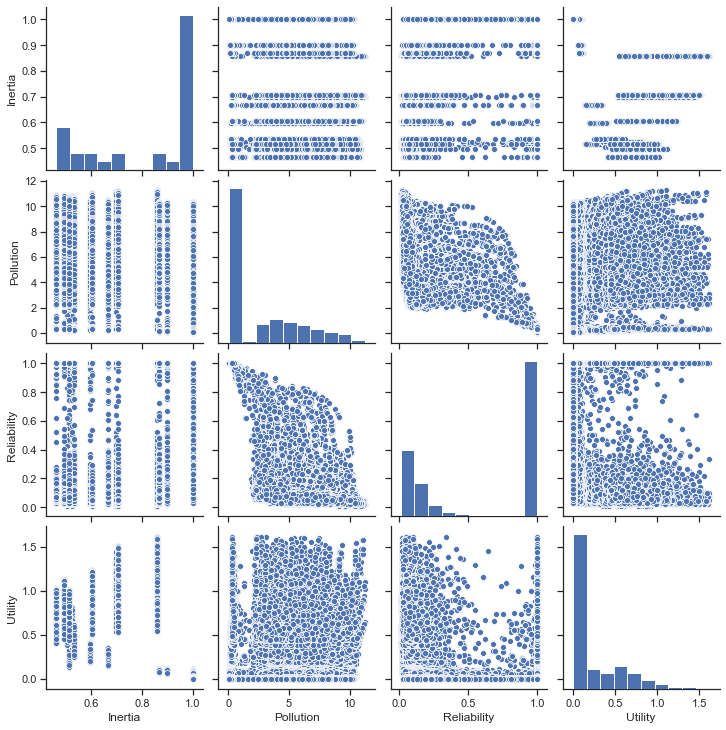

In [48]:
sns.set(style="ticks")
sns.pairplot(df[['Inertia','Pollution', 'Reliability','Utility']]) 

In [32]:
uutt = np.zeros((1,25))
for j in range(25):
    uutt[0,j] = df.loc[j*1000+4,'Utility']
uutt.max()

1.6772286285186395

In [33]:
ppoo = np.zeros((1,25))
for j in range(25):
    ppoo[0,j] = df.loc[j*1000+4,'Pollution']
ppoo.min()

0.05551628480865173

## Robustness

### A) Robustness comparison 

#### A.1) Mean/standard deviation (signal-to-noise ratio)

  \begin{equation}
             R_{ij} = \{\begin{array}{ll}
             \frac{\mu(f_{ijs}^* + 1}{\sigma(f_{ijs}^* + 1} ; & \text{if } f_i \text{ is to be maximized}; s=1..N \\
             (\mu(f_{ijs}^* + 1) \times (\sigma(f_{ijs}^* + 1) ; & \text{if } f_i \text{ is to be minimized}; s=1..N\\
             \end{array}
          \end{equation}
          where $\mu(f_{ijs}^*$ is the mean over the set of scenarios for outcome indicator $f_i$ in the case of implementing            the candidate solution $j$, and $\sigma$ is the standard deviation.
    
#### A.2) Max regret
The maximum regret of a candidate solution is the maximal difference across the scenarios between this candidate solution's performance and the zero-regret option's performance in each scenario. The following equation shows the formulation of maximum regret for candidate solution $j$ and outcome indicator $i$. In this formulation, $Z_{is}$ is the zero-regret value of outcome indicator $i$ in scenario $s$, which is assumed to be the best value obtained in this scenario with the optimal policy.

  \begin{equation}
         R_{ij} = \max_{s=1..N} \{ |f_{ijs}^* - Z_{is}| \} 
   \end{equation}

   \begin{equation}
         Z_{is} = \{\begin{array}{ll}
          \max_{s=1..N} \{ f_{ijs}^* \} ; & \text{if } f_i \text{ is to be maximized} \\
          \min_{s=1..N} \{ f_{ijs}^* \} ; & \text{if } f_i \text{ is to be minimized}\\
         \end{array}
  \end{equation}
    



### B) Domain criterion: In how many (percentage of) scenarios (out of 1000 randomly generated) 

#### B.1) Re > 0.95 ? 
#### B.2) Utility > 0.2 ?
#### B.3) Both a and b.

## A) Robustness comparison

In [3]:
int(np.shape(Lake45re_data)[0]/1000)

33

In [4]:
nn = int(np.shape(Lake45re_data)[0]/1000) #58 #non-dominated solutions
ss=1000 # scenarios

In [5]:
# Mean/std deviation (signal Noise)
df = Lake45re_data
R_mean_std = [nn * [None] for i in range(4)]
Solution = []

for j in range(nn):
    R_mean_std[0][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Utility']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Utility']).std()+1)
    #(np.array(nUtility[j]).mean()+1)/(np.array(nUtility[j]).std()+1)            # Max
    R_mean_std[1][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Pollution']).mean()+1)*(np.array(df.loc[(j*1000):(j*1000+999),'Pollution']).std()+1)
    #(np.array(nPollution[j]).mean()+1)*(np.array(nPollution[j]).std()+1)        # Min
    R_mean_std[2][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Inertia']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Inertia']).std()+1)
    #(np.array(nInertia[j]).mean()+1)/(np.array(nInertia[j]).std()+1)            # Max
    R_mean_std[3][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Reliability']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Reliability']).std()+1)
    #(np.array(nReliability[j]).mean()+1)/(np.array(nReliability[j]).std()+1)    # Max
    Solution.append(j)

In [6]:
# Trade-offs between Utility and Reliability
# Each line represents one solution
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = R_mean_std[0],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
               dict(range = [1.25,2.1],
                label = 'Robustness of Inertia(↑)', values = R_mean_std[2]),
          
            dict(range = [20,9],
                label = 'Robustness of Pollution(↑)', values = R_mean_std[1]),
         
            dict(range = [.9,1.45],
                label = 'Robustness of Reliability(↑)', values = R_mean_std[3]),
              dict(range = [1,1.5],
                #constraintrange = [4,8],
                label = 'Robustness of Utility(↑)', values = R_mean_std[0]),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [7]:
df = Lake45re_data
nnUtility = np.zeros((nn,ss))
nnPollution = np.zeros((nn,ss))
nnInertia = np.zeros((nn,ss))
nnReliability = np.zeros((nn,ss))

for p in range(ss):
    for i in range(nn):
        nnUtility[i][p] = df.loc[i*1000+p,'Utility']
        nnPollution[i][p] = df.loc[i*1000+p,'Pollution']
        nnInertia[i][p] = df.loc[i*1000+p,'Inertia']
        nnReliability[i][p] = df.loc[i*1000+p,'Reliability']
    

In [8]:
# Max Regret
z = [ss * [None] for i in range(4)]
Regret = [nn * [None] for i in range(4)]

for p in range(ss):
    z[0][p] = np.max(nnUtility, axis=0)[p] #nnUtility[solution(nn)][scenario(ss)]
    z[1][p] = np.min(nnPollution, axis=0)[p]
    z[2][p] = np.max(nnInertia, axis=0)[p]
    z[3][p] = np.max(nnReliability, axis=0)[p]

for j in range(nn):
    Regret[0][j] = np.max( abs(np.matrix(nnUtility[j]) - np.matrix(z[0]) ) )            # Max
    Regret[1][j] = np.max( abs(np.matrix(nnPollution[j]) - np.matrix(z[1]) ) )         # Min
    Regret[2][j] = np.max( abs(np.matrix(nnInertia[j]) - np.matrix(z[2]) ) )           # Max
    Regret[3][j] = np.max( abs(np.matrix(nnReliability[j]) - np.matrix(z[3]) ) )     # Max
 

In [9]:
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = Regret[0],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
              dict(range = [0,0.75],
                label = 'Robustness of Inertia(↓)', values = Regret[2]),
      
            dict(range = [0,11],
                label = 'Robustness of Pollution(↓)', values = Regret[1]),
          
            dict(range = [0,1],
                label = 'Robustness of Reliability(↓)', values = Regret[3]),
                  dict(range = [0,1.75],
                #constraintrange = [4,8],
                label = 'Robustness of Utility(↓)', values = Regret[0]),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [13]:
print(min(Regret[1]), ',', max(Regret[1]))

0.3844625690363408 , 10.85391036264134


## B) Robustness analysis

In [42]:
# Calculating Pcrit
#b,q, and x
# for each solution in each scenario we may have different Pcrit
Pcrit = np.zeros((nn,ss))
for j in range(nn):
    for  p in range(ss):
        x = ait[j]
        bb = b[p]
        qq = q[p]
        Pcrit[j][p] = brentq(lambda x: x**qq/(1+x**qq) - bb*x, 0.01, 1.5)
        
#Pcrit

In [43]:
# Write objectives

with open('Pcrit(EkerBarth)_58solutions_random_rfps(15.10.2020)s3.csv', 'w', newline='') as f:
    objectives = ['Pcrit'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(nn):
        for p in range(ss):
            thewriter.writerow({'Pcrit' : Pcrit[j][p]
                               })

In [10]:
Pcritical = pd.read_csv('Pcrit(EkerBarth)_58solutions_random_rfps(15.10.2020)s3.csv')
#Pcritical.describe()

Pcriti = np.zeros((nn,ss))
ind = 0
for j in range(nn):
    for p in range(ss):
        Pcriti[j][p] = Pcritical['Pcrit'][ind]
        ind += 1
    
#Pcriti[49][999]

In [11]:
""" 
Robustness analysis --> B
Calculating how many scenarios has 
    B.1) reliability > 0.8 
    B.2) Utility > 0.2/0.1 ?
    B.3) Both a and b.

"""
n_reliabale_scen = np.zeros((nn,))
n_high_eco_scen = np.zeros((nn,))
n_both_scen = np.zeros((nn,))
n_high_inertia_scen = np.zeros((nn,))
n_low_pollution_scen = np.zeros((nn,))
#critical_scen = []


for i in range(nn): 
    nrs = 0
    nhes = 0
    nboth = 0
    nhi = 0
    nlp = 0
    for p in range(ss):
        if nnReliability[i][p]>.8: #A.1
            nrs += 1
        #else:
        #    critical_scen.append(np.array([p+1, b[p], q[p], mean[p], stdev[p], delta[p]]) )  
        if nnUtility[i][p]>0.2: #A.2
            nhes += 1
        if nnReliability[i][p]>0.8 and nnUtility[i][p]>0.2: #A.3
            nboth += 1
        if nnInertia[i][p]>0.99:
            nhi += 1   
        if nnPollution[i][p]<Pcriti[i][p]: #2.54
            nlp += 1
            
    n_reliabale_scen[i] = nrs   
    n_high_eco_scen[i] = nhes
    n_both_scen[i] = nboth
    n_high_inertia_scen[i] = nhi
    n_low_pollution_scen[i] = nlp
    

print('Number of scenarios with reliability of > 0.8 =', n_reliabale_scen)
print('Number of scenarios with utility of > 0.75 =',n_high_eco_scen)
print('Number of scenarios with reliability of > 0.8 and utility > 0.2 =',n_both_scen)
#print('Number of scenarios with inertia of > 0.99 =',n_high_inertia_scen)
print('Number of scenarios with pollution of < Critical point =',n_low_pollution_scen)
#print(critical_scen)

Number of scenarios with reliability of > 0.8 = [111. 771. 580. 280. 547. 493. 435. 726. 720. 718. 723. 725. 722. 718.
 724. 768. 766. 772. 777. 765. 764. 771. 762. 774. 776. 174. 155. 140.
 777. 115. 237. 182. 156.]
Number of scenarios with utility of > 0.75 = [1000.    0.  499. 1000.  550.  898. 1000.    0.    0.    0.    0.    0.
    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
    0. 1000. 1000. 1000.    0. 1000. 1000. 1000. 1000.]
Number of scenarios with reliability of > 0.8 and utility > 0.2 = [111.   0. 294. 280. 313. 444. 435.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0. 174. 155. 140.
   0. 115. 237. 182. 156.]
Number of scenarios with pollution of < Critical point = [109. 762. 574. 277. 542. 484. 432. 720. 713. 709. 714. 719. 714. 709.
 716. 756. 756. 763. 766. 756. 755. 758. 755. 763. 765. 171. 154. 139.
 764. 114. 234. 180. 153.]


In [39]:
rdc_reliability = np.sort(n_reliabale_scen)[::-1]/1000
rdc_reliability

array([0.777, 0.777, 0.777, 0.776, 0.71 , 0.701, 0.676, 0.648, 0.549,
       0.372, 0.359, 0.345, 0.335, 0.309, 0.262, 0.26 , 0.237, 0.176,
       0.148, 0.139, 0.136, 0.131, 0.13 , 0.127, 0.123, 0.123, 0.118,
       0.118, 0.114, 0.114, 0.113, 0.113, 0.111, 0.11 , 0.106])

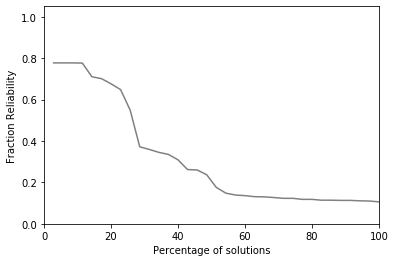

In [40]:
#Reliability robustness
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_reliability, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Reliability") 
plt.show()

In [41]:
rdc_utility = np.sort(n_high_eco_scen)[::-1]/1000
rdc_utility

array([1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   ,
       1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   ,
       1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 0.421,
       0.074, 0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   ])

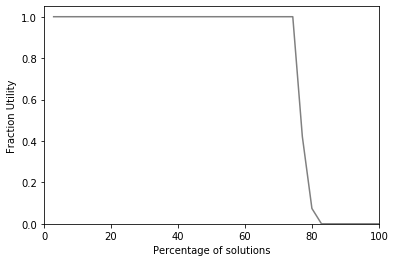

In [42]:
#Utility robustness
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_utility, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Utility") 
plt.show()

In [43]:
rdc_both = np.sort(n_both_scen)[::-1]/1000
rdc_both

array([0.372, 0.359, 0.345, 0.335, 0.309, 0.262, 0.26 , 0.24 , 0.237,
       0.176, 0.148, 0.139, 0.136, 0.131, 0.13 , 0.127, 0.123, 0.123,
       0.118, 0.118, 0.114, 0.114, 0.113, 0.113, 0.111, 0.11 , 0.106,
       0.043, 0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   ])

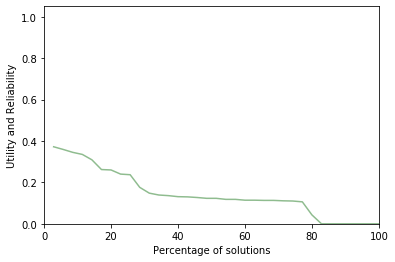

In [44]:
#Both
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_both, color = "darkseagreen")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Utility and Reliability") 
plt.show()

In [45]:
rdc_pollution = np.sort(n_low_pollution_scen)[::-1]/1000
rdc_pollution

array([0.767, 0.766, 0.766, 0.766, 0.706, 0.695, 0.672, 0.641, 0.544,
       0.37 , 0.355, 0.341, 0.322, 0.307, 0.259, 0.257, 0.234, 0.176,
       0.143, 0.139, 0.136, 0.13 , 0.13 , 0.125, 0.121, 0.12 , 0.117,
       0.114, 0.114, 0.113, 0.111, 0.111, 0.109, 0.107, 0.1  ])

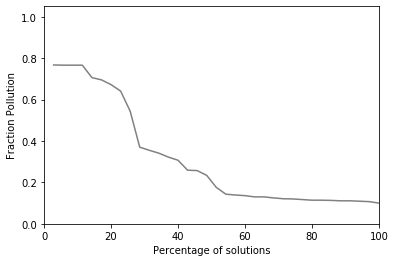

In [46]:
#Pollution
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_pollution, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Pollution") 
plt.show()

In [47]:
rdc_inertia = np.sort(n_high_inertia_scen)[::-1]/1000
rdc_inertia

array([1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0.])

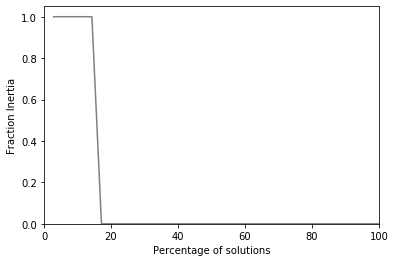

In [48]:
#Inertia
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_inertia, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Inertia") 
plt.show()

In [12]:
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = n_high_eco_scen,
                   colorscale = [[0.1,'black'],[0.35,'purple'],[0.7,'red'],[.9,'gold']]),
        dimensions = list([
                    
            dict(range = [0,1],
                label = 'Fraction Pollution', values = n_low_pollution_scen/1000),
          
            dict(range = [0,1],
                label = 'Fraction Reliability', values = n_reliabale_scen/1000),
            
            dict(range = [0,1],
                #constraintrange = [4,8],
                label = 'Fraction Utility', values = n_high_eco_scen/1000),
            dict(range = [0,1],
                label = 'Fraction Inertia', values = n_high_inertia_scen/1000),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [33]:
# Write objectives

with open('Domain_58solutions_(28.10.2020)s3.csv', 'w', newline='') as f:
    objectives = ['rdc_u', 'rdc_rel', 'rdc_pol', 'rdc_in'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(58):
        thewriter.writerow({'rdc_u' : rdc_utility[j], 'rdc_rel' : rdc_reliability[j], 'rdc_pol' : rdc_pollution[j], 'rdc_in' : rdc_inertia[j]   
                               })

## Select solutions which are more robust (e.g. n_both_scen > 103)

In [57]:
# Choose the solutions which has the reliability of > 0.8 and utility > 0.2
n_both_scen

array([340.,   0.,   0., 308., 196., 172., 109., 151.,   0., 146., 109.,
       184.,   0., 387., 358., 109.,   0., 139., 135.,   0., 126., 136.,
       174., 283., 132., 136., 158.,   0., 111.,   0., 194., 312.,   0.,
       135.,   0., 127.,   0.,   0., 212.,   0., 157., 192., 509.,   0.,
       176., 130., 158., 117.,   0., 265., 423., 253.,   0., 300., 142.,
       447., 224., 112.])

In [59]:
selected_ait = []
selected_U = []
selected_P = [] 
selected_I = []
selected_R = []

for i in range(nn):
    if n_both_scen[i] > 350:
        selected_ait.append(ait[i])
        selected_U.append(nnUtility[i])
        selected_P.append(nnPollution[i])
        selected_I.append(nnInertia[i])
        selected_R.append(nnReliability[i])
        #print(i, n_both_scen[i])

# The number of selected solutions
print('The number of selected solutions =', np.shape(selected_U)[0])       

The number of selected solutions = 5


In [60]:
# Write objectives

with open('obective_values_4obj_s3(EkerBart)_selected_solutions(15.10.2020)SLSQP.csv', 'w', newline='') as f:
    objectives = ['Utility', 'Pollution', 'Inertia', 'Reliability', 'group'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(np.shape(selected_ait)[0]):
        for i in range(ss):
            thewriter.writerow({'Utility' : selected_U[j][i], 'Pollution' : selected_P[j][i], 'Inertia' : selected_I[j][i], 'Reliability' : selected_R[j][i], 'group' : j
                               })

In [61]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

Lake4550selected_data = pd.read_csv('obective_values_4obj_s3(EkerBart)_selected_solutions(15.10.2020)SLSQP.csv')
Lake4550selected_data.describe()

,Utility,Pollution,Inertia,Reliability,group
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,0.317509,3.135812,0.618182,0.549185,2.000000
std,0.108734,3.172641,0.111104,0.442114,1.414355
min,0.156592,0.088056,0.484848,0.010000,0.000000
25%,0.237470,0.256727,0.575758,0.094675,1.000000
50%,0.295936,2.482019,0.575758,0.398250,2.000000
75%,0.377096,5.623795,0.636364,1.000000,3.000000
max,0.727093,10.807376,0.818182,1.000000,4.000000


In [63]:
# The performances of the 6 selected solutions in all 1000 scenarios
df = Lake4550selected_data

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = df['group'],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
            dict(range = [0,1],
                #constraintrange = [4,8],
                label = 'Utility', values = df['Utility']),
            dict(range = [0,11],
                label = 'Pollution', values = df['Pollution']),
            dict(range = [0,1],
                label = 'Inertia', values = df['Inertia']),
            dict(range = [0,1],
                label = 'Reliability', values = df['Reliability']),
            dict(range = [0,4],
                label = 'Solution', values = df['group']),
            
        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

## Calculating the ideal points for all 1000 generated scenarios 

In [64]:
Lake45_1000ideals = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\obective_values_4obj_5scen(EkerBart)_1000_ideal_points(12.10.2020).csv')
Lake45_1000ideals.describe()

,ideal_Utility,ideal_Pollution,ideal_Inertia,ideal_Reliability,Scenario
count,1000.000000,1000.000000,1000.0,1000.000000,1000.000000
mean,0.964190,1.602561,1.0,0.827922,499.500000
std,0.318529,2.899479,0.0,0.326612,288.819436
min,0.571224,0.016309,1.0,0.030000,0.000000
25%,0.693488,0.076118,1.0,1.000000,249.750000
50%,0.879524,0.123542,1.0,1.000000,499.500000
75%,1.183153,0.250321,1.0,1.000000,749.250000
max,1.734761,10.321020,1.0,1.000000,999.000000


In [65]:
dfi = Lake45_1000ideals

## As seen above, the ideal points for reliability in some scenarios are very close to 0 (min = 0.04).
## It means that, in those scenarios, there is no feasible solution with the reliability of higher than 0.8. 

## As seen above, in 208 scenarios (out of 1000), the ideal value for utility is > Critical pollution level. It means that there exists no feasible solution with a lower pollution in these 208 scenarios.

## Therefore, we can remove these scenarios and solve a model with all 4 objective functions in the remaining 802 scenarios. The solutions for that model would have less conservatism (similar reliability values but with equal or better performances in other objectives).